In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [13]:
df = pd.read_excel('【ローデータ・GT表】2403運転免許保有者に関する調査.xlsx', sheet_name='基準クリア年齢性別順')
df


#欠損値のある列を確認
null_columns = df.columns[df.isnull().any()]
print(null_columns)

# #欠損値のある行を確認
# df[df.isnull().any(axis=1)]

# print(df.isnull().any())
print(df.isnull().sum())


Index(['q1_snt4_1', 'q2_snt4_1', 'q6', 'q7', 'q8', 'q9', 'q10'], dtype='object')
no        0
group1    0
group2    0
sc1       0
sc2_1     0
         ..
cq-2      0
dq-1      0
dq-2      0
eq-1      0
eq-2      0
Length: 258, dtype: int64


In [14]:

# sc5列の作成: 各行で'1'がある位置に応じて0, 1, 2に変換
df['sc5'] = df[['sc5-1', 'sc5-2', 'sc5-3']].idxmax(axis=1)

# 'sc5-1', 'sc5-2', 'sc5-3'を数値に変換
df['sc5'] = df['sc5'].map({'sc5-1': 0, 'sc5-2': 1, 'sc5-3': 2})

# 元のsc5-1, sc5-2, sc5-3の列を削除（不要なら）
df = df.drop(columns=['sc5-1', 'sc5-2', 'sc5-3'])

#sc7列の作成'sc7-1'~'sc7-23'
df['sc7'] = df[['sc7-1', 'sc7-2', 'sc7-3', 'sc7-4', 'sc7-5', 'sc7-6', 'sc7-7', 'sc7-8', 'sc7-9', 'sc7-10', 'sc7-11', 'sc7-12', 'sc7-13', 'sc7-14', 'sc7-15', 'sc7-16', 'sc7-17', 'sc7-18', 'sc7-19', 'sc7-20', 'sc7-21', 'sc7-22', 'sc7-23']].idxmax(axis=1)

# 'sc7-1', 'sc7-2', 'sc7-3', 'sc7-4', 'sc7-5', 'sc7-6', 'sc7-7', 'sc7-8', 'sc7-9', 'sc7-10', 'sc7-11', 'sc7-12', 'sc7-13', 'sc7-14', 'sc7-15', 'sc7-16', 'sc7-17', 'sc7-18', 'sc7-19', 'sc7-20', 'sc7-21', 'sc7-22', 'sc7-23'を数値に変換
df['sc7'] = df['sc7'].map({'sc7-1': 0, 'sc7-2': 1, 'sc7-3': 2, 'sc7-4': 3, 'sc7-5': 4, 'sc7-6': 5, 'sc7-7': 6, 'sc7-8': 7, 'sc7-9': 8, 'sc7-10': 9, 'sc7-11': 10, 'sc7-12': 11, 'sc7-13': 12, 'sc7-14': 13, 'sc7-15': 14, 'sc7-16': 15, 'sc7-17': 16, 'sc7-18': 17, 'sc7-19': 18, 'sc7-20': 19, 'sc7-21': 20, 'sc7-22': 21, 'sc7-23': 22})

# 元のsc7-1, sc7-2, sc7-3, sc7-4, sc7-5, sc7-6, sc7-7, sc7-8, sc7-9, sc7-10, sc7-11, sc7-12, sc7-13, sc7-14, sc7-15, sc7-16, sc7-17, sc7-18, sc7-19, sc7-20, sc7-21, sc7-22, sc7-23の列を削除（不要なら）
df = df.drop(columns=['sc7-1', 'sc7-2', 'sc7-3', 'sc7-4', 'sc7-5', 'sc7-6', 'sc7-7', 'sc7-8', 'sc7-9', 'sc7-10', 'sc7-11', 'sc7-12', 'sc7-13', 'sc7-14', 'sc7-15', 'sc7-16', 'sc7-17', 'sc7-18', 'sc7-19', 'sc7-20', 'sc7-21', 'sc7-22', 'sc7-23'])

In [15]:
#欠損値のある列を確認
null_columns = df.columns[df.isnull().any()]
print(null_columns)


Index(['q1_snt4_1', 'q2_snt4_1', 'q6', 'q7', 'q8', 'q9', 'q10'], dtype='object')


In [16]:
df.drop(['no','group1','group2','sc8','q1_snt4_1','q2_snt4_1','q6', 'q7', 'q8', 'q9', 'q10'],axis=1,inplace=True)
df.columns

Index(['sc1', 'sc2_1', 'sc3', 'sc4', 'sc6', 'q1', 'q2', 'q3', 'q4', 'q4sq',
       ...
       'bq-1', 'bq-2', 'cq-1', 'cq-2', 'dq-1', 'dq-2', 'eq-1', 'eq-2', 'sc5',
       'sc7'],
      dtype='object', length=223)

In [17]:
#aq50,aq51_1~aq51_20,bq50,bq51_1~bq51_20,cq50,cq51_1~cq51_20,dq50,dq51_1~dq51_20,eq50,eq51_1~eq51_20の列を削除
df.drop(['aq50','aq51_1','aq51_2','aq51_3','aq51_4','aq51_5','aq51_6','aq51_7','aq51_8','aq51_9','aq51_10','aq51_11','aq51_12','aq51_13','aq51_14','aq51_15','aq51_16','aq51_17','aq51_18','aq51_19','aq51_20','bq50','bq51_1','bq51_2','bq51_3','bq51_4','bq51_5','bq51_6','bq51_7','bq51_8','bq51_9','bq51_10','bq51_11','bq51_12','bq51_13','bq51_14','bq51_15','bq51_16','bq51_17','bq51_18','bq51_19','bq51_20','cq50','cq51_1','cq51_2','cq51_3','cq51_4','cq51_5','cq51_6','cq51_7','cq51_8','cq51_9','cq51_10','cq51_11','cq51_12','cq51_13','cq51_14','cq51_15','cq51_16','cq51_17','cq51_18','cq51_19','cq51_20','dq50','dq51_1','dq51_2','dq51_3','dq51_4','dq51_5','dq51_6','dq51_7','dq51_8','dq51_9','dq51_10','dq51_11','dq51_12','dq51_13','dq51_14','dq51_15','dq51_16','dq51_17','dq51_18','dq51_19','dq51_20','eq50','eq51_1','eq51_2','eq51_3','eq51_4','eq51_5','eq51_6','eq51_7','eq51_8','eq51_9','eq51_10','eq51_11','eq51_12','eq51_13','eq51_14','eq51_15','eq51_16','eq51_17','eq51_18','eq51_19','eq51_20'],axis=1,inplace=True)

In [18]:
df.drop(['aq-1','aq-2','bq-1','bq-2','cq-1','cq-2','dq-1','dq-2','eq-1','eq-2'],axis=1,inplace=True)

#認知特性の列を削除'q14'~'q49'
df.drop(['q14','q15','q16','q17','q18','q19','q20','q21','q22','q23','q24','q25','q26','q27','q28','q29','q30','q31','q32','q33','q34','q35','q36','q37','q38','q39','q40','q41','q42','q43','q44','q45','q46','q47','q48','q49'],axis=1,inplace=True)


In [19]:
df.rename(columns={'sc1':'性別','sc2_1':'年齢','sc3':'住まい','sc4':'結婚フラグ','sc5':'子供フラグ','sc6':'職業','sc7':'業種','q1':'回答機器','q2':'回答音響機器','q3':'回答時周辺状況','q4':'免許種類','q4sq':'免許取得時期','q5':'運転頻度','q5sq':'最後運転時期'},inplace=True)

In [20]:
cogn_df = pd.read_csv('cogn.csv')
cogn_df

,視角写真,視角三次元,言語映像,言語抽象,聴覚言語,聴覚音
0,20,30,29,21,10,6
1,19,20,14,8,13,24
2,21,19,18,16,18,15
3,21,31,28,16,17,13
4,28,27,23,24,24,25
...,...,...,...,...,...,...
799,22,27,33,19,18,11
800,18,20,33,18,24,12
801,21,30,14,16,11,21
802,15,24,28,26,17,8


In [24]:
#dfとcogn_dfを結合
df = pd.concat([df, cogn_df], axis=1)
df

,性別,年齢,住まい,結婚フラグ,職業,回答機器,回答音響機器,回答時周辺状況,免許種類,免許取得時期,...,q13_37,q13_38,子供フラグ,業種,視角写真,視角三次元,言語映像,言語抽象,聴覚言語,聴覚音
0,1,28,14,1,1,1,2,1,2,4,...,4,4,2,6,20,30,29,21,10,6
1,1,28,1,2,1,2,1,4,2,4,...,3,3,0,0,19,20,14,8,13,24
2,1,28,11,2,9,1,1,3,2,4,...,4,5,0,18,21,19,18,16,18,15
3,1,20,21,1,12,2,1,1,1,2,...,3,2,2,14,21,31,28,16,17,13
4,1,27,13,2,11,1,1,1,1,4,...,5,5,2,7,28,27,23,24,24,25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
799,2,72,40,2,10,1,1,2,2,5,...,3,3,0,22,22,27,33,19,18,11
800,2,71,13,2,11,3,1,1,2,5,...,4,2,1,22,18,20,33,18,24,12
801,2,72,13,2,10,2,3,2,2,5,...,4,3,2,22,21,30,14,16,11,21
802,2,75,43,2,11,1,1,1,2,5,...,3,4,1,22,15,24,28,26,17,8


In [24]:
subeval40 = pd.read_csv('subeval40.csv')
subeval40

,好み2,個人的に好き2,なるほど2,改善しようと思う2,これからは注意して運転しよう2,ブレーキに関する内容2,分かりやすかった2,理解しやすかった2,指摘内容の把握を流暢に2,把握は楽2,...,好み5,個人的に好き5,なるほど5,改善しようと思う5,これからは注意して運転しよう5,ブレーキに関する内容5,分かりやすかった5,理解しやすかった5,指摘内容の把握を流暢に5,把握は楽5
0,3,3,3,3,4,4,3,4,3,3,...,3,2,4,4,4,4,4,4,4,4
1,3,3,3,3,3,3,3,3,3,3,...,3,3,3,3,3,3,3,3,3,3
2,1,1,1,1,1,1,1,1,1,1,...,4,5,4,4,4,4,5,5,3,5
3,3,3,4,4,4,4,3,2,3,3,...,4,3,4,4,4,5,4,4,4,4
4,4,5,4,5,5,5,5,5,5,5,...,5,5,4,5,5,5,5,5,5,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
799,2,2,5,5,5,5,5,5,5,5,...,3,3,5,5,5,5,5,5,5,5
800,2,1,5,4,4,5,5,5,5,5,...,3,1,5,4,5,5,5,5,5,5
801,5,5,5,4,4,3,5,5,5,5,...,5,5,5,5,5,5,5,5,5,5
802,4,3,5,5,5,5,5,5,4,4,...,4,4,5,5,5,5,5,5,5,5


In [25]:
# #lightgbmのインストール
# !pip install lightgbm
# optunaのインストール
# !pip install optuna
#!pip install optuna-integration

#lightgbmのインポート
# import lightgbm as lgb
import optuna.integration.lightgbm as lgb
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# データの準備
X = df  # 特徴量データ
y = subeval40  # 回帰対象（5つのターゲット）

# それぞれのターゲットに対して回帰モデルを作成
models = []
predictions = []
mse_scores = []
eval_results = []  # 各モデルの学習結果を保存

# 各ターゲットについて回帰
for i in range(y.shape[1]):
    # データの分割
    X_train, X_test, y_train, y_test = train_test_split(X, y.iloc[:, i], test_size=0.2, random_state=0)

    # データセットを生成する
    lgb_train = lgb.Dataset(X_train, y_train)
    lgb_eval = lgb.Dataset(X_test, y_test, reference=lgb_train)

    # パラメータを設定
    params = {
        'objective': 'regression',  # 回帰問題
        'metric': 'mean_squared_error',
        'feature_fraction': 0.5,  # 学習に使用する特徴量の割合
    }

    
    

    # 学習
    evaluation_results = {}  # 結果を保存する辞書
    verbose_eval = 0  # 表示を非表示にする
    model = lgb.train(params, lgb_train, valid_sets=[lgb_train, lgb_eval], 
                      num_boost_round=1000,  
                      callbacks=[
                        lgb.early_stopping(stopping_rounds=10, verbose=True),
                        lgb.log_evaluation(verbose_eval),
                        lgb.record_evaluation(evaluation_results)])

    # モデルを保存
    models.append(model)

    # 学習曲線のデータを保存
    eval_results.append(evaluation_results)

    # 予測
    y_pred = model.predict(X_test, num_iteration=model.best_iteration)
    predictions.append(y_pred)

    # MSEを計算
    mse = mean_squared_error(y_test, y_pred)
    mse_scores.append(mse)
    print(f'Target {i+1} MSE:', mse)

print('MSE:', mse_scores)

# 平均MSEを表示
mean_mse = np.mean(mse_scores)
print('Mean MSE for all targets:', mean_mse)

# # 学習曲線のプロット
# for i in range(y.shape[1]):
#     results = eval_results[i]
    
#     # 学習データと検証データの損失（MSE）をプロット
#     plt.figure(figsize=(10, 6))
#     plt.plot(results['training']['l2'], label='Training Loss')
#     plt.plot(results['valid_1']['l2'], label='Validation Loss')
#     plt.title(f'Target {i+1} Learning Curve')
#     plt.xlabel('Iterations')
#     plt.ylabel('MSE')
#     plt.legend()
#     plt.grid(True)
#     plt.show()


[I 2024-09-14 23:00:20,537] A new study created in memory with name: no-name-3efab016-81dd-4850-b52d-855c896cf875
feature_fraction, val_score: 0.910114:  14%|#4        | 1/7 [00:00<00:00, 15.27it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000936 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:20,607] Trial 1 finished with value: 0.9343376547711829 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.9101139359891534.
feature_fraction, val_score: 0.907836:  29%|##8       | 2/7 [00:00<00:00, 20.27it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000968 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:20,638] Trial 2 finished with value: 0.9078356662833725 and parameters: {'feature_fraction': 0.5}. Best is trial 2 with value: 0.9078356662833725.
feature_fraction, val_score: 0.883462:  71%|#######1  | 5/7 [00:00<00:00, 29.82it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000891 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:20,738] Trial 5 finished with value: 0.9358261015848678 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 3 with value: 0.8834618674230152.
feature_fraction, val_score: 0.883462: 100%|##########| 7/7 [00:00<00:00, 30.21it/s]


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000279 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

num_leaves, val_score: 0.883462:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000799 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:20,809] Trial 7 finished with value: 0.8834618674230152 and parameters: {'num_leaves': 189}. Best is trial 7 with value: 0.8834618674230152.
num_leaves, val_score: 0.883462:   5%|5         | 1/20 [00:00<00:00, 27.42it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000878 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.883462:  10%|#         | 2/20 [00:00<00:00, 19.72it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[16]	valid_0's l2: 0.455779	valid_1's l2: 0.883462
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000919 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:20,937] Trial 9 finished with value: 0.8834618674230152 and parameters: {'num_leaves': 226}. Best is trial 7 with value: 0.8834618674230152.
num_leaves, val_score: 0.883462:  20%|##        | 4/20 [00:00<00:00, 19.56it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001183 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's l2: 0.670153	valid_1's l2: 0.92623


[I 2024-09-14 23:00:20,978] Trial 10 finished with value: 0.9262295955516444 and parameters: {'num_leaves': 13}. Best is trial 7 with value: 0.8834618674230152.
num_leaves, val_score: 0.883462:  20%|##        | 4/20 [00:00<00:00, 19.56it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000838 seconds.
You can set `force_col_wise=true` to remove the overhead.


num_leaves, val_score: 0.883462:  25%|##5       | 5/20 [00:00<00:00, 19.56it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

num_leaves, val_score: 0.883462:  35%|###5      | 7/20 [00:00<00:00, 23.12it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[16]	valid_0's l2: 0.455779	valid_1's l2: 0.883462
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000795 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

num_leaves, val_score: 0.883462:  40%|####      | 8/20 [00:00<00:00, 23.12it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:00:21,210] Trial 15 finished with value: 0.8834618674230152 and parameters: {'num_leaves': 242}. Best is trial 7 with value: 0.8834618674230152.
num_leaves, val_score: 0.883462:  45%|####5     | 9/20 [00:00<00:00, 23.12it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000785 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.883462:  60%|######    | 12/20 [00:00<00:00, 21.22it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000767 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:21,342] Trial 19 finished with value: 0.8834618674230152 and parameters: {'num_leaves': 188}. Best is trial 7 with value: 0.8834618674230152.
num_leaves, val_score: 0.883462:  70%|#######   | 14/20 [00:00<00:00, 24.73it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000754 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:21,405] Trial 21 finished with value: 0.8834618674230152 and parameters: {'num_leaves': 205}. Best is trial 7 with value: 0.8834618674230152.
num_leaves, val_score: 0.883462:  80%|########  | 16/20 [00:00<00:00, 24.73it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000808 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.883462:  90%|######### | 18/20 [00:00<00:00, 26.12it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000772 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:21,543] Trial 25 finished with value: 0.8834618674230152 and parameters: {'num_leaves': 115}. Best is trial 7 with value: 0.8834618674230152.
num_leaves, val_score: 0.883462: 100%|##########| 20/20 [00:00<00:00, 24.83it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000761 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.883462:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000889 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:21,618] Trial 27 finished with value: 0.8991759459447343 and parameters: {'bagging_fraction': 0.5446772630462804, 'bagging_freq': 3}. Best is trial 27 with value: 0.8991759459447343.
bagging, val_score: 0.883462:  10%|#         | 1/10 [00:00<00:00, 25.99it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000850 seconds.
You can set `force_col_wise=true` to remove the overhead.


bagging, val_score: 0.883462:  40%|####      | 4/10 [00:00<00:00, 27.68it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:00:21,753] Trial 31 finished with value: 0.9061148388748737 and parameters: {'bagging_fraction': 0.7131728623885009, 'bagging_freq': 4}. Best is trial 29 with value: 0.8865011407225621.
bagging, val_score: 0.883462:  50%|#####     | 5/10 [00:00<00:00, 27.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000773 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:21,789] Trial 32 finished with value: 0.9104177575215715 and parameters: {'bagging_fraction': 0.6454125904595281, 'bagging_freq': 1}. Best is trial 29 with value: 0.8865011407225621.
bagging, val_score: 0.883462:  60%|######    | 6/10 [00:00<00:00, 27.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000772 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.883462: 100%|##########| 10/10 [00:00<00:00, 28.93it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000767 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.883462:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000776 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:21,953] Trial 37 finished with value: 0.9265542501027546 and parameters: {'feature_fraction': 0.748}. Best is trial 37 with value: 0.9265542501027546.
feature_fraction_stage2, val_score: 0.883462:  33%|###3      | 2/6 [00:00<00:00, 27.28it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000754 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:22,004] Trial 39 finished with value: 0.8973453541810592 and parameters: {'feature_fraction': 0.7799999999999999}. Best is trial 39 with value: 0.8973453541810592.
feature_fraction_stage2, val_score: 0.883462:  50%|#####     | 3/6 [00:00<00:00, 31.14it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000759 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:22,027] Trial 40 finished with value: 0.9101623459019142 and parameters: {'feature_fraction': 0.62}. Best is trial 39 with value: 0.8973453541810592.
feature_fraction_stage2, val_score: 0.883462: 100%|##########| 6/6 [00:00<00:00, 41.67it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000773 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.879204:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000775 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:22,116] Trial 43 finished with value: 0.8792043042416666 and parameters: {'lambda_l1': 0.007711073405954558, 'lambda_l2': 1.5893802247293934e-06}. Best is trial 43 with value: 0.8792043042416666.
regularization_factors, val_score: 0.879204:   5%|5         | 1/20 [00:00<00:01, 13.40it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000817 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:22,151] Trial 44 finished with value: 0.8857444876362311 and parameters: {'lambda_l1': 0.011573983868593827, 'lambda_l2': 6.47103851619374e-07}. Best is trial 43 with value: 0.8792043042416666.
regularization_factors, val_score: 0.879204:  15%|#5        | 3/20 [00:00<00:00, 26.96it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000953 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:22,221] Trial 46 finished with value: 0.9101555622497307 and parameters: {'lambda_l1': 4.270447864995869, 'lambda_l2': 1.4398003309002762e-07}. Best is trial 43 with value: 0.8792043042416666.
regularization_factors, val_score: 0.879204:  25%|##5       | 5/20 [00:00<00:00, 26.96it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000754 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.879204:  30%|###       | 6/20 [00:00<00:00, 27.93it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000788 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


regularization_factors, val_score: 0.879204:  35%|###5      | 7/20 [00:00<00:00, 27.93it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[I 2024-09-14 23:00:22,361] Trial 50 finished with value: 0.8834616938580591 and parameters: {'lambda_l1': 0.00023005226427879238, 'lambda_l2': 6.501446681470604e-05}. Best is trial 43 with value: 0.8792043042416666.
regularization_factors, val_score: 0.879204:  45%|####5     | 9/20 [00:00<00:00, 28.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000767 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:22,429] Trial 52 finished with value: 0.8834617123933953 and parameters: {'lambda_l1': 0.000278204737467418, 'lambda_l2': 0.00019318173607663837}. Best is trial 43 with value: 0.8792043042416666.
regularization_factors, val_score: 0.879204:  60%|######    | 12/20 [00:00<00:00, 28.79it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000765 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:22,497] Trial 54 finished with value: 0.8834616025733091 and parameters: {'lambda_l1': 0.0003392982625604216, 'lambda_l2': 7.682996582044798e-05}. Best is trial 43 with value: 0.8792043042416666.
regularization_factors, val_score: 0.879204:  65%|######5   | 13/20 [00:00<00:00, 28.79it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000856 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:22,574] Trial 56 finished with value: 0.8792077822404485 and parameters: {'lambda_l1': 0.00556056843208498, 'lambda_l2': 1.0080846669675601e-05}. Best is trial 43 with value: 0.8792043042416666.
regularization_factors, val_score: 0.879204:  75%|#######5  | 15/20 [00:00<00:00, 27.79it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000800 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.879204:  80%|########  | 16/20 [00:00<00:00, 27.79it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[16]	valid_0's l2: 0.456254	valid_1's l2: 0.885744
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000833 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with posit

[I 2024-09-14 23:00:22,697] Trial 59 finished with value: 0.8792087350128925 and parameters: {'lambda_l1': 0.004971635143435816, 'lambda_l2': 5.663004384794246e-06}. Best is trial 43 with value: 0.8792043042416666.
regularization_factors, val_score: 0.879204:  90%|######### | 18/20 [00:00<00:00, 26.29it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000787 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.879202: 100%|##########| 20/20 [00:00<00:00, 26.57it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[22]	valid_0's l2: 0.372456	valid_1's l2: 0.879204
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000887 seconds.
You can set `force_col_wise=true` to remove the overhead.
[L

min_child_samples, val_score: 0.879202:  40%|####      | 2/5 [00:00<00:00, 27.61it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000800 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:22,904] Trial 65 finished with value: 0.9063327703251685 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.8930216173763501.
min_child_samples, val_score: 0.879202: 100%|##########| 5/5 [00:00<00:00, 38.75it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000803 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[3]	valid_0's l2: 0.686776	valid_1's l2: 0.914476
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000802 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.839813
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits

[I 2024-09-14 23:00:22,963] A new study created in memory with name: no-name-9edbe293-3511-4050-a6a5-bd6dea784628


Target 1 MSE: 0.8792020054906187


feature_fraction, val_score: 0.953887:  29%|##8       | 2/7 [00:00<00:00, 33.25it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000820 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:23,028] Trial 2 finished with value: 0.9574177904053993 and parameters: {'feature_fraction': 0.5}. Best is trial 1 with value: 0.9538869372632246.
feature_fraction, val_score: 0.951711:  86%|########5 | 6/7 [00:00<00:00, 48.49it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000781 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:23,114] Trial 6 finished with value: 0.9579700967105219 and parameters: {'feature_fraction': 0.8}. Best is trial 4 with value: 0.95171090330736.
num_leaves, val_score: 0.951711:   5%|5         | 1/20 [00:00<00:01, 18.37it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000150 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:23,172] Trial 8 finished with value: 0.95171090330736 and parameters: {'num_leaves': 226}. Best is trial 7 with value: 0.95171090330736.
num_leaves, val_score: 0.951711:  15%|#5        | 3/20 [00:00<00:00, 36.19it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000160 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

num_leaves, val_score: 0.926955:  30%|###       | 6/20 [00:00<00:00, 32.95it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000168 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:23,316] Trial 13 finished with value: 0.95171090330736 and parameters: {'num_leaves': 91}. Best is trial 10 with value: 0.9269550288140189.
num_leaves, val_score: 0.926955:  40%|####      | 8/20 [00:00<00:00, 35.71it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000157 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:23,380] Trial 15 finished with value: 0.95171090330736 and parameters: {'num_leaves': 166}. Best is trial 10 with value: 0.9269550288140189.
num_leaves, val_score: 0.926955:  50%|#####     | 10/20 [00:00<00:00, 35.71it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000586 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

num_leaves, val_score: 0.926955:  60%|######    | 12/20 [00:00<00:00, 31.01it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000283 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:23,526] Trial 19 finished with value: 0.95171090330736 and parameters: {'num_leaves': 124}. Best is trial 10 with value: 0.9269550288140189.
num_leaves, val_score: 0.926955:  70%|#######   | 14/20 [00:00<00:00, 31.01it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000802 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:23,585] Trial 21 finished with value: 0.95171090330736 and parameters: {'num_leaves': 160}. Best is trial 10 with value: 0.9269550288140189.
num_leaves, val_score: 0.926955:  85%|########5 | 17/20 [00:00<00:00, 31.88it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000982 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:23,671] Trial 24 finished with value: 0.95171090330736 and parameters: {'num_leaves': 176}. Best is trial 10 with value: 0.9269550288140189.
num_leaves, val_score: 0.926955: 100%|##########| 20/20 [00:00<00:00, 33.29it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000752 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:23,725] Trial 26 finished with value: 0.95171090330736 and parameters: {'num_leaves': 139}. Best is trial 10 with value: 0.9269550288140189.
bagging, val_score: 0.911929:  10%|#         | 1/10 [00:00<00:00, 15.75it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000792 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[75]	valid_0's l2: 0.697907	valid_1's l2: 0.911929
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000748 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[68]	valid_0's l2: 0.705498	valid_1's l2: 0.912134


[I 2024-09-14 23:00:23,792] Trial 28 finished with value: 0.9121341833698783 and parameters: {'bagging_fraction': 0.7029228922243858, 'bagging_freq': 6}. Best is trial 27 with value: 0.9119286694707192.
bagging, val_score: 0.894396:  40%|####      | 4/10 [00:00<00:00, 32.26it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000745 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[48]	valid_0's l2: 0.726028	valid_1's l2: 0.92273
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000734 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[41]	valid_0's l2: 0.73141	valid_1's l2: 0.928447
[LightGBM] [Info] Auto-choos

[I 2024-09-14 23:00:23,894] Trial 31 finished with value: 0.8943955495483462 and parameters: {'bagging_fraction': 0.6979734061731474, 'bagging_freq': 6}. Best is trial 31 with value: 0.8943955495483462.
bagging, val_score: 0.894396:  50%|#####     | 5/10 [00:00<00:00, 32.26it/s][I 2024-09-14 23:00:23,928] Trial 32 finished with value: 0.9227060016783187 and parameters: {'bagging_fraction': 0.7213998142110576, 'bagging_freq': 6}. Best is trial 31 with value: 0.8943955495483462.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000161 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[48]	valid_0's l2: 0.725971	valid_1's l2: 0.922706


bagging, val_score: 0.894396:  80%|########  | 8/10 [00:00<00:00, 30.14it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000754 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[46]	valid_0's l2: 0.728048	valid_1's l2: 0.922616
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000743 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[68]	valid_0's l2: 0.703763	valid_1's l2: 0.91215


[I 2024-09-14 23:00:23,993] Trial 34 finished with value: 0.9121497667795698 and parameters: {'bagging_fraction': 0.6966697663996083, 'bagging_freq': 6}. Best is trial 31 with value: 0.8943955495483462.
bagging, val_score: 0.894396: 100%|##########| 10/10 [00:00<00:00, 30.84it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000775 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[26]	valid_0's l2: 0.758321	valid_1's l2: 0.930659
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000744 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[47]	valid_0's l2: 0.720195	valid_1's l2: 0.91689


feature_fraction_stage2, val_score: 0.894396:  33%|###3      | 1/3 [00:00<00:00, 23.51it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000776 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[46]	valid_0's l2: 0.728463	valid_1's l2: 0.916407
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000766 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[47]	valid_0's l2: 0.726454	valid_1's l2: 0.914534


[I 2024-09-14 23:00:24,098] Trial 38 finished with value: 0.9145344721129185 and parameters: {'feature_fraction': 0.48000000000000004}. Best is trial 38 with value: 0.9145344721129185.
feature_fraction_stage2, val_score: 0.892177: 100%|##########| 3/3 [00:00<00:00, 40.22it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000735 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.680427	valid_1's l2: 0.892177


regularization_factors, val_score: 0.892177:   5%|5         | 1/20 [00:00<00:01, 13.31it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000186 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.68108	valid_1's l2: 0.892422
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000759 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's

[I 2024-09-14 23:00:24,208] Trial 41 finished with value: 0.8923432943994789 and parameters: {'lambda_l1': 0.4147134685026445, 'lambda_l2': 0.15686513702296515}. Best is trial 41 with value: 0.8923432943994789.
regularization_factors, val_score: 0.892177:  15%|#5        | 3/20 [00:00<00:00, 26.07it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000746 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.683283	valid_1's l2: 0.892471


[I 2024-09-14 23:00:24,247] Trial 42 finished with value: 0.892470713503872 and parameters: {'lambda_l1': 0.4540481932260197, 'lambda_l2': 0.30981166262814896}. Best is trial 41 with value: 0.8923432943994789.
regularization_factors, val_score: 0.891987:  20%|##        | 4/20 [00:00<00:00, 26.07it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000798 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.684074	valid_1's l2: 0.891987


regularization_factors, val_score: 0.891654:  25%|##5       | 5/20 [00:00<00:00, 26.07it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000210 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.68378	valid_1's l2: 0.891654
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000739 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's

regularization_factors, val_score: 0.891654:  30%|###       | 6/20 [00:00<00:00, 25.53it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000853 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.683907	valid_1's l2: 0.892754


[I 2024-09-14 23:00:24,403] Trial 46 finished with value: 0.8927542366466023 and parameters: {'lambda_l1': 0.6131543179691866, 'lambda_l2': 0.2571332809634384}. Best is trial 44 with value: 0.8916539561952121.
regularization_factors, val_score: 0.891654:  40%|####      | 8/20 [00:00<00:00, 25.53it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000849 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.681102	valid_1's l2: 0.89242


regularization_factors, val_score: 0.891654:  45%|####5     | 9/20 [00:00<00:00, 26.76it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000785 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[68]	valid_0's l2: 0.711611	valid_1's l2: 0.907624
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000755 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds


regularization_factors, val_score: 0.891654:  55%|#####5    | 11/20 [00:00<00:00, 26.76it/s]

Early stopping, best iteration is:
[96]	valid_0's l2: 0.712417	valid_1's l2: 0.908639
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000760 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.680451	valid_1's l2: 0.892186
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000762 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best itera

regularization_factors, val_score: 0.891654:  60%|######    | 12/20 [00:00<00:00, 26.95it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000163 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.680433	valid_1's l2: 0.89218


[I 2024-09-14 23:00:24,624] Trial 52 finished with value: 0.892179517896589 and parameters: {'lambda_l1': 0.000734441696379609, 'lambda_l2': 0.002853811213625158}. Best is trial 44 with value: 0.8916539561952121.
regularization_factors, val_score: 0.891654:  65%|######5   | 13/20 [00:00<00:00, 26.95it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000779 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


regularization_factors, val_score: 0.891654:  75%|#######5  | 15/20 [00:00<00:00, 26.54it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.680431	valid_1's l2: 0.892179
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000778 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.68043	valid_1's l2: 0.892178


[I 2024-09-14 23:00:24,698] Trial 54 finished with value: 0.8921784937609387 and parameters: {'lambda_l1': 0.0003132249265757963, 'lambda_l2': 0.0016908890177414384}. Best is trial 44 with value: 0.8916539561952121.
regularization_factors, val_score: 0.891654:  80%|########  | 16/20 [00:00<00:00, 26.54it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000164 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.680427	valid_1's l2: 0.892178
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000174 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improv

[I 2024-09-14 23:00:24,787] Trial 56 finished with value: 0.8921775049011053 and parameters: {'lambda_l1': 4.479914376427244e-06, 'lambda_l2': 6.073225140333013e-07}. Best is trial 44 with value: 0.8916539561952121.
regularization_factors, val_score: 0.891654:  85%|########5 | 17/20 [00:00<00:00, 26.54it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000791 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.680427	valid_1's l2: 0.892178


regularization_factors, val_score: 0.891654:  90%|######### | 18/20 [00:00<00:00, 25.30it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000929 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.680427	valid_1's l2: 0.892178


[I 2024-09-14 23:00:24,896] Trial 58 finished with value: 0.8921775010744625 and parameters: {'lambda_l1': 2.172124503675242e-06, 'lambda_l2': 6.866301931788014e-07}. Best is trial 44 with value: 0.8916539561952121.
regularization_factors, val_score: 0.891654: 100%|##########| 20/20 [00:00<00:00, 24.64it/s]


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000190 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.680427	valid_1's l2: 0.892177


min_child_samples, val_score: 0.891654:  20%|##        | 1/5 [00:00<00:00, 22.24it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000764 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[46]	valid_0's l2: 0.736559	valid_1's l2: 0.919401
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000805 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.755347	valid_1's l2: 0.935028


[I 2024-09-14 23:00:24,992] Trial 61 finished with value: 0.9350282814575348 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9194010417198998.
min_child_samples, val_score: 0.883809:  60%|######    | 3/5 [00:00<00:00, 30.64it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000813 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[96]	valid_0's l2: 0.676555	valid_1's l2: 0.883809
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000763 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[48]	valid_0's l2: 0.728376	valid_1's l2: 0.912977


[I 2024-09-14 23:00:25,046] Trial 63 finished with value: 0.9129770222635781 and parameters: {'min_child_samples': 10}. Best is trial 62 with value: 0.8838089926106357.
min_child_samples, val_score: 0.883809: 100%|##########| 5/5 [00:00<00:00, 37.69it/s]
[I 2024-09-14 23:00:25,083] A new study created in memory with name: no-name-a0b21ef4-af5b-482b-a11d-e33719de6a76


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000856 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.855365
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[68]	valid_0's l2: 0.71158	valid_1's l2: 0.905032
Target 2 MSE: 0.883808992610636


feature_fraction, val_score: 0.979962:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000825 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:25,111] Trial 0 finished with value: 0.9799622257146214 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.9799622257146214.
feature_fraction, val_score: 0.979962:  14%|#4        | 1/7 [00:00<00:00, 23.55it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000767 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:25,131] Trial 1 finished with value: 0.9861005788702794 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.9799622257146214.
feature_fraction, val_score: 0.972650:  57%|#####7    | 4/7 [00:00<00:00, 38.35it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000868 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.972650: 100%|##########| 7/7 [00:00<00:00, 48.16it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000875 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.972650:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000794 seconds.
You can set `force_col_wise=true` to remove the overhead.


num_leaves, val_score: 0.972650:   5%|5         | 1/20 [00:00<00:00, 23.76it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:00:25,278] Trial 8 finished with value: 0.9726503345215616 and parameters: {'num_leaves': 98}. Best is trial 7 with value: 0.9726503345215616.
num_leaves, val_score: 0.972650:  10%|#         | 2/20 [00:00<00:00, 29.39it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000894 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:25,304] Trial 9 finished with value: 0.9726503345215616 and parameters: {'num_leaves': 197}. Best is trial 7 with value: 0.9726503345215616.
num_leaves, val_score: 0.972650:  15%|#5        | 3/20 [00:00<00:00, 33.89it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000233 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[1]	valid_0's l2: 0.951997	valid_1's l2: 1.00222


[I 2024-09-14 23:00:25,325] Trial 10 finished with value: 1.0022248048091906 and parameters: {'num_leaves': 2}. Best is trial 7 with value: 0.9726503345215616.
num_leaves, val_score: 0.972650:  25%|##5       | 5/20 [00:00<00:00, 41.16it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000866 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:25,385] Trial 12 finished with value: 0.9726503345215616 and parameters: {'num_leaves': 122}. Best is trial 7 with value: 0.9726503345215616.
num_leaves, val_score: 0.972650:  35%|###5      | 7/20 [00:00<00:00, 41.16it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000819 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:25,440] Trial 14 finished with value: 0.9726503345215616 and parameters: {'num_leaves': 179}. Best is trial 7 with value: 0.9726503345215616.
num_leaves, val_score: 0.972650:  40%|####      | 8/20 [00:00<00:00, 41.16it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000862 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:25,468] Trial 15 finished with value: 0.9726503345215616 and parameters: {'num_leaves': 165}. Best is trial 7 with value: 0.9726503345215616.
num_leaves, val_score: 0.972650:  50%|#####     | 10/20 [00:00<00:00, 38.28it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000802 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:25,494] Trial 16 finished with value: 0.9726503345215616 and parameters: {'num_leaves': 83}. Best is trial 7 with value: 0.9726503345215616.
num_leaves, val_score: 0.972650:  50%|#####     | 10/20 [00:00<00:00, 38.28it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000801 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:25,522] Trial 17 finished with value: 0.9726503345215616 and parameters: {'num_leaves': 236}. Best is trial 7 with value: 0.9726503345215616.
num_leaves, val_score: 0.972650:  70%|#######   | 14/20 [00:00<00:00, 38.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000774 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:25,599] Trial 20 finished with value: 0.9726503345215616 and parameters: {'num_leaves': 206}. Best is trial 7 with value: 0.9726503345215616.
num_leaves, val_score: 0.972650:  75%|#######5  | 15/20 [00:00<00:00, 38.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000811 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:25,656] Trial 22 finished with value: 0.9726503345215616 and parameters: {'num_leaves': 91}. Best is trial 7 with value: 0.9726503345215616.
num_leaves, val_score: 0.972650:  80%|########  | 16/20 [00:00<00:00, 38.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000828 seconds.
You can set `force_col_wise=true` to remove the overhead.


num_leaves, val_score: 0.972650:  85%|########5 | 17/20 [00:00<00:00, 38.33it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

num_leaves, val_score: 0.972650: 100%|##########| 20/20 [00:00<00:00, 37.72it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000799 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.972650:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000566 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:25,796] Trial 27 finished with value: 0.9925244390622624 and parameters: {'bagging_fraction': 0.7535676230416569, 'bagging_freq': 4}. Best is trial 27 with value: 0.9925244390622624.
bagging, val_score: 0.962225:  20%|##        | 2/10 [00:00<00:00, 23.65it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000776 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:25,854] Trial 29 finished with value: 0.9844763572682071 and parameters: {'bagging_fraction': 0.4246216839139941, 'bagging_freq': 1}. Best is trial 28 with value: 0.9622248298792703.
bagging, val_score: 0.952595:  40%|####      | 4/10 [00:00<00:00, 33.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000855 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:25,914] Trial 31 finished with value: 0.9701223851411067 and parameters: {'bagging_fraction': 0.4141048472614059, 'bagging_freq': 1}. Best is trial 30 with value: 0.952595223217135.
bagging, val_score: 0.952595:  60%|######    | 6/10 [00:00<00:00, 33.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000839 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:25,976] Trial 33 finished with value: 0.9525956350008684 and parameters: {'bagging_fraction': 0.40518829429183834, 'bagging_freq': 1}. Best is trial 30 with value: 0.952595223217135.
bagging, val_score: 0.952595:  70%|#######   | 7/10 [00:00<00:00, 33.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000835 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


bagging, val_score: 0.952595:  90%|######### | 9/10 [00:00<00:00, 33.52it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

bagging, val_score: 0.952595: 100%|##########| 10/10 [00:00<00:00, 30.81it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[9]	valid_0's l2: 0.751515	valid_1's l2: 0.984804


feature_fraction_stage2, val_score: 0.952595:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000998 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:26,130] Trial 37 finished with value: 0.9829750024690309 and parameters: {'feature_fraction': 0.748}. Best is trial 37 with value: 0.9829750024690309.
feature_fraction_stage2, val_score: 0.952595:  33%|###3      | 2/6 [00:00<00:00, 23.89it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001012 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:26,179] Trial 39 finished with value: 0.9575864891381417 and parameters: {'feature_fraction': 0.7799999999999999}. Best is trial 39 with value: 0.9575864891381417.
feature_fraction_stage2, val_score: 0.952595: 100%|##########| 6/6 [00:00<00:00, 40.11it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000848 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.952595:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000791 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:26,277] Trial 43 finished with value: 0.9670086065329724 and parameters: {'lambda_l1': 3.452682921981922e-05, 'lambda_l2': 0.6208228378465025}. Best is trial 43 with value: 0.9670086065329724.
regularization_factors, val_score: 0.952595:  10%|#         | 2/20 [00:00<00:00, 22.45it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000814 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:26,338] Trial 45 finished with value: 0.9525951987669319 and parameters: {'lambda_l1': 1.1013203290467881e-08, 'lambda_l2': 1.5945576976542553e-05}. Best is trial 45 with value: 0.9525951987669319.
regularization_factors, val_score: 0.952595:  20%|##        | 4/20 [00:00<00:00, 31.70it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000808 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:26,374] Trial 46 finished with value: 0.9525952122855289 and parameters: {'lambda_l1': 3.000064965358308e-08, 'lambda_l2': 6.723710426340258e-06}. Best is trial 45 with value: 0.9525951987669319.
regularization_factors, val_score: 0.952595:  25%|##5       | 5/20 [00:00<00:00, 31.70it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000807 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:26,443] Trial 48 finished with value: 0.9525952137652798 and parameters: {'lambda_l1': 1.2358481791265014e-08, 'lambda_l2': 5.7790561979111784e-06}. Best is trial 45 with value: 0.9525951987669319.
regularization_factors, val_score: 0.952595:  30%|###       | 6/20 [00:00<00:00, 31.70it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:26,483] Trial 49 finished with value: 0.9525952153565853 and parameters: {'lambda_l1': 1.072094647609383e-08, 'lambda_l2': 4.5745698788723935e-06}. Best is trial 45 with value: 0.9525951987669319.
regularization_factors, val_score: 0.952595:  40%|####      | 8/20 [00:00<00:00, 28.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000781 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:26,554] Trial 51 finished with value: 0.9525952165023688 and parameters: {'lambda_l1': 1.1757194107579795e-08, 'lambda_l2': 4.090048743194937e-06}. Best is trial 45 with value: 0.9525951987669319.
regularization_factors, val_score: 0.952595:  45%|####5     | 9/20 [00:00<00:00, 28.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000875 seconds.
You can set `force_col_wise=true` to remove the overhead.


regularization_factors, val_score: 0.952595:  55%|#####5    | 11/20 [00:00<00:00, 29.10it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:00:26,656] Trial 54 finished with value: 0.9525952074847919 and parameters: {'lambda_l1': 1.2926732581662625e-08, 'lambda_l2': 9.919705452119971e-06}. Best is trial 45 with value: 0.9525951987669319.
regularization_factors, val_score: 0.952595:  60%|######    | 12/20 [00:00<00:00, 29.10it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000800 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:26,690] Trial 55 finished with value: 0.9525951708587348 and parameters: {'lambda_l1': 2.3825028687785518e-08, 'lambda_l2': 3.537981155640127e-05}. Best is trial 55 with value: 0.9525951708587348.
regularization_factors, val_score: 0.952595:  65%|######5   | 13/20 [00:00<00:00, 29.10it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000952 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.952595:  80%|########  | 16/20 [00:00<00:00, 25.45it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000971 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.952594:  90%|######### | 18/20 [00:00<00:00, 25.63it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[23]	valid_0's l2: 0.646569	valid_1's l2: 0.952594
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000313 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from 

regularization_factors, val_score: 0.952592:  90%|######### | 18/20 [00:00<00:00, 25.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000812 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:26,963] Trial 61 finished with value: 0.9525921960383591 and parameters: {'lambda_l1': 1.3308368534421654e-06, 'lambda_l2': 0.0020379372691456993}. Best is trial 61 with value: 0.9525921960383591.
regularization_factors, val_score: 0.952592: 100%|##########| 20/20 [00:00<00:00, 26.59it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000858 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.945516:  40%|####      | 2/5 [00:00<00:00, 30.35it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000808 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:27,069] Trial 65 finished with value: 1.0024775207548926 and parameters: {'min_child_samples': 5}. Best is trial 64 with value: 0.9455156280390578.
min_child_samples, val_score: 0.945516: 100%|##########| 5/5 [00:00<00:00, 44.50it/s]
[I 2024-09-14 23:00:27,119] A new study created in memory with name: no-name-5e77aec2-e4be-4def-9fc2-3d5fb2722aff


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000799 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.516330
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.981117:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000857 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:27,145] Trial 0 finished with value: 0.981116773881573 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.981116773881573.
feature_fraction, val_score: 0.975856:  14%|#4        | 1/7 [00:00<00:00, 22.42it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000851 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:27,167] Trial 1 finished with value: 0.9758560453969046 and parameters: {'feature_fraction': 0.6}. Best is trial 1 with value: 0.9758560453969046.
feature_fraction, val_score: 0.975006:  43%|####2     | 3/7 [00:00<00:00, 33.49it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000766 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:27,212] Trial 3 finished with value: 0.9750060960716621 and parameters: {'feature_fraction': 0.7}. Best is trial 3 with value: 0.9750060960716621.
feature_fraction, val_score: 0.963489:  71%|#######1  | 5/7 [00:00<00:00, 42.64it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000819 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:27,267] Trial 5 finished with value: 0.963488941715975 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 5 with value: 0.963488941715975.
feature_fraction, val_score: 0.963489: 100%|##########| 7/7 [00:00<00:00, 41.96it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000788 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.963489:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000790 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds


num_leaves, val_score: 0.963489:   5%|5         | 1/20 [00:00<00:01, 18.21it/s]

Early stopping, best iteration is:
[16]	valid_0's l2: 0.551077	valid_1's l2: 0.981326
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000335 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.963489:  10%|#         | 2/20 [00:00<00:01, 17.85it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:00:27,404] Trial 8 finished with value: 0.963488941715975 and parameters: {'num_leaves': 227}. Best is trial 8 with value: 0.963488941715975.
num_leaves, val_score: 0.963489:  15%|#5        | 3/20 [00:00<00:00, 17.85it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001062 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:27,471] Trial 10 finished with value: 0.963488941715975 and parameters: {'num_leaves': 249}. Best is trial 8 with value: 0.963488941715975.
num_leaves, val_score: 0.963489:  20%|##        | 4/20 [00:00<00:00, 17.85it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000843 seconds.
You can set `force_col_wise=true` to remove the overhead.


num_leaves, val_score: 0.963489:  25%|##5       | 5/20 [00:00<00:00, 24.03it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:00:27,543] Trial 12 finished with value: 0.963488941715975 and parameters: {'num_leaves': 167}. Best is trial 8 with value: 0.963488941715975.
num_leaves, val_score: 0.963489:  30%|###       | 6/20 [00:00<00:00, 24.03it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000814 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:27,577] Trial 13 finished with value: 0.963488941715975 and parameters: {'num_leaves': 162}. Best is trial 8 with value: 0.963488941715975.
num_leaves, val_score: 0.963489:  35%|###5      | 7/20 [00:00<00:00, 24.03it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000795 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.963489:  45%|####5     | 9/20 [00:00<00:00, 26.00it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000810 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:27,681] Trial 16 finished with value: 0.963488941715975 and parameters: {'num_leaves': 136}. Best is trial 8 with value: 0.963488941715975.
num_leaves, val_score: 0.963489:  55%|#####5    | 11/20 [00:00<00:00, 27.13it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000831 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:27,750] Trial 18 finished with value: 0.963488941715975 and parameters: {'num_leaves': 50}. Best is trial 8 with value: 0.963488941715975.
num_leaves, val_score: 0.963489:  60%|######    | 12/20 [00:00<00:00, 27.13it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000839 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:27,785] Trial 19 finished with value: 0.963488941715975 and parameters: {'num_leaves': 251}. Best is trial 8 with value: 0.963488941715975.
num_leaves, val_score: 0.963489:  65%|######5   | 13/20 [00:00<00:00, 27.13it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000861 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.958624:  75%|#######5  | 15/20 [00:00<00:00, 26.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:27,900] Trial 22 finished with value: 0.9586239214794908 and parameters: {'num_leaves': 5}. Best is trial 22 with value: 0.9586239214794908.
num_leaves, val_score: 0.958624:  85%|########5 | 17/20 [00:00<00:00, 26.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000802 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[27]	valid_0's l2: 0.743317	valid_1's l2: 0.988362
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000813 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further split

num_leaves, val_score: 0.958624:  90%|######### | 18/20 [00:00<00:00, 27.77it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[21]	valid_0's l2: 0.38146	valid_1's l2: 0.963489


num_leaves, val_score: 0.958624:  95%|#########5| 19/20 [00:00<00:00, 27.77it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000839 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.958624: 100%|##########| 20/20 [00:00<00:00, 26.28it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[21]	valid_0's l2: 0.38146	valid_1's l2: 0.963489


bagging, val_score: 0.958624:  10%|#         | 1/10 [00:00<00:00, 23.83it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001015 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[23]	valid_0's l2: 0.71532	valid_1's l2: 0.97936


bagging, val_score: 0.958624:  20%|##        | 2/10 [00:00<00:00, 26.51it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000281 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[6]	valid_0's l2: 0.866492	valid_1's l2: 0.991766
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000355 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve

bagging, val_score: 0.956941:  30%|###       | 3/10 [00:00<00:00, 22.32it/s]

Early stopping, best iteration is:
[40]	valid_0's l2: 0.62798	valid_1's l2: 0.97653
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000673 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's l2: 0.81367	valid_1's l2: 0.956941


[I 2024-09-14 23:00:28,227] Trial 30 finished with value: 0.9569414175270717 and parameters: {'bagging_fraction': 0.4670250177624456, 'bagging_freq': 1}. Best is trial 30 with value: 0.9569414175270717.
bagging, val_score: 0.956941:  40%|####      | 4/10 [00:00<00:00, 22.32it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000224 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's l2: 0.805694	valid_1's l2: 0.971958


[I 2024-09-14 23:00:28,263] Trial 31 finished with value: 0.9719583430526992 and parameters: {'bagging_fraction': 0.47358203332082205, 'bagging_freq': 1}. Best is trial 30 with value: 0.9569414175270717.
bagging, val_score: 0.956941:  50%|#####     | 5/10 [00:00<00:00, 22.32it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000827 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[36]	valid_0's l2: 0.655756	valid_1's l2: 0.967776


bagging, val_score: 0.951570:  80%|########  | 8/10 [00:00<00:00, 24.76it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000883 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.764831	valid_1's l2: 0.95157
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000817 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's l2: 0.766378	valid_1's l2: 0.967458


bagging, val_score: 0.951570: 100%|##########| 10/10 [00:00<00:00, 27.83it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000948 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.803076	valid_1's l2: 0.985421
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000195 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0'

[I 2024-09-14 23:00:28,428] Trial 36 finished with value: 0.9557359880524302 and parameters: {'bagging_fraction': 0.7637926190210524, 'bagging_freq': 5}. Best is trial 33 with value: 0.951570308241053.
feature_fraction_stage2, val_score: 0.949353:  17%|#6        | 1/6 [00:00<00:00, 21.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000871 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.77076	valid_1's l2: 0.949353
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000807 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.775546	valid_1's l2: 0.952473


[I 2024-09-14 23:00:28,479] Trial 38 finished with value: 0.9524727297499603 and parameters: {'feature_fraction': 0.852}. Best is trial 37 with value: 0.9493526268325085.
feature_fraction_stage2, val_score: 0.949353:  33%|###3      | 2/6 [00:00<00:00, 28.97it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000976 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's l2: 0.76262	valid_1's l2: 0.951069


[I 2024-09-14 23:00:28,502] Trial 39 finished with value: 0.9510686784060999 and parameters: {'feature_fraction': 0.9799999999999999}. Best is trial 37 with value: 0.9493526268325085.
feature_fraction_stage2, val_score: 0.949353: 100%|##########| 6/6 [00:00<00:00, 44.41it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000887 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's l2: 0.788134	valid_1's l2: 0.96223
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000830 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's l2: 0.780104	valid_1's l2: 0.950913
[LightGBM] [Info] Auto-choo

regularization_factors, val_score: 0.945174:   5%|5         | 1/20 [00:00<00:01, 17.36it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000212 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.782322	valid_1's l2: 0.945174
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000815 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0'

[I 2024-09-14 23:00:28,627] Trial 44 finished with value: 0.9574923637301834 and parameters: {'lambda_l1': 7.002411505594328e-08, 'lambda_l2': 8.492827928740713}. Best is trial 43 with value: 0.9451744959887382.
regularization_factors, val_score: 0.945174:  20%|##        | 4/20 [00:00<00:00, 35.51it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000789 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.77088	valid_1's l2: 0.949378
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000816 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.791673	valid_1's l2: 0.959466


[I 2024-09-14 23:00:28,682] Trial 46 finished with value: 0.9594660768088459 and parameters: {'lambda_l1': 1.7393817319690738e-06, 'lambda_l2': 0.6319000318929482}. Best is trial 43 with value: 0.9451744959887382.
regularization_factors, val_score: 0.945174:  35%|###5      | 7/20 [00:00<00:00, 35.51it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000860 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.770775	valid_1's l2: 0.949355
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000791 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.770772	valid_1's l2: 0.949354
[LightGBM] [Info] Auto-cho

regularization_factors, val_score: 0.945174:  40%|####      | 8/20 [00:00<00:00, 34.46it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000891 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.770845	valid_1's l2: 0.949364
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000826 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.770883	valid_1's l2: 0.949369


[I 2024-09-14 23:00:28,830] Trial 51 finished with value: 0.9493687265197509 and parameters: {'lambda_l1': 0.023225140707777012, 'lambda_l2': 0.00012079538068919346}. Best is trial 43 with value: 0.9451744959887382.
regularization_factors, val_score: 0.945174:  50%|#####     | 10/20 [00:00<00:00, 34.46it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000803 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.770795	valid_1's l2: 0.949357
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000805 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.770769	valid_1's l2: 0.949354


[I 2024-09-14 23:00:28,893] Trial 53 finished with value: 0.9493541744120451 and parameters: {'lambda_l1': 0.0011262015780285496, 'lambda_l2': 0.0016476398746487443}. Best is trial 43 with value: 0.9451744959887382.
regularization_factors, val_score: 0.945174:  65%|######5   | 13/20 [00:00<00:00, 33.59it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000803 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.770777	valid_1's l2: 0.949356
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000874 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.770781	valid_1's l2: 0.949357
[LightGBM] [Info] Auto-cho

[I 2024-09-14 23:00:28,982] Trial 56 finished with value: 0.9493527433384522 and parameters: {'lambda_l1': 0.00016830898811846993, 'lambda_l2': 8.04894186394014e-08}. Best is trial 43 with value: 0.9451744959887382.
regularization_factors, val_score: 0.945174:  80%|########  | 16/20 [00:00<00:00, 32.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000809 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.770761	valid_1's l2: 0.949353
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000994 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's l2: 0.801918	valid_1's l2: 0.961187


[I 2024-09-14 23:00:29,053] Trial 58 finished with value: 0.9611874313947527 and parameters: {'lambda_l1': 4.070012571894864, 'lambda_l2': 1.0110981279659467e-07}. Best is trial 43 with value: 0.9451744959887382.
regularization_factors, val_score: 0.945174:  80%|########  | 16/20 [00:00<00:00, 32.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001030 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.77076	valid_1's l2: 0.949353


[I 2024-09-14 23:00:29,093] Trial 59 finished with value: 0.9493526576733765 and parameters: {'lambda_l1': 4.424105298606976e-05, 'lambda_l2': 6.175453330056286e-08}. Best is trial 43 with value: 0.9451744959887382.
regularization_factors, val_score: 0.945174: 100%|##########| 20/20 [00:00<00:00, 31.52it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.77076	valid_1's l2: 0.949353
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000814 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.77076	valid_1's l2: 0.949353
[LightGBM] [Info] Auto-choos

[I 2024-09-14 23:00:29,186] Trial 62 finished with value: 0.9493526477501845 and parameters: {'lambda_l1': 3.0298440292018936e-05, 'lambda_l2': 3.814291284290816e-08}. Best is trial 43 with value: 0.9451744959887382.
min_child_samples, val_score: 0.945174:  60%|######    | 3/5 [00:00<00:00, 38.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000822 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's l2: 0.873938	valid_1's l2: 0.973594
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000830 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits

[I 2024-09-14 23:00:29,269] Trial 66 finished with value: 0.9629335503637605 and parameters: {'min_child_samples': 10}. Best is trial 66 with value: 0.9629335503637605.
min_child_samples, val_score: 0.945174:  80%|########  | 4/5 [00:00<00:00, 40.55it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000782 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.601866
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's l2: 0.780777	valid_1's l2: 0.954612


[I 2024-09-14 23:00:29,290] Trial 67 finished with value: 0.9546118070801739 and parameters: {'min_child_samples': 25}. Best is trial 67 with value: 0.9546118070801739.
min_child_samples, val_score: 0.945174: 100%|##########| 5/5 [00:00<00:00, 49.68it/s]
[I 2024-09-14 23:00:29,294] A new study created in memory with name: no-name-ea578894-ff75-4b5d-881e-f1fbe61b19e3


Target 4 MSE: 0.9451744959887378


feature_fraction, val_score: 0.843555:  43%|####2     | 3/7 [00:00<00:00, 28.67it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000872 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.843555:  86%|########5 | 6/7 [00:00<00:00, 38.22it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000824 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:29,471] Trial 6 finished with value: 0.8881432930273261 and parameters: {'feature_fraction': 0.8}. Best is trial 3 with value: 0.8435552035973438.
num_leaves, val_score: 0.843555:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000795 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:29,503] Trial 7 finished with value: 0.8435552035973438 and parameters: {'num_leaves': 35}. Best is trial 7 with value: 0.8435552035973438.
num_leaves, val_score: 0.843555:  20%|##        | 4/20 [00:00<00:00, 36.66it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000795 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.843555:  30%|###       | 6/20 [00:00<00:00, 36.66it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000781 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[15]	valid_0's l2: 0.459252	valid_1's l2: 0.86104
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000813 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No 

[I 2024-09-14 23:00:29,680] Trial 13 finished with value: 0.8435552035973438 and parameters: {'num_leaves': 103}. Best is trial 7 with value: 0.8435552035973438.
num_leaves, val_score: 0.843555:  35%|###5      | 7/20 [00:00<00:00, 36.66it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000801 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.843555:  45%|####5     | 9/20 [00:00<00:00, 32.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000810 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:29,781] Trial 16 finished with value: 0.8435552035973438 and parameters: {'num_leaves': 186}. Best is trial 7 with value: 0.8435552035973438.
num_leaves, val_score: 0.843555:  55%|#####5    | 11/20 [00:00<00:00, 32.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000840 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.843555:  60%|######    | 12/20 [00:00<00:00, 26.05it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

num_leaves, val_score: 0.843555:  65%|######5   | 13/20 [00:00<00:00, 26.05it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001020 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.843555:  75%|#######5  | 15/20 [00:00<00:00, 24.50it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[18]	valid_0's l2: 0.413998	valid_1's l2: 0.843555
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000827 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

num_leaves, val_score: 0.843555:  90%|######### | 18/20 [00:00<00:00, 25.25it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[18]	valid_0's l2: 0.413998	valid_1's l2: 0.843555
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000896 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

[I 2024-09-14 23:00:30,154] Trial 24 finished with value: 0.8435552035973438 and parameters: {'num_leaves': 138}. Best is trial 7 with value: 0.8435552035973438.
num_leaves, val_score: 0.843555:  90%|######### | 18/20 [00:00<00:00, 25.25it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000791 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:30,189] Trial 25 finished with value: 0.8435552035973438 and parameters: {'num_leaves': 73}. Best is trial 7 with value: 0.8435552035973438.
num_leaves, val_score: 0.843555: 100%|##########| 20/20 [00:00<00:00, 26.62it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000850 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.843555:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000789 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:30,257] Trial 27 finished with value: 0.8655758133585286 and parameters: {'bagging_fraction': 0.8395174779680554, 'bagging_freq': 5}. Best is trial 27 with value: 0.8655758133585286.
bagging, val_score: 0.843555:  40%|####      | 4/10 [00:00<00:00, 32.00it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000809 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:30,353] Trial 30 finished with value: 0.8700645271756215 and parameters: {'bagging_fraction': 0.4907480314115761, 'bagging_freq': 1}. Best is trial 29 with value: 0.8559819548385119.
bagging, val_score: 0.843555:  40%|####      | 4/10 [00:00<00:00, 32.00it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000810 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:30,381] Trial 31 finished with value: 0.8886318502851357 and parameters: {'bagging_fraction': 0.652169960295253, 'bagging_freq': 4}. Best is trial 29 with value: 0.8559819548385119.
bagging, val_score: 0.843555:  60%|######    | 6/10 [00:00<00:00, 32.00it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000810 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:30,444] Trial 33 finished with value: 0.8717646811344261 and parameters: {'bagging_fraction': 0.837117750860426, 'bagging_freq': 7}. Best is trial 29 with value: 0.8559819548385119.
bagging, val_score: 0.843555:  70%|#######   | 7/10 [00:00<00:00, 32.00it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000859 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.843555: 100%|##########| 10/10 [00:00<00:00, 32.00it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000813 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.843555:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000790 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:30,564] Trial 37 finished with value: 0.8825396577062972 and parameters: {'feature_fraction': 0.748}. Best is trial 37 with value: 0.8825396577062972.
feature_fraction_stage2, val_score: 0.843555:  17%|#6        | 1/6 [00:00<00:00, 23.22it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000820 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:30,585] Trial 38 finished with value: 0.8870754770348825 and parameters: {'feature_fraction': 0.652}. Best is trial 37 with value: 0.8825396577062972.
feature_fraction_stage2, val_score: 0.843555:  67%|######6   | 4/6 [00:00<00:00, 34.25it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000872 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.843555:  83%|########3 | 5/6 [00:00<00:00, 42.46it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000821 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:30,691] Trial 42 finished with value: 0.8582297951567488 and parameters: {'feature_fraction': 0.716}. Best is trial 42 with value: 0.8582297951567488.
regularization_factors, val_score: 0.843555:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001017 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


regularization_factors, val_score: 0.843555:  10%|#         | 2/20 [00:00<00:01,  9.69it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.843555:  15%|#5        | 3/20 [00:00<00:01,  9.69it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.843555:  25%|##5       | 5/20 [00:00<00:00, 19.20it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000182 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.843555:  35%|###5      | 7/20 [00:00<00:00, 22.78it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000932 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:31,064] Trial 50 finished with value: 0.843555203452287 and parameters: {'lambda_l1': 1.2493194960077285e-08, 'lambda_l2': 1.0802457923261596e-08}. Best is trial 46 with value: 0.8435552033378605.
regularization_factors, val_score: 0.843555:  45%|####5     | 9/20 [00:00<00:00, 22.78it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000790 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.843555:  50%|#####     | 10/20 [00:00<00:00, 24.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000863 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


regularization_factors, val_score: 0.843555:  65%|######5   | 13/20 [00:00<00:00, 25.55it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[I 2024-09-14 23:00:31,284] Trial 56 finished with value: 0.843555195183749 and parameters: {'lambda_l1': 1.5917816367101482e-06, 'lambda_l2': 2.938591516926537e-06}. Best is trial 56 with value: 0.843555195183749.
regularization_factors, val_score: 0.843555:  75%|#######5  | 15/20 [00:00<00:00, 25.55it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000795 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.843555:  85%|########5 | 17/20 [00:00<00:00, 22.14it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:00:31,493] Trial 60 finished with value: 0.8435551870783125 and parameters: {'lambda_l1': 3.258302371625701e-06, 'lambda_l2': 4.793743911414813e-06}. Best is trial 59 with value: 0.8435551845626588.
regularization_factors, val_score: 0.843555:  95%|#########5| 19/20 [00:00<00:00, 23.34it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000804 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:31,568] Trial 62 finished with value: 0.8435551871070907 and parameters: {'lambda_l1': 3.4173186073610628e-06, 'lambda_l2': 4.244415322251344e-06}. Best is trial 59 with value: 0.8435551845626588.
min_child_samples, val_score: 0.843555:  60%|######    | 3/5 [00:00<00:00, 28.30it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001033 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:31,700] Trial 66 finished with value: 0.883811545014722 and parameters: {'min_child_samples': 10}. Best is trial 65 with value: 0.8735694381809287.
min_child_samples, val_score: 0.843555: 100%|##########| 5/5 [00:00<00:00, 32.34it/s]
[I 2024-09-14 23:00:31,730] A new study created in memory with name: no-name-7cd1ce1b-89a4-41cb-bd37-00791d286961


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000867 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.676516
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.823211:  14%|#4        | 1/7 [00:00<00:00, 19.44it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000907 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:31,785] Trial 1 finished with value: 0.8232110252410514 and parameters: {'feature_fraction': 0.6}. Best is trial 1 with value: 0.8232110252410514.
feature_fraction, val_score: 0.822499:  71%|#######1  | 5/7 [00:00<00:00, 37.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000791 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:31,890] Trial 5 finished with value: 0.8224987961914612 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 5 with value: 0.8224987961914612.
feature_fraction, val_score: 0.822499:  86%|########5 | 6/7 [00:00<00:00, 37.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000804 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:31,917] Trial 6 finished with value: 0.8459349049336443 and parameters: {'feature_fraction': 0.8}. Best is trial 5 with value: 0.8224987961914612.
num_leaves, val_score: 0.822499:  10%|#         | 2/20 [00:00<00:00, 36.61it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000835 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.792214:  25%|##5       | 5/20 [00:00<00:00, 35.01it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000908 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:32,090] Trial 12 finished with value: 0.7922135175692337 and parameters: {'num_leaves': 7}. Best is trial 12 with value: 0.7922135175692337.
num_leaves, val_score: 0.792214:  30%|###       | 6/20 [00:00<00:00, 35.01it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000866 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[27]	valid_0's l2: 0.376622	valid_1's l2: 0.818277


[I 2024-09-14 23:00:32,124] Trial 13 finished with value: 0.8182765646254669 and parameters: {'num_leaves': 16}. Best is trial 12 with value: 0.7922135175692337.
num_leaves, val_score: 0.792214:  40%|####      | 8/20 [00:00<00:00, 33.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:32,185] Trial 15 finished with value: 0.8224987961914612 and parameters: {'num_leaves': 68}. Best is trial 12 with value: 0.7922135175692337.
num_leaves, val_score: 0.792214:  60%|######    | 12/20 [00:00<00:00, 33.34it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000802 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[65]	valid_0's l2: 0.653207	valid_1's l2: 0.809852
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000827 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further split

[I 2024-09-14 23:00:32,307] Trial 19 finished with value: 0.8224987961914612 and parameters: {'num_leaves': 130}. Best is trial 12 with value: 0.7922135175692337.
num_leaves, val_score: 0.792214:  65%|######5   | 13/20 [00:00<00:00, 33.34it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000847 seconds.
You can set `force_col_wise=true` to remove the overhead.


num_leaves, val_score: 0.792214:  70%|#######   | 14/20 [00:00<00:00, 33.34it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

num_leaves, val_score: 0.792214:  90%|######### | 18/20 [00:00<00:00, 29.53it/s]

Early stopping, best iteration is:
[11]	valid_0's l2: 0.67253	valid_1's l2: 0.855995
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002379 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[I 2024-09-14 23:00:32,529] Trial 25 finished with value: 0.8224987961914612 and parameters: {'num_leaves': 37}. Best is trial 12 with value: 0.7922135175692337.
num_leaves, val_score: 0.792214: 100%|##########| 20/20 [00:00<00:00, 30.91it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000828 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.784166:  50%|#####     | 5/10 [00:00<00:00, 34.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000894 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[20]	valid_0's l2: 0.668303	valid_1's l2: 0.800393
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000849 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.690849	valid_1's l2: 0.812874
[LightGBM] [Info] Auto-cho

[I 2024-09-14 23:00:32,743] Trial 32 finished with value: 0.8206391074181595 and parameters: {'bagging_fraction': 0.42823663078631496, 'bagging_freq': 7}. Best is trial 31 with value: 0.784166006029575.
bagging, val_score: 0.784166:  60%|######    | 6/10 [00:00<00:00, 34.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000800 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[20]	valid_0's l2: 0.687011	valid_1's l2: 0.793024


[I 2024-09-14 23:00:32,776] Trial 33 finished with value: 0.7930241321299183 and parameters: {'bagging_fraction': 0.4047053250838305, 'bagging_freq': 7}. Best is trial 31 with value: 0.784166006029575.
bagging, val_score: 0.784166: 100%|##########| 10/10 [00:00<00:00, 32.49it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[20]	valid_0's l2: 0.687011	valid_1's l2: 0.793024
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001060 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's l2: 0.698765	valid_1's l2: 0.802983
[LightGBM] [Info] Auto-cho

feature_fraction_stage2, val_score: 0.784166:  33%|###3      | 2/6 [00:00<00:00, 26.42it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000998 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.681237	valid_1's l2: 0.784652
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000879 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[20]	valid_0's l2: 0.68306	valid_1's l2: 0.787323
[LightGBM] [Info] Auto-choo

[I 2024-09-14 23:00:32,955] Trial 39 finished with value: 0.7869492851862291 and parameters: {'feature_fraction': 0.9799999999999999}. Best is trial 37 with value: 0.7846521416612031.
feature_fraction_stage2, val_score: 0.783941:  50%|#####     | 3/6 [00:00<00:00, 29.12it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000893 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[23]	valid_0's l2: 0.665865	valid_1's l2: 0.783941


feature_fraction_stage2, val_score: 0.770615: 100%|##########| 6/6 [00:00<00:00, 38.62it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000847 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.679265	valid_1's l2: 0.770615
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[20]	valid_0's l2: 0.690556	valid_1's l2: 0.785573


regularization_factors, val_score: 0.770615:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000904 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.679265	valid_1's l2: 0.770615


[I 2024-09-14 23:00:33,072] Trial 43 finished with value: 0.770615327678654 and parameters: {'lambda_l1': 6.80479682782619e-07, 'lambda_l2': 2.6103671827904144e-05}. Best is trial 43 with value: 0.770615327678654.
regularization_factors, val_score: 0.770615:  15%|#5        | 3/20 [00:00<00:00, 24.28it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000847 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.679265	valid_1's l2: 0.770615
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000791 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.679265	valid_1's l2: 0.770615
[LightGBM] [Info] Auto-cho

regularization_factors, val_score: 0.770615:  20%|##        | 4/20 [00:00<00:00, 32.11it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000888 seconds.
You can set `force_col_wise=true` to remove the overhead.


regularization_factors, val_score: 0.770615:  30%|###       | 6/20 [00:00<00:00, 32.11it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.679265	valid_1's l2: 0.770615
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000815 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.679265	valid_1's l2: 0.770615
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000554 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enoug

regularization_factors, val_score: 0.770615:  40%|####      | 8/20 [00:00<00:00, 25.65it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000841 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.679265	valid_1's l2: 0.770615
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000813 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.679265	valid_1's l2: 0.770615


[I 2024-09-14 23:00:33,372] Trial 51 finished with value: 0.7706153100811559 and parameters: {'lambda_l1': 6.384722316546801e-08, 'lambda_l2': 2.8758330186149224e-06}. Best is trial 50 with value: 0.7706153092695556.
regularization_factors, val_score: 0.770615:  60%|######    | 12/20 [00:00<00:00, 28.49it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000826 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.679265	valid_1's l2: 0.770615
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000809 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.679265	valid_1's l2: 0.770615
[LightGBM] [Info] Auto-cho

[I 2024-09-14 23:00:33,491] Trial 55 finished with value: 0.7706153079995436 and parameters: {'lambda_l1': 1.876007611290624e-08, 'lambda_l2': 1.0829968953745352e-08}. Best is trial 55 with value: 0.7706153079995436.
regularization_factors, val_score: 0.770615:  75%|#######5  | 15/20 [00:00<00:00, 28.49it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.679265	valid_1's l2: 0.770615
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000858 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[20]	valid_0's l2: 0.687261	valid_1's l2: 0.791513
[LightGBM] [Info] Auto-cho

regularization_factors, val_score: 0.766804:  95%|#########5| 19/20 [00:00<00:00, 30.32it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000816 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.679265	valid_1's l2: 0.770615
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000792 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[28]	valid_0's l2: 0.627499	valid_1's l2: 0.766808
[LightGBM] [Info] Auto-cho

min_child_samples, val_score: 0.766804:  40%|####      | 2/5 [00:00<00:00, 32.05it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000794 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:33,774] Trial 65 finished with value: 0.782328856851399 and parameters: {'min_child_samples': 5}. Best is trial 65 with value: 0.782328856851399.
min_child_samples, val_score: 0.766804: 100%|##########| 5/5 [00:00<00:00, 45.67it/s]
[I 2024-09-14 23:00:33,824] A new study created in memory with name: no-name-0e548a9d-3fa8-47a9-a9e7-e8b76fae1168


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000816 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[24]	valid_0's l2: 0.6433	valid_1's l2: 0.788801
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000861 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.696526	valid_1's l2: 0.788322
Target 6 MSE: 0.766803700721

feature_fraction, val_score: 0.958304:  43%|####2     | 3/7 [00:00<00:00, 36.64it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000832 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:33,909] Trial 3 finished with value: 0.9870869068075437 and parameters: {'feature_fraction': 0.7}. Best is trial 2 with value: 0.9583043263476688.
feature_fraction, val_score: 0.958304:  71%|#######1  | 5/7 [00:00<00:00, 44.50it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000179 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:33,967] Trial 5 finished with value: 0.9728730275312796 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 2 with value: 0.9583043263476688.
feature_fraction, val_score: 0.950921: 100%|##########| 7/7 [00:00<00:00, 41.70it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000895 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.950921:   5%|5         | 1/20 [00:00<00:00, 21.75it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's l2: 0.964194	valid_1's l2: 0.964607
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000948 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits

[I 2024-09-14 23:00:34,043] Trial 8 finished with value: 0.9509207019947014 and parameters: {'num_leaves': 142}. Best is trial 8 with value: 0.9509207019947014.
num_leaves, val_score: 0.950921:  10%|#         | 2/20 [00:00<00:01, 17.46it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000867 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.950921:  20%|##        | 4/20 [00:00<00:00, 26.19it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001062 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[4]	valid_0's l2: 1.02357	valid_1's l2: 0.975431
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000994 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits 

[I 2024-09-14 23:00:34,179] Trial 11 finished with value: 0.9509207019947014 and parameters: {'num_leaves': 149}. Best is trial 8 with value: 0.9509207019947014.
num_leaves, val_score: 0.950921:  35%|###5      | 7/20 [00:00<00:00, 29.47it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000866 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.950921:  45%|####5     | 9/20 [00:00<00:00, 29.47it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000811 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:34,328] Trial 16 finished with value: 0.9509207019947014 and parameters: {'num_leaves': 73}. Best is trial 8 with value: 0.9509207019947014.
num_leaves, val_score: 0.950921:  55%|#####5    | 11/20 [00:00<00:00, 30.59it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000930 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.950921:  65%|######5   | 13/20 [00:00<00:00, 30.59it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000794 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.950921:  75%|#######5  | 15/20 [00:00<00:00, 30.51it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000793 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:34,528] Trial 22 finished with value: 0.9509207019947014 and parameters: {'num_leaves': 212}. Best is trial 8 with value: 0.9509207019947014.
num_leaves, val_score: 0.950921:  80%|########  | 16/20 [00:00<00:00, 30.51it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000879 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:34,562] Trial 23 finished with value: 0.9509207019947014 and parameters: {'num_leaves': 102}. Best is trial 8 with value: 0.9509207019947014.
num_leaves, val_score: 0.950921:  95%|#########5| 19/20 [00:00<00:00, 30.45it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000937 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:34,628] Trial 25 finished with value: 0.9509207019947014 and parameters: {'num_leaves': 44}. Best is trial 8 with value: 0.9509207019947014.
num_leaves, val_score: 0.950921: 100%|##########| 20/20 [00:00<00:00, 30.09it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000890 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.950921:  10%|#         | 1/10 [00:00<00:00, 16.51it/s][I 2024-09-14 23:00:34,724] Trial 28 finished with value: 0.9736415788748511 and parameters: {'bagging_fraction': 0.9838575546856332, 'bagging_freq': 1}. Best is trial 28 with value: 0.9736415788748511.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000847 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.950921:  20%|##        | 2/10 [00:00<00:00, 19.67it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003350 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.950921:  40%|####      | 4/10 [00:00<00:00, 29.08it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000339 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

bagging, val_score: 0.950921:  60%|######    | 6/10 [00:00<00:00, 28.48it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001048 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:34,874] Trial 32 finished with value: 0.9868966396802406 and parameters: {'bagging_fraction': 0.7193838608405636, 'bagging_freq': 4}. Best is trial 30 with value: 0.9659793764248237.
bagging, val_score: 0.950921:  70%|#######   | 7/10 [00:00<00:00, 28.48it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000855 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:34,934] Trial 34 finished with value: 0.9963515244164912 and parameters: {'bagging_fraction': 0.5660106956522526, 'bagging_freq': 6}. Best is trial 30 with value: 0.9659793764248237.
bagging, val_score: 0.950921:  80%|########  | 8/10 [00:00<00:00, 28.48it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000811 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:34,964] Trial 35 finished with value: 0.990260159469658 and parameters: {'bagging_fraction': 0.8481772248438424, 'bagging_freq': 2}. Best is trial 30 with value: 0.9659793764248237.
bagging, val_score: 0.950921: 100%|##########| 10/10 [00:00<00:00, 30.03it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000860 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.950921:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000789 seconds.
You can set `force_col_wise=true` to remove the overhead.


feature_fraction_stage2, val_score: 0.950921:  50%|#####     | 3/6 [00:00<00:00, 35.02it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:00:35,083] Trial 40 finished with value: 0.9870869068075437 and parameters: {'feature_fraction': 0.7200000000000001}. Best is trial 39 with value: 0.9529672387930693.
feature_fraction_stage2, val_score: 0.950921: 100%|##########| 6/6 [00:00<00:00, 45.55it/s]


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000548 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.950921:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000815 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:35,168] Trial 43 finished with value: 0.9771995831263205 and parameters: {'lambda_l1': 0.0011616898534668968, 'lambda_l2': 0.00470686412182114}. Best is trial 43 with value: 0.9771995831263205.
regularization_factors, val_score: 0.950921:   5%|5         | 1/20 [00:00<00:01, 15.67it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000797 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:35,201] Trial 44 finished with value: 0.950920702038987 and parameters: {'lambda_l1': 3.059868671897971e-08, 'lambda_l2': 1.2691517958826275e-08}. Best is trial 44 with value: 0.950920702038987.
regularization_factors, val_score: 0.950921:  20%|##        | 4/20 [00:00<00:00, 32.03it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000817 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.950921:  25%|##5       | 5/20 [00:00<00:00, 32.03it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000932 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:35,352] Trial 48 finished with value: 0.9730247737061245 and parameters: {'lambda_l1': 0.00015966522648504334, 'lambda_l2': 7.39183062254331}. Best is trial 46 with value: 0.9509207020253185.
regularization_factors, val_score: 0.950921:  30%|###       | 6/20 [00:00<00:00, 32.03it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001238 seconds.
You can set `force_col_wise=true` to remove the overhead.


regularization_factors, val_score: 0.950921:  35%|###5      | 7/20 [00:00<00:00, 32.03it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

regularization_factors, val_score: 0.950921:  50%|#####     | 10/20 [00:00<00:00, 26.95it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000848 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:35,517] Trial 53 finished with value: 0.9509206996273846 and parameters: {'lambda_l1': 1.8724437641654435e-06, 'lambda_l2': 2.814206680491724e-06}. Best is trial 53 with value: 0.9509206996273846.
regularization_factors, val_score: 0.950921:  60%|######    | 12/20 [00:00<00:00, 28.99it/s][I 2024-09-14 23:00:35,553] Trial 54 finished with value: 0.950920700454346 and parameters: {'lambda_l1': 2.1578120765370656e-06, 'lambda_l2': 1.061015623077143e-06}. Best is trial 53 with value: 0.9509206996273846.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000786 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.950921:  60%|######    | 12/20 [00:00<00:00, 28.99it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000813 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:35,587] Trial 55 finished with value: 0.9509207003933371 and parameters: {'lambda_l1': 2.111961767262666e-06, 'lambda_l2': 1.1290587060293061e-06}. Best is trial 53 with value: 0.9509206996273846.
regularization_factors, val_score: 0.950921:  80%|########  | 16/20 [00:00<00:00, 29.10it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000858 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:35,717] Trial 59 finished with value: 0.9509207001515305 and parameters: {'lambda_l1': 2.3403988720922014e-06, 'lambda_l2': 1.3490082981154465e-06}. Best is trial 53 with value: 0.9509206996273846.
regularization_factors, val_score: 0.950921:  90%|######### | 18/20 [00:00<00:00, 29.10it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000827 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.950921: 100%|##########| 20/20 [00:00<00:00, 29.32it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000832 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.950921:  80%|########  | 4/5 [00:00<00:00, 40.81it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000874 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.583204
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:35,918] Trial 67 finished with value: 0.9649768151736109 and parameters: {'min_child_samples': 25}. Best is trial 67 with value: 0.9649768151736109.
min_child_samples, val_score: 0.950921: 100%|##########| 5/5 [00:00<00:00, 49.99it/s]
[I 2024-09-14 23:00:35,924] A new study created in memory with name: no-name-f87410ca-d19d-4654-bf57-2046c7bcc226


Target 7 MSE: 0.9509206993633493


feature_fraction, val_score: 0.905048:  14%|#4        | 1/7 [00:00<00:00, 24.32it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000792 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.886860:  57%|#####7    | 4/7 [00:00<00:00, 23.51it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[15]	valid_0's l2: 0.592365	valid_1's l2: 0.919668
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000170 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:36,103] Trial 4 finished with value: 0.9216420459931574 and parameters: {'feature_fraction': 0.4}. Best is trial 2 with value: 0.8868600945174053.
feature_fraction, val_score: 0.884351:  71%|#######1  | 5/7 [00:00<00:00, 23.51it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000817 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:36,126] Trial 5 finished with value: 0.8843510643375225 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 5 with value: 0.8843510643375225.
feature_fraction, val_score: 0.884351: 100%|##########| 7/7 [00:00<00:00, 30.63it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000888 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.884351:   5%|5         | 1/20 [00:00<00:01, 17.96it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000878 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:36,214] Trial 8 finished with value: 0.8843510643375225 and parameters: {'num_leaves': 44}. Best is trial 7 with value: 0.8843510643375225.
num_leaves, val_score: 0.884351:  20%|##        | 4/20 [00:00<00:00, 34.90it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000824 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:36,306] Trial 11 finished with value: 0.8843510643375225 and parameters: {'num_leaves': 254}. Best is trial 7 with value: 0.8843510643375225.
num_leaves, val_score: 0.884351:  25%|##5       | 5/20 [00:00<00:00, 34.90it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000802 seconds.
You can set `force_col_wise=true` to remove the overhead.


num_leaves, val_score: 0.884351:  30%|###       | 6/20 [00:00<00:00, 34.90it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:00:36,369] Trial 13 finished with value: 0.8843510643375225 and parameters: {'num_leaves': 143}. Best is trial 7 with value: 0.8843510643375225.
num_leaves, val_score: 0.884351:  40%|####      | 8/20 [00:00<00:00, 32.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000793 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:36,402] Trial 14 finished with value: 0.8843510643375225 and parameters: {'num_leaves': 252}. Best is trial 7 with value: 0.8843510643375225.
num_leaves, val_score: 0.884351:  55%|#####5    | 11/20 [00:00<00:00, 32.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000826 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.884351:  65%|######5   | 13/20 [00:00<00:00, 32.00it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000870 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:36,586] Trial 20 finished with value: 0.8843510643375225 and parameters: {'num_leaves': 93}. Best is trial 7 with value: 0.8843510643375225.
num_leaves, val_score: 0.884351:  70%|#######   | 14/20 [00:00<00:00, 32.00it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000790 seconds.
You can set `force_col_wise=true` to remove the overhead.


num_leaves, val_score: 0.884351:  90%|######### | 18/20 [00:00<00:00, 32.63it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[49]	valid_0's l2: 0.845073	valid_1's l2: 0.900056
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000789 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-09-14 23:00:36,733] Trial 25 finished with value: 0.8843510643375225 and parameters: {'num_leaves': 112}. Best is trial 7 with value: 0.8843510643375225.
num_leaves, val_score: 0.884351: 100%|##########| 20/20 [00:00<00:00, 32.87it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000835 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.884351:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000849 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:36,797] Trial 27 finished with value: 0.9351268892130269 and parameters: {'bagging_fraction': 0.7752209567524824, 'bagging_freq': 5}. Best is trial 27 with value: 0.9351268892130269.
bagging, val_score: 0.884351:  40%|####      | 4/10 [00:00<00:00, 30.47it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000869 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:36,927] Trial 31 finished with value: 0.9093167658746153 and parameters: {'bagging_fraction': 0.6637628969211555, 'bagging_freq': 4}. Best is trial 30 with value: 0.8979573562004535.
bagging, val_score: 0.884351:  60%|######    | 6/10 [00:00<00:00, 30.47it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.884351:  70%|#######   | 7/10 [00:00<00:00, 30.47it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000812 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.884351: 100%|##########| 10/10 [00:00<00:00, 27.61it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000800 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.884351:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:37,160] Trial 37 finished with value: 0.9041343498492234 and parameters: {'feature_fraction': 0.948}. Best is trial 37 with value: 0.9041343498492234.
feature_fraction_stage2, val_score: 0.884351:  17%|#6        | 1/6 [00:00<00:00, 17.80it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000858 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:37,188] Trial 38 finished with value: 0.9013465279235621 and parameters: {'feature_fraction': 0.852}. Best is trial 38 with value: 0.9013465279235621.
feature_fraction_stage2, val_score: 0.884351: 100%|##########| 6/6 [00:00<00:00, 34.40it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000898 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.884351:   5%|5         | 1/20 [00:00<00:00, 25.32it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000823 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.884351:   5%|5         | 1/20 [00:00<00:01, 13.34it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000871 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:37,383] Trial 44 finished with value: 0.8843510644128406 and parameters: {'lambda_l1': 1.7225409468326844e-08, 'lambda_l2': 4.981564227042225e-08}. Best is trial 44 with value: 0.8843510644128406.
regularization_factors, val_score: 0.884351:  30%|###       | 6/20 [00:00<00:00, 28.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000799 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:37,518] Trial 48 finished with value: 0.8843515383332662 and parameters: {'lambda_l1': 4.534747781251264e-05, 'lambda_l2': 0.00038432566654748564}. Best is trial 46 with value: 0.884351064386121.
regularization_factors, val_score: 0.884351:  30%|###       | 6/20 [00:00<00:00, 28.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000810 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:37,551] Trial 49 finished with value: 0.9039030586275925 and parameters: {'lambda_l1': 0.002620334737087188, 'lambda_l2': 0.025048071969648547}. Best is trial 46 with value: 0.884351064386121.
regularization_factors, val_score: 0.884351:  40%|####      | 8/20 [00:00<00:00, 28.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000803 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.884351:  55%|#####5    | 11/20 [00:00<00:00, 29.53it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000792 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:37,712] Trial 54 finished with value: 0.9039061073793819 and parameters: {'lambda_l1': 4.6184296185897014e-07, 'lambda_l2': 0.043536488381692835}. Best is trial 46 with value: 0.884351064386121.
regularization_factors, val_score: 0.884351:  65%|######5   | 13/20 [00:00<00:00, 29.34it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000793 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:37,754] Trial 55 finished with value: 0.8843510976162597 and parameters: {'lambda_l1': 3.7891066703845294e-05, 'lambda_l2': 1.0523642878069466e-08}. Best is trial 46 with value: 0.884351064386121.
regularization_factors, val_score: 0.884351:  65%|######5   | 13/20 [00:00<00:00, 29.34it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001046 seconds.
You can set `force_col_wise=true` to remove the overhead.


regularization_factors, val_score: 0.884351:  85%|########5 | 17/20 [00:00<00:00, 27.59it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

regularization_factors, val_score: 0.884351:  90%|######### | 18/20 [00:00<00:00, 27.59it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000842 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:37,969] Trial 61 finished with value: 0.8843576116934542 and parameters: {'lambda_l1': 0.002712999411615619, 'lambda_l2': 0.0036843682463996038}. Best is trial 46 with value: 0.884351064386121.
regularization_factors, val_score: 0.884351: 100%|##########| 20/20 [00:00<00:00, 28.82it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000806 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.884351:  80%|########  | 4/5 [00:00<00:00, 36.45it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000833 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.626750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.884351: 100%|##########| 5/5 [00:00<00:00, 44.15it/s]
[I 2024-09-14 23:00:38,119] A new study created in memory with name: no-name-44feb8d5-160d-4681-84b6-e5f1d7023bdf


Target 8 MSE: 0.8843510643375223


feature_fraction, val_score: 0.999105:  14%|#4        | 1/7 [00:00<00:00, 15.20it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000790 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:38,189] Trial 1 finished with value: 1.030641826345486 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.9991051196033721.
feature_fraction, val_score: 0.999105:  29%|##8       | 2/7 [00:00<00:00, 29.51it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000941 seconds.
You can set `force_col_wise=true` to remove the overhead.


feature_fraction, val_score: 0.992683:  71%|#######1  | 5/7 [00:00<00:00, 29.10it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:00:38,321] Trial 5 finished with value: 1.0126805585064196 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 2 with value: 0.9926831757954436.
feature_fraction, val_score: 0.992683: 100%|##########| 7/7 [00:00<00:00, 30.76it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000850 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.992683:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000227 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:38,399] Trial 7 finished with value: 0.9926831757954436 and parameters: {'num_leaves': 31}. Best is trial 7 with value: 0.9926831757954436.
num_leaves, val_score: 0.992683:  15%|#5        | 3/20 [00:00<00:00, 24.44it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000980 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:38,506] Trial 10 finished with value: 0.9926831757954436 and parameters: {'num_leaves': 253}. Best is trial 7 with value: 0.9926831757954436.
num_leaves, val_score: 0.992683:  25%|##5       | 5/20 [00:00<00:00, 24.44it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000783 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[36]	valid_0's l2: 0.933119	valid_1's l2: 1.03204
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000798 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[6]	valid_0's l2: 0.993052	valid_1's l2: 1.03981


[I 2024-09-14 23:00:38,554] Trial 12 finished with value: 1.0398124849810972 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.9926831757954436.
num_leaves, val_score: 0.992683:  35%|###5      | 7/20 [00:00<00:00, 31.23it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000777 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:38,585] Trial 13 finished with value: 0.9926831757954436 and parameters: {'num_leaves': 74}. Best is trial 7 with value: 0.9926831757954436.
num_leaves, val_score: 0.992683:  55%|#####5    | 11/20 [00:00<00:00, 33.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000782 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:38,696] Trial 17 finished with value: 0.9926831757954436 and parameters: {'num_leaves': 53}. Best is trial 7 with value: 0.9926831757954436.
num_leaves, val_score: 0.992683:  60%|######    | 12/20 [00:00<00:00, 33.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000777 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:38,750] Trial 19 finished with value: 0.9926831757954436 and parameters: {'num_leaves': 36}. Best is trial 7 with value: 0.9926831757954436.
num_leaves, val_score: 0.992683:  65%|######5   | 13/20 [00:00<00:00, 33.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000778 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:38,777] Trial 20 finished with value: 0.9926831757954436 and parameters: {'num_leaves': 120}. Best is trial 7 with value: 0.9926831757954436.
num_leaves, val_score: 0.992683:  90%|######### | 18/20 [00:00<00:00, 34.23it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000811 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.992683:  95%|#########5| 19/20 [00:00<00:00, 34.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000778 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:38,957] Trial 26 finished with value: 0.9926831757954436 and parameters: {'num_leaves': 226}. Best is trial 7 with value: 0.9926831757954436.
bagging, val_score: 0.992683:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001083 seconds.
You can set `force_col_wise=true` to remove the overhead.


bagging, val_score: 0.992683:  20%|##        | 2/10 [00:00<00:00, 18.06it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:00:39,104] Trial 29 finished with value: 1.0313412510847688 and parameters: {'bagging_fraction': 0.4082538477091193, 'bagging_freq': 7}. Best is trial 28 with value: 1.005701113977883.
bagging, val_score: 0.992683:  40%|####      | 4/10 [00:00<00:00, 18.06it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000788 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.992683:  90%|######### | 9/10 [00:00<00:00, 26.60it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000508 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:39,317] Trial 35 finished with value: 1.0029649222832024 and parameters: {'bagging_fraction': 0.8609552745291169, 'bagging_freq': 5}. Best is trial 35 with value: 1.0029649222832024.
bagging, val_score: 0.992683: 100%|##########| 10/10 [00:00<00:00, 25.40it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000891 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.992683:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000865 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:39,389] Trial 37 finished with value: 1.0254487575817752 and parameters: {'feature_fraction': 0.5479999999999999}. Best is trial 37 with value: 1.0254487575817752.
feature_fraction_stage2, val_score: 0.992683:  83%|########3 | 5/6 [00:00<00:00, 33.91it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:39,544] Trial 42 finished with value: 0.9942634381984267 and parameters: {'feature_fraction': 0.516}. Best is trial 42 with value: 0.9942634381984267.
regularization_factors, val_score: 0.992683:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000818 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


regularization_factors, val_score: 0.992683:   5%|5         | 1/20 [00:00<00:00, 28.52it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

regularization_factors, val_score: 0.992683:  25%|##5       | 5/20 [00:00<00:00, 27.37it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000186 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.992683:  30%|###       | 6/20 [00:00<00:00, 27.42it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.992683:  50%|#####     | 10/20 [00:00<00:00, 26.77it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000225 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:39,942] Trial 53 finished with value: 0.9926831780767279 and parameters: {'lambda_l1': 2.3779609990273752e-07, 'lambda_l2': 1.6244179450631212e-06}. Best is trial 46 with value: 0.9926831758911002.
regularization_factors, val_score: 0.992683:  60%|######    | 12/20 [00:00<00:00, 26.77it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.992683:  85%|########5 | 17/20 [00:00<00:00, 30.31it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000803 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.992683:  85%|########5 | 17/20 [00:00<00:00, 30.31it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000215 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:40,166] Trial 60 finished with value: 0.9927090953345988 and parameters: {'lambda_l1': 0.008038590599671845, 'lambda_l2': 1.3631449590097157e-08}. Best is trial 46 with value: 0.9926831758911002.
regularization_factors, val_score: 0.992683: 100%|##########| 20/20 [00:00<00:00, 29.19it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000812 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.992683:  80%|########  | 4/5 [00:00<00:00, 40.66it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000902 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.992683: 100%|##########| 5/5 [00:00<00:00, 40.05it/s]
[I 2024-09-14 23:00:40,363] A new study created in memory with name: no-name-67e7e1a7-08b6-4a62-9bd8-6b75c94ce91a


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000795 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.946044:  14%|#4        | 1/7 [00:00<00:00, 14.35it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000827 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:40,437] Trial 1 finished with value: 0.9697652530885394 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.9460436917064433.
feature_fraction, val_score: 0.909983:  57%|#####7    | 4/7 [00:00<00:00, 25.80it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000309 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:40,534] Trial 4 finished with value: 0.9099826585451994 and parameters: {'feature_fraction': 0.4}. Best is trial 4 with value: 0.9099826585451994.
feature_fraction, val_score: 0.909983:  71%|#######1  | 5/7 [00:00<00:00, 25.80it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000854 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:40,556] Trial 5 finished with value: 0.9575882236132401 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 4 with value: 0.9099826585451994.
feature_fraction, val_score: 0.909983: 100%|##########| 7/7 [00:00<00:00, 32.76it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000903 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.909983:   5%|5         | 1/20 [00:00<00:01, 18.46it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000840 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:40,635] Trial 8 finished with value: 0.9099826585451994 and parameters: {'num_leaves': 171}. Best is trial 7 with value: 0.9099826585451994.
num_leaves, val_score: 0.909983:  25%|##5       | 5/20 [00:00<00:00, 34.36it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000782 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:40,752] Trial 12 finished with value: 0.9099826585451994 and parameters: {'num_leaves': 102}. Best is trial 7 with value: 0.9099826585451994.
num_leaves, val_score: 0.909983:  30%|###       | 6/20 [00:00<00:00, 34.36it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000783 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:40,787] Trial 13 finished with value: 0.9099826585451994 and parameters: {'num_leaves': 124}. Best is trial 7 with value: 0.9099826585451994.
num_leaves, val_score: 0.909983:  40%|####      | 8/20 [00:00<00:00, 32.91it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000795 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:40,855] Trial 15 finished with value: 0.9099826585451994 and parameters: {'num_leaves': 195}. Best is trial 7 with value: 0.9099826585451994.
num_leaves, val_score: 0.909983:  60%|######    | 12/20 [00:00<00:00, 32.80it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000788 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:40,947] Trial 18 finished with value: 0.9344118283711677 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.9099826585451994.
num_leaves, val_score: 0.909983:  60%|######    | 12/20 [00:00<00:00, 32.80it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000787 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:40,984] Trial 19 finished with value: 0.9099826585451994 and parameters: {'num_leaves': 76}. Best is trial 7 with value: 0.9099826585451994.
num_leaves, val_score: 0.909983:  70%|#######   | 14/20 [00:00<00:00, 32.80it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000814 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:41,077] Trial 21 finished with value: 0.9099826585451994 and parameters: {'num_leaves': 163}. Best is trial 7 with value: 0.9099826585451994.
num_leaves, val_score: 0.909983:  80%|########  | 16/20 [00:00<00:00, 27.94it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000206 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:41,156] Trial 23 finished with value: 0.9099826585451994 and parameters: {'num_leaves': 121}. Best is trial 7 with value: 0.9099826585451994.
num_leaves, val_score: 0.909983:  85%|########5 | 17/20 [00:00<00:00, 27.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000795 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:41,193] Trial 24 finished with value: 0.9099826585451994 and parameters: {'num_leaves': 183}. Best is trial 7 with value: 0.9099826585451994.
num_leaves, val_score: 0.909983: 100%|##########| 20/20 [00:00<00:00, 29.37it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000780 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.909983:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000816 seconds.
You can set `force_col_wise=true` to remove the overhead.


bagging, val_score: 0.909983:  20%|##        | 2/10 [00:00<00:00, 20.28it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

bagging, val_score: 0.909983:  30%|###       | 3/10 [00:00<00:00, 29.96it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000176 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663


bagging, val_score: 0.902566:  60%|######    | 6/10 [00:00<00:00, 29.03it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[I 2024-09-14 23:00:41,472] Trial 32 finished with value: 0.9025660282121181 and parameters: {'bagging_fraction': 0.6395151412048689, 'bagging_freq': 3}. Best is trial 32 with value: 0.9025660282121181.
bagging, val_score: 0.902566:  80%|########  | 8/10 [00:00<00:00, 29.03it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000163 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:41,570] Trial 35 finished with value: 0.9571722669710395 and parameters: {'bagging_fraction': 0.7557445431758434, 'bagging_freq': 6}. Best is trial 32 with value: 0.9025660282121181.
bagging, val_score: 0.902566: 100%|##########| 10/10 [00:00<00:00, 29.35it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000803 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.902566:   0%|          | 0/3 [00:00<?, ?it/s][I 2024-09-14 23:00:41,661] Trial 37 finished with value: 0.9169019929483805 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.9169019929483805.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000253 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

feature_fraction_stage2, val_score: 0.900789: 100%|##########| 3/3 [00:00<00:00, 24.47it/s]


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000247 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.900789:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:41,777] Trial 40 finished with value: 0.9007887176581606 and parameters: {'lambda_l1': 1.7931634692619066e-07, 'lambda_l2': 1.3868896944508498e-08}. Best is trial 40 with value: 0.9007887176581606.
regularization_factors, val_score: 0.900789:   5%|5         | 1/20 [00:00<00:01, 12.51it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000849 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:41,814] Trial 41 finished with value: 0.900788717624084 and parameters: {'lambda_l1': 6.181581547987124e-08, 'lambda_l2': 1.0529440012799542e-08}. Best is trial 41 with value: 0.900788717624084.
regularization_factors, val_score: 0.900789:  15%|#5        | 3/20 [00:00<00:00, 25.77it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000377 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:41,851] Trial 42 finished with value: 0.9007887174122226 and parameters: {'lambda_l1': 3.387514521015277e-08, 'lambda_l2': 1.548825112842592e-08}. Best is trial 42 with value: 0.9007887174122226.
regularization_factors, val_score: 0.900789:  25%|##5       | 5/20 [00:00<00:00, 25.77it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000854 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.900789:  30%|###       | 6/20 [00:00<00:00, 27.83it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000810 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:41,988] Trial 46 finished with value: 0.9007887174601011 and parameters: {'lambda_l1': 1.3822589987854217e-08, 'lambda_l2': 1.0934302970779786e-08}. Best is trial 44 with value: 0.9007887174112308.
regularization_factors, val_score: 0.900789:  35%|###5      | 7/20 [00:00<00:00, 27.83it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000175 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:42,023] Trial 47 finished with value: 0.900788717441563 and parameters: {'lambda_l1': 2.1348112342044517e-08, 'lambda_l2': 1.1972479468073577e-08}. Best is trial 44 with value: 0.9007887174112308.
regularization_factors, val_score: 0.900789:  40%|####      | 8/20 [00:00<00:00, 27.83it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000186 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.900789:  50%|#####     | 10/20 [00:00<00:00, 26.97it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000864 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:42,135] Trial 50 finished with value: 0.9007886959770376 and parameters: {'lambda_l1': 1.2323995714351544e-05, 'lambda_l2': 2.3428476071671434e-05}. Best is trial 50 with value: 0.9007886959770376.
regularization_factors, val_score: 0.900789:  60%|######    | 12/20 [00:00<00:00, 27.83it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000795 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.900789:  65%|######5   | 13/20 [00:00<00:00, 27.83it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000862 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:42,239] Trial 53 finished with value: 0.9007886686550424 and parameters: {'lambda_l1': 2.565739102703009e-05, 'lambda_l2': 5.702712659989202e-05}. Best is trial 53 with value: 0.9007886686550424.
regularization_factors, val_score: 0.900789:  70%|#######   | 14/20 [00:00<00:00, 27.83it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000797 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.900788:  80%|########  | 16/20 [00:00<00:00, 28.09it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000801 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:42,347] Trial 56 finished with value: 0.9007883463941987 and parameters: {'lambda_l1': 5.0726039960222416e-05, 'lambda_l2': 0.0006204971981616552}. Best is trial 56 with value: 0.9007883463941987.
regularization_factors, val_score: 0.900787:  85%|########5 | 17/20 [00:00<00:00, 28.09it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000196 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.900786:  95%|#########5| 19/20 [00:00<00:00, 27.77it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000836 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:42,456] Trial 59 finished with value: 0.9007868856764638 and parameters: {'lambda_l1': 0.0006902791889043623, 'lambda_l2': 0.002504324633851958}. Best is trial 58 with value: 0.9007856892810396.
min_child_samples, val_score: 0.900786:   0%|          | 0/5 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000789 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:42,485] Trial 60 finished with value: 0.9180693751382341 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9180693751382341.
min_child_samples, val_score: 0.900786:  60%|######    | 3/5 [00:00<00:00, 32.36it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000826 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:42,554] Trial 63 finished with value: 0.9302771195295367 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9180693751382341.
min_child_samples, val_score: 0.900786: 100%|##########| 5/5 [00:00<00:00, 41.21it/s]
[I 2024-09-14 23:00:42,585] A new study created in memory with name: no-name-d7d7e214-40af-416b-bb1a-c48526de0e2d


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000789 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.668740
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.984967:  29%|##8       | 2/7 [00:00<00:00, 48.10it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000834 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.977624:  43%|####2     | 3/7 [00:00<00:00, 25.31it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[3]	valid_0's l2: 0.808894	valid_1's l2: 0.986299
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000646 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds


feature_fraction, val_score: 0.977624:  71%|#######1  | 5/7 [00:00<00:00, 33.46it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000280 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

feature_fraction, val_score: 0.977624:  86%|########5 | 6/7 [00:00<00:00, 33.46it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001035 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:42,788] Trial 6 finished with value: 0.9857279370162326 and parameters: {'feature_fraction': 0.8}. Best is trial 3 with value: 0.977624221932574.
num_leaves, val_score: 0.977624:  10%|#         | 2/20 [00:00<00:00, 29.77it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000831 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:42,858] Trial 9 finished with value: 0.977624221932574 and parameters: {'num_leaves': 38}. Best is trial 7 with value: 0.977624221932574.
num_leaves, val_score: 0.977624:  20%|##        | 4/20 [00:00<00:00, 29.61it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001150 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.977624:  25%|##5       | 5/20 [00:00<00:00, 29.61it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000954 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:42,991] Trial 12 finished with value: 0.977624221932574 and parameters: {'num_leaves': 127}. Best is trial 7 with value: 0.977624221932574.
num_leaves, val_score: 0.977624:  45%|####5     | 9/20 [00:00<00:00, 32.12it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000814 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:43,094] Trial 16 finished with value: 0.977624221932574 and parameters: {'num_leaves': 198}. Best is trial 7 with value: 0.977624221932574.
num_leaves, val_score: 0.977624:  50%|#####     | 10/20 [00:00<00:00, 32.12it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:43,122] Trial 17 finished with value: 0.977624221932574 and parameters: {'num_leaves': 190}. Best is trial 7 with value: 0.977624221932574.
num_leaves, val_score: 0.977624:  60%|######    | 12/20 [00:00<00:00, 31.99it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000842 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.977624:  75%|#######5  | 15/20 [00:00<00:00, 31.99it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[1]	valid_0's l2: 0.876172	valid_1's l2: 0.977624
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000556 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set

num_leaves, val_score: 0.977624:  80%|########  | 16/20 [00:00<00:00, 30.55it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000813 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


num_leaves, val_score: 0.977624:  90%|######### | 18/20 [00:00<00:00, 30.55it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[I 2024-09-14 23:00:43,391] Trial 25 finished with value: 0.977624221932574 and parameters: {'num_leaves': 163}. Best is trial 7 with value: 0.977624221932574.
num_leaves, val_score: 0.977624: 100%|##########| 20/20 [00:00<00:00, 31.65it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000884 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.959736:  20%|##        | 2/10 [00:00<00:00, 22.62it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:43,515] Trial 29 finished with value: 0.9597355665976276 and parameters: {'bagging_fraction': 0.6079421210814251, 'bagging_freq': 5}. Best is trial 29 with value: 0.9597355665976276.
bagging, val_score: 0.936769:  50%|#####     | 5/10 [00:00<00:00, 32.41it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001192 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:43,609] Trial 32 finished with value: 0.9505137528317801 and parameters: {'bagging_fraction': 0.5217647523884629, 'bagging_freq': 5}. Best is trial 30 with value: 0.9367690878949214.
bagging, val_score: 0.936769:  90%|######### | 9/10 [00:00<00:00, 32.28it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000879 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.917786:  90%|######### | 9/10 [00:00<00:00, 32.28it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000882 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:43,810] Trial 36 finished with value: 0.9177857910971137 and parameters: {'bagging_fraction': 0.5557318933688408, 'bagging_freq': 7}. Best is trial 36 with value: 0.9177857910971137.
feature_fraction_stage2, val_score: 0.889794:  50%|#####     | 3/6 [00:00<00:00, 30.72it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000973 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:43,913] Trial 40 finished with value: 0.954089825046075 and parameters: {'feature_fraction': 0.62}. Best is trial 37 with value: 0.8897938238826208.
feature_fraction_stage2, val_score: 0.889794: 100%|##########| 6/6 [00:00<00:00, 38.81it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000883 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.889794:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000856 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:44,005] Trial 43 finished with value: 0.891603393479856 and parameters: {'lambda_l1': 0.12435545705652175, 'lambda_l2': 0.13030604767541817}. Best is trial 43 with value: 0.891603393479856.
regularization_factors, val_score: 0.889794:  20%|##        | 4/20 [00:00<00:00, 31.74it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000838 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.889794:  25%|##5       | 5/20 [00:00<00:00, 31.74it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000875 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:44,163] Trial 48 finished with value: 0.8912370268975505 and parameters: {'lambda_l1': 0.04378589422008596, 'lambda_l2': 0.1583778393753587}. Best is trial 48 with value: 0.8912370268975505.
regularization_factors, val_score: 0.889794:  35%|###5      | 7/20 [00:00<00:00, 31.74it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000832 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.889794:  50%|#####     | 10/20 [00:00<00:00, 31.15it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000826 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:44,327] Trial 53 finished with value: 0.8897938671086 and parameters: {'lambda_l1': 7.416777088056723e-06, 'lambda_l2': 5.733931108635298e-06}. Best is trial 52 with value: 0.8897938478780284.
regularization_factors, val_score: 0.889794:  60%|######    | 12/20 [00:00<00:00, 30.55it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000813 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.889794:  65%|######5   | 13/20 [00:00<00:00, 30.55it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000876 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.889794:  80%|########  | 16/20 [00:00<00:00, 30.09it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[13]	valid_0's l2: 0.706027	valid_1's l2: 0.889794
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000910 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best

[I 2024-09-14 23:00:44,530] Trial 59 finished with value: 0.8897938241286203 and parameters: {'lambda_l1': 2.7139108023812727e-08, 'lambda_l2': 1.527077789489695e-08}. Best is trial 59 with value: 0.8897938241286203.
regularization_factors, val_score: 0.889794:  85%|########5 | 17/20 [00:00<00:00, 30.09it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000816 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:44,561] Trial 60 finished with value: 0.8897938240860979 and parameters: {'lambda_l1': 2.2817628312486356e-08, 'lambda_l2': 1.2228367551740745e-08}. Best is trial 60 with value: 0.8897938240860979.
regularization_factors, val_score: 0.889794: 100%|##########| 20/20 [00:00<00:00, 30.41it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000808 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:44,628] Trial 62 finished with value: 0.8897938240856395 and parameters: {'lambda_l1': 1.9204048631029523e-08, 'lambda_l2': 2.0401757208029457e-08}. Best is trial 61 with value: 0.8897938240842979.
min_child_samples, val_score: 0.889794:  40%|####      | 2/5 [00:00<00:00, 21.42it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000920 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:44,725] Trial 65 finished with value: 0.994346630166295 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.9669682553126543.
min_child_samples, val_score: 0.889794:  80%|########  | 4/5 [00:00<00:00, 30.46it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001004 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:44,763] Trial 66 finished with value: 0.9147343897936283 and parameters: {'min_child_samples': 10}. Best is trial 66 with value: 0.9147343897936283.
min_child_samples, val_score: 0.889794: 100%|##########| 5/5 [00:00<00:00, 31.29it/s]
[I 2024-09-14 23:00:44,794] A new study created in memory with name: no-name-cad2685e-0537-414e-a5d3-0e74dacae20f


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000906 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.057543
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.824766:  14%|#4        | 1/7 [00:00<00:00, 21.06it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000921 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:44,845] Trial 1 finished with value: 0.8247656985234428 and parameters: {'feature_fraction': 0.6}. Best is trial 1 with value: 0.8247656985234428.
feature_fraction, val_score: 0.824442:  71%|#######1  | 5/7 [00:00<00:00, 42.69it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000864 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:44,916] Trial 4 finished with value: 0.8286778163788098 and parameters: {'feature_fraction': 0.4}. Best is trial 3 with value: 0.8244424150992392.
feature_fraction, val_score: 0.816009:  86%|########5 | 6/7 [00:00<00:00, 42.69it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000821 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:44,976] Trial 6 finished with value: 0.8160089291137839 and parameters: {'feature_fraction': 0.8}. Best is trial 6 with value: 0.8160089291137839.
num_leaves, val_score: 0.816009:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000870 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:45,010] Trial 7 finished with value: 0.8160089291137839 and parameters: {'num_leaves': 139}. Best is trial 7 with value: 0.8160089291137839.
num_leaves, val_score: 0.816009:   5%|5         | 1/20 [00:00<00:00, 30.69it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006771 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.816009:  10%|#         | 2/20 [00:00<00:01, 14.46it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[12]	valid_0's l2: 0.589897	valid_1's l2: 0.816009
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001068 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

num_leaves, val_score: 0.816009:  15%|#5        | 3/20 [00:00<00:00, 20.30it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000971 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's l2: 0.706227	valid_1's l2: 0.831152


[I 2024-09-14 23:00:45,170] Trial 10 finished with value: 0.8311516190794022 and parameters: {'num_leaves': 17}. Best is trial 7 with value: 0.8160089291137839.
num_leaves, val_score: 0.816009:  20%|##        | 4/20 [00:00<00:00, 20.30it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000924 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:45,210] Trial 11 finished with value: 0.8160089291137839 and parameters: {'num_leaves': 256}. Best is trial 7 with value: 0.8160089291137839.
num_leaves, val_score: 0.816009:  25%|##5       | 5/20 [00:00<00:00, 20.30it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000910 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.816009:  40%|####      | 8/20 [00:00<00:00, 22.35it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000942 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:45,350] Trial 15 finished with value: 0.8160089291137839 and parameters: {'num_leaves': 76}. Best is trial 7 with value: 0.8160089291137839.
num_leaves, val_score: 0.816009:  45%|####5     | 9/20 [00:00<00:00, 22.35it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000812 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.816009:  50%|#####     | 10/20 [00:00<00:00, 26.11it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000815 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:45,413] Trial 17 finished with value: 0.8160089291137839 and parameters: {'num_leaves': 87}. Best is trial 7 with value: 0.8160089291137839.
num_leaves, val_score: 0.816009:  55%|#####5    | 11/20 [00:00<00:00, 26.11it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000818 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:45,446] Trial 18 finished with value: 0.8160089291137839 and parameters: {'num_leaves': 171}. Best is trial 7 with value: 0.8160089291137839.
num_leaves, val_score: 0.816009:  75%|#######5  | 15/20 [00:00<00:00, 28.80it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000893 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[3]	valid_0's l2: 0.923886	valid_1's l2: 0.834511
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000896 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits

num_leaves, val_score: 0.816009:  80%|########  | 16/20 [00:00<00:00, 28.80it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000851 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.816009:  85%|########5 | 17/20 [00:00<00:00, 28.66it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000945 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:45,647] Trial 24 finished with value: 0.8160089291137839 and parameters: {'num_leaves': 88}. Best is trial 7 with value: 0.8160089291137839.
num_leaves, val_score: 0.816009: 100%|##########| 20/20 [00:00<00:00, 27.12it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000824 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.816009:  20%|##        | 2/10 [00:00<00:00, 21.32it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000868 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:45,812] Trial 29 finished with value: 0.8275129967924497 and parameters: {'bagging_fraction': 0.4622603602183057, 'bagging_freq': 1}. Best is trial 27 with value: 0.8215245567534416.
bagging, val_score: 0.808788:  40%|####      | 4/10 [00:00<00:00, 31.67it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000836 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:45,872] Trial 31 finished with value: 0.8087879946547437 and parameters: {'bagging_fraction': 0.4103706434590929, 'bagging_freq': 4}. Best is trial 31 with value: 0.8087879946547437.
bagging, val_score: 0.808788:  60%|######    | 6/10 [00:00<00:00, 31.67it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000807 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:45,931] Trial 33 finished with value: 0.8182172902148388 and parameters: {'bagging_fraction': 0.6267657861734195, 'bagging_freq': 5}. Best is trial 31 with value: 0.8087879946547437.
bagging, val_score: 0.808788:  80%|########  | 8/10 [00:00<00:00, 32.69it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000310 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:46,006] Trial 35 finished with value: 0.8381271361251446 and parameters: {'bagging_fraction': 0.8066857873280715, 'bagging_freq': 5}. Best is trial 31 with value: 0.8087879946547437.
bagging, val_score: 0.808788: 100%|##########| 10/10 [00:00<00:00, 31.11it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000871 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.808788:  17%|#6        | 1/6 [00:00<00:00, 26.07it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000870 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:46,082] Trial 38 finished with value: 0.8195864015474132 and parameters: {'feature_fraction': 0.7520000000000001}. Best is trial 37 with value: 0.8112740249443866.
feature_fraction_stage2, val_score: 0.808788:  67%|######6   | 4/6 [00:00<00:00, 39.42it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000813 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:46,146] Trial 40 finished with value: 0.8209651323632038 and parameters: {'feature_fraction': 0.7200000000000001}. Best is trial 39 with value: 0.8108446967685328.
feature_fraction_stage2, val_score: 0.808788: 100%|##########| 6/6 [00:00<00:00, 38.04it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000996 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.808788:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000822 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:46,236] Trial 43 finished with value: 0.8087879954033861 and parameters: {'lambda_l1': 1.9586755650046075e-08, 'lambda_l2': 9.24452688149773e-07}. Best is trial 43 with value: 0.8087879954033861.
regularization_factors, val_score: 0.808788:  10%|#         | 2/20 [00:00<00:00, 31.55it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000868 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.808788:  20%|##        | 4/20 [00:00<00:00, 33.07it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000869 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.808788:  30%|###       | 6/20 [00:00<00:00, 33.07it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000863 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:46,411] Trial 49 finished with value: 0.8087879947111559 and parameters: {'lambda_l1': 1.4281572925564905e-08, 'lambda_l2': 2.7225810315085557e-08}. Best is trial 49 with value: 0.8087879947111559.
regularization_factors, val_score: 0.808788:  35%|###5      | 7/20 [00:00<00:00, 33.07it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000813 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.808788:  40%|####      | 8/20 [00:00<00:00, 33.83it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000818 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:46,468] Trial 51 finished with value: 0.808787994693232 and parameters: {'lambda_l1': 1.0227610987031837e-08, 'lambda_l2': 1.7879024530823466e-08}. Best is trial 51 with value: 0.808787994693232.
regularization_factors, val_score: 0.808788:  50%|#####     | 10/20 [00:00<00:00, 33.83it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000868 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:46,527] Trial 53 finished with value: 0.8235315592828322 and parameters: {'lambda_l1': 3.8603189517895715, 'lambda_l2': 1.3566210529121337e-08}. Best is trial 51 with value: 0.808787994693232.
regularization_factors, val_score: 0.808788:  65%|######5   | 13/20 [00:00<00:00, 33.89it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000833 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:46,621] Trial 56 finished with value: 0.8087880026881246 and parameters: {'lambda_l1': 3.251526462054761e-07, 'lambda_l2': 9.238522726405213e-06}. Best is trial 51 with value: 0.808787994693232.
regularization_factors, val_score: 0.808788:  75%|#######5  | 15/20 [00:00<00:00, 33.89it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000838 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.808788:  85%|########5 | 17/20 [00:00<00:00, 33.22it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000866 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:46,744] Trial 60 finished with value: 0.8091445962815592 and parameters: {'lambda_l1': 0.23232038504024766, 'lambda_l2': 4.5790857821522195e-08}. Best is trial 51 with value: 0.808787994693232.
regularization_factors, val_score: 0.808788: 100%|##########| 20/20 [00:00<00:00, 33.14it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000865 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.808788:   0%|          | 0/5 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000897 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


min_child_samples, val_score: 0.808788:  40%|####      | 2/5 [00:00<00:00, 32.29it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

min_child_samples, val_score: 0.790080:  60%|######    | 3/5 [00:00<00:00, 26.00it/s]

Early stopping, best iteration is:
[8]	valid_0's l2: 0.680211	valid_1's l2: 0.79008
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000876 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2024-09-14 23:00:46,950] Trial 66 finished with value: 0.810349692959572 and parameters: {'min_child_samples': 10}. Best is trial 65 with value: 0.7900803867261967.
min_child_samples, val_score: 0.790080: 100%|##########| 5/5 [00:00<00:00, 29.18it/s]
[I 2024-09-14 23:00:46,984] A new study created in memory with name: no-name-8c77771e-edc8-45a9-ae98-1e91b22e3460


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000638 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.055988
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

feature_fraction, val_score: inf:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000854 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.744505:  43%|####2     | 3/7 [00:00<00:00, 23.45it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iter

[I 2024-09-14 23:00:47,116] Trial 2 finished with value: 0.7662315683765194 and parameters: {'feature_fraction': 0.5}. Best is trial 1 with value: 0.7445051411791697.
feature_fraction, val_score: 0.744505:  43%|####2     | 3/7 [00:00<00:00, 23.45it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000832 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:47,147] Trial 3 finished with value: 0.7538816375293944 and parameters: {'feature_fraction': 0.7}. Best is trial 1 with value: 0.7445051411791697.
feature_fraction, val_score: 0.744505:  57%|#####7    | 4/7 [00:00<00:00, 23.45it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000807 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:47,188] Trial 4 finished with value: 0.7653162471669835 and parameters: {'feature_fraction': 0.4}. Best is trial 1 with value: 0.7445051411791697.
feature_fraction, val_score: 0.744505:  71%|#######1  | 5/7 [00:00<00:00, 23.45it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000831 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.744505: 100%|##########| 7/7 [00:00<00:00, 24.65it/s]


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000251 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

num_leaves, val_score: 0.744505:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000828 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.744505:   5%|5         | 1/20 [00:00<00:00, 21.04it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000798 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.744505:  10%|#         | 2/20 [00:00<00:01, 14.80it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.744505:  20%|##        | 4/20 [00:00<00:00, 22.19it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000805 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[43]	valid_0's l2: 0.663976	valid_1's l2: 0.773997
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000826 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further split

[I 2024-09-14 23:00:47,486] Trial 11 finished with value: 0.7445051411791697 and parameters: {'num_leaves': 249}. Best is trial 7 with value: 0.7445051411791697.
num_leaves, val_score: 0.744505:  25%|##5       | 5/20 [00:00<00:00, 22.19it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000851 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.744505:  30%|###       | 6/20 [00:00<00:00, 23.13it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000794 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.744505:  30%|###       | 6/20 [00:00<00:00, 23.13it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:00:47,615] Trial 13 finished with value: 0.7445051411791697 and parameters: {'num_leaves': 149}. Best is trial 7 with value: 0.7445051411791697.
num_leaves, val_score: 0.744505:  35%|###5      | 7/20 [00:00<00:00, 23.13it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001515 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.744505:  40%|####      | 8/20 [00:00<00:00, 23.13it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's l2: 0.237304	valid_1's l2: 0.744505
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000865 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

num_leaves, val_score: 0.744505:  45%|####5     | 9/20 [00:00<00:00, 18.02it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's l2: 0.237304	valid_1's l2: 0.744505
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000850 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with posit

num_leaves, val_score: 0.744505:  50%|#####     | 10/20 [00:00<00:00, 18.02it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:00:47,839] Trial 17 finished with value: 0.7445051411791697 and parameters: {'num_leaves': 75}. Best is trial 7 with value: 0.7445051411791697.
num_leaves, val_score: 0.744505:  55%|#####5    | 11/20 [00:00<00:00, 18.02it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000847 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.744505:  60%|######    | 12/20 [00:00<00:00, 19.10it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000863 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:47,934] Trial 19 finished with value: 0.7445051411791697 and parameters: {'num_leaves': 146}. Best is trial 7 with value: 0.7445051411791697.
num_leaves, val_score: 0.744505:  65%|######5   | 13/20 [00:00<00:00, 19.10it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000795 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:47,980] Trial 20 finished with value: 0.7445051411791697 and parameters: {'num_leaves': 216}. Best is trial 7 with value: 0.7445051411791697.
num_leaves, val_score: 0.744505:  75%|#######5  | 15/20 [00:00<00:00, 19.73it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000802 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.744505:  80%|########  | 16/20 [00:00<00:00, 19.73it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's l2: 0.237304	valid_1's l2: 0.744505
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000911 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

num_leaves, val_score: 0.744505:  85%|########5 | 17/20 [00:00<00:00, 19.73it/s]

Early stopping, best iteration is:
[35]	valid_0's l2: 0.237304	valid_1's l2: 0.744505
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001998 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

num_leaves, val_score: 0.744505:  90%|######### | 18/20 [00:00<00:00, 18.28it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

num_leaves, val_score: 0.744505:  95%|#########5| 19/20 [00:01<00:00, 18.28it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:00:48,313] Trial 26 finished with value: 0.7445051411791697 and parameters: {'num_leaves': 214}. Best is trial 7 with value: 0.7445051411791697.
bagging, val_score: 0.742567:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000779 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:48,357] Trial 27 finished with value: 0.7425667796542823 and parameters: {'bagging_fraction': 0.5628821218723521, 'bagging_freq': 2}. Best is trial 27 with value: 0.7425667796542823.
bagging, val_score: 0.729936:  10%|#         | 1/10 [00:00<00:00, 12.35it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000800 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:48,399] Trial 28 finished with value: 0.729936215905249 and parameters: {'bagging_fraction': 0.539987488358175, 'bagging_freq': 2}. Best is trial 28 with value: 0.729936215905249.
bagging, val_score: 0.729936:  30%|###       | 3/10 [00:00<00:00, 25.01it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000828 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.707939:  40%|####      | 4/10 [00:00<00:00, 25.01it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000796 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:48,517] Trial 31 finished with value: 0.7337182535250931 and parameters: {'bagging_fraction': 0.5380052986192873, 'bagging_freq': 2}. Best is trial 30 with value: 0.707938775799007.
bagging, val_score: 0.707939:  60%|######    | 6/10 [00:00<00:00, 25.12it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000847 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:48,557] Trial 32 finished with value: 0.7556635603880872 and parameters: {'bagging_fraction': 0.5303381795035859, 'bagging_freq': 2}. Best is trial 30 with value: 0.707938775799007.
bagging, val_score: 0.707939:  70%|#######   | 7/10 [00:00<00:00, 25.12it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000807 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.693742:  90%|######### | 9/10 [00:00<00:00, 26.03it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000875 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:48,703] Trial 36 finished with value: 0.7501884221033885 and parameters: {'bagging_fraction': 0.42094716115489483, 'bagging_freq': 1}. Best is trial 34 with value: 0.6937420810120366.
feature_fraction_stage2, val_score: 0.693742:  17%|#6        | 1/6 [00:00<00:00, 18.54it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000821 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:48,762] Trial 38 finished with value: 0.7007034368182851 and parameters: {'feature_fraction': 0.552}. Best is trial 38 with value: 0.7007034368182851.
feature_fraction_stage2, val_score: 0.693742:  67%|######6   | 4/6 [00:00<00:00, 33.56it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000850 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:48,827] Trial 40 finished with value: 0.7225312873160445 and parameters: {'feature_fraction': 0.52}. Best is trial 38 with value: 0.7007034368182851.
feature_fraction_stage2, val_score: 0.693742:  83%|########3 | 5/6 [00:00<00:00, 33.56it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000854 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:48,903] Trial 42 finished with value: 0.7338073299260741 and parameters: {'feature_fraction': 0.616}. Best is trial 38 with value: 0.7007034368182851.
regularization_factors, val_score: 0.693742:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000235 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:48,958] Trial 43 finished with value: 0.6942438982206115 and parameters: {'lambda_l1': 0.0007648649834750135, 'lambda_l2': 1.3611689463900483e-06}. Best is trial 43 with value: 0.6942438982206115.
regularization_factors, val_score: 0.693742:  10%|#         | 2/20 [00:00<00:01, 15.36it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000842 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.693742:  25%|##5       | 5/20 [00:00<00:00, 23.04it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000846 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.693742:  30%|###       | 6/20 [00:00<00:00, 24.42it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000875 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.693742:  40%|####      | 8/20 [00:00<00:00, 24.42it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000926 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.693742:  50%|#####     | 10/20 [00:00<00:00, 24.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000825 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.693742:  50%|#####     | 10/20 [00:00<00:00, 24.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000848 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:49,358] Trial 53 finished with value: 0.6937421959713755 and parameters: {'lambda_l1': 9.142995918311253e-07, 'lambda_l2': 6.327328076714364e-05}. Best is trial 53 with value: 0.6937421959713755.
regularization_factors, val_score: 0.693742:  60%|######    | 12/20 [00:00<00:00, 24.60it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000878 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:49,433] Trial 55 finished with value: 0.6942422033472612 and parameters: {'lambda_l1': 2.3239157067250248e-07, 'lambda_l2': 0.0009747756653059369}. Best is trial 53 with value: 0.6937421959713755.
regularization_factors, val_score: 0.693742:  75%|#######5  | 15/20 [00:00<00:00, 25.29it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000821 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:49,546] Trial 58 finished with value: 0.6937423721885956 and parameters: {'lambda_l1': 3.7259241409201248e-06, 'lambda_l2': 0.0001567025024970548}. Best is trial 53 with value: 0.6937421959713755.
regularization_factors, val_score: 0.693742:  80%|########  | 16/20 [00:00<00:00, 25.29it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000170 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663


regularization_factors, val_score: 0.693742:  85%|########5 | 17/20 [00:00<00:00, 25.29it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

regularization_factors, val_score: 0.693742:  95%|#########5| 19/20 [00:00<00:00, 23.08it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iter

[I 2024-09-14 23:00:49,748] Trial 62 finished with value: 0.6937422213775316 and parameters: {'lambda_l1': 5.789317323147584e-06, 'lambda_l2': 6.546231029935315e-05}. Best is trial 53 with value: 0.6937421959713755.
min_child_samples, val_score: 0.693742:  40%|####      | 2/5 [00:00<00:00, 21.30it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000797 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:49,847] Trial 65 finished with value: 0.7482610634759479 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.7123902139411054.
min_child_samples, val_score: 0.693742: 100%|##########| 5/5 [00:00<00:00, 30.85it/s]
[I 2024-09-14 23:00:49,918] A new study created in memory with name: no-name-a3daa5c9-ad9a-4426-a536-cd3e62c529a9


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000832 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.729393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.642830:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000839 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:49,953] Trial 0 finished with value: 0.6428297372848015 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.6428297372848015.
feature_fraction, val_score: 0.626953:  43%|####2     | 3/7 [00:00<00:00, 27.91it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000807 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:50,062] Trial 3 finished with value: 0.6556998987611802 and parameters: {'feature_fraction': 0.7}. Best is trial 2 with value: 0.6269531389230383.
feature_fraction, val_score: 0.626953:  71%|#######1  | 5/7 [00:00<00:00, 27.91it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000151 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

feature_fraction, val_score: 0.626953:  86%|########5 | 6/7 [00:00<00:00, 28.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000839 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:50,170] Trial 6 finished with value: 0.6470668649614072 and parameters: {'feature_fraction': 0.8}. Best is trial 2 with value: 0.6269531389230383.
num_leaves, val_score: 0.626953:  10%|#         | 2/20 [00:00<00:00, 22.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000791 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:50,264] Trial 9 finished with value: 0.6269531389230383 and parameters: {'num_leaves': 46}. Best is trial 7 with value: 0.6269531389230383.
num_leaves, val_score: 0.626953:  20%|##        | 4/20 [00:00<00:00, 31.99it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000785 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:50,338] Trial 11 finished with value: 0.6269531389230383 and parameters: {'num_leaves': 47}. Best is trial 7 with value: 0.6269531389230383.
num_leaves, val_score: 0.626953:  25%|##5       | 5/20 [00:00<00:00, 31.99it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000789 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:50,377] Trial 12 finished with value: 0.6269531389230383 and parameters: {'num_leaves': 133}. Best is trial 7 with value: 0.6269531389230383.
num_leaves, val_score: 0.626953:  40%|####      | 8/20 [00:00<00:00, 27.37it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000843 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[148]	valid_0's l2: 0.633656	valid_1's l2: 0.651037
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000185 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores 

[I 2024-09-14 23:00:50,460] Trial 14 finished with value: 0.6269531389230383 and parameters: {'num_leaves': 204}. Best is trial 7 with value: 0.6269531389230383.
num_leaves, val_score: 0.626953:  45%|####5     | 9/20 [00:00<00:00, 27.37it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000869 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.626953:  55%|#####5    | 11/20 [00:00<00:00, 21.30it/s]


[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:50,685] Trial 18 finished with value: 0.6269531389230383 and parameters: {'num_leaves': 171}. Best is trial 7 with value: 0.6269531389230383.
num_leaves, val_score: 0.626953:  65%|######5   | 13/20 [00:00<00:00, 21.30it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000172 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[148]	valid_0's l2: 0.633656	valid_1's l2: 0.651037
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000792 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores 

num_leaves, val_score: 0.626953:  85%|########5 | 17/20 [00:00<00:00, 24.12it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000188 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:50,911] Trial 24 finished with value: 0.6269531389230383 and parameters: {'num_leaves': 128}. Best is trial 7 with value: 0.6269531389230383.
num_leaves, val_score: 0.626953:  95%|#########5| 19/20 [00:00<00:00, 24.12it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000806 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.626953: 100%|##########| 20/20 [00:00<00:00, 24.41it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000906 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.626953:  10%|#         | 1/10 [00:00<00:00, 19.58it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000820 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.616996:  20%|##        | 2/10 [00:00<00:00, 13.61it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

bagging, val_score: 0.616996:  20%|##        | 2/10 [00:00<00:00, 13.61it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's l2: 0.28212	valid_1's l2: 0.626602


[I 2024-09-14 23:00:51,194] Trial 29 finished with value: 0.6266018815674852 and parameters: {'bagging_fraction': 0.9811329032324771, 'bagging_freq': 6}. Best is trial 28 with value: 0.616995997453385.
bagging, val_score: 0.610120:  40%|####      | 4/10 [00:00<00:00, 13.61it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000841 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.610120:  60%|######    | 6/10 [00:00<00:00, 17.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000794 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:51,377] Trial 33 finished with value: 0.6278562087384333 and parameters: {'bagging_fraction': 0.9878931303772327, 'bagging_freq': 7}. Best is trial 30 with value: 0.6101197506668845.
bagging, val_score: 0.610120:  70%|#######   | 7/10 [00:00<00:00, 17.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000814 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.591164:  90%|######### | 9/10 [00:00<00:00, 19.96it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000885 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:51,515] Trial 36 finished with value: 0.5911636510204217 and parameters: {'bagging_fraction': 0.8420685192287449, 'bagging_freq': 1}. Best is trial 36 with value: 0.5911636510204217.
feature_fraction_stage2, val_score: 0.591164:  17%|#6        | 1/6 [00:00<00:00, 15.57it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000807 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:51,584] Trial 38 finished with value: 0.6366252171385385 and parameters: {'feature_fraction': 0.45199999999999996}. Best is trial 37 with value: 0.6277025494161704.
feature_fraction_stage2, val_score: 0.591164:  33%|###3      | 2/6 [00:00<00:00, 20.47it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000809 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:51,618] Trial 39 finished with value: 0.6172135988459532 and parameters: {'feature_fraction': 0.58}. Best is trial 39 with value: 0.6172135988459532.
feature_fraction_stage2, val_score: 0.591164:  83%|########3 | 5/6 [00:00<00:00, 30.55it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000174 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:51,725] Trial 42 finished with value: 0.6178815801632324 and parameters: {'feature_fraction': 0.516}. Best is trial 39 with value: 0.6172135988459532.
regularization_factors, val_score: 0.591164:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000178 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:51,775] Trial 43 finished with value: 0.5911636515230566 and parameters: {'lambda_l1': 8.273877514441443e-08, 'lambda_l2': 5.923909725303537e-08}. Best is trial 43 with value: 0.5911636515230566.
regularization_factors, val_score: 0.591164:   5%|5         | 1/20 [00:00<00:01, 10.75it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000788 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:51,822] Trial 44 finished with value: 0.5911636511281024 and parameters: {'lambda_l1': 1.3657565208714096e-08, 'lambda_l2': 1.3453818783180539e-08}. Best is trial 44 with value: 0.5911636511281024.
regularization_factors, val_score: 0.591164:  15%|#5        | 3/20 [00:00<00:00, 21.04it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000188 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.591164:  20%|##        | 4/20 [00:00<00:00, 21.04it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[34]	valid_0's l2: 0.298663	valid_1's l2: 0.591164
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000888 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

[I 2024-09-14 23:00:52,002] Trial 47 finished with value: 0.5911636511090901 and parameters: {'lambda_l1': 1.575337098405071e-08, 'lambda_l2': 1.8140328549921855e-08}. Best is trial 47 with value: 0.5911636511090901.
regularization_factors, val_score: 0.591164:  25%|##5       | 5/20 [00:00<00:00, 21.04it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000154 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.591164:  35%|###5      | 7/20 [00:00<00:00, 18.14it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000805 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:52,139] Trial 50 finished with value: 0.5911636511084526 and parameters: {'lambda_l1': 1.7948987382978757e-08, 'lambda_l2': 1.3981225527090996e-08}. Best is trial 50 with value: 0.5911636511084526.
regularization_factors, val_score: 0.591164:  45%|####5     | 9/20 [00:00<00:00, 19.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000861 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.591164:  50%|#####     | 10/20 [00:00<00:00, 19.94it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:00:52,268] Trial 53 finished with value: 0.6190422174035568 and parameters: {'lambda_l1': 2.662910240338162, 'lambda_l2': 5.826654152042262}. Best is trial 50 with value: 0.5911636511084526.
regularization_factors, val_score: 0.591164:  60%|######    | 12/20 [00:00<00:00, 21.08it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000830 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:52,356] Trial 55 finished with value: 0.591163655317599 and parameters: {'lambda_l1': 1.3605393343959152e-06, 'lambda_l2': 1.0565500848355992e-06}. Best is trial 50 with value: 0.5911636511084526.
regularization_factors, val_score: 0.591164:  65%|######5   | 13/20 [00:00<00:00, 21.08it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000904 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.591164:  70%|#######   | 14/20 [00:00<00:00, 21.08it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[34]	valid_0's l2: 0.298663	valid_1's l2: 0.591164
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001019 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

regularization_factors, val_score: 0.591164:  80%|########  | 16/20 [00:00<00:00, 19.38it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.591164:  85%|########5 | 17/20 [00:00<00:00, 19.38it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000807 seconds.
You can set `force_col_wise=true` to remove the overhead.


regularization_factors, val_score: 0.591164:  90%|######### | 18/20 [00:00<00:00, 19.58it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

regularization_factors, val_score: 0.591164: 100%|##########| 20/20 [00:01<00:00, 19.79it/s]


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000355 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

min_child_samples, val_score: 0.591164:  20%|##        | 1/5 [00:00<00:00, 15.21it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000178 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:52,806] Trial 64 finished with value: 0.6161822208986547 and parameters: {'min_child_samples': 100}. Best is trial 64 with value: 0.6161822208986547.
min_child_samples, val_score: 0.591164:  60%|######    | 3/5 [00:00<00:00, 22.71it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000154 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[57]	valid_0's l2: 0.0374434	valid_1's l2: 0.619849
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000812 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[31]	valid_0

[I 2024-09-14 23:00:52,912] Trial 66 finished with value: 0.6359618317991 and parameters: {'min_child_samples': 10}. Best is trial 64 with value: 0.6161822208986547.
min_child_samples, val_score: 0.591164:  80%|########  | 4/5 [00:00<00:00, 22.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000856 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.774495
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:52,950] Trial 67 finished with value: 0.6041085389326504 and parameters: {'min_child_samples': 25}. Best is trial 67 with value: 0.6041085389326504.
min_child_samples, val_score: 0.591164: 100%|##########| 5/5 [00:00<00:00, 23.62it/s]
[I 2024-09-14 23:00:52,957] A new study created in memory with name: no-name-01944e51-2a68-4bc8-a0ca-c231d28cc87d


Target 14 MSE: 0.5911636510204217


feature_fraction, val_score: 0.646307:  14%|#4        | 1/7 [00:00<00:00, 22.26it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000805 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:53,005] Trial 1 finished with value: 0.6463066125318199 and parameters: {'feature_fraction': 0.6}. Best is trial 1 with value: 0.6463066125318199.
feature_fraction, val_score: 0.619393:  71%|#######1  | 5/7 [00:00<00:00, 38.99it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000817 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:53,110] Trial 5 finished with value: 0.630858334572015 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 3 with value: 0.6193929130780462.
feature_fraction, val_score: 0.619393:  86%|########5 | 6/7 [00:00<00:00, 38.99it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000846 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:53,136] Trial 6 finished with value: 0.6258019517211539 and parameters: {'feature_fraction': 0.8}. Best is trial 3 with value: 0.6193929130780462.
num_leaves, val_score: 0.619393:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000825 seconds.
You can set `force_col_wise=true` to remove the overhead.


num_leaves, val_score: 0.619393:  10%|#         | 2/20 [00:00<00:00, 37.97it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[8]	valid_0's l2: 0.581432	valid_1's l2: 0.623102
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000913 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

num_leaves, val_score: 0.619393:  20%|##        | 4/20 [00:00<00:00, 29.25it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000873 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:53,313] Trial 11 finished with value: 0.6193929130780462 and parameters: {'num_leaves': 86}. Best is trial 8 with value: 0.6193929130780462.
num_leaves, val_score: 0.619393:  25%|##5       | 5/20 [00:00<00:00, 29.25it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000891 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:53,349] Trial 12 finished with value: 0.6193929130780462 and parameters: {'num_leaves': 131}. Best is trial 8 with value: 0.6193929130780462.
num_leaves, val_score: 0.619393:  35%|###5      | 7/20 [00:00<00:00, 29.25it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000846 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.619393:  55%|#####5    | 11/20 [00:00<00:00, 30.53it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000856 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.619393:  60%|######    | 12/20 [00:00<00:00, 32.58it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000817 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:53,550] Trial 19 finished with value: 0.6193929130780462 and parameters: {'num_leaves': 127}. Best is trial 8 with value: 0.6193929130780462.
num_leaves, val_score: 0.619393:  70%|#######   | 14/20 [00:00<00:00, 32.58it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000798 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:53,609] Trial 21 finished with value: 0.6193929130780462 and parameters: {'num_leaves': 240}. Best is trial 8 with value: 0.6193929130780462.
num_leaves, val_score: 0.619393:  85%|########5 | 17/20 [00:00<00:00, 32.28it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:53,729] Trial 24 finished with value: 0.6193929130780462 and parameters: {'num_leaves': 210}. Best is trial 8 with value: 0.6193929130780462.
num_leaves, val_score: 0.619393:  90%|######### | 18/20 [00:00<00:00, 32.28it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


num_leaves, val_score: 0.619393: 100%|##########| 20/20 [00:00<00:00, 30.31it/s]


[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

bagging, val_score: 0.584415:  30%|###       | 3/10 [00:00<00:00, 27.46it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000910 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:53,942] Trial 30 finished with value: 0.6216453716296121 and parameters: {'bagging_fraction': 0.4013196652389577, 'bagging_freq': 2}. Best is trial 28 with value: 0.5844149858093597.
bagging, val_score: 0.584415:  50%|#####     | 5/10 [00:00<00:00, 27.46it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000846 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:54,011] Trial 32 finished with value: 0.5849526328793312 and parameters: {'bagging_fraction': 0.4194704647761572, 'bagging_freq': 2}. Best is trial 28 with value: 0.5844149858093597.
bagging, val_score: 0.572279:  90%|######### | 9/10 [00:00<00:00, 28.03it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000844 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:54,147] Trial 36 finished with value: 0.6467374058870085 and parameters: {'bagging_fraction': 0.9476993638561358, 'bagging_freq': 1}. Best is trial 33 with value: 0.5722793266818981.
feature_fraction_stage2, val_score: 0.572279:  33%|###3      | 2/6 [00:00<00:00, 27.47it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000842 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:54,225] Trial 39 finished with value: 0.5930248537448464 and parameters: {'feature_fraction': 0.7799999999999999}. Best is trial 38 with value: 0.5779096118725358.
feature_fraction_stage2, val_score: 0.572279: 100%|##########| 6/6 [00:00<00:00, 38.32it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000842 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.572279:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000181 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:54,353] Trial 43 finished with value: 0.5722793222672683 and parameters: {'lambda_l1': 3.337519452655126e-06, 'lambda_l2': 1.2859118283830026e-07}. Best is trial 43 with value: 0.5722793222672683.
regularization_factors, val_score: 0.572279:  10%|#         | 2/20 [00:00<00:00, 21.08it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000812 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.572279:  15%|#5        | 3/20 [00:00<00:00, 17.55it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.572279:  20%|##        | 4/20 [00:00<00:00, 17.55it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.572279:  30%|###       | 6/20 [00:00<00:00, 20.29it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's l2: 0.440261	valid_1's l2: 0.572279
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000956 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

regularization_factors, val_score: 0.572279:  35%|###5      | 7/20 [00:00<00:00, 20.29it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000825 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:54,698] Trial 50 finished with value: 0.5722793233419226 and parameters: {'lambda_l1': 2.4135029472579423e-06, 'lambda_l2': 3.24493430382696e-08}. Best is trial 43 with value: 0.5722793222672683.
regularization_factors, val_score: 0.572279:  40%|####      | 8/20 [00:00<00:00, 20.29it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000936 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.572279:  50%|#####     | 10/20 [00:00<00:00, 21.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000917 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.572279:  60%|######    | 12/20 [00:00<00:00, 22.61it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000839 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.572279:  65%|######5   | 13/20 [00:00<00:00, 22.61it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's l2: 0.440264	valid_1's l2: 0.572279
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000907 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve fo

[I 2024-09-14 23:00:54,946] Trial 56 finished with value: 0.5722787622394067 and parameters: {'lambda_l1': 0.0003857122490531396, 'lambda_l2': 3.34654915896696e-05}. Best is trial 56 with value: 0.5722787622394067.
regularization_factors, val_score: 0.572277:  75%|#######5  | 15/20 [00:00<00:00, 23.08it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000836 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:55,030] Trial 58 finished with value: 0.5722771717583931 and parameters: {'lambda_l1': 0.0015611424034194883, 'lambda_l2': 1.9504527757035754e-05}. Best is trial 58 with value: 0.5722771717583931.
regularization_factors, val_score: 0.572277:  80%|########  | 16/20 [00:00<00:00, 23.08it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:55,085] Trial 59 finished with value: 0.5722775799405573 and parameters: {'lambda_l1': 0.0012575284374010721, 'lambda_l2': 2.475819743473716e-05}. Best is trial 58 with value: 0.5722771717583931.
regularization_factors, val_score: 0.572277:  90%|######### | 18/20 [00:00<00:00, 21.18it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000994 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:55,153] Trial 60 finished with value: 0.5722772026131152 and parameters: {'lambda_l1': 0.001531841251297728, 'lambda_l2': 2.7447407513513263e-05}. Best is trial 58 with value: 0.5722771717583931.
regularization_factors, val_score: 0.572277:  95%|#########5| 19/20 [00:00<00:00, 21.18it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001159 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:55,238] Trial 62 finished with value: 0.606838516206045 and parameters: {'lambda_l1': 0.0036247146165760717, 'lambda_l2': 2.1252171617280976e-05}. Best is trial 58 with value: 0.5722771717583931.
min_child_samples, val_score: 0.572277:  20%|##        | 1/5 [00:00<00:00, 16.91it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000860 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:55,302] Trial 64 finished with value: 0.6339492942159258 and parameters: {'min_child_samples': 100}. Best is trial 63 with value: 0.6030475073091801.
min_child_samples, val_score: 0.572277:  60%|######    | 3/5 [00:00<00:00, 26.16it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000859 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[5]	valid_0's l2: 0.652689	valid_1's l2: 0.640596
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000847 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits

min_child_samples, val_score: 0.572277: 100%|##########| 5/5 [00:00<00:00, 34.66it/s]
[I 2024-09-14 23:00:55,390] A new study created in memory with name: no-name-e3b841c6-f1bf-48fd-9842-cd2207d99175


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000863 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.853810
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.719570:  14%|#4        | 1/7 [00:00<00:00, 31.27it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000875 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.662161:  57%|#####7    | 4/7 [00:00<00:00, 32.64it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000805 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:55,515] Trial 3 finished with value: 0.6918665214694277 and parameters: {'feature_fraction': 0.7}. Best is trial 1 with value: 0.6621607618363156.
feature_fraction, val_score: 0.662161:  71%|#######1  | 5/7 [00:00<00:00, 32.64it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000209 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:00:55,573] Trial 5 finished with value: 0.7165057864490578 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 1 with value: 0.6621607618363156.
feature_fraction, val_score: 0.662161:  86%|########5 | 6/7 [00:00<00:00, 32.64it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:55,608] Trial 6 finished with value: 0.69936563407258 and parameters: {'feature_fraction': 0.8}. Best is trial 1 with value: 0.6621607618363156.
num_leaves, val_score: 0.662161:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000920 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:55,656] Trial 7 finished with value: 0.6621607618363156 and parameters: {'num_leaves': 112}. Best is trial 7 with value: 0.6621607618363156.
num_leaves, val_score: 0.662161:  10%|#         | 2/20 [00:00<00:00, 23.46it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000825 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.662161:  15%|#5        | 3/20 [00:00<00:00, 17.83it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's l2: 0.196234	valid_1's l2: 0.662161
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001337 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.591094	valid_1's l2: 0.702806


[I 2024-09-14 23:00:55,813] Trial 10 finished with value: 0.7028063775535729 and parameters: {'num_leaves': 7}. Best is trial 7 with value: 0.6621607618363156.
num_leaves, val_score: 0.662161:  20%|##        | 4/20 [00:00<00:00, 17.83it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000853 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:55,857] Trial 11 finished with value: 0.6621607618363156 and parameters: {'num_leaves': 256}. Best is trial 7 with value: 0.6621607618363156.
num_leaves, val_score: 0.662161:  30%|###       | 6/20 [00:00<00:00, 20.98it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000922 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:55,947] Trial 13 finished with value: 0.6621607618363156 and parameters: {'num_leaves': 181}. Best is trial 7 with value: 0.6621607618363156.
num_leaves, val_score: 0.662161:  35%|###5      | 7/20 [00:00<00:00, 20.98it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000815 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


num_leaves, val_score: 0.662161:  40%|####      | 8/20 [00:00<00:00, 20.98it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

num_leaves, val_score: 0.662161:  45%|####5     | 9/20 [00:00<00:00, 21.12it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000843 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.662161:  50%|#####     | 10/20 [00:00<00:00, 21.12it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

num_leaves, val_score: 0.662161:  60%|######    | 12/20 [00:00<00:00, 18.02it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[35]	valid_0's l2: 0.196234	valid_1's l2: 0.662161
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000817 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

num_leaves, val_score: 0.662161:  70%|#######   | 14/20 [00:00<00:00, 18.02it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000803 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.662161:  85%|########5 | 17/20 [00:00<00:00, 19.59it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000832 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.662161:  95%|#########5| 19/20 [00:00<00:00, 20.32it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000807 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.384774	valid_1's l2: 0.685477


num_leaves, val_score: 0.662161: 100%|##########| 20/20 [00:01<00:00, 19.21it/s]


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000270 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

bagging, val_score: 0.662161:  10%|#         | 1/10 [00:00<00:00, 11.99it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000919 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:56,739] Trial 28 finished with value: 0.690897107039549 and parameters: {'bagging_fraction': 0.9964518155650165, 'bagging_freq': 7}. Best is trial 27 with value: 0.6832690021357277.
bagging, val_score: 0.662161:  20%|##        | 2/10 [00:00<00:00, 17.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000803 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.661343:  40%|####      | 4/10 [00:00<00:00, 26.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000889 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:56,852] Trial 31 finished with value: 0.6625357991131222 and parameters: {'bagging_fraction': 0.4027678216796223, 'bagging_freq': 1}. Best is trial 30 with value: 0.6613425250963051.
bagging, val_score: 0.661343:  70%|#######   | 7/10 [00:00<00:00, 25.25it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000848 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.661343:  70%|#######   | 7/10 [00:00<00:00, 25.25it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000888 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:56,965] Trial 34 finished with value: 0.682083059428164 and parameters: {'bagging_fraction': 0.8366302381199638, 'bagging_freq': 3}. Best is trial 30 with value: 0.6613425250963051.
bagging, val_score: 0.661343: 100%|##########| 10/10 [00:00<00:00, 25.92it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000804 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.661343:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000819 seconds.
You can set `force_col_wise=true` to remove the overhead.


feature_fraction_stage2, val_score: 0.661343:  33%|###3      | 2/6 [00:00<00:00, 28.08it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

feature_fraction_stage2, val_score: 0.661343:  50%|#####     | 3/6 [00:00<00:00, 29.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000884 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.661343:  67%|######6   | 4/6 [00:00<00:00, 29.94it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's l2: 0.494285	valid_1's l2: 0.691933
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001168 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in t

feature_fraction_stage2, val_score: 0.661343:  83%|########3 | 5/6 [00:00<00:00, 29.94it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

feature_fraction_stage2, val_score: 0.661343: 100%|##########| 6/6 [00:00<00:00, 22.48it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[45]	valid_0's l2: 0.396789	valid_1's l2: 0.698263


regularization_factors, val_score: 0.661343:   5%|5         | 1/20 [00:00<00:00, 21.48it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000797 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.653424:  10%|#         | 2/20 [00:00<00:01, 15.10it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000835 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.653424:  15%|#5        | 3/20 [00:00<00:00, 22.65it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000853 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:57,490] Trial 46 finished with value: 0.6559356779360801 and parameters: {'lambda_l1': 3.612376379341728e-08, 'lambda_l2': 8.379103607187776}. Best is trial 45 with value: 0.6534236652619058.
regularization_factors, val_score: 0.653424:  20%|##        | 4/20 [00:00<00:00, 22.65it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000888 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:57,570] Trial 47 finished with value: 0.6588676063100551 and parameters: {'lambda_l1': 1.7512793734220748e-08, 'lambda_l2': 7.036999988912056}. Best is trial 45 with value: 0.6534236652619058.
regularization_factors, val_score: 0.653424:  30%|###       | 6/20 [00:00<00:00, 18.96it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000978 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.653424:  35%|###5      | 7/20 [00:00<00:00, 18.96it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.653424:  45%|####5     | 9/20 [00:00<00:00, 20.75it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[47]	valid_0's l2: 0.437071	valid_1's l2: 0.681183
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000855 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

[I 2024-09-14 23:00:57,790] Trial 52 finished with value: 0.6663708919199661 and parameters: {'lambda_l1': 4.263092844056394e-08, 'lambda_l2': 5.762522010452571}. Best is trial 45 with value: 0.6534236652619058.
regularization_factors, val_score: 0.649765:  50%|#####     | 10/20 [00:00<00:00, 20.75it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000812 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:57,837] Trial 53 finished with value: 0.6497647397675844 and parameters: {'lambda_l1': 5.8761901275546864e-08, 'lambda_l2': 6.932074367932664}. Best is trial 53 with value: 0.6497647397675844.
regularization_factors, val_score: 0.649765:  60%|######    | 12/20 [00:00<00:00, 21.27it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000823 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:57,885] Trial 54 finished with value: 0.6534856905175174 and parameters: {'lambda_l1': 5.377650110123295e-08, 'lambda_l2': 8.448380287405694}. Best is trial 53 with value: 0.6497647397675844.
regularization_factors, val_score: 0.649765:  65%|######5   | 13/20 [00:00<00:00, 21.27it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000838 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.649765:  70%|#######   | 14/20 [00:00<00:00, 21.27it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.649765:  75%|#######5  | 15/20 [00:00<00:00, 20.03it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:00:58,088] Trial 58 finished with value: 0.6501305578938489 and parameters: {'lambda_l1': 4.2492897496291655e-07, 'lambda_l2': 0.41815181068639773}. Best is trial 53 with value: 0.6497647397675844.
regularization_factors, val_score: 0.649765:  90%|######### | 18/20 [00:00<00:00, 21.42it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000531 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.649765:  90%|######### | 18/20 [00:00<00:00, 21.42it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001012 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:58,246] Trial 61 finished with value: 0.6653440296740721 and parameters: {'lambda_l1': 4.77571113480802e-07, 'lambda_l2': 0.3604827940075844}. Best is trial 53 with value: 0.6497647397675844.
regularization_factors, val_score: 0.649765:  95%|#########5| 19/20 [00:00<00:00, 21.42it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000947 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:58,294] Trial 62 finished with value: 0.6758963538901419 and parameters: {'lambda_l1': 3.4994780500418467e-07, 'lambda_l2': 0.6324365515744856}. Best is trial 53 with value: 0.6497647397675844.
min_child_samples, val_score: 0.649765:  60%|######    | 3/5 [00:00<00:00, 30.48it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000825 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.649765:  80%|########  | 4/5 [00:00<00:00, 29.78it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000792 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.111975
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:58,464] Trial 67 finished with value: 0.6789689190797296 and parameters: {'min_child_samples': 25}. Best is trial 65 with value: 0.6678087518104348.
min_child_samples, val_score: 0.649765: 100%|##########| 5/5 [00:00<00:00, 29.90it/s]
[I 2024-09-14 23:00:58,469] A new study created in memory with name: no-name-f15c14cb-754f-42df-bc8f-dcb6f78806d3


Target 16 MSE: 0.6497647397675846


feature_fraction, val_score: 0.828168:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000917 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:58,513] Trial 0 finished with value: 0.8281682069538997 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.8281682069538997.
feature_fraction, val_score: 0.828168:  14%|#4        | 1/7 [00:00<00:00, 22.91it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000873 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


feature_fraction, val_score: 0.828168:  29%|##8       | 2/7 [00:00<00:00, 11.94it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:00:58,670] Trial 2 finished with value: 0.8550379741224448 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.8281682069538997.
feature_fraction, val_score: 0.828168:  43%|####2     | 3/7 [00:00<00:00, 11.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000851 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.828168:  86%|########5 | 6/7 [00:00<00:00, 19.16it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's l2: 0.251303	valid_1's l2: 0.85514
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set

feature_fraction, val_score: 0.828168: 100%|##########| 7/7 [00:00<00:00, 19.79it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000816 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.828168:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000800 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:00:58,872] Trial 7 finished with value: 0.8281682069538997 and parameters: {'num_leaves': 228}. Best is trial 7 with value: 0.8281682069538997.
num_leaves, val_score: 0.828168:   5%|5         | 1/20 [00:00<00:00, 21.72it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000881 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.828168:  15%|#5        | 3/20 [00:00<00:00, 21.84it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's l2: 0.182899	valid_1's l2: 0.828168
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000924 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

[I 2024-09-14 23:00:58,995] Trial 10 finished with value: 0.8466601522407144 and parameters: {'num_leaves': 7}. Best is trial 7 with value: 0.8281682069538997.
num_leaves, val_score: 0.828168:  20%|##        | 4/20 [00:00<00:00, 21.84it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000818 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.828168:  35%|###5      | 7/20 [00:00<00:00, 18.58it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000281 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

num_leaves, val_score: 0.828168:  45%|####5     | 9/20 [00:00<00:00, 19.91it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's l2: 0.182899	valid_1's l2: 0.828168
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000868 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

[I 2024-09-14 23:00:59,281] Trial 15 finished with value: 0.8281682069538997 and parameters: {'num_leaves': 178}. Best is trial 7 with value: 0.8281682069538997.
num_leaves, val_score: 0.828168:  55%|#####5    | 11/20 [00:00<00:00, 19.91it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000965 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.828168:  65%|######5   | 13/20 [00:00<00:00, 20.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000876 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.828168:  75%|#######5  | 15/20 [00:00<00:00, 18.80it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000830 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.828168:  75%|#######5  | 15/20 [00:00<00:00, 18.80it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:00:59,670] Trial 22 finished with value: 0.8281682069538997 and parameters: {'num_leaves': 214}. Best is trial 7 with value: 0.8281682069538997.
num_leaves, val_score: 0.828168:  95%|#########5| 19/20 [00:00<00:00, 18.03it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000908 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.828168: 100%|##########| 20/20 [00:01<00:00, 19.35it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[38]	valid_0's l2: 0.182899	valid_1's l2: 0.828168


bagging, val_score: 0.803287:  40%|####      | 4/10 [00:00<00:00, 23.44it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000932 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.803287:  50%|#####     | 5/10 [00:00<00:00, 23.44it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000957 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.803287:  90%|######### | 9/10 [00:00<00:00, 25.88it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000863 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:00,251] Trial 36 finished with value: 0.8835644867138106 and parameters: {'bagging_fraction': 0.5920185673087922, 'bagging_freq': 3}. Best is trial 27 with value: 0.8032869458622687.
feature_fraction_stage2, val_score: 0.803287: 100%|##########| 3/3 [00:00<00:00, 20.51it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000833 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.801794:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000829 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:00,450] Trial 40 finished with value: 0.8017944126674446 and parameters: {'lambda_l1': 1.0878158005089318e-06, 'lambda_l2': 0.0005358462658496193}. Best is trial 40 with value: 0.8017944126674446.
regularization_factors, val_score: 0.801794:  20%|##        | 4/20 [00:00<00:00, 24.11it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000844 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:00,606] Trial 44 finished with value: 0.8017945090869015 and parameters: {'lambda_l1': 8.352067232196295e-07, 'lambda_l2': 0.0006101576375196285}. Best is trial 43 with value: 0.8017943266082095.
regularization_factors, val_score: 0.801794:  30%|###       | 6/20 [00:00<00:00, 24.27it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000827 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:00,651] Trial 45 finished with value: 0.8017943742834748 and parameters: {'lambda_l1': 8.523049122600189e-07, 'lambda_l2': 0.0005068350550409809}. Best is trial 43 with value: 0.8017943266082095.
regularization_factors, val_score: 0.801794:  45%|####5     | 9/20 [00:00<00:00, 24.49it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000819 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.801794:  50%|#####     | 10/20 [00:00<00:00, 24.49it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[21]	valid_0's l2: 0.358362	valid_1's l2: 0.801794
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000840 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve fo

regularization_factors, val_score: 0.801794:  65%|######5   | 13/20 [00:00<00:00, 22.64it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[23]	valid_0's l2: 0.334335	valid_1's l2: 0.803287
[LightGBM] [In

[I 2024-09-14 23:01:01,007] Trial 53 finished with value: 0.8141043276741416 and parameters: {'lambda_l1': 3.6277133500571856e-05, 'lambda_l2': 0.2687517965459507}. Best is trial 52 with value: 0.8017941145252552.
regularization_factors, val_score: 0.801794:  70%|#######   | 14/20 [00:00<00:00, 22.64it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000839 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.794443:  90%|######### | 18/20 [00:00<00:00, 22.12it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000815 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:01,238] Trial 58 finished with value: 0.8199239217433943 and parameters: {'lambda_l1': 0.45828605899766367, 'lambda_l2': 0.025848621029472052}. Best is trial 55 with value: 0.7944434214663058.
regularization_factors, val_score: 0.794443:  95%|#########5| 19/20 [00:00<00:00, 22.12it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000277 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663


regularization_factors, val_score: 0.794443: 100%|##########| 20/20 [00:00<00:00, 21.93it/s]


[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

min_child_samples, val_score: 0.794443:  60%|######    | 3/5 [00:00<00:00, 27.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000873 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:01,459] Trial 63 finished with value: 0.8695617252409893 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.8304030839056368.
min_child_samples, val_score: 0.794443: 100%|##########| 5/5 [00:00<00:00, 28.41it/s]
[I 2024-09-14 23:01:01,499] A new study created in memory with name: no-name-3d9080d4-0de2-468f-ab91-fe7c0ffe751f


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000819 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.925350
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: inf:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000922 seconds.
You can set `force_col_wise=true` to remove the overhead.


feature_fraction, val_score: 0.699238:  57%|#####7    | 4/7 [00:00<00:00, 30.18it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:01:01,660] Trial 4 finished with value: 0.7325464314492807 and parameters: {'feature_fraction': 0.4}. Best is trial 3 with value: 0.6992380736875606.
feature_fraction, val_score: 0.699238:  86%|########5 | 6/7 [00:00<00:00, 30.18it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000819 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.699238: 100%|##########| 7/7 [00:00<00:00, 30.36it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000919 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.699238:  15%|#5        | 3/20 [00:00<00:00, 28.99it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000868 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:01,873] Trial 10 finished with value: 0.6992380736875606 and parameters: {'num_leaves': 251}. Best is trial 7 with value: 0.6992380736875606.
num_leaves, val_score: 0.699238:  20%|##        | 4/20 [00:00<00:00, 28.99it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000813 seconds.
You can set `force_col_wise=true` to remove the overhead.


num_leaves, val_score: 0.699238:  25%|##5       | 5/20 [00:00<00:00, 28.99it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

num_leaves, val_score: 0.699238:  45%|####5     | 9/20 [00:00<00:00, 26.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000869 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:02,069] Trial 15 finished with value: 0.6992380736875606 and parameters: {'num_leaves': 92}. Best is trial 7 with value: 0.6992380736875606.
num_leaves, val_score: 0.699238:  50%|#####     | 10/20 [00:00<00:00, 26.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000885 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:02,155] Trial 17 finished with value: 0.6992380736875606 and parameters: {'num_leaves': 104}. Best is trial 7 with value: 0.6992380736875606.
num_leaves, val_score: 0.699238:  70%|#######   | 14/20 [00:00<00:00, 26.04it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000790 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[61]	valid_0's l2: 0.724536	valid_1's l2: 0.770179
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000947 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further split

num_leaves, val_score: 0.699238:  80%|########  | 16/20 [00:00<00:00, 26.30it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000942 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.699238:  90%|######### | 18/20 [00:00<00:00, 24.16it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000830 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:02,501] Trial 25 finished with value: 0.6992380736875606 and parameters: {'num_leaves': 67}. Best is trial 7 with value: 0.6992380736875606.
num_leaves, val_score: 0.699238: 100%|##########| 20/20 [00:00<00:00, 24.56it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000895 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.699238:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000810 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:02,597] Trial 27 finished with value: 0.7003775390446516 and parameters: {'bagging_fraction': 0.7641066900104977, 'bagging_freq': 6}. Best is trial 27 with value: 0.7003775390446516.
bagging, val_score: 0.699238:  30%|###       | 3/10 [00:00<00:00, 23.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000919 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:02,711] Trial 30 finished with value: 0.7652428329811113 and parameters: {'bagging_fraction': 0.41842390797492285, 'bagging_freq': 7}. Best is trial 27 with value: 0.7003775390446516.
bagging, val_score: 0.699238:  40%|####      | 4/10 [00:00<00:00, 23.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000830 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:02,752] Trial 31 finished with value: 0.7207782107249816 and parameters: {'bagging_fraction': 0.6774795524517668, 'bagging_freq': 4}. Best is trial 27 with value: 0.7003775390446516.
bagging, val_score: 0.699238:  60%|######    | 6/10 [00:00<00:00, 24.93it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000846 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:02,795] Trial 32 finished with value: 0.7530173701225 and parameters: {'bagging_fraction': 0.9754347037865899, 'bagging_freq': 4}. Best is trial 27 with value: 0.7003775390446516.
bagging, val_score: 0.699238:  70%|#######   | 7/10 [00:00<00:00, 24.93it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000999 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:02,921] Trial 34 finished with value: 0.7382588439258949 and parameters: {'bagging_fraction': 0.8631980905419138, 'bagging_freq': 6}. Best is trial 27 with value: 0.7003775390446516.
bagging, val_score: 0.699238:  80%|########  | 8/10 [00:00<00:00, 24.93it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000821 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.699238:  90%|######### | 9/10 [00:00<00:00, 21.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000816 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:03,004] Trial 36 finished with value: 0.7121547190380078 and parameters: {'bagging_fraction': 0.8065579625694316, 'bagging_freq': 5}. Best is trial 27 with value: 0.7003775390446516.
feature_fraction_stage2, val_score: 0.694950:  50%|#####     | 3/6 [00:00<00:00, 29.79it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000896 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:03,143] Trial 40 finished with value: 0.6949497989447748 and parameters: {'feature_fraction': 0.62}. Best is trial 40 with value: 0.6949497989447748.
feature_fraction_stage2, val_score: 0.694950:  67%|######6   | 4/6 [00:00<00:00, 29.79it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000794 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:03,170] Trial 41 finished with value: 0.7078359895127411 and parameters: {'feature_fraction': 0.6839999999999999}. Best is trial 40 with value: 0.6949497989447748.
feature_fraction_stage2, val_score: 0.694950:  83%|########3 | 5/6 [00:00<00:00, 29.79it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000847 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:03,206] Trial 42 finished with value: 0.712647799860558 and parameters: {'feature_fraction': 0.716}. Best is trial 40 with value: 0.6949497989447748.
regularization_factors, val_score: 0.694950:   5%|5         | 1/20 [00:00<00:01,  9.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002239 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.694950:  15%|#5        | 3/20 [00:00<00:01,  9.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000833 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.694950:  30%|###       | 6/20 [00:00<00:00, 18.12it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000866 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.694950:  40%|####      | 8/20 [00:00<00:00, 20.73it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000839 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:03,655] Trial 51 finished with value: 0.6949497993372431 and parameters: {'lambda_l1': 1.9991530563574642e-07, 'lambda_l2': 1.9029844383155885e-06}. Best is trial 51 with value: 0.6949497993372431.
regularization_factors, val_score: 0.694950:  55%|#####5    | 11/20 [00:00<00:00, 21.83it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000827 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:03,777] Trial 54 finished with value: 0.694949798863551 and parameters: {'lambda_l1': 2.7440980355756698e-08, 'lambda_l2': 1.370842726451717e-08}. Best is trial 52 with value: 0.6949497987725441.
regularization_factors, val_score: 0.694950:  65%|######5   | 13/20 [00:00<00:00, 21.07it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000796 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:03,852] Trial 55 finished with value: 0.6949497988385347 and parameters: {'lambda_l1': 3.22990801053098e-08, 'lambda_l2': 1.12782157085764e-08}. Best is trial 52 with value: 0.6949497987725441.
regularization_factors, val_score: 0.694950:  75%|#######5  | 15/20 [00:00<00:00, 21.07it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001032 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.694950:  85%|########5 | 17/20 [00:00<00:00, 20.51it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[23]	valid_0's l2: 0.353216	valid_1's l2: 0.69495
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000900 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start trai

[I 2024-09-14 23:01:04,086] Trial 60 finished with value: 0.694949798915023 and parameters: {'lambda_l1': 1.0172213133755898e-08, 'lambda_l2': 3.028403602309057e-08}. Best is trial 52 with value: 0.6949497987725441.
regularization_factors, val_score: 0.694950: 100%|##########| 20/20 [00:00<00:00, 20.72it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000831 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.694950:  60%|######    | 3/5 [00:00<00:00, 24.59it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000244 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

min_child_samples, val_score: 0.694950: 100%|##########| 5/5 [00:00<00:00, 34.02it/s]
[I 2024-09-14 23:01:04,330] A new study created in memory with name: no-name-5c5ea332-02c8-4558-b742-280863cf3706


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000844 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.958009
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.664829:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000831 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:04,369] Trial 0 finished with value: 0.664828600475406 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.664828600475406.
feature_fraction, val_score: 0.652397:  43%|####2     | 3/7 [00:00<00:00, 22.88it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000920 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.652397:  57%|#####7    | 4/7 [00:00<00:00, 22.88it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

feature_fraction, val_score: 0.652397:  57%|#####7    | 4/7 [00:00<00:00, 22.88it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000199 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:04,561] Trial 4 finished with value: 0.6824896597996472 and parameters: {'feature_fraction': 0.4}. Best is trial 2 with value: 0.6523972606311257.
feature_fraction, val_score: 0.652397:  86%|########5 | 6/7 [00:00<00:00, 22.11it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000925 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.652397: 100%|##########| 7/7 [00:00<00:00, 17.69it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[19]	valid_0's l2: 0.421587	valid_1's l2: 0.676303


num_leaves, val_score: 0.652397:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000861 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.652397:  10%|#         | 2/20 [00:00<00:01, 15.97it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:01:04,911] Trial 9 finished with value: 0.6523972606311257 and parameters: {'num_leaves': 96}. Best is trial 7 with value: 0.6523972606311257.
num_leaves, val_score: 0.652397:  15%|#5        | 3/20 [00:00<00:01, 15.97it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000189 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

num_leaves, val_score: 0.652397:  30%|###       | 6/20 [00:00<00:00, 17.77it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's l2: 0.322786	valid_1's l2: 0.652397
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000908 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best

num_leaves, val_score: 0.652397:  35%|###5      | 7/20 [00:00<00:00, 17.77it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's l2: 0.322786	valid_1's l2: 0.652397
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001002 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

num_leaves, val_score: 0.652397:  55%|#####5    | 11/20 [00:00<00:00, 20.86it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's l2: 0.322786	valid_1's l2: 0.652397
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000891 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

num_leaves, val_score: 0.652397:  55%|#####5    | 11/20 [00:00<00:00, 20.86it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000882 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:05,348] Trial 18 finished with value: 0.6523972606311257 and parameters: {'num_leaves': 243}. Best is trial 7 with value: 0.6523972606311257.
num_leaves, val_score: 0.652397:  70%|#######   | 14/20 [00:00<00:00, 20.80it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000818 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:05,490] Trial 21 finished with value: 0.6523972606311257 and parameters: {'num_leaves': 101}. Best is trial 7 with value: 0.6523972606311257.
num_leaves, val_score: 0.652397:  75%|#######5  | 15/20 [00:00<00:00, 20.80it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000825 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:05,540] Trial 22 finished with value: 0.6523972606311257 and parameters: {'num_leaves': 97}. Best is trial 7 with value: 0.6523972606311257.
num_leaves, val_score: 0.652397:  90%|######### | 18/20 [00:00<00:00, 20.26it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000996 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:05,705] Trial 25 finished with value: 0.6523972606311257 and parameters: {'num_leaves': 30}. Best is trial 7 with value: 0.6523972606311257.
num_leaves, val_score: 0.652397:  95%|#########5| 19/20 [00:00<00:00, 20.26it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000906 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.652397: 100%|##########| 20/20 [00:01<00:00, 19.00it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's l2: 0.322786	valid_1's l2: 0.652397


bagging, val_score: 0.652397:  10%|#         | 1/10 [00:00<00:00, 10.62it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000255 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

bagging, val_score: 0.652397:  20%|##        | 2/10 [00:00<00:00, 14.85it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[34]	valid_0's l2: 0.560658	valid_1's l2: 0.661121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000938 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with posit

bagging, val_score: 0.652397:  30%|###       | 3/10 [00:00<00:00, 14.85it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:01:06,012] Trial 30 finished with value: 0.7175385600936991 and parameters: {'bagging_fraction': 0.5165658478492171, 'bagging_freq': 7}. Best is trial 28 with value: 0.6611213093185152.
bagging, val_score: 0.652397:  60%|######    | 6/10 [00:00<00:00, 18.79it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000915 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.652397:  80%|########  | 8/10 [00:00<00:00, 21.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000849 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.652397: 100%|##########| 10/10 [00:00<00:00, 19.25it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

feature_fraction_stage2, val_score: 0.652397:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001021 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.652397:  17%|#6        | 1/6 [00:00<00:00, 10.60it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[19]	valid_0's l2: 0.432738	valid_1's l2: 0.687649
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000229 seconds.
You can set `force_row_wise=true` to remove the overhead.
An

[I 2024-09-14 23:01:06,399] Trial 38 finished with value: 0.6701745325190652 and parameters: {'feature_fraction': 0.45199999999999996}. Best is trial 38 with value: 0.6701745325190652.
feature_fraction_stage2, val_score: 0.652397:  67%|######6   | 4/6 [00:00<00:00, 22.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000817 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.652397:  83%|########3 | 5/6 [00:00<00:00, 22.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000862 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.652397: 100%|##########| 6/6 [00:00<00:00, 18.18it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[30]	valid_0's l2: 0.30957	valid_1's l2: 0.67839


regularization_factors, val_score: 0.652397:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000962 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.652397:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.652397:   5%|5         | 1/20 [00:00<00:02,  6.99it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000938 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.652397:  15%|#5        | 3/20 [00:00<00:01, 12.33it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's l2: 0.322788	valid_1's l2: 0.652397
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000881 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best

regularization_factors, val_score: 0.652397:  20%|##        | 4/20 [00:00<00:01, 12.33it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:01:06,994] Trial 47 finished with value: 0.6523972465149739 and parameters: {'lambda_l1': 3.8632315553203546e-06, 'lambda_l2': 9.815978895493385e-05}. Best is trial 44 with value: 0.6523972433673794.
regularization_factors, val_score: 0.652397:  25%|##5       | 5/20 [00:00<00:01, 12.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000856 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.652397:  30%|###       | 6/20 [00:00<00:00, 14.49it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's l2: 0.322788	valid_1's l2: 0.652397
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000272 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train se

regularization_factors, val_score: 0.652397:  35%|###5      | 7/20 [00:00<00:00, 14.49it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.652397:  40%|####      | 8/20 [00:00<00:00, 14.82it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[29]	valid_0's l2: 0.322788	valid_1's l2: 0.652397
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000935 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best

[I 2024-09-14 23:01:07,264] Trial 51 finished with value: 0.6523972432349632 and parameters: {'lambda_l1': 3.3188063984529793e-06, 'lambda_l2': 0.00011599854289864058}. Best is trial 50 with value: 0.6523972388127076.
regularization_factors, val_score: 0.652397:  50%|#####     | 10/20 [00:00<00:00, 16.00it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000822 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.652397:  55%|#####5    | 11/20 [00:00<00:00, 16.00it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000865 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.652397:  60%|######    | 12/20 [00:00<00:00, 16.07it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's l2: 0.341539	valid_1's l2: 0.654503
[LightGBM] [In

regularization_factors, val_score: 0.652397:  60%|######    | 12/20 [00:00<00:00, 16.07it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[I 2024-09-14 23:01:07,521] Trial 55 finished with value: 0.6575541243361741 and parameters: {'lambda_l1': 6.782976105523139e-07, 'lambda_l2': 0.00448663782826076}. Best is trial 52 with value: 0.6523972360218786.
regularization_factors, val_score: 0.652397:  70%|#######   | 14/20 [00:00<00:00, 15.26it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.652397:  75%|#######5  | 15/20 [00:01<00:00, 15.26it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000979 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.652397:  80%|########  | 16/20 [00:01<00:00, 16.14it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[27]	valid_0's l2: 0.334037	valid_1's l2: 0.657554
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000856 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

regularization_factors, val_score: 0.652397:  85%|########5 | 17/20 [00:01<00:00, 16.14it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.652397:  90%|######### | 18/20 [00:01<00:00, 15.05it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.652397:  95%|#########5| 19/20 [00:01<00:00, 15.05it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.652397: 100%|##########| 20/20 [00:01<00:00, 15.07it/s]


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000176 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

min_child_samples, val_score: 0.652397:   0%|          | 0/5 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000900 seconds.
You can set `force_col_wise=true` to remove the overhead.


min_child_samples, val_score: 0.652397:  40%|####      | 2/5 [00:00<00:00, 18.23it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

min_child_samples, val_score: 0.652397:  60%|######    | 3/5 [00:00<00:00, 27.35it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000184 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's l2: 0.478737	valid_1's l2: 0.700782


[I 2024-09-14 23:01:08,110] Trial 66 finished with value: 0.7007815920500027 and parameters: {'min_child_samples': 10}. Best is trial 64 with value: 0.6669631539753077.
min_child_samples, val_score: 0.652397: 100%|##########| 5/5 [00:00<00:00, 26.76it/s]
[I 2024-09-14 23:01:08,164] A new study created in memory with name: no-name-85223cd6-16d5-46f3-9cc4-bdc6f427c353


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000357 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.832037
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

feature_fraction, val_score: 0.751202:  29%|##8       | 2/7 [00:00<00:00, 18.88it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000998 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:08,274] Trial 1 finished with value: 0.7512020055855833 and parameters: {'feature_fraction': 0.6}. Best is trial 1 with value: 0.7512020055855833.
feature_fraction, val_score: 0.751202:  29%|##8       | 2/7 [00:00<00:00, 18.88it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000833 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:08,303] Trial 2 finished with value: 0.760606438665065 and parameters: {'feature_fraction': 0.5}. Best is trial 1 with value: 0.7512020055855833.
feature_fraction, val_score: 0.751202:  71%|#######1  | 5/7 [00:00<00:00, 25.15it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000906 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:08,374] Trial 4 finished with value: 0.7844260443359118 and parameters: {'feature_fraction': 0.4}. Best is trial 1 with value: 0.7512020055855833.
feature_fraction, val_score: 0.751202: 100%|##########| 7/7 [00:00<00:00, 25.49it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000871 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.751202:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000904 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.751202:   5%|5         | 1/20 [00:00<00:00, 22.29it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's l2: 0.328779	valid_1's l2: 0.751202


num_leaves, val_score: 0.714907:  15%|#5        | 3/20 [00:00<00:00, 26.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000833 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[59]	valid_0's l2: 0.665218	valid_1's l2: 0.770365
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000881 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295531	valid_1's l2: 0.714907
[LightGBM] [Info] Auto-cho

[I 2024-09-14 23:01:08,594] Trial 10 finished with value: 0.7491812246819141 and parameters: {'num_leaves': 26}. Best is trial 9 with value: 0.7149069231412035.
num_leaves, val_score: 0.714907:  25%|##5       | 5/20 [00:00<00:00, 26.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000836 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[32]	valid_0's l2: 0.440975	valid_1's l2: 0.769049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000304 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores d

num_leaves, val_score: 0.714907:  35%|###5      | 7/20 [00:00<00:00, 20.72it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's l2: 0.328779	valid_1's l2: 0.751202
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000256 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from 

[I 2024-09-14 23:01:08,811] Trial 14 finished with value: 0.7512020055855833 and parameters: {'num_leaves': 62}. Best is trial 9 with value: 0.7149069231412035.
num_leaves, val_score: 0.714907:  40%|####      | 8/20 [00:00<00:00, 20.72it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000819 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.714907:  45%|####5     | 9/20 [00:00<00:00, 21.37it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000827 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:08,903] Trial 16 finished with value: 0.7512020055855833 and parameters: {'num_leaves': 43}. Best is trial 9 with value: 0.7149069231412035.
num_leaves, val_score: 0.714907:  60%|######    | 12/20 [00:00<00:00, 22.14it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000821 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.714907:  65%|######5   | 13/20 [00:00<00:00, 22.14it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iter

num_leaves, val_score: 0.714907:  70%|#######   | 14/20 [00:00<00:00, 22.14it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's l2: 0.328779	valid_1's l2: 0.751202
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.0

num_leaves, val_score: 0.714907:  80%|########  | 16/20 [00:00<00:00, 22.25it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[26]	valid_0's l2: 0.328779	valid_1's l2: 0.751202
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001131 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in t

[I 2024-09-14 23:01:09,203] Trial 23 finished with value: 0.7512020055855833 and parameters: {'num_leaves': 180}. Best is trial 9 with value: 0.7149069231412035.
num_leaves, val_score: 0.714907:  90%|######### | 18/20 [00:00<00:00, 22.80it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000822 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.714907: 100%|##########| 20/20 [00:00<00:00, 21.29it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

bagging, val_score: 0.714907:  20%|##        | 2/10 [00:00<00:00, 19.45it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000956 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.714907:  50%|#####     | 5/10 [00:00<00:00, 29.18it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000802 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.714907:  90%|######### | 9/10 [00:00<00:00, 28.59it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000803 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:09,701] Trial 35 finished with value: 0.7344818984662476 and parameters: {'bagging_fraction': 0.5574907371469995, 'bagging_freq': 4}. Best is trial 31 with value: 0.7343097687756287.
bagging, val_score: 0.714907: 100%|##########| 10/10 [00:00<00:00, 27.60it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000877 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.714907:  17%|#6        | 1/6 [00:00<00:00, 15.80it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000844 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.455387	valid_1's l2: 0.767947
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000192 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[23]	valid_0'

[I 2024-09-14 23:01:09,816] Trial 38 finished with value: 0.7584492467438476 and parameters: {'feature_fraction': 0.552}. Best is trial 38 with value: 0.7584492467438476.
feature_fraction_stage2, val_score: 0.714907:  50%|#####     | 3/6 [00:00<00:00, 28.64it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000970 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[28]	valid_0's l2: 0.381271	valid_1's l2: 0.76175
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000864 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds


feature_fraction_stage2, val_score: 0.714907:  67%|######6   | 4/6 [00:00<00:00, 28.64it/s]

Early stopping, best iteration is:
[22]	valid_0's l2: 0.45281	valid_1's l2: 0.755292
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001041 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds


feature_fraction_stage2, val_score: 0.714907:  83%|########3 | 5/6 [00:00<00:00, 28.64it/s]

Early stopping, best iteration is:
[26]	valid_0's l2: 0.409129	valid_1's l2: 0.758284
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000804 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[35]	valid_0's l2: 0.321567	valid_1's l2: 0.761011


regularization_factors, val_score: 0.714907:   5%|5         | 1/20 [00:00<00:01, 10.96it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000836 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295533	valid_1's l2: 0.714907
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000841 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295533	valid_1's l2: 0.714907


[I 2024-09-14 23:01:10,114] Trial 44 finished with value: 0.7149069782450183 and parameters: {'lambda_l1': 1.0478358741767393e-08, 'lambda_l2': 0.00019542825152883805}. Best is trial 44 with value: 0.7149069782450183.
regularization_factors, val_score: 0.714907:  10%|#         | 2/20 [00:00<00:01, 13.84it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000822 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907


regularization_factors, val_score: 0.714907:  20%|##        | 4/20 [00:00<00:00, 20.69it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907


regularization_factors, val_score: 0.714907:  25%|##5       | 5/20 [00:00<00:00, 20.69it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000952 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000925 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907


regularization_factors, val_score: 0.714907:  30%|###       | 6/20 [00:00<00:00, 19.89it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000832 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907


[I 2024-09-14 23:01:10,370] Trial 49 finished with value: 0.7149069394168354 and parameters: {'lambda_l1': 1.2619535114318596e-08, 'lambda_l2': 5.8539057142041285e-05}. Best is trial 49 with value: 0.7149069394168354.
regularization_factors, val_score: 0.714907:  35%|###5      | 7/20 [00:00<00:00, 19.89it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000930 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds


regularization_factors, val_score: 0.714907:  45%|####5     | 9/20 [00:00<00:00, 18.91it/s]

Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001054 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds


regularization_factors, val_score: 0.714907:  50%|#####     | 10/20 [00:00<00:00, 18.23it/s]

Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000843 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds


regularization_factors, val_score: 0.714907:  55%|#####5    | 11/20 [00:00<00:00, 18.23it/s]

Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907


regularization_factors, val_score: 0.714907:  65%|######5   | 13/20 [00:00<00:00, 18.49it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000853 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000853 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907
[LightGBM] [Info] Auto-cho

[I 2024-09-14 23:01:10,749] Trial 56 finished with value: 0.7149069400344767 and parameters: {'lambda_l1': 8.240882661218906e-06, 'lambda_l2': 2.140681965393838e-07}. Best is trial 52 with value: 0.7149069243712616.
regularization_factors, val_score: 0.714907:  75%|#######5  | 15/20 [00:00<00:00, 19.48it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000849 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907


[I 2024-09-14 23:01:10,801] Trial 57 finished with value: 0.7149069284908244 and parameters: {'lambda_l1': 2.380151353641151e-06, 'lambda_l2': 9.450511467784506e-07}. Best is trial 52 with value: 0.7149069243712616.
regularization_factors, val_score: 0.714907:  90%|######### | 18/20 [00:00<00:00, 20.04it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001145 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000891 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907
[LightGBM] [Info] Auto-cho

[I 2024-09-14 23:01:10,943] Trial 60 finished with value: 0.7149069256305354 and parameters: {'lambda_l1': 1.060143557104737e-06, 'lambda_l2': 1.0813249018045842e-06}. Best is trial 52 with value: 0.7149069243712616.
regularization_factors, val_score: 0.714907:  95%|#########5| 19/20 [00:01<00:00, 20.04it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000894 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000923 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.295532	valid_1's l2: 0.714907


min_child_samples, val_score: 0.714907:  60%|######    | 3/5 [00:00<00:00, 29.77it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000879 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:11,153] Trial 65 finished with value: 0.794073456033306 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.7412281862019474.
min_child_samples, val_score: 0.714907: 100%|##########| 5/5 [00:00<00:00, 28.22it/s]
[I 2024-09-14 23:01:11,233] A new study created in memory with name: no-name-32fef275-eb67-447e-bd88-765bdf73e15d


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000831 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.288791	valid_1's l2: 0.790227
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001066 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.909798
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's l2: 0.531	valid_1's l2: 0.779198
Target 20 MSE: 0.714906923141

feature_fraction, val_score: inf:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000195 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.


feature_fraction, val_score: 0.849619:  57%|#####7    | 4/7 [00:00<00:00, 37.63it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:01:11,365] Trial 4 finished with value: 0.8561323723158971 and parameters: {'feature_fraction': 0.4}. Best is trial 2 with value: 0.8496189450171696.
feature_fraction, val_score: 0.849619:  86%|########5 | 6/7 [00:00<00:00, 37.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000865 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.849619: 100%|##########| 7/7 [00:00<00:00, 30.75it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[5]	valid_0's l2: 0.767117	valid_1's l2: 0.86521


num_leaves, val_score: 0.849619:  15%|#5        | 3/20 [00:00<00:00, 26.95it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001042 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:11,577] Trial 9 finished with value: 0.8528116235283018 and parameters: {'num_leaves': 21}. Best is trial 7 with value: 0.8496189450171696.
num_leaves, val_score: 0.849619:  15%|#5        | 3/20 [00:00<00:00, 26.95it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000811 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:11,617] Trial 10 finished with value: 0.8496189450171696 and parameters: {'num_leaves': 256}. Best is trial 7 with value: 0.8496189450171696.
num_leaves, val_score: 0.849619:  25%|##5       | 5/20 [00:00<00:00, 26.95it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000939 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.849619:  35%|###5      | 7/20 [00:00<00:00, 25.89it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000898 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.849619:  40%|####      | 8/20 [00:00<00:00, 25.89it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

num_leaves, val_score: 0.849619:  40%|####      | 8/20 [00:00<00:00, 25.89it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's l2: 0.542324	valid_1's l2: 0.849619


num_leaves, val_score: 0.849619:  55%|#####5    | 11/20 [00:00<00:00, 22.30it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000953 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.849619:  65%|######5   | 13/20 [00:00<00:00, 23.09it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000853 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.849619:  65%|######5   | 13/20 [00:00<00:00, 23.09it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000183 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:12,058] Trial 20 finished with value: 0.8496189450171696 and parameters: {'num_leaves': 218}. Best is trial 7 with value: 0.8496189450171696.
num_leaves, val_score: 0.835641:  80%|########  | 16/20 [00:00<00:00, 23.78it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000846 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's l2: 0.665739	valid_1's l2: 0.835641
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000894 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's l2: 0.832447	valid_1's l2: 0.850645
[LightGBM] [Info] Auto-choo

num_leaves, val_score: 0.835641:  80%|########  | 16/20 [00:00<00:00, 23.78it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:01:12,213] Trial 23 finished with value: 0.8496189450171696 and parameters: {'num_leaves': 93}. Best is trial 21 with value: 0.8356412438829193.
num_leaves, val_score: 0.835641:  90%|######### | 18/20 [00:00<00:00, 21.43it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000184 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:12,261] Trial 24 finished with value: 0.8496189450171696 and parameters: {'num_leaves': 46}. Best is trial 21 with value: 0.8356412438829193.
num_leaves, val_score: 0.835641: 100%|##########| 20/20 [00:00<00:00, 22.40it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001105 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.835641:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000845 seconds.
You can set `force_col_wise=true` to remove the overhead.


bagging, val_score: 0.823713:  10%|#         | 1/10 [00:00<00:00, 12.54it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's l2: 0.615917	valid_1's l2: 0.823713
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000842 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's l2: 0.665739	valid_1's l2: 0.835641


[I 2024-09-14 23:01:12,441] Trial 28 finished with value: 0.8356412438829193 and parameters: {'bagging_fraction': 0.9996809103392762, 'bagging_freq': 6}. Best is trial 27 with value: 0.82371298833288.
bagging, val_score: 0.823713:  20%|##        | 2/10 [00:00<00:00, 24.47it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000845 seconds.
You can set `force_col_wise=true` to remove the overhead.


bagging, val_score: 0.813706:  40%|####      | 4/10 [00:00<00:00, 24.54it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's l2: 0.665739	valid_1's l2: 0.835641
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000847 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[25]	valid_0's l2: 0.541167	valid_1's l2: 0.813706
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000928 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bi

[I 2024-09-14 23:01:12,565] Trial 31 finished with value: 0.8561727414949805 and parameters: {'bagging_fraction': 0.9869176231195324, 'bagging_freq': 6}. Best is trial 30 with value: 0.8137062384797357.
bagging, val_score: 0.813706:  60%|######    | 6/10 [00:00<00:00, 21.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000858 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.671086	valid_1's l2: 0.851373


bagging, val_score: 0.813706:  90%|######### | 9/10 [00:00<00:00, 21.78it/s][I 2024-09-14 23:01:12,771] Trial 35 finished with value: 0.8418807085830021 and parameters: {'bagging_fraction': 0.80260156285311, 'bagging_freq': 7}. Best is trial 30 with value: 0.8137062384797357.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000243 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's l2: 0.665739	valid_1's l2: 0.835641
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001056 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[5]	valid_0's

bagging, val_score: 0.813706: 100%|##########| 10/10 [00:00<00:00, 22.54it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001016 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.813706:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000197 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's l2: 0.758319	valid_1's l2: 0.824526


[I 2024-09-14 23:01:12,835] Trial 37 finished with value: 0.8245259526094575 and parameters: {'feature_fraction': 0.5479999999999999}. Best is trial 37 with value: 0.8245259526094575.
feature_fraction_stage2, val_score: 0.813706:  83%|########3 | 5/6 [00:00<00:00, 33.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000818 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's l2: 0.654537	valid_1's l2: 0.823771
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000838 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[7]	valid_0's l2: 0.782034	valid_1's l2: 0.845971
[LightGBM] [Info] Auto-choo

[I 2024-09-14 23:01:12,983] Trial 42 finished with value: 0.8406866041156728 and parameters: {'feature_fraction': 0.516}. Best is trial 41 with value: 0.8160353225616426.
regularization_factors, val_score: 0.813706:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000861 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[22]	valid_0's l2: 0.630695	valid_1's l2: 0.842324


[I 2024-09-14 23:01:13,032] Trial 43 finished with value: 0.8423236634224353 and parameters: {'lambda_l1': 1.8239432271477565e-07, 'lambda_l2': 9.485619022625437}. Best is trial 43 with value: 0.8423236634224353.
regularization_factors, val_score: 0.813706:  20%|##        | 4/20 [00:00<00:00, 25.76it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000814 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[12]	valid_0's l2: 0.758265	valid_1's l2: 0.847831
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000895 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.594558	valid_1's l2: 0.828477
[LightGBM] [Info] Auto-cho

[I 2024-09-14 23:01:13,180] Trial 47 finished with value: 0.8137062384581154 and parameters: {'lambda_l1': 3.191893207764158e-08, 'lambda_l2': 1.7497464763212413e-08}. Best is trial 46 with value: 0.8137062384368491.
regularization_factors, val_score: 0.813706:  30%|###       | 6/20 [00:00<00:00, 25.27it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[25]	valid_0's l2: 0.541167	valid_1's l2: 0.813706


[I 2024-09-14 23:01:13,225] Trial 48 finished with value: 0.8137062383658812 and parameters: {'lambda_l1': 6.089904304069895e-08, 'lambda_l2': 3.2594327767238456e-08}. Best is trial 48 with value: 0.8137062383658812.
regularization_factors, val_score: 0.813706:  45%|####5     | 9/20 [00:00<00:00, 24.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000838 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[25]	valid_0's l2: 0.541167	valid_1's l2: 0.813706
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[25]	valid_0's l2: 0.541167	valid_1's l2: 0.813706
[LightGBM] [Info] Auto-cho

[I 2024-09-14 23:01:13,388] Trial 52 finished with value: 0.8137062384462102 and parameters: {'lambda_l1': 1.3629176693961336e-08, 'lambda_l2': 1.3151557077785201e-08}. Best is trial 48 with value: 0.8137062383658812.
regularization_factors, val_score: 0.813706:  50%|#####     | 10/20 [00:00<00:00, 24.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001048 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[25]	valid_0's l2: 0.541167	valid_1's l2: 0.813706


[I 2024-09-14 23:01:13,440] Trial 53 finished with value: 0.8137062384430749 and parameters: {'lambda_l1': 1.195386482996952e-08, 'lambda_l2': 1.4576093468692606e-08}. Best is trial 48 with value: 0.8137062383658812.
regularization_factors, val_score: 0.813706:  65%|######5   | 13/20 [00:00<00:00, 22.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000995 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[25]	valid_0's l2: 0.541167	valid_1's l2: 0.813706
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000912 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[25]	valid_0's l2: 0.541167	valid_1's l2: 0.813706
[LightGBM] [Info] Auto-cho

regularization_factors, val_score: 0.813706:  65%|######5   | 13/20 [00:00<00:00, 22.94it/s]

[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[25]	valid_0's l2: 0.541167	valid_1's l2: 0.813706


[I 2024-09-14 23:01:13,661] Trial 56 finished with value: 0.8137062386265169 and parameters: {'lambda_l1': 5.476326923672828e-07, 'lambda_l2': 1.3445611740660908e-07}. Best is trial 48 with value: 0.8137062383658812.
regularization_factors, val_score: 0.813706:  80%|########  | 16/20 [00:00<00:00, 17.64it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000840 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[25]	valid_0's l2: 0.541167	valid_1's l2: 0.813706
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000947 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[25]	valid_0's l2: 0.541167	valid_1's l2: 0.813706
[LightGBM] [Info] Auto-cho

regularization_factors, val_score: 0.813706:  85%|########5 | 17/20 [00:00<00:00, 17.97it/s]

Early stopping, best iteration is:
[25]	valid_0's l2: 0.541167	valid_1's l2: 0.813706
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000694 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[25]	valid_0's l2: 0.541167	valid_1's l2: 0.813706


[I 2024-09-14 23:01:13,884] Trial 60 finished with value: 0.813706237995648 and parameters: {'lambda_l1': 3.115337214539229e-07, 'lambda_l2': 3.7787496706447965e-06}. Best is trial 60 with value: 0.813706237995648.
regularization_factors, val_score: 0.813706: 100%|##########| 20/20 [00:00<00:00, 20.41it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000806 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[25]	valid_0's l2: 0.541168	valid_1's l2: 0.813706
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000817 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[25]	valid_0's l2: 0.541168	valid_1's l2: 0.813706


min_child_samples, val_score: 0.813706:  40%|####      | 2/5 [00:00<00:00, 38.38it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000918 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.796014:  80%|########  | 4/5 [00:00<00:00, 39.36it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000834 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[1]	valid_0's l2: 0.904208	valid_1's l2: 0.855084
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000923 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.861586
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's l2: 0.640731	valid_1's l2: 0.841358
[LightGBM] [Info] Auto-choo

[I 2024-09-14 23:01:14,100] Trial 67 finished with value: 0.7960139563224707 and parameters: {'min_child_samples': 25}. Best is trial 67 with value: 0.7960139563224707.
min_child_samples, val_score: 0.796014: 100%|##########| 5/5 [00:00<00:00, 37.99it/s]
[I 2024-09-14 23:01:14,105] A new study created in memory with name: no-name-4330932c-8716-49a7-be14-03dd68173c93


Target 21 MSE: 0.7960139563224707


feature_fraction, val_score: 0.937905:  14%|#4        | 1/7 [00:00<00:00, 40.05it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000849 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.916481:  43%|####2     | 3/7 [00:00<00:00, 24.15it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[19]	valid_0's l2: 0.466185	valid_1's l2: 0.916481
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000877 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve fo

[I 2024-09-14 23:01:14,232] Trial 2 finished with value: 0.9500120570644113 and parameters: {'feature_fraction': 0.5}. Best is trial 1 with value: 0.9164812521593491.
feature_fraction, val_score: 0.916481:  57%|#####7    | 4/7 [00:00<00:00, 24.15it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001098 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:14,297] Trial 4 finished with value: 0.9535474104948857 and parameters: {'feature_fraction': 0.4}. Best is trial 1 with value: 0.9164812521593491.
feature_fraction, val_score: 0.916481:  86%|########5 | 6/7 [00:00<00:00, 24.15it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000884 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.916481:  10%|#         | 2/20 [00:00<00:00, 20.47it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000840 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:14,453] Trial 9 finished with value: 0.9164812521593491 and parameters: {'num_leaves': 155}. Best is trial 7 with value: 0.9164812521593491.
num_leaves, val_score: 0.916481:  20%|##        | 4/20 [00:00<00:00, 27.00it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000914 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:14,507] Trial 10 finished with value: 0.9164812521593491 and parameters: {'num_leaves': 226}. Best is trial 7 with value: 0.9164812521593491.
num_leaves, val_score: 0.916481:  20%|##        | 4/20 [00:00<00:00, 27.00it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000972 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[11]	valid_0's l2: 0.673782	valid_1's l2: 0.945824


[I 2024-09-14 23:01:14,541] Trial 11 finished with value: 0.9458240052955741 and parameters: {'num_leaves': 15}. Best is trial 7 with value: 0.9164812521593491.
num_leaves, val_score: 0.916481:  35%|###5      | 7/20 [00:00<00:00, 27.18it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's l2: 0.88373	valid_1's l2: 0.945188
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000863 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits

num_leaves, val_score: 0.916481:  40%|####      | 8/20 [00:00<00:00, 27.18it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[19]	valid_0's l2: 0.466185	valid_1's l2: 0.916481
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000863 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with posit

[I 2024-09-14 23:01:14,716] Trial 15 finished with value: 0.9164812521593491 and parameters: {'num_leaves': 159}. Best is trial 7 with value: 0.9164812521593491.
num_leaves, val_score: 0.916481:  45%|####5     | 9/20 [00:00<00:00, 27.18it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000868 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.916481:  50%|#####     | 10/20 [00:00<00:00, 23.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000903 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.916481:  55%|#####5    | 11/20 [00:00<00:00, 23.50it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

num_leaves, val_score: 0.916481:  60%|######    | 12/20 [00:00<00:00, 23.50it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[19]	valid_0's l2: 0.466185	valid_1's l2: 0.916481
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000995 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

num_leaves, val_score: 0.916481:  70%|#######   | 14/20 [00:00<00:00, 17.99it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000965 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:15,083] Trial 21 finished with value: 0.9164812521593491 and parameters: {'num_leaves': 60}. Best is trial 7 with value: 0.9164812521593491.
num_leaves, val_score: 0.916481:  80%|########  | 16/20 [00:00<00:00, 19.22it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000916 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:15,134] Trial 22 finished with value: 0.9164812521593491 and parameters: {'num_leaves': 92}. Best is trial 7 with value: 0.9164812521593491.
num_leaves, val_score: 0.916481:  85%|########5 | 17/20 [00:00<00:00, 19.22it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000794 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:15,211] Trial 24 finished with value: 0.9164812521593491 and parameters: {'num_leaves': 83}. Best is trial 7 with value: 0.9164812521593491.
num_leaves, val_score: 0.916481:  95%|#########5| 19/20 [00:00<00:00, 20.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000846 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:15,281] Trial 26 finished with value: 0.9281203039851295 and parameters: {'num_leaves': 22}. Best is trial 7 with value: 0.9164812521593491.
bagging, val_score: 0.916481:  10%|#         | 1/10 [00:00<00:00, 28.60it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000942 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.916481:  30%|###       | 3/10 [00:00<00:00, 22.13it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[9]	valid_0's l2: 0.653371	valid_1's l2: 0.931182
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001002 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in th

[I 2024-09-14 23:01:15,421] Trial 29 finished with value: 0.9342060025331526 and parameters: {'bagging_fraction': 0.40622552522344335, 'bagging_freq': 2}. Best is trial 27 with value: 0.9196038727610488.
bagging, val_score: 0.916481:  40%|####      | 4/10 [00:00<00:00, 22.13it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000196 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:15,505] Trial 31 finished with value: 0.9367126781580569 and parameters: {'bagging_fraction': 0.7070516690400507, 'bagging_freq': 4}. Best is trial 27 with value: 0.9196038727610488.
bagging, val_score: 0.916481:  50%|#####     | 5/10 [00:00<00:00, 22.13it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000221 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

bagging, val_score: 0.916481:  80%|########  | 8/10 [00:00<00:00, 23.96it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001002 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:15,630] Trial 35 finished with value: 0.9420122157305714 and parameters: {'bagging_fraction': 0.8438965925137345, 'bagging_freq': 1}. Best is trial 27 with value: 0.9196038727610488.
bagging, val_score: 0.916481: 100%|##########| 10/10 [00:00<00:00, 26.33it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000889 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.906867:  17%|#6        | 1/6 [00:00<00:00, 19.51it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000883 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:15,720] Trial 38 finished with value: 0.9463755550957457 and parameters: {'feature_fraction': 0.552}. Best is trial 37 with value: 0.9068673979821301.
feature_fraction_stage2, val_score: 0.906867:  33%|###3      | 2/6 [00:00<00:00, 24.18it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000938 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:15,751] Trial 39 finished with value: 0.9084426116249514 and parameters: {'feature_fraction': 0.6799999999999999}. Best is trial 37 with value: 0.9068673979821301.
feature_fraction_stage2, val_score: 0.906867:  67%|######6   | 4/6 [00:00<00:00, 35.29it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:15,839] Trial 41 finished with value: 0.9444885382646231 and parameters: {'feature_fraction': 0.584}. Best is trial 37 with value: 0.9068673979821301.
feature_fraction_stage2, val_score: 0.906867:  83%|########3 | 5/6 [00:00<00:00, 35.29it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001526 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:15,876] Trial 42 finished with value: 0.9392986089969785 and parameters: {'feature_fraction': 0.616}. Best is trial 37 with value: 0.9068673979821301.
regularization_factors, val_score: 0.906867:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000988 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:15,937] Trial 43 finished with value: 0.9068675104235129 and parameters: {'lambda_l1': 0.00014375835220175462, 'lambda_l2': 1.3478827271670368e-06}. Best is trial 43 with value: 0.9068675104235129.
regularization_factors, val_score: 0.906867:  10%|#         | 2/20 [00:00<00:00, 18.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000993 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:16,043] Trial 45 finished with value: 0.9068675059131237 and parameters: {'lambda_l1': 0.0001378713142055345, 'lambda_l2': 5.788774434003409e-07}. Best is trial 44 with value: 0.9068674962133266.
regularization_factors, val_score: 0.906867:  20%|##        | 4/20 [00:00<00:00, 18.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000857 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.906867:  25%|##5       | 5/20 [00:00<00:00, 20.91it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001030 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.906867:  30%|###       | 6/20 [00:00<00:00, 20.91it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:01:16,251] Trial 49 finished with value: 0.9068674605976718 and parameters: {'lambda_l1': 8.017104795828807e-05, 'lambda_l2': 6.071114367345011e-07}. Best is trial 49 with value: 0.9068674605976718.
regularization_factors, val_score: 0.906867:  40%|####      | 8/20 [00:00<00:00, 19.06it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000855 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:16,295] Trial 50 finished with value: 0.9068674401999548 and parameters: {'lambda_l1': 5.41254477383643e-05, 'lambda_l2': 2.2404593441226493e-07}. Best is trial 50 with value: 0.9068674401999548.
regularization_factors, val_score: 0.906867:  40%|####      | 8/20 [00:00<00:00, 19.06it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000841 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:16,336] Trial 51 finished with value: 0.9068674427287069 and parameters: {'lambda_l1': 5.7388881475493766e-05, 'lambda_l2': 2.5172358208087863e-07}. Best is trial 50 with value: 0.9068674401999548.
regularization_factors, val_score: 0.906867:  55%|#####5    | 11/20 [00:00<00:00, 21.23it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000880 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.906867:  60%|######    | 12/20 [00:00<00:00, 21.23it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[16]	valid_0's l2: 0.506376	valid_1's l2: 0.906867
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000905 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

regularization_factors, val_score: 0.906867:  70%|#######   | 14/20 [00:00<00:00, 21.96it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[16]	valid_0's l2: 0.506376	valid_1's l2: 0.906867
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000893 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

[I 2024-09-14 23:01:16,542] Trial 56 finished with value: 0.9068673979048713 and parameters: {'lambda_l1': 8.187228426050663e-08, 'lambda_l2': 1.1460378688371854e-08}. Best is trial 56 with value: 0.9068673979048713.
regularization_factors, val_score: 0.906867:  85%|########5 | 17/20 [00:00<00:00, 23.21it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000927 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:16,657] Trial 59 finished with value: 0.9068673979069215 and parameters: {'lambda_l1': 1.2894397271525426e-08, 'lambda_l2': 1.0557132450092269e-08}. Best is trial 56 with value: 0.9068673979048713.
regularization_factors, val_score: 0.906867:  85%|########5 | 17/20 [00:00<00:00, 23.21it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000887 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:16,688] Trial 60 finished with value: 0.9290717799036542 and parameters: {'lambda_l1': 1.0725462954450658e-08, 'lambda_l2': 3.6981661076189454}. Best is trial 56 with value: 0.9068673979048713.
regularization_factors, val_score: 0.906867:  95%|#########5| 19/20 [00:00<00:00, 23.21it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000454 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.906867: 100%|##########| 20/20 [00:00<00:00, 22.26it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000867 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.906867:  20%|##        | 1/5 [00:00<00:00, 11.79it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000933 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:16,865] Trial 64 finished with value: 0.9456549240412744 and parameters: {'min_child_samples': 100}. Best is trial 63 with value: 0.9411249512770681.
min_child_samples, val_score: 0.906867:  40%|####      | 2/5 [00:00<00:00, 22.91it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000985 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
Training until validation scores don't improve for 10 rounds


min_child_samples, val_score: 0.906867:  60%|######    | 3/5 [00:00<00:00, 17.82it/s]

Early stopping, best iteration is:
[7]	valid_0's l2: 0.57785	valid_1's l2: 0.947625
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000204 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's l2: 0.507852	valid_1's l2: 0.938297


[I 2024-09-14 23:01:16,989] Trial 66 finished with value: 0.93829744703263 and parameters: {'min_child_samples': 10}. Best is trial 66 with value: 0.93829744703263.
min_child_samples, val_score: 0.906867: 100%|##########| 5/5 [00:00<00:00, 20.67it/s]
[I 2024-09-14 23:01:17,025] A new study created in memory with name: no-name-e7fe8759-3a4a-4b65-a890-7ed058c5f410


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000867 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 2.877138
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: inf:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000883 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 1.295017:  14%|#4        | 1/7 [00:00<00:00, 18.43it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[6]	valid_0's l2: 0.766872	valid_1's l2: 1.29502
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000901 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2024-09-14 23:01:17,085] Trial 1 finished with value: 1.3004896681255091 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 1.2950173102568396.
feature_fraction, val_score: 1.285695:  57%|#####7    | 4/7 [00:00<00:00, 36.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000920 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:17,140] Trial 3 finished with value: 1.3000190181803868 and parameters: {'feature_fraction': 0.7}. Best is trial 2 with value: 1.2856950096295645.
feature_fraction, val_score: 1.279255:  71%|#######1  | 5/7 [00:00<00:00, 36.63it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000179 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:17,190] Trial 5 finished with value: 1.279255317940533 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 5 with value: 1.279255317940533.
feature_fraction, val_score: 1.267658:  86%|########5 | 6/7 [00:00<00:00, 36.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000834 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:17,213] Trial 6 finished with value: 1.267658380886256 and parameters: {'feature_fraction': 0.8}. Best is trial 6 with value: 1.267658380886256.
num_leaves, val_score: 1.267658:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000838 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:17,247] Trial 7 finished with value: 1.267658380886256 and parameters: {'num_leaves': 81}. Best is trial 7 with value: 1.267658380886256.
num_leaves, val_score: 1.267658:   5%|5         | 1/20 [00:00<00:00, 31.12it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000208 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

num_leaves, val_score: 1.267658:  10%|#         | 2/20 [00:00<00:00, 25.23it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[5]	valid_0's l2: 0.811896	valid_1's l2: 1.26766
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001009 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108


num_leaves, val_score: 1.267658:  15%|#5        | 3/20 [00:00<00:00, 20.01it/s]

[LightGBM] [Info] Start training from score 3.452566
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's l2: 0.787116	valid_1's l2: 1.29521
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000876 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

[I 2024-09-14 23:01:17,403] Trial 10 finished with value: 1.267658380886256 and parameters: {'num_leaves': 250}. Best is trial 7 with value: 1.267658380886256.
num_leaves, val_score: 1.267658:  20%|##        | 4/20 [00:00<00:00, 20.01it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000853 seconds.
You can set `force_col_wise=true` to remove the overhead.


num_leaves, val_score: 1.267658:  25%|##5       | 5/20 [00:00<00:00, 20.01it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

num_leaves, val_score: 1.267658:  35%|###5      | 7/20 [00:00<00:00, 24.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000843 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:17,541] Trial 14 finished with value: 1.267658380886256 and parameters: {'num_leaves': 99}. Best is trial 7 with value: 1.267658380886256.
num_leaves, val_score: 1.267658:  45%|####5     | 9/20 [00:00<00:00, 26.18it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000588 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's l2: 0.8038	valid_1's l2: 1.30197
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000924 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't

[I 2024-09-14 23:01:17,613] Trial 16 finished with value: 1.267658380886256 and parameters: {'num_leaves': 200}. Best is trial 7 with value: 1.267658380886256.
num_leaves, val_score: 1.267658:  55%|#####5    | 11/20 [00:00<00:00, 26.18it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000878 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.267658:  65%|######5   | 13/20 [00:00<00:00, 26.06it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[5]	valid_0's l2: 0.811896	valid_1's l2: 1.26766
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000991 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

num_leaves, val_score: 1.267658:  70%|#######   | 14/20 [00:00<00:00, 26.06it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001039 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.267658:  80%|########  | 16/20 [00:00<00:00, 25.64it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000902 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:17,873] Trial 23 finished with value: 1.267658380886256 and parameters: {'num_leaves': 125}. Best is trial 7 with value: 1.267658380886256.
num_leaves, val_score: 1.267658: 100%|##########| 20/20 [00:00<00:00, 26.67it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000851 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.267658:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000838 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:18,009] Trial 27 finished with value: 1.271286495279937 and parameters: {'bagging_fraction': 0.9225635859094827, 'bagging_freq': 2}. Best is trial 27 with value: 1.271286495279937.
bagging, val_score: 1.267658:  30%|###       | 3/10 [00:00<00:00, 28.25it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000991 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:18,075] Trial 29 finished with value: 1.3287631759076672 and parameters: {'bagging_fraction': 0.5782309587481025, 'bagging_freq': 6}. Best is trial 27 with value: 1.271286495279937.
bagging, val_score: 1.267175:  50%|#####     | 5/10 [00:00<00:00, 28.25it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000824 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.267175:  60%|######    | 6/10 [00:00<00:00, 29.16it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000935 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:18,210] Trial 33 finished with value: 1.2994564511892857 and parameters: {'bagging_fraction': 0.7457456451087437, 'bagging_freq': 3}. Best is trial 30 with value: 1.2671753676183293.
bagging, val_score: 1.267175:  90%|######### | 9/10 [00:00<00:00, 29.26it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000826 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:18,278] Trial 35 finished with value: 1.3337351844027105 and parameters: {'bagging_fraction': 0.5660929131511983, 'bagging_freq': 5}. Best is trial 30 with value: 1.2671753676183293.
bagging, val_score: 1.267175: 100%|##########| 10/10 [00:00<00:00, 28.50it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000967 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 1.267175:  17%|#6        | 1/6 [00:00<00:00, 15.62it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000889 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:18,387] Trial 38 finished with value: 1.2890842717136024 and parameters: {'feature_fraction': 0.7520000000000001}. Best is trial 37 with value: 1.2840591833818094.
feature_fraction_stage2, val_score: 1.267175:  33%|###3      | 2/6 [00:00<00:00, 18.58it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001066 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 1.264498:  67%|######6   | 4/6 [00:00<00:00, 27.61it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000259 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:18,495] Trial 41 finished with value: 1.2644976261870138 and parameters: {'feature_fraction': 0.784}. Best is trial 41 with value: 1.2644976261870138.
feature_fraction_stage2, val_score: 1.264498:  83%|########3 | 5/6 [00:00<00:00, 27.61it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000851 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:18,523] Trial 42 finished with value: 1.2854915065564623 and parameters: {'feature_fraction': 0.8160000000000001}. Best is trial 41 with value: 1.2644976261870138.
regularization_factors, val_score: 1.261819:   5%|5         | 1/20 [00:00<00:01, 10.97it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001069 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:18,618] Trial 44 finished with value: 1.2618187720346978 and parameters: {'lambda_l1': 5.734645275107524e-06, 'lambda_l2': 0.20143489442529822}. Best is trial 44 with value: 1.2618187720346978.
regularization_factors, val_score: 1.261819:  15%|#5        | 3/20 [00:00<00:00, 20.12it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:18,677] Trial 45 finished with value: 1.266702508136294 and parameters: {'lambda_l1': 3.6945116568618263e-06, 'lambda_l2': 0.11131266051304285}. Best is trial 44 with value: 1.2618187720346978.
regularization_factors, val_score: 1.261772:  20%|##        | 4/20 [00:00<00:00, 20.12it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000228 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:18,752] Trial 47 finished with value: 1.261772161181024 and parameters: {'lambda_l1': 4.358999598694567e-06, 'lambda_l2': 0.17492974360091126}. Best is trial 47 with value: 1.261772161181024.
regularization_factors, val_score: 1.261772:  30%|###       | 6/20 [00:00<00:00, 22.89it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.261754:  40%|####      | 8/20 [00:00<00:00, 22.89it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[5]	valid_0's l2: 0.812574	valid_1's l2: 1.27352
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000890 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start train

regularization_factors, val_score: 1.261754:  45%|####5     | 9/20 [00:00<00:00, 24.67it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000898 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:18,946] Trial 52 finished with value: 1.2625579361432686 and parameters: {'lambda_l1': 7.591839798280712e-07, 'lambda_l2': 0.31113656781667454}. Best is trial 50 with value: 1.2617540797474374.
regularization_factors, val_score: 1.261754:  55%|#####5    | 11/20 [00:00<00:00, 24.67it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000833 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.261754:  65%|######5   | 13/20 [00:00<00:00, 25.37it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000829 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:19,103] Trial 56 finished with value: 1.2623859542757279 and parameters: {'lambda_l1': 0.0013006088616537804, 'lambda_l2': 0.004436995726392217}. Best is trial 50 with value: 1.2617540797474374.
regularization_factors, val_score: 1.261754:  75%|#######5  | 15/20 [00:00<00:00, 24.34it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000972 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:19,151] Trial 57 finished with value: 1.262386864510783 and parameters: {'lambda_l1': 0.0038735892732773593, 'lambda_l2': 0.0017870431040808365}. Best is trial 50 with value: 1.2617540797474374.
regularization_factors, val_score: 1.261754:  80%|########  | 16/20 [00:00<00:00, 24.34it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000827 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:19,232] Trial 59 finished with value: 1.2833479334567321 and parameters: {'lambda_l1': 0.00016216537108139733, 'lambda_l2': 3.9699081931613316}. Best is trial 50 with value: 1.2617540797474374.
regularization_factors, val_score: 1.261754:  90%|######### | 18/20 [00:00<00:00, 23.88it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000916 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:19,325] Trial 61 finished with value: 1.2623855036988956 and parameters: {'lambda_l1': 4.5940775240106e-08, 'lambda_l2': 0.008543838987943732}. Best is trial 50 with value: 1.2617540797474374.
regularization_factors, val_score: 1.261754:  95%|#########5| 19/20 [00:00<00:00, 23.88it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000340 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:19,375] Trial 62 finished with value: 1.2623855607099015 and parameters: {'lambda_l1': 2.5821477859229752e-08, 'lambda_l2': 0.022062540776961882}. Best is trial 50 with value: 1.2617540797474374.
min_child_samples, val_score: 1.261754:  20%|##        | 1/5 [00:00<00:00, 21.07it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000886 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:19,429] Trial 64 finished with value: 1.293645348127101 and parameters: {'min_child_samples': 100}. Best is trial 63 with value: 1.2886108956759197.
min_child_samples, val_score: 1.261754:  80%|########  | 4/5 [00:00<00:00, 29.43it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000889 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[1]	valid_0's l2: 0.939658	valid_1's l2: 1.32428
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001044 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[4]	valid_0's l2: 0.782287	valid_1's l2: 1.28631


min_child_samples, val_score: 1.261754: 100%|##########| 5/5 [00:00<00:00, 26.72it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001023 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.452566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


[I 2024-09-14 23:01:19,573] A new study created in memory with name: no-name-9fd2ea58-4489-4f6a-8d8b-533b223e84eb


Target 23 MSE: 1.2617540797474376


feature_fraction, val_score: 1.088740:  14%|#4        | 1/7 [00:00<00:00, 17.85it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000231 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:19,635] Trial 1 finished with value: 1.0887402355948284 and parameters: {'feature_fraction': 0.6}. Best is trial 1 with value: 1.0887402355948284.
feature_fraction, val_score: 1.088740:  43%|####2     | 3/7 [00:00<00:00, 30.40it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000372 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

feature_fraction, val_score: 1.073942:  57%|#####7    | 4/7 [00:00<00:00, 29.75it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000277 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:19,758] Trial 4 finished with value: 1.0849309784768466 and parameters: {'feature_fraction': 0.4}. Best is trial 3 with value: 1.0739418055223435.
feature_fraction, val_score: 1.073942:  71%|#######1  | 5/7 [00:00<00:00, 29.75it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001027 seconds.
You can set `force_col_wise=true` to remove the overhead.


feature_fraction, val_score: 1.073942: 100%|##########| 7/7 [00:00<00:00, 24.22it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:01:19,859] Trial 6 finished with value: 1.099827036290512 and parameters: {'feature_fraction': 0.8}. Best is trial 3 with value: 1.0739418055223435.
num_leaves, val_score: 1.073942:   5%|5         | 1/20 [00:00<00:01, 16.09it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000918 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[5]	valid_0's l2: 0.826533	valid_1's l2: 1.11128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000993 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits 

[I 2024-09-14 23:01:19,928] Trial 8 finished with value: 1.0739418055223435 and parameters: {'num_leaves': 32}. Best is trial 8 with value: 1.0739418055223435.
num_leaves, val_score: 1.073942:  10%|#         | 2/20 [00:00<00:00, 30.65it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000433 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

num_leaves, val_score: 1.073942:  20%|##        | 4/20 [00:00<00:00, 23.39it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000994 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.073942:  30%|###       | 6/20 [00:00<00:00, 23.18it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[6]	valid_0's l2: 0.714866	valid_1's l2: 1.07394
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001107 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positiv

[I 2024-09-14 23:01:20,162] Trial 13 finished with value: 1.0739418055223435 and parameters: {'num_leaves': 110}. Best is trial 8 with value: 1.0739418055223435.
num_leaves, val_score: 1.073942:  35%|###5      | 7/20 [00:00<00:00, 23.18it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000859 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:20,204] Trial 14 finished with value: 1.0739418055223435 and parameters: {'num_leaves': 60}. Best is trial 8 with value: 1.0739418055223435.
num_leaves, val_score: 1.073942:  45%|####5     | 9/20 [00:00<00:00, 24.20it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001014 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.073942:  60%|######    | 12/20 [00:00<00:00, 24.45it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[6]	valid_0's l2: 0.714866	valid_1's l2: 1.07394
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000866 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2024-09-14 23:01:20,391] Trial 19 finished with value: 1.0941910676214734 and parameters: {'num_leaves': 3}. Best is trial 8 with value: 1.0739418055223435.
num_leaves, val_score: 1.073942:  70%|#######   | 14/20 [00:00<00:00, 24.45it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000234 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

num_leaves, val_score: 1.073942:  80%|########  | 16/20 [00:00<00:00, 26.10it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000250 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:20,595] Trial 23 finished with value: 1.0739418055223435 and parameters: {'num_leaves': 249}. Best is trial 8 with value: 1.0739418055223435.
num_leaves, val_score: 1.073942:  90%|######### | 18/20 [00:00<00:00, 21.97it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003603 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:20,678] Trial 25 finished with value: 1.0739418055223435 and parameters: {'num_leaves': 161}. Best is trial 8 with value: 1.0739418055223435.
num_leaves, val_score: 1.073942: 100%|##########| 20/20 [00:00<00:00, 23.33it/s]


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000471 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

bagging, val_score: 1.073942:  10%|#         | 1/10 [00:00<00:00, 10.76it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001004 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:20,818] Trial 28 finished with value: 1.09587085927243 and parameters: {'bagging_fraction': 0.9821835300689654, 'bagging_freq': 1}. Best is trial 27 with value: 1.0956086860074892.
bagging, val_score: 1.073942:  30%|###       | 3/10 [00:00<00:00, 21.64it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000860 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.073942:  40%|####      | 4/10 [00:00<00:00, 21.64it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[5]	valid_0's l2: 0.746559	valid_1's l2: 1.0929
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000935 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 1

[I 2024-09-14 23:01:20,943] Trial 31 finished with value: 1.1193825694631947 and parameters: {'bagging_fraction': 0.7241629456227882, 'bagging_freq': 6}. Best is trial 29 with value: 1.0871436014507554.
bagging, val_score: 1.073942:  70%|#######   | 7/10 [00:00<00:00, 23.32it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001137 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.073942:  80%|########  | 8/10 [00:00<00:00, 23.32it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000834 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.073942: 100%|##########| 10/10 [00:00<00:00, 24.43it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000967 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 1.073942:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000921 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:21,169] Trial 37 finished with value: 1.0796423379484525 and parameters: {'feature_fraction': 0.748}. Best is trial 37 with value: 1.0796423379484525.
feature_fraction_stage2, val_score: 1.073942:  17%|#6        | 1/6 [00:00<00:00, 28.16it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000745 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

feature_fraction_stage2, val_score: 1.073942:  33%|###3      | 2/6 [00:00<00:00, 15.36it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[16]	valid_0's l2: 0.494205	valid_1's l2: 1.08351
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001805 seconds.
You can set `force_col_wise=true` to remove the overhead.
[Li

feature_fraction_stage2, val_score: 1.073942:  50%|#####     | 3/6 [00:00<00:00, 15.36it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000949 seconds.
You can set `force_col_wise=true` to remove the overhead.


feature_fraction_stage2, val_score: 1.073942:  83%|########3 | 5/6 [00:00<00:00, 22.48it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:01:21,371] Trial 41 finished with value: 1.0903320107654915 and parameters: {'feature_fraction': 0.6839999999999999}. Best is trial 37 with value: 1.0796423379484525.
feature_fraction_stage2, val_score: 1.073942: 100%|##########| 6/6 [00:00<00:00, 22.31it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001111 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.073942:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000942 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:21,445] Trial 43 finished with value: 1.0739418060645405 and parameters: {'lambda_l1': 3.699928963098562e-08, 'lambda_l2': 3.2903561938985494e-07}. Best is trial 43 with value: 1.0739418060645405.
regularization_factors, val_score: 1.073942:  10%|#         | 2/20 [00:00<00:01, 17.12it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000912 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.073942:  15%|#5        | 3/20 [00:00<00:00, 25.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001309 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:21,576] Trial 46 finished with value: 1.0739418056984866 and parameters: {'lambda_l1': 2.10671776863463e-08, 'lambda_l2': 5.162072696943107e-08}. Best is trial 46 with value: 1.0739418056984866.
regularization_factors, val_score: 1.073942:  20%|##        | 4/20 [00:00<00:00, 25.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000943 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:21,614] Trial 47 finished with value: 1.0739438216866417 and parameters: {'lambda_l1': 0.00047809221979613653, 'lambda_l2': 0.0001142275291443722}. Best is trial 46 with value: 1.0739418056984866.
regularization_factors, val_score: 1.073942:  25%|##5       | 5/20 [00:00<00:00, 25.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001009 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.073942:  35%|###5      | 7/20 [00:00<00:00, 22.81it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000922 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:21,741] Trial 50 finished with value: 1.074015749062556 and parameters: {'lambda_l1': 0.011447226576282747, 'lambda_l2': 0.026372982484960335}. Best is trial 46 with value: 1.0739418056984866.
regularization_factors, val_score: 1.073942:  40%|####      | 8/20 [00:00<00:00, 22.81it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000939 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.073942:  45%|####5     | 9/20 [00:00<00:00, 24.37it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000927 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:21,822] Trial 52 finished with value: 1.0833962022435173 and parameters: {'lambda_l1': 0.11892387456904822, 'lambda_l2': 8.104101982682684}. Best is trial 46 with value: 1.0739418056984866.
regularization_factors, val_score: 1.073942:  50%|#####     | 10/20 [00:00<00:00, 24.37it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000849 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:21,874] Trial 53 finished with value: 1.0739633284853058 and parameters: {'lambda_l1': 6.225465505933972e-06, 'lambda_l2': 0.01980166230324468}. Best is trial 46 with value: 1.0739418056984866.
regularization_factors, val_score: 1.073942:  55%|#####5    | 11/20 [00:00<00:00, 24.37it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.062789 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.073942:  60%|######    | 12/20 [00:00<00:00, 17.88it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[6]	valid_0's l2: 0.714866	valid_1's l2: 1.07394
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000963 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 

regularization_factors, val_score: 1.073942:  70%|#######   | 14/20 [00:00<00:00, 18.41it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001301 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:22,156] Trial 57 finished with value: 1.0741279715254137 and parameters: {'lambda_l1': 0.00032524032632369097, 'lambda_l2': 0.1704801090757753}. Best is trial 46 with value: 1.0739418056984866.
regularization_factors, val_score: 1.073942:  75%|#######5  | 15/20 [00:00<00:00, 18.41it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000206 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:22,198] Trial 58 finished with value: 1.0739850612909114 and parameters: {'lambda_l1': 0.010922740291677923, 'lambda_l2': 1.1262713586140413e-05}. Best is trial 46 with value: 1.0739418056984866.
regularization_factors, val_score: 1.057825:  85%|########5 | 17/20 [00:00<00:00, 19.84it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000425 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:22,290] Trial 60 finished with value: 1.0578313349188337 and parameters: {'lambda_l1': 2.268615789198499e-07, 'lambda_l2': 0.9603424239219914}. Best is trial 59 with value: 1.057825468880237.
regularization_factors, val_score: 1.057825:  95%|#########5| 19/20 [00:00<00:00, 19.84it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000818 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 1.057825:   0%|          | 0/5 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000883 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:22,408] Trial 63 finished with value: 1.0889938518387585 and parameters: {'min_child_samples': 50}. Best is trial 63 with value: 1.0889938518387585.
min_child_samples, val_score: 1.057825:  60%|######    | 3/5 [00:00<00:00, 23.02it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000946 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 1.057825: 100%|##########| 5/5 [00:00<00:00, 30.50it/s]
[I 2024-09-14 23:01:22,550] A new study created in memory with name: no-name-ee9fcb39-e0cf-47fd-b8a3-1e84ee394160


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000920 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.558320
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 1.010938:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000887 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:22,591] Trial 0 finished with value: 1.0109379642214944 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 1.0109379642214944.
feature_fraction, val_score: 1.010938:  14%|#4        | 1/7 [00:00<00:00, 25.07it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001013 seconds.
You can set `force_col_wise=true` to remove the overhead.


feature_fraction, val_score: 0.997837:  43%|####2     | 3/7 [00:00<00:00, 19.45it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:01:22,731] Trial 3 finished with value: 0.9978374606596995 and parameters: {'feature_fraction': 0.7}. Best is trial 3 with value: 0.9978374606596995.
feature_fraction, val_score: 0.997837:  57%|#####7    | 4/7 [00:00<00:00, 19.45it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000225 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663


feature_fraction, val_score: 0.992599:  71%|#######1  | 5/7 [00:00<00:00, 23.25it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[I 2024-09-14 23:01:22,807] Trial 5 finished with value: 1.003814177382641 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 4 with value: 0.9925986564882904.
feature_fraction, val_score: 0.991324: 100%|##########| 7/7 [00:00<00:00, 24.07it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001019 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.991324:  10%|#         | 2/20 [00:00<00:00, 19.57it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001017 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.979280:  20%|##        | 4/20 [00:00<00:00, 29.07it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001056 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[27]	valid_0's l2: 0.841602	valid_1's l2: 0.979648
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000962 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.727091	valid_1's l2: 0.97928


[I 2024-09-14 23:01:23,013] Trial 11 finished with value: 0.9792803234921812 and parameters: {'num_leaves': 3}. Best is trial 11 with value: 0.9792803234921812.
num_leaves, val_score: 0.979280:  25%|##5       | 5/20 [00:00<00:00, 29.07it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000947 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[27]	valid_0's l2: 0.841602	valid_1's l2: 0.979648


[I 2024-09-14 23:01:23,041] Trial 12 finished with value: 0.9796478456236619 and parameters: {'num_leaves': 2}. Best is trial 11 with value: 0.9792803234921812.
num_leaves, val_score: 0.979280:  45%|####5     | 9/20 [00:00<00:00, 30.89it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001138 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[27]	valid_0's l2: 0.841602	valid_1's l2: 0.979648
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000919 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further split

[I 2024-09-14 23:01:23,168] Trial 16 finished with value: 0.9913242420399635 and parameters: {'num_leaves': 135}. Best is trial 11 with value: 0.9792803234921812.
num_leaves, val_score: 0.979280:  55%|#####5    | 11/20 [00:00<00:00, 31.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000912 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:23,228] Trial 18 finished with value: 0.9913242420399635 and parameters: {'num_leaves': 112}. Best is trial 11 with value: 0.9792803234921812.
num_leaves, val_score: 0.979280:  60%|######    | 12/20 [00:00<00:00, 31.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000865 seconds.
You can set `force_col_wise=true` to remove the overhead.


num_leaves, val_score: 0.979280:  80%|########  | 16/20 [00:00<00:00, 30.78it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:01:23,385] Trial 23 finished with value: 0.9913242420399635 and parameters: {'num_leaves': 31}. Best is trial 11 with value: 0.9792803234921812.
num_leaves, val_score: 0.979280:  90%|######### | 18/20 [00:00<00:00, 30.78it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000844 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.979280: 100%|##########| 20/20 [00:00<00:00, 30.02it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[5]	valid_0's l2: 0.739987	valid_1's l2: 0.991324
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000984 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

bagging, val_score: 0.971802:  10%|#         | 1/10 [00:00<00:00, 15.13it/s][I 2024-09-14 23:01:23,582] Trial 28 finished with value: 0.9718020596916404 and parameters: {'bagging_fraction': 0.4045258472283403, 'bagging_freq': 7}. Best is trial 28 with value: 0.9718020596916404.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000928 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.794994	valid_1's l2: 0.994302
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000921 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's l2: 0.822277	valid_1's l2: 0.971802


bagging, val_score: 0.968109:  30%|###       | 3/10 [00:00<00:00, 23.57it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000863 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's l2: 0.826545	valid_1's l2: 0.971842
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001732 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's l2: 0.823424	valid_1's l2: 0.968109


bagging, val_score: 0.968109:  60%|######    | 6/10 [00:00<00:00, 31.18it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000986 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.824724	valid_1's l2: 0.981803
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000964 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.819262	valid_1's l2: 0.971733


bagging, val_score: 0.965215:  80%|########  | 8/10 [00:00<00:00, 31.73it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000871 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's l2: 0.822277	valid_1's l2: 0.971802
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000994 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's l2: 0.823424	valid_1's l2: 0.968109
[LightGBM] [Info] Auto-cho

[I 2024-09-14 23:01:23,800] Trial 35 finished with value: 0.9652149421610132 and parameters: {'bagging_fraction': 0.41923653879361755, 'bagging_freq': 7}. Best is trial 35 with value: 0.9652149421610132.
bagging, val_score: 0.965215: 100%|##########| 10/10 [00:00<00:00, 31.72it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000940 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's l2: 0.85383	valid_1's l2: 0.97472


feature_fraction_stage2, val_score: 0.965215:  50%|#####     | 3/6 [00:00<00:00, 36.59it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000939 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823273	valid_1's l2: 0.965215
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000821 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.824179	valid_1's l2: 0.968101
[LightGBM] [Info] Auto-cho

[I 2024-09-14 23:01:23,916] Trial 40 finished with value: 0.9739182916158173 and parameters: {'feature_fraction': 0.7200000000000001}. Best is trial 37 with value: 0.9652149421610132.
feature_fraction_stage2, val_score: 0.965215: 100%|##########| 6/6 [00:00<00:00, 46.29it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000913 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.824038	valid_1's l2: 0.980571
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000930 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823273	valid_1's l2: 0.965215


regularization_factors, val_score: 0.965215:   5%|5         | 1/20 [00:00<00:01, 17.15it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001047 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823273	valid_1's l2: 0.965215
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000927 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823273	valid_1's l2: 0.965215


[I 2024-09-14 23:01:24,024] Trial 44 finished with value: 0.9652149426338071 and parameters: {'lambda_l1': 3.849192930601592e-07, 'lambda_l2': 4.1052225004316015e-08}. Best is trial 44 with value: 0.9652149426338071.
regularization_factors, val_score: 0.965215:  20%|##        | 4/20 [00:00<00:00, 34.60it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000887 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823273	valid_1's l2: 0.965215
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000932 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823273	valid_1's l2: 0.965215
[LightGBM] [Info] Auto-cho

[I 2024-09-14 23:01:24,109] Trial 47 finished with value: 0.9773205084551609 and parameters: {'lambda_l1': 1.7964735296707787e-08, 'lambda_l2': 1.4772305334023443}. Best is trial 46 with value: 0.9652149421966812.
regularization_factors, val_score: 0.965215:  30%|###       | 6/20 [00:00<00:00, 34.60it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000840 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.821317	valid_1's l2: 0.976758
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000941 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823274	valid_1's l2: 0.965215


[I 2024-09-14 23:01:24,173] Trial 49 finished with value: 0.9652151185740018 and parameters: {'lambda_l1': 0.00012090463266311395, 'lambda_l2': 4.538777935685341e-05}. Best is trial 46 with value: 0.9652149421966812.
regularization_factors, val_score: 0.965215:  35%|###5      | 7/20 [00:00<00:00, 34.60it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002366 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108


regularization_factors, val_score: 0.965215:  40%|####      | 8/20 [00:00<00:00, 24.06it/s]

[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823273	valid_1's l2: 0.965215
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001318 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108


regularization_factors, val_score: 0.965215:  50%|#####     | 10/20 [00:00<00:00, 24.06it/s]

[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823273	valid_1's l2: 0.965215
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000876 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823273	valid_1's l2: 0.965215
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000946 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start tr

regularization_factors, val_score: 0.965215:  60%|######    | 12/20 [00:00<00:00, 24.37it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000829 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823291	valid_1's l2: 0.965222
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000937 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823423	valid_1's l2: 0.965272


[I 2024-09-14 23:01:24,463] Trial 55 finished with value: 0.9652715591141451 and parameters: {'lambda_l1': 0.04496867204155741, 'lambda_l2': 1.174806906638293e-08}. Best is trial 46 with value: 0.9652149421966812.
regularization_factors, val_score: 0.965215:  75%|#######5  | 15/20 [00:00<00:00, 27.30it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000978 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823273	valid_1's l2: 0.965215
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000922 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.82328	valid_1's l2: 0.965218


[I 2024-09-14 23:01:24,527] Trial 57 finished with value: 0.9652175234128466 and parameters: {'lambda_l1': 9.740062419414774e-06, 'lambda_l2': 0.00478859385001767}. Best is trial 46 with value: 0.9652149421966812.
regularization_factors, val_score: 0.965215:  85%|########5 | 17/20 [00:00<00:00, 27.30it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000822 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823278	valid_1's l2: 0.965217
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000921 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823273	valid_1's l2: 0.965215


regularization_factors, val_score: 0.965215:  90%|######### | 18/20 [00:00<00:00, 27.87it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000969 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823278	valid_1's l2: 0.965217
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000640 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0'

[I 2024-09-14 23:01:24,661] Trial 61 finished with value: 0.9652149425269625 and parameters: {'lambda_l1': 2.0897942704003755e-07, 'lambda_l2': 3.1799096611890544e-07}. Best is trial 46 with value: 0.9652149421966812.
regularization_factors, val_score: 0.965215: 100%|##########| 20/20 [00:00<00:00, 27.46it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000861 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.823273	valid_1's l2: 0.965215


min_child_samples, val_score: 0.965215:  20%|##        | 1/5 [00:00<00:00, 22.64it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000881 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's l2: 0.851012	valid_1's l2: 0.976359
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000929 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further split

[I 2024-09-14 23:01:24,741] Trial 64 finished with value: 0.9936720454888297 and parameters: {'min_child_samples': 100}. Best is trial 63 with value: 0.976358675329045.
min_child_samples, val_score: 0.956872:  80%|########  | 4/5 [00:00<00:00, 44.34it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001030 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.815747	valid_1's l2: 0.956872
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000897 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.617418
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.817566	valid_1's l2: 0.976242
[LightGBM] [Info] Auto-cho

min_child_samples, val_score: 0.956872: 100%|##########| 5/5 [00:00<00:00, 34.99it/s]
[I 2024-09-14 23:01:24,843] A new study created in memory with name: no-name-3a92ac36-780f-42bb-9945-b9b5fc5966aa


Early stopping, best iteration is:
[14]	valid_0's l2: 0.831807	valid_1's l2: 0.972724
Target 25 MSE: 0.9568720455783577


feature_fraction, val_score: inf:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


feature_fraction, val_score: 1.009425:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[I 2024-09-14 23:01:24,900] Trial 0 finished with value: 1.009425023224146 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 1.009425023224146.
feature_fraction, val_score: 0.954175:  14%|#4        | 1/7 [00:00<00:00, 11.53it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000898 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:24,935] Trial 1 finished with value: 0.9541748664925847 and parameters: {'feature_fraction': 0.6}. Best is trial 1 with value: 0.9541748664925847.
feature_fraction, val_score: 0.954175:  57%|#####7    | 4/7 [00:00<00:00, 24.21it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000895 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:25,028] Trial 4 finished with value: 1.0045909349414708 and parameters: {'feature_fraction': 0.4}. Best is trial 1 with value: 0.9541748664925847.
feature_fraction, val_score: 0.954175:  71%|#######1  | 5/7 [00:00<00:00, 24.21it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000874 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:25,056] Trial 5 finished with value: 0.9989584711741737 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 1 with value: 0.9541748664925847.
feature_fraction, val_score: 0.954175:  86%|########5 | 6/7 [00:00<00:00, 24.21it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001002 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.954175: 100%|##########| 7/7 [00:00<00:00, 24.12it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[12]	valid_0's l2: 0.610426	valid_1's l2: 0.961901


[I 2024-09-14 23:01:25,139] Trial 6 finished with value: 0.9619014626032684 and parameters: {'feature_fraction': 0.8}. Best is trial 1 with value: 0.9541748664925847.
num_leaves, val_score: 0.954175:  10%|#         | 2/20 [00:00<00:00, 21.37it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000269 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:25,236] Trial 9 finished with value: 0.9541748664925847 and parameters: {'num_leaves': 186}. Best is trial 7 with value: 0.9541748664925847.
num_leaves, val_score: 0.954175:  15%|#5        | 3/20 [00:00<00:00, 31.54it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001056 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


num_leaves, val_score: 0.954175:  20%|##        | 4/20 [00:00<00:00, 33.71it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[10]	valid_0's l2: 0.790686	valid_1's l2: 0.982584
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000882 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightG

[I 2024-09-14 23:01:25,298] Trial 11 finished with value: 0.9541748664925847 and parameters: {'num_leaves': 254}. Best is trial 7 with value: 0.9541748664925847.
num_leaves, val_score: 0.954175:  30%|###       | 6/20 [00:00<00:00, 33.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000906 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:25,359] Trial 13 finished with value: 0.9541748664925847 and parameters: {'num_leaves': 242}. Best is trial 7 with value: 0.9541748664925847.
num_leaves, val_score: 0.954175:  40%|####      | 8/20 [00:00<00:00, 31.48it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000834 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:25,436] Trial 15 finished with value: 0.9541748664925847 and parameters: {'num_leaves': 196}. Best is trial 7 with value: 0.9541748664925847.
num_leaves, val_score: 0.954175:  50%|#####     | 10/20 [00:00<00:00, 31.48it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:25,505] Trial 17 finished with value: 0.9541748664925847 and parameters: {'num_leaves': 205}. Best is trial 7 with value: 0.9541748664925847.
num_leaves, val_score: 0.954175:  60%|######    | 12/20 [00:00<00:00, 29.42it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000194 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[6]	valid_0's l2: 0.805495	valid_1's l2: 0.961235
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000868 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores do

num_leaves, val_score: 0.954175:  70%|#######   | 14/20 [00:00<00:00, 29.42it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[6]	valid_0's l2: 0.80028	valid_1's l2: 0.954175
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000923 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best g

num_leaves, val_score: 0.954175:  75%|#######5  | 15/20 [00:00<00:00, 25.37it/s]

[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

num_leaves, val_score: 0.954175:  80%|########  | 16/20 [00:00<00:00, 25.37it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

num_leaves, val_score: 0.954175:  90%|######### | 18/20 [00:00<00:00, 24.52it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001017 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:25,861] Trial 25 finished with value: 0.9541748664925847 and parameters: {'num_leaves': 120}. Best is trial 7 with value: 0.9541748664925847.
num_leaves, val_score: 0.954175: 100%|##########| 20/20 [00:00<00:00, 26.36it/s]


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001392 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

bagging, val_score: 0.954175:  10%|#         | 1/10 [00:00<00:00, 14.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000897 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:25,970] Trial 28 finished with value: 0.9717078365018293 and parameters: {'bagging_fraction': 0.9737569259996803, 'bagging_freq': 7}. Best is trial 28 with value: 0.9717078365018293.
bagging, val_score: 0.954175:  40%|####      | 4/10 [00:00<00:00, 28.92it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000884 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:26,073] Trial 31 finished with value: 0.9703887334035495 and parameters: {'bagging_fraction': 0.700577903702007, 'bagging_freq': 4}. Best is trial 31 with value: 0.9703887334035495.
bagging, val_score: 0.954175:  50%|#####     | 5/10 [00:00<00:00, 28.92it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000824 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:26,105] Trial 32 finished with value: 0.9695554022902488 and parameters: {'bagging_fraction': 0.7274629562703894, 'bagging_freq': 1}. Best is trial 32 with value: 0.9695554022902488.
bagging, val_score: 0.954175:  70%|#######   | 7/10 [00:00<00:00, 29.72it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000929 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.954175:  90%|######### | 9/10 [00:00<00:00, 29.72it/s]

[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

bagging, val_score: 0.954175:  90%|######### | 9/10 [00:00<00:00, 29.72it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[8]	valid_0's l2: 0.781163	valid_1's l2: 0.968381


feature_fraction_stage2, val_score: 0.954175:  33%|###3      | 2/6 [00:00<00:00, 23.40it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000886 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:26,395] Trial 39 finished with value: 0.9677659111132058 and parameters: {'feature_fraction': 0.6799999999999999}. Best is trial 39 with value: 0.9677659111132058.
feature_fraction_stage2, val_score: 0.954175:  83%|########3 | 5/6 [00:00<00:00, 33.91it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000868 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:26,487] Trial 42 finished with value: 0.9600796909144699 and parameters: {'feature_fraction': 0.616}. Best is trial 41 with value: 0.9550072253991186.
regularization_factors, val_score: 0.954175:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000824 seconds.
You can set `force_col_wise=true` to remove the overhead.


regularization_factors, val_score: 0.951344:  10%|#         | 2/20 [00:00<00:00, 18.94it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

regularization_factors, val_score: 0.951129:  25%|##5       | 5/20 [00:00<00:00, 28.28it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001032 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.951129:  35%|###5      | 7/20 [00:00<00:00, 25.60it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[6]	valid_0's l2: 0.804599	valid_1's l2: 0.956346
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000997 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best 

regularization_factors, val_score: 0.951129:  45%|####5     | 9/20 [00:00<00:00, 21.97it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[6]	valid_0's l2: 0.804801	valid_1's l2: 0.952373
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000883 seconds.
You can set `force_col_wise=true` to remove the overhead.
[Li

[I 2024-09-14 23:01:26,925] Trial 52 finished with value: 0.9517812929841398 and parameters: {'lambda_l1': 0.01007184465408036, 'lambda_l2': 0.3878018362108524}. Best is trial 47 with value: 0.9511285463517688.
regularization_factors, val_score: 0.948553:  60%|######    | 12/20 [00:00<00:00, 23.55it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000839 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:27,025] Trial 55 finished with value: 0.9485534540785603 and parameters: {'lambda_l1': 0.7679335585661319, 'lambda_l2': 2.8105895838163994e-06}. Best is trial 55 with value: 0.9485534540785603.
regularization_factors, val_score: 0.945693:  75%|#######5  | 15/20 [00:00<00:00, 24.90it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000809 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:27,136] Trial 58 finished with value: 0.959609312178302 and parameters: {'lambda_l1': 9.168942144696475, 'lambda_l2': 2.3636254131973653e-06}. Best is trial 56 with value: 0.9456926543091745.
regularization_factors, val_score: 0.945693:  90%|######### | 18/20 [00:00<00:00, 24.67it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000876 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:27,227] Trial 60 finished with value: 0.9541748825427647 and parameters: {'lambda_l1': 6.66730378966406e-06, 'lambda_l2': 1.8603831272242803e-08}. Best is trial 56 with value: 0.9456926543091745.
regularization_factors, val_score: 0.945693: 100%|##########| 20/20 [00:00<00:00, 24.33it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001003 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.945693:   0%|          | 0/5 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000942 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:27,340] Trial 63 finished with value: 0.9611290361961415 and parameters: {'min_child_samples': 50}. Best is trial 63 with value: 0.9611290361961415.
min_child_samples, val_score: 0.945693:  80%|########  | 4/5 [00:00<00:00, 35.07it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000916 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:27,428] Trial 66 finished with value: 0.9607157095444399 and parameters: {'min_child_samples': 10}. Best is trial 65 with value: 0.9586081585446848.
min_child_samples, val_score: 0.945693: 100%|##########| 5/5 [00:00<00:00, 33.60it/s]
[I 2024-09-14 23:01:27,467] A new study created in memory with name: no-name-ca1cbf57-7170-4656-8f53-dfcb3e5f5b15


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000907 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.841369
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 1.314107:  14%|#4        | 1/7 [00:00<00:00, 20.29it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000901 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:27,521] Trial 1 finished with value: 1.3178122491073916 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 1.3141069461962465.
feature_fraction, val_score: 1.314107:  29%|##8       | 2/7 [00:00<00:00, 26.40it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000227 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:27,547] Trial 2 finished with value: 1.3329610035294406 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 1.3141069461962465.
feature_fraction, val_score: 1.308801:  71%|#######1  | 5/7 [00:00<00:00, 39.32it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000887 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:27,623] Trial 5 finished with value: 1.3222484581013465 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 3 with value: 1.3088012429963432.
feature_fraction, val_score: 1.308801: 100%|##########| 7/7 [00:00<00:00, 38.64it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000843 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.308801:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000865 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:27,678] Trial 7 finished with value: 1.3088012429963432 and parameters: {'num_leaves': 109}. Best is trial 7 with value: 1.3088012429963432.
num_leaves, val_score: 1.308801:  10%|#         | 2/20 [00:00<00:00, 37.13it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000885 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.308801:  15%|#5        | 3/20 [00:00<00:00, 36.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000954 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.308801:  25%|##5       | 5/20 [00:00<00:00, 35.74it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000848 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:27,832] Trial 12 finished with value: 1.3163248347548937 and parameters: {'num_leaves': 23}. Best is trial 7 with value: 1.3088012429963432.
num_leaves, val_score: 1.308801:  35%|###5      | 7/20 [00:00<00:00, 35.74it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000947 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.308801:  45%|####5     | 9/20 [00:00<00:00, 25.37it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[3]	valid_0's l2: 0.994959	valid_1's l2: 1.3088
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000905 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive

[I 2024-09-14 23:01:28,027] Trial 16 finished with value: 1.3088012429963432 and parameters: {'num_leaves': 99}. Best is trial 7 with value: 1.3088012429963432.
num_leaves, val_score: 1.308801:  55%|#####5    | 11/20 [00:00<00:00, 25.37it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000820 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[4]	valid_0's l2: 1.10133	valid_1's l2: 1.3208
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000923 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits wi

num_leaves, val_score: 1.308801:  65%|######5   | 13/20 [00:00<00:00, 27.54it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001038 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:28,145] Trial 20 finished with value: 1.3088012429963432 and parameters: {'num_leaves': 75}. Best is trial 7 with value: 1.3088012429963432.
num_leaves, val_score: 1.308801:  80%|########  | 16/20 [00:00<00:00, 29.23it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000919 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:28,242] Trial 23 finished with value: 1.3088012429963432 and parameters: {'num_leaves': 208}. Best is trial 7 with value: 1.3088012429963432.
num_leaves, val_score: 1.308801:  90%|######### | 18/20 [00:00<00:00, 29.23it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000892 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:28,304] Trial 25 finished with value: 1.3088012429963432 and parameters: {'num_leaves': 101}. Best is trial 7 with value: 1.3088012429963432.
num_leaves, val_score: 1.308801:  95%|#########5| 19/20 [00:00<00:00, 29.23it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000954 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.308801:  30%|###       | 3/10 [00:00<00:00, 25.59it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000943 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.308801:  50%|#####     | 5/10 [00:00<00:00, 33.84it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000856 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:28,525] Trial 32 finished with value: 1.3219514806742427 and parameters: {'bagging_fraction': 0.679967825192161, 'bagging_freq': 4}. Best is trial 28 with value: 1.3110960228479016.
bagging, val_score: 1.308801:  60%|######    | 6/10 [00:00<00:00, 33.84it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000833 seconds.
You can set `force_col_wise=true` to remove the overhead.


bagging, val_score: 1.308801: 100%|##########| 10/10 [00:00<00:00, 31.46it/s]


[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

feature_fraction_stage2, val_score: 1.300541:  33%|###3      | 2/6 [00:00<00:00, 33.86it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000887 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 1.295222:  67%|######6   | 4/6 [00:00<00:00, 22.58it/s]

[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[I 2024-09-14 23:01:28,864] Trial 41 finished with value: 1.3088012429963432 and parameters: {'feature_fraction': 0.6839999999999999}. Best is trial 39 with value: 1.2952224580172895.
feature_fraction_stage2, val_score: 1.295222: 100%|##########| 6/6 [00:00<00:00, 25.93it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000827 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.295222:   5%|5         | 1/20 [00:00<00:00, 25.31it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000947 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.295222:  20%|##        | 4/20 [00:00<00:00, 27.78it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001157 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.295222:  25%|##5       | 5/20 [00:00<00:00, 27.78it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001034 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.295222:  30%|###       | 6/20 [00:00<00:00, 27.34it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000905 seconds.
You can set `force_col_wise=true` to remove the overhead.


regularization_factors, val_score: 1.295222:  45%|####5     | 9/20 [00:00<00:00, 26.98it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:01:29,259] Trial 52 finished with value: 1.295225686180829 and parameters: {'lambda_l1': 1.476307471014414e-05, 'lambda_l2': 0.008012279383843293}. Best is trial 52 with value: 1.295225686180829.
regularization_factors, val_score: 1.295222:  55%|#####5    | 11/20 [00:00<00:00, 26.98it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000867 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.295222:  75%|#######5  | 15/20 [00:00<00:00, 27.39it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000366 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 1.295222:  90%|######### | 18/20 [00:00<00:00, 28.82it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000941 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:29,560] Trial 61 finished with value: 1.295223416434851 and parameters: {'lambda_l1': 0.0004924353058178079, 'lambda_l2': 0.0003631702389272776}. Best is trial 58 with value: 1.295222743738992.
regularization_factors, val_score: 1.295222: 100%|##########| 20/20 [00:00<00:00, 28.50it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000820 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 1.295222:  20%|##        | 1/5 [00:00<00:00, 12.31it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003825 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:29,681] Trial 64 finished with value: 1.3158441630786306 and parameters: {'min_child_samples': 100}. Best is trial 63 with value: 1.311908042114003.
min_child_samples, val_score: 1.295222:  80%|########  | 4/5 [00:00<00:00, 25.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000991 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[3]	valid_0's l2: 0.914807	valid_1's l2: 1.32019
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000916 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.513219
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[4]	valid_0's l2: 0.875965	valid_1's l2: 1.32231
[LightGBM] [Info] Auto-choosin

[I 2024-09-14 23:01:29,769] Trial 67 finished with value: 1.3228366064591683 and parameters: {'min_child_samples': 25}. Best is trial 63 with value: 1.311908042114003.
min_child_samples, val_score: 1.295222: 100%|##########| 5/5 [00:00<00:00, 29.02it/s]
[I 2024-09-14 23:01:29,775] A new study created in memory with name: no-name-be128aff-475a-4d23-873e-99ab0f0d375c


Target 27 MSE: 1.2952224580172895


feature_fraction, val_score: 1.187853:  14%|#4        | 1/7 [00:00<00:00, 22.18it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000255 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:29,823] Trial 1 finished with value: 1.1896324728654488 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 1.1878533480457638.
feature_fraction, val_score: 1.187058:  57%|#####7    | 4/7 [00:00<00:00, 32.09it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000198 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

feature_fraction, val_score: 1.171952:  86%|########5 | 6/7 [00:00<00:00, 39.79it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000988 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:29,963] Trial 6 finished with value: 1.171951770278416 and parameters: {'feature_fraction': 0.8}. Best is trial 6 with value: 1.171951770278416.
num_leaves, val_score: 1.171952:   5%|5         | 1/20 [00:00<00:01, 17.21it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000943 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:30,025] Trial 8 finished with value: 1.171951770278416 and parameters: {'num_leaves': 180}. Best is trial 7 with value: 1.171951770278416.
num_leaves, val_score: 1.171952:  20%|##        | 4/20 [00:00<00:00, 36.02it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000849 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:30,109] Trial 11 finished with value: 1.171951770278416 and parameters: {'num_leaves': 253}. Best is trial 7 with value: 1.171951770278416.
num_leaves, val_score: 1.171952:  30%|###       | 6/20 [00:00<00:00, 36.02it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000925 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.171952:  35%|###5      | 7/20 [00:00<00:00, 36.02it/s]

[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

num_leaves, val_score: 1.171952:  45%|####5     | 9/20 [00:00<00:00, 26.36it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[8]	valid_0's l2: 0.76537	valid_1's l2: 1.17195
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000930 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best ga

num_leaves, val_score: 1.171952:  50%|#####     | 10/20 [00:00<00:00, 26.36it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[8]	valid_0's l2: 0.76537	valid_1's l2: 1.17195
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001065 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best ga

num_leaves, val_score: 1.171952:  60%|######    | 12/20 [00:00<00:00, 25.99it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000896 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:30,442] Trial 19 finished with value: 1.171951770278416 and parameters: {'num_leaves': 87}. Best is trial 7 with value: 1.171951770278416.
num_leaves, val_score: 1.171952:  70%|#######   | 14/20 [00:00<00:00, 26.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001005 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:30,512] Trial 21 finished with value: 1.171951770278416 and parameters: {'num_leaves': 219}. Best is trial 7 with value: 1.171951770278416.
num_leaves, val_score: 1.171952:  80%|########  | 16/20 [00:00<00:00, 26.94it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000878 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.171952:  90%|######### | 18/20 [00:00<00:00, 27.38it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000982 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:30,657] Trial 25 finished with value: 1.171951770278416 and parameters: {'num_leaves': 101}. Best is trial 7 with value: 1.171951770278416.
num_leaves, val_score: 1.171952: 100%|##########| 20/20 [00:00<00:00, 27.48it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000842 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.171952:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000226 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663


bagging, val_score: 1.171952:  20%|##        | 2/10 [00:00<00:00, 21.69it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[I 2024-09-14 23:01:30,790] Trial 29 finished with value: 1.1944007995035248 and parameters: {'bagging_fraction': 0.9714437478993174, 'bagging_freq': 2}. Best is trial 27 with value: 1.1760508056544794.
bagging, val_score: 1.171952:  50%|#####     | 5/10 [00:00<00:00, 32.97it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000944 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.171952:  60%|######    | 6/10 [00:00<00:00, 32.97it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000886 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.171952:  80%|########  | 8/10 [00:00<00:00, 30.45it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[2]	valid_0's l2: 1.00186	valid_1's l2: 1.19005
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000969 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

bagging, val_score: 1.169905: 100%|##########| 10/10 [00:00<00:00, 28.64it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[6]	valid_0's l2: 0.89167	valid_1's l2: 1.18416
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001948 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

feature_fraction_stage2, val_score: 1.169905:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000864 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:31,100] Trial 37 finished with value: 1.1816247151398422 and parameters: {'feature_fraction': 0.8480000000000001}. Best is trial 37 with value: 1.1816247151398422.
feature_fraction_stage2, val_score: 1.169341:  33%|###3      | 2/6 [00:00<00:00, 17.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:31,192] Trial 39 finished with value: 1.169341341664147 and parameters: {'feature_fraction': 0.88}. Best is trial 39 with value: 1.169341341664147.
feature_fraction_stage2, val_score: 1.169341:  67%|######6   | 4/6 [00:00<00:00, 17.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001181 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:31,246] Trial 41 finished with value: 1.169905150560262 and parameters: {'feature_fraction': 0.784}. Best is trial 39 with value: 1.169341341664147.
feature_fraction_stage2, val_score: 1.169341: 100%|##########| 6/6 [00:00<00:00, 26.51it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000874 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.169341:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000904 seconds.
You can set `force_col_wise=true` to remove the overhead.


regularization_factors, val_score: 1.169341:  15%|#5        | 3/20 [00:00<00:00, 28.61it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:01:31,382] Trial 45 finished with value: 1.16934134203108 and parameters: {'lambda_l1': 8.508664945474463e-07, 'lambda_l2': 1.8664335911690766e-08}. Best is trial 45 with value: 1.16934134203108.
regularization_factors, val_score: 1.169341:  20%|##        | 4/20 [00:00<00:00, 28.61it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000864 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:31,449] Trial 47 finished with value: 1.1693413424516677 and parameters: {'lambda_l1': 1.6582570704480285e-06, 'lambda_l2': 1.0860258850221684e-08}. Best is trial 45 with value: 1.16934134203108.
regularization_factors, val_score: 1.169341:  25%|##5       | 5/20 [00:00<00:00, 28.61it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000912 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.169341:  45%|####5     | 9/20 [00:00<00:00, 29.21it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000868 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.169340:  50%|#####     | 10/20 [00:00<00:00, 30.11it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000887 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:31,646] Trial 53 finished with value: 1.1693397190151495 and parameters: {'lambda_l1': 1.091152354553196e-08, 'lambda_l2': 0.007848913017865352}. Best is trial 53 with value: 1.1693397190151495.
regularization_factors, val_score: 1.169338:  55%|#####5    | 11/20 [00:00<00:00, 30.11it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000932 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:31,682] Trial 54 finished with value: 1.1693377880811113 and parameters: {'lambda_l1': 1.8347474081245697e-08, 'lambda_l2': 0.01721457681585529}. Best is trial 54 with value: 1.1693377880811113.
regularization_factors, val_score: 1.169329:  75%|#######5  | 15/20 [00:00<00:00, 28.78it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000836 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:31,829] Trial 58 finished with value: 1.1693354513632004 and parameters: {'lambda_l1': 1.3563082074183154e-08, 'lambda_l2': 0.028577635846298136}. Best is trial 56 with value: 1.1693293569114411.
regularization_factors, val_score: 1.169329:  80%|########  | 16/20 [00:00<00:00, 28.78it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000885 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.169329:  85%|########5 | 17/20 [00:00<00:00, 28.67it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000871 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:31,899] Trial 60 finished with value: 1.1776285908266568 and parameters: {'lambda_l1': 0.07964907778625539, 'lambda_l2': 0.1922703529459875}. Best is trial 56 with value: 1.1693293569114411.
regularization_factors, val_score: 1.169329: 100%|##########| 20/20 [00:00<00:00, 28.81it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000893 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 1.169329:  40%|####      | 2/5 [00:00<00:00, 30.58it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000933 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:32,040] Trial 65 finished with value: 1.2086188518033618 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 1.186659752712441.
min_child_samples, val_score: 1.169329:  60%|######    | 3/5 [00:00<00:00, 32.77it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[1]	valid_0's l2: 1.01785	valid_1's l2: 1.20268


[I 2024-09-14 23:01:32,066] Trial 66 finished with value: 1.2026846606986301 and parameters: {'min_child_samples': 10}. Best is trial 63 with value: 1.186659752712441.
min_child_samples, val_score: 1.169329: 100%|##########| 5/5 [00:00<00:00, 43.01it/s]
[I 2024-09-14 23:01:32,093] A new study created in memory with name: no-name-3041f3a7-a29e-4e07-b7f5-9f425412ae06


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000865 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 1.257323:  14%|#4        | 1/7 [00:00<00:00, 16.17it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001067 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 1.248561:  29%|##8       | 2/7 [00:00<00:00, 19.65it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000381 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

feature_fraction, val_score: 1.230182:  43%|####2     | 3/7 [00:00<00:00, 19.65it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 1.230182:  71%|#######1  | 5/7 [00:00<00:00, 21.01it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[11]	valid_0's l2: 0.627451	valid_1's l2: 1.23192
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000210 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, be

[I 2024-09-14 23:01:32,379] Trial 5 finished with value: 1.2394932957794393 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 2 with value: 1.2301818898660186.
feature_fraction, val_score: 1.230182: 100%|##########| 7/7 [00:00<00:00, 22.26it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000986 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.230182:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000901 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[8]	valid_0's l2: 0.727669	valid_1's l2: 1.23123


[I 2024-09-14 23:01:32,443] Trial 7 finished with value: 1.2312277585733082 and parameters: {'num_leaves': 24}. Best is trial 7 with value: 1.2312277585733082.
num_leaves, val_score: 1.230182:   5%|5         | 1/20 [00:00<00:01, 16.89it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000831 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:32,475] Trial 8 finished with value: 1.2301818898660186 and parameters: {'num_leaves': 173}. Best is trial 8 with value: 1.2301818898660186.
num_leaves, val_score: 1.230182:  20%|##        | 4/20 [00:00<00:00, 30.28it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001368 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:32,584] Trial 11 finished with value: 1.2301818898660186 and parameters: {'num_leaves': 189}. Best is trial 8 with value: 1.2301818898660186.
num_leaves, val_score: 1.230182:  25%|##5       | 5/20 [00:00<00:00, 30.28it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000935 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:32,621] Trial 12 finished with value: 1.2301818898660186 and parameters: {'num_leaves': 126}. Best is trial 8 with value: 1.2301818898660186.
num_leaves, val_score: 1.230182:  30%|###       | 6/20 [00:00<00:00, 30.28it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000862 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


num_leaves, val_score: 1.230182:  35%|###5      | 7/20 [00:00<00:00, 30.28it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

num_leaves, val_score: 1.230182:  50%|#####     | 10/20 [00:00<00:00, 28.49it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000925 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.230182:  55%|#####5    | 11/20 [00:00<00:00, 28.56it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000183 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:32,834] Trial 18 finished with value: 1.2301818898660186 and parameters: {'num_leaves': 174}. Best is trial 8 with value: 1.2301818898660186.
num_leaves, val_score: 1.230182:  65%|######5   | 13/20 [00:00<00:00, 28.56it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001394 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.230182:  80%|########  | 16/20 [00:00<00:00, 20.91it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000930 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.230182:  95%|#########5| 19/20 [00:00<00:00, 22.96it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000924 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:33,214] Trial 26 finished with value: 1.2301818898660186 and parameters: {'num_leaves': 138}. Best is trial 8 with value: 1.2301818898660186.
bagging, val_score: 1.230182:  10%|#         | 1/10 [00:00<00:00, 13.29it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000926 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:33,293] Trial 28 finished with value: 1.2368524083910122 and parameters: {'bagging_fraction': 0.9889521482862528, 'bagging_freq': 1}. Best is trial 28 with value: 1.2368524083910122.
bagging, val_score: 1.230182:  30%|###       | 3/10 [00:00<00:00, 28.39it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000182 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

bagging, val_score: 1.230182:  50%|#####     | 5/10 [00:00<00:00, 28.39it/s]

[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

bagging, val_score: 1.230182:  70%|#######   | 7/10 [00:00<00:00, 17.23it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000928 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.230182:  90%|######### | 9/10 [00:00<00:00, 20.04it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000209 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:33,713] Trial 36 finished with value: 1.2501844838269567 and parameters: {'bagging_fraction': 0.8546310518973557, 'bagging_freq': 2}. Best is trial 34 with value: 1.2363724923506967.
feature_fraction_stage2, val_score: 1.225304:  17%|#6        | 1/6 [00:00<00:00, 13.24it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000885 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:33,793] Trial 38 finished with value: 1.2253035198761602 and parameters: {'feature_fraction': 0.45199999999999996}. Best is trial 38 with value: 1.2253035198761602.
feature_fraction_stage2, val_score: 1.225304: 100%|##########| 6/6 [00:00<00:00, 32.98it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000895 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.225304:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000841 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


regularization_factors, val_score: 1.225304:   5%|5         | 1/20 [00:00<00:01, 12.49it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[I 2024-09-14 23:01:33,981] Trial 44 finished with value: 1.225303513799161 and parameters: {'lambda_l1': 1.3276708139883324e-08, 'lambda_l2': 7.680846070780902e-06}. Best is trial 43 with value: 1.2253035112919222.
regularization_factors, val_score: 1.225304:  20%|##        | 4/20 [00:00<00:00, 24.45it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000205 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:34,099] Trial 47 finished with value: 1.225303512544187 and parameters: {'lambda_l1': 1.0978594294445353e-08, 'lambda_l2': 9.38940095593245e-06}. Best is trial 43 with value: 1.2253035112919222.
regularization_factors, val_score: 1.225304:  30%|###       | 6/20 [00:00<00:00, 25.75it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000794 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:34,177] Trial 49 finished with value: 1.2253035144151692 and parameters: {'lambda_l1': 1.8642413486062262e-08, 'lambda_l2': 7.174987227704336e-06}. Best is trial 43 with value: 1.2253035112919222.
regularization_factors, val_score: 1.225304:  45%|####5     | 9/20 [00:00<00:00, 23.26it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000857 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.225304:  55%|#####5    | 11/20 [00:00<00:00, 23.26it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[14]	valid_0's l2: 0.585983	valid_1's l2: 1.2253
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000898 seconds.
You can set `force_col_wise=true` to remove the overhead.
[Lig

regularization_factors, val_score: 1.225302:  70%|#######   | 14/20 [00:00<00:00, 22.57it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000847 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.225292:  80%|########  | 16/20 [00:00<00:00, 22.84it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000265 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 1.225288:  90%|######### | 18/20 [00:00<00:00, 23.21it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000174 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:34,718] Trial 61 finished with value: 1.2252882266487588 and parameters: {'lambda_l1': 0.00012175337208020333, 'lambda_l2': 0.019859794117840716}. Best is trial 61 with value: 1.2252882266487588.
regularization_factors, val_score: 1.225288: 100%|##########| 20/20 [00:00<00:00, 23.15it/s]


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000183 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

min_child_samples, val_score: 1.225288:   0%|          | 0/5 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000814 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:34,792] Trial 63 finished with value: 1.2471981723099852 and parameters: {'min_child_samples': 50}. Best is trial 63 with value: 1.2471981723099852.
min_child_samples, val_score: 1.225288:  60%|######    | 3/5 [00:00<00:00, 20.86it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000179 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:34,912] Trial 65 finished with value: 1.2380430582642832 and parameters: {'min_child_samples': 5}. Best is trial 64 with value: 1.2356952909404972.
min_child_samples, val_score: 1.225288:  80%|########  | 4/5 [00:00<00:00, 20.86it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000652 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[9]	valid_0's l2: 0.597271	valid_1's l2: 1.26151
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000186 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.573872
[LightGBM] [Warning] No further splits with pos

[I 2024-09-14 23:01:34,974] Trial 67 finished with value: 1.2350411203592861 and parameters: {'min_child_samples': 25}. Best is trial 67 with value: 1.2350411203592861.
min_child_samples, val_score: 1.225288: 100%|##########| 5/5 [00:00<00:00, 23.89it/s]
[I 2024-09-14 23:01:34,980] A new study created in memory with name: no-name-d93a73f5-4024-4386-93dc-8afc04775d0a


Target 29 MSE: 1.225288226648759


feature_fraction, val_score: 1.092777:  57%|#####7    | 4/7 [00:00<00:00, 35.67it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000895 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 1.092777:  86%|########5 | 6/7 [00:00<00:00, 35.67it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000876 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 1.092777:  86%|########5 | 6/7 [00:00<00:00, 35.67it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000863 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:35,187] Trial 6 finished with value: 1.1265361391145645 and parameters: {'feature_fraction': 0.8}. Best is trial 2 with value: 1.0927774209929768.
num_leaves, val_score: 1.092777:  10%|#         | 2/20 [00:00<00:00, 25.02it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000974 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.092777:  20%|##        | 4/20 [00:00<00:00, 25.66it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[14]	valid_0's l2: 0.633342	valid_1's l2: 1.09278
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000859 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.898474	valid_1's l2: 1.14069
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000863 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM

[I 2024-09-14 23:01:35,375] Trial 11 finished with value: 1.0927774209929768 and parameters: {'num_leaves': 252}. Best is trial 7 with value: 1.0927774209929768.
num_leaves, val_score: 1.092777:  35%|###5      | 7/20 [00:00<00:00, 26.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000831 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:35,490] Trial 14 finished with value: 1.0927774209929768 and parameters: {'num_leaves': 241}. Best is trial 7 with value: 1.0927774209929768.
num_leaves, val_score: 1.092777:  50%|#####     | 10/20 [00:00<00:00, 27.12it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001024 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.092777:  60%|######    | 12/20 [00:00<00:00, 23.74it/s][I 2024-09-14 23:01:35,677] Trial 18 finished with value: 1.0927774209929768 and parameters: {'num_leaves': 201}. Best is trial 7 with value: 1.0927774209929768.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.092777:  65%|######5   | 13/20 [00:00<00:00, 23.74it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000915 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:35,770] Trial 20 finished with value: 1.0927774209929768 and parameters: {'num_leaves': 214}. Best is trial 7 with value: 1.0927774209929768.
num_leaves, val_score: 1.092777:  80%|########  | 16/20 [00:00<00:00, 23.31it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:35,880] Trial 23 finished with value: 1.0927774209929768 and parameters: {'num_leaves': 115}. Best is trial 7 with value: 1.0927774209929768.
num_leaves, val_score: 1.092777:  95%|#########5| 19/20 [00:00<00:00, 24.69it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000873 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.092777: 100%|##########| 20/20 [00:00<00:00, 24.89it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000811 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.092777:  20%|##        | 2/10 [00:00<00:00, 20.51it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000923 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:36,095] Trial 29 finished with value: 1.1238765088513434 and parameters: {'bagging_fraction': 0.9905564487559557, 'bagging_freq': 6}. Best is trial 29 with value: 1.1238765088513434.
bagging, val_score: 1.092777:  40%|####      | 4/10 [00:00<00:00, 31.14it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000867 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:36,163] Trial 31 finished with value: 1.1305008613827578 and parameters: {'bagging_fraction': 0.6650554695851381, 'bagging_freq': 3}. Best is trial 30 with value: 1.1232215654383206.
bagging, val_score: 1.092777:  50%|#####     | 5/10 [00:00<00:00, 31.14it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000886 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:36,199] Trial 32 finished with value: 1.1441655781038458 and parameters: {'bagging_fraction': 0.670999407135639, 'bagging_freq': 5}. Best is trial 30 with value: 1.1232215654383206.
bagging, val_score: 1.092777:  80%|########  | 8/10 [00:00<00:00, 28.85it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000892 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:36,300] Trial 35 finished with value: 1.125629177119035 and parameters: {'bagging_fraction': 0.5623945229369491, 'bagging_freq': 1}. Best is trial 30 with value: 1.1232215654383206.
bagging, val_score: 1.092777: 100%|##########| 10/10 [00:00<00:00, 29.23it/s]


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000187 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

feature_fraction_stage2, val_score: 1.092777:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000831 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:36,372] Trial 37 finished with value: 1.1177358338454193 and parameters: {'feature_fraction': 0.5479999999999999}. Best is trial 37 with value: 1.1177358338454193.
feature_fraction_stage2, val_score: 1.092777:  17%|#6        | 1/6 [00:00<00:00, 14.47it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000219 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:36,411] Trial 38 finished with value: 1.1063211586110486 and parameters: {'feature_fraction': 0.45199999999999996}. Best is trial 38 with value: 1.1063211586110486.
feature_fraction_stage2, val_score: 1.092777:  50%|#####     | 3/6 [00:00<00:00, 27.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000990 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 1.092777:  67%|######6   | 4/6 [00:00<00:00, 27.63it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[16]	valid_0's l2: 0.59645	valid_1's l2: 1.10024


feature_fraction_stage2, val_score: 1.092777:  67%|######6   | 4/6 [00:00<00:00, 27.63it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000910 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:36,623] Trial 41 finished with value: 1.1255082748172365 and parameters: {'feature_fraction': 0.484}. Best is trial 40 with value: 1.100240675909922.
feature_fraction_stage2, val_score: 1.092777: 100%|##########| 6/6 [00:00<00:00, 19.08it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000843 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.088175:   5%|5         | 1/20 [00:00<00:01, 11.27it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000229 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:36,747] Trial 44 finished with value: 1.1213419330857517 and parameters: {'lambda_l1': 0.04091254454406898, 'lambda_l2': 7.498305033437915e-06}. Best is trial 43 with value: 1.088174904740781.
regularization_factors, val_score: 1.088175:  15%|#5        | 3/20 [00:00<00:00, 21.59it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000225 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:36,838] Trial 46 finished with value: 1.143024603249626 and parameters: {'lambda_l1': 2.014986762204928, 'lambda_l2': 5.1771439136246664e-08}. Best is trial 43 with value: 1.088174904740781.
regularization_factors, val_score: 1.088175:  20%|##        | 4/20 [00:00<00:00, 21.59it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000864 seconds.
You can set `force_col_wise=true` to remove the overhead.


regularization_factors, val_score: 1.086490:  30%|###       | 6/20 [00:00<00:00, 21.72it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

regularization_factors, val_score: 1.086490:  40%|####      | 8/20 [00:00<00:00, 21.72it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000911 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.086490:  50%|#####     | 10/20 [00:00<00:00, 22.49it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000849 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:37,143] Trial 53 finished with value: 1.086489874257831 and parameters: {'lambda_l1': 4.1961912565132205e-05, 'lambda_l2': 0.0036825619251338636}. Best is trial 53 with value: 1.086489874257831.
regularization_factors, val_score: 1.086490:  65%|######5   | 13/20 [00:00<00:00, 22.93it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000932 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:37,267] Trial 56 finished with value: 1.0864895130958907 and parameters: {'lambda_l1': 3.6402432362336697e-05, 'lambda_l2': 0.007179148147301903}. Best is trial 56 with value: 1.0864895130958907.
regularization_factors, val_score: 1.086490:  70%|#######   | 14/20 [00:00<00:00, 22.93it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001071 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.086486:  85%|########5 | 17/20 [00:00<00:00, 20.59it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[19]	valid_0's l2: 0.532743	valid_1's l2: 1.08649
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000887 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best 

regularization_factors, val_score: 1.086484:  90%|######### | 18/20 [00:00<00:00, 20.36it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 1.086484: 100%|##########| 20/20 [00:00<00:00, 20.97it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

min_child_samples, val_score: 1.086484:  40%|####      | 2/5 [00:00<00:00, 25.79it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000983 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:37,693] Trial 65 finished with value: 1.1431052609591212 and parameters: {'min_child_samples': 5}. Best is trial 64 with value: 1.1211824087537592.
min_child_samples, val_score: 1.086484:  80%|########  | 4/5 [00:00<00:00, 36.69it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000909 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[6]	valid_0's l2: 0.747485	valid_1's l2: 1.13397


[I 2024-09-14 23:01:37,725] Trial 66 finished with value: 1.1339683148211532 and parameters: {'min_child_samples': 10}. Best is trial 64 with value: 1.1211824087537592.
min_child_samples, val_score: 1.086484: 100%|##########| 5/5 [00:00<00:00, 34.43it/s]
[I 2024-09-14 23:01:37,763] A new study created in memory with name: no-name-ae0cd88c-a8eb-4f24-9273-ec940e98239d


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000961 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.604977
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 1.031401:  14%|#4        | 1/7 [00:00<00:00, 21.98it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000257 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:37,812] Trial 1 finished with value: 1.0314007871554043 and parameters: {'feature_fraction': 0.6}. Best is trial 1 with value: 1.0314007871554043.
feature_fraction, val_score: 1.031084:  57%|#####7    | 4/7 [00:00<00:00, 32.82it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000946 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 1.031084:  71%|#######1  | 5/7 [00:00<00:00, 40.69it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000935 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:37,916] Trial 5 finished with value: 1.0396754756728128 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 3 with value: 1.0310835278876163.
feature_fraction, val_score: 1.023685: 100%|##########| 7/7 [00:00<00:00, 38.79it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001010 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.023685:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001033 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:37,980] Trial 7 finished with value: 1.0236854885638418 and parameters: {'num_leaves': 233}. Best is trial 7 with value: 1.0236854885638418.
num_leaves, val_score: 1.023685:   5%|5         | 1/20 [00:00<00:01, 17.51it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000917 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:38,006] Trial 8 finished with value: 1.0236854885638418 and parameters: {'num_leaves': 168}. Best is trial 7 with value: 1.0236854885638418.
num_leaves, val_score: 1.023685:  20%|##        | 4/20 [00:00<00:00, 35.96it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000914 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:38,094] Trial 11 finished with value: 1.0236854885638418 and parameters: {'num_leaves': 236}. Best is trial 7 with value: 1.0236854885638418.
num_leaves, val_score: 1.023685:  25%|##5       | 5/20 [00:00<00:00, 35.96it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000390 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:38,165] Trial 12 finished with value: 1.0236854885638418 and parameters: {'num_leaves': 255}. Best is trial 7 with value: 1.0236854885638418.
num_leaves, val_score: 1.023685:  30%|###       | 6/20 [00:00<00:00, 35.96it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001050 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:38,209] Trial 13 finished with value: 1.0236854885638418 and parameters: {'num_leaves': 151}. Best is trial 7 with value: 1.0236854885638418.
num_leaves, val_score: 1.023685:  45%|####5     | 9/20 [00:00<00:00, 26.26it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000980 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:38,309] Trial 16 finished with value: 1.0236854885638418 and parameters: {'num_leaves': 96}. Best is trial 7 with value: 1.0236854885638418.
num_leaves, val_score: 1.023685:  55%|#####5    | 11/20 [00:00<00:00, 27.48it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000834 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:38,373] Trial 18 finished with value: 1.0236854885638418 and parameters: {'num_leaves': 98}. Best is trial 7 with value: 1.0236854885638418.
num_leaves, val_score: 1.023685:  60%|######    | 12/20 [00:00<00:00, 27.48it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000825 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:38,407] Trial 19 finished with value: 1.0236854885638418 and parameters: {'num_leaves': 192}. Best is trial 7 with value: 1.0236854885638418.
num_leaves, val_score: 1.023685:  75%|#######5  | 15/20 [00:00<00:00, 27.96it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000987 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:38,518] Trial 22 finished with value: 1.0236854885638418 and parameters: {'num_leaves': 168}. Best is trial 7 with value: 1.0236854885638418.
num_leaves, val_score: 1.023685:  85%|########5 | 17/20 [00:00<00:00, 27.96it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000946 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.023685:  85%|########5 | 17/20 [00:00<00:00, 27.96it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004747 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 1.023685: 100%|##########| 20/20 [00:00<00:00, 26.51it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.011570:  10%|#         | 1/10 [00:00<00:00, 15.34it/s][I 2024-09-14 23:01:38,770] Trial 28 finished with value: 1.0179598186247918 and parameters: {'bagging_fraction': 0.9284027109479476, 'bagging_freq': 4}. Best is trial 27 with value: 1.0115699734543862.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000856 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.011570:  30%|###       | 3/10 [00:00<00:00, 22.75it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000900 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.011570:  50%|#####     | 5/10 [00:00<00:00, 30.10it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000971 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 1.011570:  80%|########  | 8/10 [00:00<00:00, 28.31it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[2]	valid_0's l2: 0.927699	valid_1's l2: 1.02159
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001306 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2024-09-14 23:01:38,984] Trial 34 finished with value: 1.013849677032363 and parameters: {'bagging_fraction': 0.9079808925031635, 'bagging_freq': 4}. Best is trial 27 with value: 1.0115699734543862.
bagging, val_score: 1.011570:  90%|######### | 9/10 [00:00<00:00, 28.31it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000838 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:39,062] Trial 36 finished with value: 1.0331465517113096 and parameters: {'bagging_fraction': 0.7231314830709878, 'bagging_freq': 7}. Best is trial 27 with value: 1.0115699734543862.
feature_fraction_stage2, val_score: 1.011570:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001166 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:39,095] Trial 37 finished with value: 1.0115699734543862 and parameters: {'feature_fraction': 0.8480000000000001}. Best is trial 37 with value: 1.0115699734543862.
feature_fraction_stage2, val_score: 1.011570:  67%|######6   | 4/6 [00:00<00:00, 36.37it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000891 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:39,177] Trial 40 finished with value: 1.0157688049215514 and parameters: {'feature_fraction': 0.7200000000000001}. Best is trial 37 with value: 1.0115699734543862.
feature_fraction_stage2, val_score: 1.011570: 100%|##########| 6/6 [00:00<00:00, 36.57it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000996 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.011570:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000929 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:39,267] Trial 43 finished with value: 1.024641938755683 and parameters: {'lambda_l1': 8.701551173344397e-05, 'lambda_l2': 5.433020101027832}. Best is trial 43 with value: 1.024641938755683.
regularization_factors, val_score: 1.011570:   5%|5         | 1/20 [00:00<00:01, 16.15it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000881 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:39,296] Trial 44 finished with value: 1.0282315154821122 and parameters: {'lambda_l1': 5.816512804035432, 'lambda_l2': 1.4762201781747434e-07}. Best is trial 43 with value: 1.024641938755683.
regularization_factors, val_score: 1.011570:  15%|#5        | 3/20 [00:00<00:00, 31.09it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000882 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.011570:  20%|##        | 4/20 [00:00<00:00, 22.11it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001107 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.011570:  25%|##5       | 5/20 [00:00<00:00, 22.11it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001160 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.011570:  30%|###       | 6/20 [00:00<00:00, 22.11it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000986 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.011570:  40%|####      | 8/20 [00:00<00:00, 24.52it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000908 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.011570:  50%|#####     | 10/20 [00:00<00:00, 25.88it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:39,631] Trial 52 finished with value: 1.0115700304748496 and parameters: {'lambda_l1': 4.569953352460295e-05, 'lambda_l2': 4.423153514338256e-06}. Best is trial 50 with value: 1.0115700142642712.
regularization_factors, val_score: 1.011570:  50%|#####     | 10/20 [00:00<00:00, 25.88it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000256 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.


regularization_factors, val_score: 1.011570:  55%|#####5    | 11/20 [00:00<00:00, 25.88it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:01:39,703] Trial 54 finished with value: 1.011569992527164 and parameters: {'lambda_l1': 1.1568823491097707e-05, 'lambda_l2': 6.681469664129607e-06}. Best is trial 54 with value: 1.011569992527164.
regularization_factors, val_score: 1.011570:  65%|######5   | 13/20 [00:00<00:00, 26.55it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000969 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.011570:  75%|#######5  | 15/20 [00:00<00:00, 26.55it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[2]	valid_0's l2: 0.939175	valid_1's l2: 1.01157
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000920 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

regularization_factors, val_score: 1.011570:  85%|########5 | 17/20 [00:00<00:00, 26.81it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001212 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 1.011570:  95%|#########5| 19/20 [00:00<00:00, 25.87it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001121 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:39,975] Trial 61 finished with value: 1.0115699739593653 and parameters: {'lambda_l1': 4.2052074049425637e-07, 'lambda_l2': 1.0872270769016446e-08}. Best is trial 61 with value: 1.0115699739593653.
regularization_factors, val_score: 1.011570: 100%|##########| 20/20 [00:00<00:00, 25.54it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001005 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 1.011570:  20%|##        | 1/5 [00:00<00:00, 37.76it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000914 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 1.002424:  40%|####      | 2/5 [00:00<00:00, 22.07it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[40]	valid_0's l2: 0.824704	valid_1's l2: 1.00242
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000910 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[2]	valid_0's l2: 0.883885	valid_1's l2: 1.01958


[I 2024-09-14 23:01:40,111] Trial 65 finished with value: 1.0195818743921552 and parameters: {'min_child_samples': 5}. Best is trial 64 with value: 1.0024240978923147.
min_child_samples, val_score: 1.002424:  60%|######    | 3/5 [00:00<00:00, 32.05it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001106 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
Training until validation scores don't improve for 10 rounds


min_child_samples, val_score: 1.002424:  80%|########  | 4/5 [00:00<00:00, 21.51it/s]

Early stopping, best iteration is:
[2]	valid_0's l2: 0.893901	valid_1's l2: 1.02142


min_child_samples, val_score: 1.002424: 100%|##########| 5/5 [00:00<00:00, 23.01it/s]
[I 2024-09-14 23:01:40,241] A new study created in memory with name: no-name-155c4114-4d1c-4e6c-9b53-35b77ed22ae6


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000901 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.113530
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.897635:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000890 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:40,281] Trial 0 finished with value: 0.8976354477039066 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.8976354477039066.
feature_fraction, val_score: 0.897635:  14%|#4        | 1/7 [00:00<00:00, 13.90it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000970 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:40,317] Trial 1 finished with value: 0.9196017170068367 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.8976354477039066.
feature_fraction, val_score: 0.897635:  43%|####2     | 3/7 [00:00<00:00, 27.90it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000899 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:40,387] Trial 3 finished with value: 0.9019101593309758 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.8976354477039066.
feature_fraction, val_score: 0.897635:  57%|#####7    | 4/7 [00:00<00:00, 27.90it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001067 seconds.
You can set `force_col_wise=true` to remove the overhead.


feature_fraction, val_score: 0.887088:  71%|#######1  | 5/7 [00:00<00:00, 27.90it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

feature_fraction, val_score: 0.887088:  86%|########5 | 6/7 [00:00<00:00, 28.96it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001160 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:40,487] Trial 6 finished with value: 0.9046413779766926 and parameters: {'feature_fraction': 0.8}. Best is trial 5 with value: 0.8870876350599767.
num_leaves, val_score: 0.887088:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000941 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:40,526] Trial 7 finished with value: 0.8870876350599767 and parameters: {'num_leaves': 109}. Best is trial 7 with value: 0.8870876350599767.
num_leaves, val_score: 0.887088:  10%|#         | 2/20 [00:00<00:01, 17.74it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000944 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.887088:  15%|#5        | 3/20 [00:00<00:00, 26.37it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000241 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

num_leaves, val_score: 0.887088:  20%|##        | 4/20 [00:00<00:00, 26.37it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000252 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:40,692] Trial 11 finished with value: 0.8870876350599767 and parameters: {'num_leaves': 110}. Best is trial 7 with value: 0.8870876350599767.
num_leaves, val_score: 0.887088:  30%|###       | 6/20 [00:00<00:00, 26.29it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000925 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[4]	valid_0's l2: 0.956488	valid_1's l2: 0.940063


[I 2024-09-14 23:01:40,719] Trial 12 finished with value: 0.9400627082441454 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.8870876350599767.
num_leaves, val_score: 0.887088:  35%|###5      | 7/20 [00:00<00:00, 26.29it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001013 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:40,812] Trial 14 finished with value: 0.8870876350599767 and parameters: {'num_leaves': 145}. Best is trial 7 with value: 0.8870876350599767.
num_leaves, val_score: 0.887088:  45%|####5     | 9/20 [00:00<00:00, 23.69it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000990 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:40,861] Trial 15 finished with value: 0.8870876350599767 and parameters: {'num_leaves': 82}. Best is trial 7 with value: 0.8870876350599767.
num_leaves, val_score: 0.887088:  45%|####5     | 9/20 [00:00<00:00, 23.69it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000535 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

num_leaves, val_score: 0.887088:  55%|#####5    | 11/20 [00:00<00:00, 23.69it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[14]	valid_0's l2: 0.547344	valid_1's l2: 0.887088
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000892 seconds.
You can set `force_col_wise=true` to remove the overhead.
[L

num_leaves, val_score: 0.887088:  60%|######    | 12/20 [00:00<00:00, 20.46it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000952 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:41,086] Trial 19 finished with value: 0.8870876350599767 and parameters: {'num_leaves': 97}. Best is trial 7 with value: 0.8870876350599767.
num_leaves, val_score: 0.887088:  65%|######5   | 13/20 [00:00<00:00, 20.46it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000939 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.887088:  80%|########  | 16/20 [00:00<00:00, 20.49it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000965 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.887088:  85%|########5 | 17/20 [00:00<00:00, 20.49it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[14]	valid_0's l2: 0.547344	valid_1's l2: 0.887088
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000908 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

num_leaves, val_score: 0.887088:  90%|######### | 18/20 [00:00<00:00, 21.83it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000894 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:41,344] Trial 25 finished with value: 0.8870876350599767 and parameters: {'num_leaves': 218}. Best is trial 7 with value: 0.8870876350599767.
num_leaves, val_score: 0.887088: 100%|##########| 20/20 [00:00<00:00, 21.51it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001009 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.887088:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001116 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


bagging, val_score: 0.850546:  10%|#         | 1/10 [00:00<00:00, 13.50it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

bagging, val_score: 0.850546:  20%|##        | 2/10 [00:00<00:00, 18.40it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000471 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

bagging, val_score: 0.850546:  40%|####      | 4/10 [00:00<00:00, 18.40it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000946 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.850546:  60%|######    | 6/10 [00:00<00:00, 22.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000942 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.850546:  60%|######    | 6/10 [00:00<00:00, 22.50it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000966 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:41,725] Trial 33 finished with value: 0.8942251157613988 and parameters: {'bagging_fraction': 0.40380467186434094, 'bagging_freq': 4}. Best is trial 27 with value: 0.8505456864870744.
bagging, val_score: 0.850546:  90%|######### | 9/10 [00:00<00:00, 24.34it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000920 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:41,850] Trial 36 finished with value: 0.9121334163877612 and parameters: {'bagging_fraction': 0.5229928321349862, 'bagging_freq': 1}. Best is trial 27 with value: 0.8505456864870744.
feature_fraction_stage2, val_score: 0.850546:  17%|#6        | 1/6 [00:00<00:00, 30.32it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000922 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.848358: 100%|##########| 6/6 [00:00<00:00, 30.79it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000885 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.848358:   5%|5         | 1/20 [00:00<00:01, 14.18it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:42,123] Trial 44 finished with value: 0.8483583813196631 and parameters: {'lambda_l1': 1.494961866345735e-08, 'lambda_l2': 7.73778225164032e-06}. Best is trial 43 with value: 0.8483583782688258.
regularization_factors, val_score: 0.848358:  20%|##        | 4/20 [00:00<00:00, 23.09it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000900 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.848358:  30%|###       | 6/20 [00:00<00:00, 23.18it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's l2: 0.737717	valid_1's l2: 0.848358
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000210 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:42,357] Trial 49 finished with value: 0.8483583767793643 and parameters: {'lambda_l1': 1.2741535754218917e-08, 'lambda_l2': 3.522813101162463e-06}. Best is trial 49 with value: 0.8483583767793643.
regularization_factors, val_score: 0.848358:  45%|####5     | 9/20 [00:00<00:00, 22.43it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001025 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.848358:  55%|#####5    | 11/20 [00:00<00:00, 22.43it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's l2: 0.737717	valid_1's l2: 0.848358
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000969 seconds.
You can set `force_col_wise=true` to remove the overhead.
[L

regularization_factors, val_score: 0.848358:  70%|#######   | 14/20 [00:00<00:00, 23.28it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000843 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.848358:  80%|########  | 16/20 [00:00<00:00, 24.73it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000987 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:42,790] Trial 59 finished with value: 0.8483583737570367 and parameters: {'lambda_l1': 1.0585082154640434e-08, 'lambda_l2': 4.584750641612843e-07}. Best is trial 52 with value: 0.8483583737307918.
regularization_factors, val_score: 0.848358:  95%|#########5| 19/20 [00:00<00:00, 22.55it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:42,911] Trial 62 finished with value: 0.8483583740481881 and parameters: {'lambda_l1': 1.6371286923567493e-07, 'lambda_l2': 1.2061024159507748e-07}. Best is trial 52 with value: 0.8483583737307918.
min_child_samples, val_score: 0.848358:  40%|####      | 2/5 [00:00<00:00, 25.79it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000870 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:42,992] Trial 65 finished with value: 0.9427825787733998 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.9030019298078463.
min_child_samples, val_score: 0.848358: 100%|##########| 5/5 [00:00<00:00, 35.82it/s]
[I 2024-09-14 23:01:43,057] A new study created in memory with name: no-name-c6117dda-7511-4736-a2bb-f3a80465840c


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000856 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.076205
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: inf:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000910 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.712620:  43%|####2     | 3/7 [00:00<00:00, 25.77it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000917 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:43,178] Trial 2 finished with value: 0.7418949047425714 and parameters: {'feature_fraction': 0.5}. Best is trial 1 with value: 0.7126204734032922.
feature_fraction, val_score: 0.712620:  57%|#####7    | 4/7 [00:00<00:00, 25.77it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000898 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.712620:  86%|########5 | 6/7 [00:00<00:00, 24.98it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000878 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:43,301] Trial 5 finished with value: 0.7288101328576773 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 1 with value: 0.7126204734032922.
feature_fraction, val_score: 0.712620: 100%|##########| 7/7 [00:00<00:00, 24.63it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000932 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.712620:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000918 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:43,391] Trial 7 finished with value: 0.7126204734032922 and parameters: {'num_leaves': 157}. Best is trial 7 with value: 0.7126204734032922.
num_leaves, val_score: 0.712620:  10%|#         | 2/20 [00:00<00:01, 16.23it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000882 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.712620:  15%|#5        | 3/20 [00:00<00:00, 24.15it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000855 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's l2: 0.460616	valid_1's l2: 0.71522


[I 2024-09-14 23:01:43,515] Trial 10 finished with value: 0.7152199548734824 and parameters: {'num_leaves': 17}. Best is trial 7 with value: 0.7126204734032922.
num_leaves, val_score: 0.712620:  20%|##        | 4/20 [00:00<00:00, 24.15it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000830 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.712620:  25%|##5       | 5/20 [00:00<00:00, 24.15it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's l2: 0.290661	valid_1's l2: 0.71262
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000249 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108


num_leaves, val_score: 0.712620:  30%|###       | 6/20 [00:00<00:00, 18.43it/s]

[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[I 2024-09-14 23:01:43,662] Trial 12 finished with value: 0.7126204734032922 and parameters: {'num_leaves': 249}. Best is trial 7 with value: 0.7126204734032922.
num_leaves, val_score: 0.712620:  30%|###       | 6/20 [00:00<00:00, 18.43it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000850 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:43,720] Trial 13 finished with value: 0.7126204734032922 and parameters: {'num_leaves': 121}. Best is trial 7 with value: 0.7126204734032922.
num_leaves, val_score: 0.712620:  40%|####      | 8/20 [00:00<00:00, 18.93it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000936 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:43,763] Trial 14 finished with value: 0.7126204734032922 and parameters: {'num_leaves': 106}. Best is trial 7 with value: 0.7126204734032922.
num_leaves, val_score: 0.712620:  40%|####      | 8/20 [00:00<00:00, 18.93it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000896 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:43,810] Trial 15 finished with value: 0.7126204734032922 and parameters: {'num_leaves': 90}. Best is trial 7 with value: 0.7126204734032922.
num_leaves, val_score: 0.712620:  45%|####5     | 9/20 [00:00<00:00, 18.93it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000298 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

num_leaves, val_score: 0.712620:  45%|####5     | 9/20 [00:00<00:00, 18.93it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

num_leaves, val_score: 0.712620:  50%|#####     | 10/20 [00:00<00:00, 14.46it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001193 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.712620:  55%|#####5    | 11/20 [00:00<00:00, 14.46it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's l2: 0.290661	valid_1's l2: 0.71262
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000201 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from s

num_leaves, val_score: 0.712620:  60%|######    | 12/20 [00:00<00:00, 14.83it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's l2: 0.290661	valid_1's l2: 0.71262
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000843 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positi

[I 2024-09-14 23:01:44,141] Trial 19 finished with value: 0.7126204734032922 and parameters: {'num_leaves': 156}. Best is trial 7 with value: 0.7126204734032922.
num_leaves, val_score: 0.712620:  65%|######5   | 13/20 [00:00<00:00, 14.83it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000965 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.712620:  70%|#######   | 14/20 [00:00<00:00, 16.06it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000842 seconds.
You can set `force_col_wise=true` to remove the overhead.


num_leaves, val_score: 0.712620:  80%|########  | 16/20 [00:00<00:00, 16.61it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:01:44,306] Trial 22 finished with value: 0.7126204734032922 and parameters: {'num_leaves': 202}. Best is trial 7 with value: 0.7126204734032922.
num_leaves, val_score: 0.712620:  80%|########  | 16/20 [00:00<00:00, 16.61it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000896 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.712620:  85%|########5 | 17/20 [00:01<00:00, 16.61it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's l2: 0.290661	valid_1's l2: 0.71262
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000830 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[I 2024-09-14 23:01:44,401] Trial 24 finished with value: 0.7126204734032922 and parameters: {'num_leaves': 179}. Best is trial 7 with value: 0.7126204734032922.
num_leaves, val_score: 0.712620:  95%|#########5| 19/20 [00:01<00:00, 17.91it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001208 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.712620: 100%|##########| 20/20 [00:01<00:00, 16.35it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's l2: 0.290661	valid_1's l2: 0.71262


bagging, val_score: 0.712620:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000265 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:44,617] Trial 27 finished with value: 0.7556111086271066 and parameters: {'bagging_fraction': 0.9552119038609953, 'bagging_freq': 5}. Best is trial 27 with value: 0.7556111086271066.
bagging, val_score: 0.712620:  30%|###       | 3/10 [00:00<00:00, 22.54it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000926 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.712620:  30%|###       | 3/10 [00:00<00:00, 22.54it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001032 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:44,753] Trial 30 finished with value: 0.7605859107972784 and parameters: {'bagging_fraction': 0.4138192292291321, 'bagging_freq': 1}. Best is trial 28 with value: 0.7449329388369522.
bagging, val_score: 0.712620:  40%|####      | 4/10 [00:00<00:00, 22.54it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000978 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


bagging, val_score: 0.712620:  50%|#####     | 5/10 [00:00<00:00, 22.54it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

bagging, val_score: 0.712620:  60%|######    | 6/10 [00:00<00:00, 20.09it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001008 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.712620:  70%|#######   | 7/10 [00:00<00:00, 20.09it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000901 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


bagging, val_score: 0.712620:  90%|######### | 9/10 [00:00<00:00, 18.93it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

bagging, val_score: 0.712620: 100%|##########| 10/10 [00:00<00:00, 18.74it/s]


[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

feature_fraction_stage2, val_score: 0.712620:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000950 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:45,155] Trial 37 finished with value: 0.7411557270745354 and parameters: {'feature_fraction': 0.6479999999999999}. Best is trial 37 with value: 0.7411557270745354.
feature_fraction_stage2, val_score: 0.712620:  50%|#####     | 3/6 [00:00<00:00, 25.81it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000878 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:45,264] Trial 40 finished with value: 0.7482281538137016 and parameters: {'feature_fraction': 0.52}. Best is trial 39 with value: 0.7270412499414595.
feature_fraction_stage2, val_score: 0.712620:  67%|######6   | 4/6 [00:00<00:00, 25.81it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000940 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:45,311] Trial 41 finished with value: 0.7355800900492576 and parameters: {'feature_fraction': 0.584}. Best is trial 39 with value: 0.7270412499414595.
feature_fraction_stage2, val_score: 0.712620: 100%|##########| 6/6 [00:00<00:00, 25.07it/s][I 2024-09-14 23:01:45,348] Trial 42 finished with value: 0.7422216768283012 and parameters: {'feature_fraction': 0.616}. Best is trial 39 with value: 0.7270412499414595.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000851 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.712620:   5%|5         | 1/20 [00:00<00:01, 11.18it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000985 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.712620:  10%|#         | 2/20 [00:00<00:01, 13.08it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:01:45,504] Trial 44 finished with value: 0.7126204733934967 and parameters: {'lambda_l1': 1.3483877157578127e-08, 'lambda_l2': 1.381900326462567e-08}. Best is trial 44 with value: 0.7126204733934967.
regularization_factors, val_score: 0.712620:  10%|#         | 2/20 [00:00<00:01, 13.08it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000272 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.712620:  20%|##        | 4/20 [00:00<00:01, 15.36it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's l2: 0.290661	valid_1's l2: 0.71262
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000913 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

regularization_factors, val_score: 0.712620:  25%|##5       | 5/20 [00:00<00:00, 15.36it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.712620:  35%|###5      | 7/20 [00:00<00:00, 15.23it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's l2: 0.290661	valid_1's l2: 0.71262
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000936 seconds.
You can set `force_col_wise=true` to remove the overhead.
[Li

regularization_factors, val_score: 0.712620:  40%|####      | 8/20 [00:00<00:00, 15.92it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001488 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.712620:  55%|#####5    | 11/20 [00:00<00:00, 15.26it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's l2: 0.290661	valid_1's l2: 0.71262
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positi

regularization_factors, val_score: 0.712620:  60%|######    | 12/20 [00:00<00:00, 16.09it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000801 seconds.
You can set `force_col_wise=true` to remove the overhead.


regularization_factors, val_score: 0.712620:  70%|#######   | 14/20 [00:00<00:00, 16.65it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:01:46,326] Trial 57 finished with value: 0.712620449342987 and parameters: {'lambda_l1': 3.198267492067698e-05, 'lambda_l2': 3.830635582823547e-05}. Best is trial 57 with value: 0.712620449342987.
regularization_factors, val_score: 0.712620:  95%|#########5| 19/20 [00:01<00:00, 17.21it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000967 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:46,529] Trial 61 finished with value: 0.7126204104864763 and parameters: {'lambda_l1': 8.316573561946364e-05, 'lambda_l2': 0.00010222217769174702}. Best is trial 61 with value: 0.7126204104864763.
regularization_factors, val_score: 0.712620: 100%|##########| 20/20 [00:01<00:00, 16.22it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000905 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.712620:  80%|########  | 4/5 [00:00<00:00, 31.67it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000978 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.892691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:46,747] Trial 67 finished with value: 0.7442167145727725 and parameters: {'min_child_samples': 25}. Best is trial 63 with value: 0.7221336017067632.
min_child_samples, val_score: 0.712620: 100%|##########| 5/5 [00:00<00:00, 31.10it/s]
[I 2024-09-14 23:01:46,754] A new study created in memory with name: no-name-1a18376a-5200-4502-b297-10325b5aaf93


Target 33 MSE: 0.7126204104864765


feature_fraction, val_score: 0.713333:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000907 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:46,788] Trial 0 finished with value: 0.713333424524622 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.713333424524622.
feature_fraction, val_score: 0.707593:  57%|#####7    | 4/7 [00:00<00:00, 26.35it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000909 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:46,952] Trial 4 finished with value: 0.7075928221485704 and parameters: {'feature_fraction': 0.4}. Best is trial 4 with value: 0.7075928221485704.
feature_fraction, val_score: 0.707593:  86%|########5 | 6/7 [00:00<00:00, 26.08it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000863 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:46,988] Trial 5 finished with value: 0.7106075888984463 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 4 with value: 0.7075928221485704.
feature_fraction, val_score: 0.700727: 100%|##########| 7/7 [00:00<00:00, 25.63it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000935 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.700727:  10%|#         | 2/20 [00:00<00:00, 24.72it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000964 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.700727:  15%|#5        | 3/20 [00:00<00:00, 19.48it/s]

Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[14]	valid_0's l2: 0.477825	valid_1's l2: 0.709775


[I 2024-09-14 23:01:47,188] Trial 9 finished with value: 0.7097751319616126 and parameters: {'num_leaves': 21}. Best is trial 7 with value: 0.7007272108313573.
num_leaves, val_score: 0.700727:  15%|#5        | 3/20 [00:00<00:00, 19.48it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000310 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:47,235] Trial 10 finished with value: 0.7007272108313573 and parameters: {'num_leaves': 244}. Best is trial 7 with value: 0.7007272108313573.
num_leaves, val_score: 0.700727:  25%|##5       | 5/20 [00:00<00:00, 19.41it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001224 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:47,339] Trial 12 finished with value: 0.7007272108313573 and parameters: {'num_leaves': 137}. Best is trial 7 with value: 0.7007272108313573.
num_leaves, val_score: 0.700727:  30%|###       | 6/20 [00:00<00:00, 19.41it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000322 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:47,386] Trial 13 finished with value: 0.7007272108313573 and parameters: {'num_leaves': 205}. Best is trial 7 with value: 0.7007272108313573.
num_leaves, val_score: 0.700727:  35%|###5      | 7/20 [00:00<00:00, 19.41it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001312 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.700727:  45%|####5     | 9/20 [00:00<00:00, 19.65it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's l2: 0.408242	valid_1's l2: 0.700727
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001032 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

num_leaves, val_score: 0.700727:  50%|#####     | 10/20 [00:00<00:00, 19.55it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's l2: 0.408242	valid_1's l2: 0.700727
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000928 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

num_leaves, val_score: 0.700727:  55%|#####5    | 11/20 [00:00<00:00, 19.55it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's l2: 0.408242	valid_1's l2: 0.700727
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000871 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with posit

[I 2024-09-14 23:01:47,632] Trial 18 finished with value: 0.7007272108313573 and parameters: {'num_leaves': 78}. Best is trial 7 with value: 0.7007272108313573.
num_leaves, val_score: 0.689028:  70%|#######   | 14/20 [00:00<00:00, 21.52it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[36]	valid_0's l2: 0.667732	valid_1's l2: 0.689028
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000320 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[36]	valid_0'

[I 2024-09-14 23:01:47,731] Trial 21 finished with value: 0.7067398720345586 and parameters: {'num_leaves': 10}. Best is trial 19 with value: 0.6890275416760666.
num_leaves, val_score: 0.689028:  80%|########  | 16/20 [00:00<00:00, 23.35it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000934 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:47,774] Trial 22 finished with value: 0.7007272108313573 and parameters: {'num_leaves': 45}. Best is trial 19 with value: 0.6890275416760666.
num_leaves, val_score: 0.689028:  85%|########5 | 17/20 [00:00<00:00, 23.35it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000901 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.689028:  95%|#########5| 19/20 [00:00<00:00, 21.62it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002198 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[53]	valid_0's l2: 0.716771	valid_1's l2: 0.69984
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001426 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[17]	valid_0's

[I 2024-09-14 23:01:47,931] Trial 25 finished with value: 0.7038057143772751 and parameters: {'num_leaves': 7}. Best is trial 19 with value: 0.6890275416760666.
num_leaves, val_score: 0.689028:  95%|#########5| 19/20 [00:00<00:00, 21.62it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000894 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:47,981] Trial 26 finished with value: 0.7007272108313573 and parameters: {'num_leaves': 33}. Best is trial 19 with value: 0.6890275416760666.
bagging, val_score: 0.689028:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000887 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.658686	valid_1's l2: 0.700817


[I 2024-09-14 23:01:48,022] Trial 27 finished with value: 0.7008173356376831 and parameters: {'bagging_fraction': 0.7126333263677543, 'bagging_freq': 1}. Best is trial 27 with value: 0.7008173356376831.
bagging, val_score: 0.682384:  30%|###       | 3/10 [00:00<00:00, 27.20it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000888 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[38]	valid_0's l2: 0.684954	valid_1's l2: 0.685431
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000993 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[32]	valid_0's l2: 0.690486	valid_1's l2: 0.695515
[LightGBM] [Info] Auto-cho

[I 2024-09-14 23:01:48,133] Trial 30 finished with value: 0.682383543402404 and parameters: {'bagging_fraction': 0.45135105124812436, 'bagging_freq': 7}. Best is trial 30 with value: 0.682383543402404.
bagging, val_score: 0.671906:  50%|#####     | 5/10 [00:00<00:00, 27.20it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000872 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.680174	valid_1's l2: 0.671906


bagging, val_score: 0.671906:  60%|######    | 6/10 [00:00<00:00, 27.15it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000954 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[38]	valid_0's l2: 0.679373	valid_1's l2: 0.681381
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000894 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.678977	valid_1's l2: 0.690539


[I 2024-09-14 23:01:48,245] Trial 33 finished with value: 0.6905387552375024 and parameters: {'bagging_fraction': 0.4012795722850433, 'bagging_freq': 7}. Best is trial 31 with value: 0.6719061670290037.
bagging, val_score: 0.671820:  90%|######### | 9/10 [00:00<00:00, 26.51it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000874 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.680157	valid_1's l2: 0.67182
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000906 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[44]	valid_0's l2: 0.670038	valid_1's l2: 0.682126
[LightGBM] [Info] Auto-choo

[I 2024-09-14 23:01:48,361] Trial 36 finished with value: 0.6834734887092389 and parameters: {'bagging_fraction': 0.9895240948152689, 'bagging_freq': 5}. Best is trial 34 with value: 0.6718195254577992.
feature_fraction_stage2, val_score: 0.671820:  33%|###3      | 2/6 [00:00<00:00, 24.87it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000849 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.670998	valid_1's l2: 0.682838
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000988 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[41]	valid_0's l2: 0.675839	valid_1's l2: 0.684708
[LightGBM] [Info] Auto-cho

[I 2024-09-14 23:01:48,447] Trial 39 finished with value: 0.6839398269671225 and parameters: {'feature_fraction': 0.88}. Best is trial 37 with value: 0.6828380467424638.
feature_fraction_stage2, val_score: 0.671820: 100%|##########| 6/6 [00:00<00:00, 32.89it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000942 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.690715	valid_1's l2: 0.691704
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001052 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[41]	valid_0's l2: 0.683056	valid_1's l2: 0.683537
[LightGBM] [Info] Auto-cho

regularization_factors, val_score: 0.671820:   5%|5         | 1/20 [00:00<00:01, 10.81it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000275 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.680172	valid_1's l2: 0.671822
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001138 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0'

[I 2024-09-14 23:01:48,644] Trial 44 finished with value: 0.6718221348079485 and parameters: {'lambda_l1': 0.0072982957094180284, 'lambda_l2': 1.6051948336520135e-08}. Best is trial 43 with value: 0.6718219795391434.
regularization_factors, val_score: 0.671820:  25%|##5       | 5/20 [00:00<00:00, 23.32it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001034 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.680173	valid_1's l2: 0.671822
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000865 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.680187	valid_1's l2: 0.671824
[LightGBM] [Info] Auto-cho

regularization_factors, val_score: 0.671820:  35%|###5      | 7/20 [00:00<00:00, 25.67it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000988 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.680171	valid_1's l2: 0.671822
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000929 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.68017	valid_1's l2: 0.671822
[LightGBM] [Info] Auto-choo

[I 2024-09-14 23:01:48,862] Trial 50 finished with value: 0.671820296995882 and parameters: {'lambda_l1': 0.0021624280527389322, 'lambda_l2': 1.4764319226016819e-08}. Best is trial 50 with value: 0.671820296995882.
regularization_factors, val_score: 0.671820:  50%|#####     | 10/20 [00:00<00:00, 26.39it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000937 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.680163	valid_1's l2: 0.671821
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000240 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0'

[I 2024-09-14 23:01:48,968] Trial 53 finished with value: 0.6718195333233905 and parameters: {'lambda_l1': 2.1429032957049732e-05, 'lambda_l2': 1.1496426667864372e-08}. Best is trial 53 with value: 0.6718195333233905.
regularization_factors, val_score: 0.671819:  65%|######5   | 13/20 [00:00<00:00, 27.05it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001002 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.680157	valid_1's l2: 0.67182
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000915 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.680157	valid_1's l2: 0.67182
[LightGBM] [Info] Auto-choos

[I 2024-09-14 23:01:49,077] Trial 56 finished with value: 0.6718194996349438 and parameters: {'lambda_l1': 3.363138888791569e-06, 'lambda_l2': 0.00024924825363740436}. Best is trial 56 with value: 0.6718194996349438.
regularization_factors, val_score: 0.671819:  80%|########  | 16/20 [00:00<00:00, 27.31it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000928 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.680157	valid_1's l2: 0.671819
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000895 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.680157	valid_1's l2: 0.671819


regularization_factors, val_score: 0.671819:  90%|######### | 18/20 [00:00<00:00, 26.30it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000286 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.680157	valid_1's l2: 0.671819
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001142 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0'

regularization_factors, val_score: 0.671819: 100%|##########| 20/20 [00:00<00:00, 25.29it/s]


Early stopping, best iteration is:
[42]	valid_0's l2: 0.680158	valid_1's l2: 0.671819
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[42]	valid_0's l2: 0.680157	valid_1's l2: 0.671819


min_child_samples, val_score: 0.667188:  60%|######    | 3/5 [00:00<00:00, 28.06it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001175 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[27]	valid_0's l2: 0.733218	valid_1's l2: 0.709136
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000981 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further split

[I 2024-09-14 23:01:49,477] Trial 66 finished with value: 0.6821665136944498 and parameters: {'min_child_samples': 10}. Best is trial 65 with value: 0.6671876249316502.
min_child_samples, val_score: 0.667188: 100%|##########| 5/5 [00:00<00:00, 31.45it/s]
[I 2024-09-14 23:01:49,507] A new study created in memory with name: no-name-1cab0ba6-3047-45b4-b0e3-986a883a516a


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000913 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.883359
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[48]	valid_0's l2: 0.679241	valid_1's l2: 0.679852
Target 34 MSE: 0.6671876249316502


feature_fraction, val_score: 0.650430:  14%|#4        | 1/7 [00:00<00:00, 15.38it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000844 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:49,577] Trial 1 finished with value: 0.6504299480538694 and parameters: {'feature_fraction': 0.6}. Best is trial 1 with value: 0.6504299480538694.
feature_fraction, val_score: 0.650430:  43%|####2     | 3/7 [00:00<00:00, 19.90it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000927 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.650430:  57%|#####7    | 4/7 [00:00<00:00, 26.36it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000866 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:49,695] Trial 4 finished with value: 0.6630986936090048 and parameters: {'feature_fraction': 0.4}. Best is trial 1 with value: 0.6504299480538694.
feature_fraction, val_score: 0.650430:  86%|########5 | 6/7 [00:00<00:00, 26.36it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000970 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.650430: 100%|##########| 7/7 [00:00<00:00, 25.76it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[18]	valid_0's l2: 0.361064	valid_1's l2: 0.687075


num_leaves, val_score: 0.650430:   5%|5         | 1/20 [00:00<00:00, 21.11it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001036 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.650430:  10%|#         | 2/20 [00:00<00:01, 10.67it/s]

[LightGBM] [Info] Start training from score 3.964230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[I 2024-09-14 23:01:49,973] Trial 8 finished with value: 0.6504299480538694 and parameters: {'num_leaves': 241}. Best is trial 7 with value: 0.6504299480538694.
num_leaves, val_score: 0.650430:  25%|##5       | 5/20 [00:00<00:00, 17.51it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000835 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.650430:  30%|###       | 6/20 [00:00<00:00, 17.51it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000898 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:50,179] Trial 13 finished with value: 0.6504299480538694 and parameters: {'num_leaves': 112}. Best is trial 7 with value: 0.6504299480538694.
num_leaves, val_score: 0.650430:  45%|####5     | 9/20 [00:00<00:00, 19.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000932 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:50,304] Trial 16 finished with value: 0.6504299480538694 and parameters: {'num_leaves': 166}. Best is trial 7 with value: 0.6504299480538694.
num_leaves, val_score: 0.647762:  55%|#####5    | 11/20 [00:00<00:00, 21.85it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000815 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:50,382] Trial 18 finished with value: 0.6477624658451107 and parameters: {'num_leaves': 8}. Best is trial 18 with value: 0.6477624658451107.
num_leaves, val_score: 0.647762:  75%|#######5  | 15/20 [00:00<00:00, 22.80it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000807 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[30]	valid_0's l2: 0.349583	valid_1's l2: 0.673054
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000914 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further split

num_leaves, val_score: 0.647762:  80%|########  | 16/20 [00:00<00:00, 22.80it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001359 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


num_leaves, val_score: 0.647762:  95%|#########5| 19/20 [00:00<00:00, 20.93it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

bagging, val_score: 0.647762:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000193 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[29]	valid_0's l2: 0.474579	valid_1's l2: 0.656654


[I 2024-09-14 23:01:50,808] Trial 27 finished with value: 0.6566538315947933 and parameters: {'bagging_fraction': 0.8373773908840781, 'bagging_freq': 5}. Best is trial 27 with value: 0.6566538315947933.
bagging, val_score: 0.636025:  50%|#####     | 5/10 [00:00<00:00, 26.24it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000991 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[13]	valid_0's l2: 0.63365	valid_1's l2: 0.660787
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000898 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[36]	valid_0's l2: 0.427009	valid_1's l2: 0.636025
[LightGBM] [Info] Auto-choo

bagging, val_score: 0.636025:  60%|######    | 6/10 [00:00<00:00, 27.46it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000225 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[22]	valid_0's l2: 0.54466	valid_1's l2: 0.658285
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000953 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[29]	valid_0's

bagging, val_score: 0.636025:  90%|######### | 9/10 [00:00<00:00, 21.39it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000934 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[16]	valid_0's l2: 0.57248	valid_1's l2: 0.68908
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001010 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.438494	valid_1's l2: 0.642169


[I 2024-09-14 23:01:51,166] Trial 35 finished with value: 0.6421686769032482 and parameters: {'bagging_fraction': 0.9542778559242611, 'bagging_freq': 3}. Best is trial 29 with value: 0.6360247352008513.
bagging, val_score: 0.636025: 100%|##########| 10/10 [00:00<00:00, 22.46it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000876 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[30]	valid_0's l2: 0.461077	valid_1's l2: 0.646733


feature_fraction_stage2, val_score: 0.636025:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000884 seconds.
You can set `force_col_wise=true` to remove the overhead.


feature_fraction_stage2, val_score: 0.627553:  83%|########3 | 5/6 [00:00<00:00, 34.13it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.431892	valid_1's l2: 0.627553
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000964 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's l2: 0.53571	valid_1's l2: 0.633853
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000920 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bin

feature_fraction_stage2, val_score: 0.627553: 100%|##########| 6/6 [00:00<00:00, 32.90it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000910 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[36]	valid_0's l2: 0.423152	valid_1's l2: 0.632396


regularization_factors, val_score: 0.627553:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108


regularization_factors, val_score: 0.627553:   5%|5         | 1/20 [00:00<00:03,  5.37it/s]

[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.431895	valid_1's l2: 0.627553
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001155 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.431895	valid_1's l2: 0.627553


regularization_factors, val_score: 0.627553:  10%|#         | 2/20 [00:00<00:01, 10.69it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000873 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


regularization_factors, val_score: 0.627553:  10%|#         | 2/20 [00:00<00:01, 10.69it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.431895	valid_1's l2: 0.627553


[I 2024-09-14 23:01:51,639] Trial 45 finished with value: 0.6275530379266018 and parameters: {'lambda_l1': 0.00025951658955566763, 'lambda_l2': 1.1834523627695838e-08}. Best is trial 44 with value: 0.627553022662674.
regularization_factors, val_score: 0.627553:  30%|###       | 6/20 [00:00<00:00, 14.69it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001018 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.431898	valid_1's l2: 0.627553
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001024 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.431897	valid_1's l2: 0.627553
[LightGBM] [Info] Auto-cho

regularization_factors, val_score: 0.627553:  35%|###5      | 7/20 [00:00<00:00, 17.78it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000305 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.431896	valid_1's l2: 0.627553
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds


regularization_factors, val_score: 0.627553:  50%|#####     | 10/20 [00:00<00:00, 19.89it/s]

Early stopping, best iteration is:
[34]	valid_0's l2: 0.431897	valid_1's l2: 0.627553
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000934 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.431898	valid_1's l2: 0.627553
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000858 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best itera

[I 2024-09-14 23:01:52,004] Trial 53 finished with value: 0.6275527825672594 and parameters: {'lambda_l1': 0.000915603027586913, 'lambda_l2': 1.5959299906586057e-08}. Best is trial 53 with value: 0.6275527825672594.
regularization_factors, val_score: 0.627552:  60%|######    | 12/20 [00:00<00:00, 19.89it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000879 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.431927	valid_1's l2: 0.627552
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000898 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds


regularization_factors, val_score: 0.627540:  75%|#######5  | 15/20 [00:00<00:00, 19.53it/s]

Early stopping, best iteration is:
[34]	valid_0's l2: 0.432284	valid_1's l2: 0.62754
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001803 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[19]	valid_0's l2: 0.53386	valid_1's l2: 0.636628
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iterati

regularization_factors, val_score: 0.627540:  80%|########  | 16/20 [00:00<00:00, 20.76it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000970 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[39]	valid_0's l2: 0.408178	valid_1's l2: 0.627579
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000918 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.432081	valid_1's l2: 0.627547


[I 2024-09-14 23:01:52,290] Trial 59 finished with value: 0.6275469697702236 and parameters: {'lambda_l1': 0.015940992788010866, 'lambda_l2': 3.45242801774916e-07}. Best is trial 55 with value: 0.627540439686455.
regularization_factors, val_score: 0.627540:  95%|#########5| 19/20 [00:01<00:00, 21.13it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000974 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.432024	valid_1's l2: 0.627549
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000956 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[34]	valid_0's l2: 0.432004	valid_1's l2: 0.627549
[LightGBM] [Info] Auto-cho

[I 2024-09-14 23:01:52,420] Trial 62 finished with value: 0.6275492431202374 and parameters: {'lambda_l1': 0.010040637031065745, 'lambda_l2': 1.012595728073673e-06}. Best is trial 55 with value: 0.627540439686455.
min_child_samples, val_score: 0.627540:  20%|##        | 1/5 [00:00<00:00, 15.59it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000839 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[23]	valid_0's l2: 0.532982	valid_1's l2: 0.65725
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000998 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits

[I 2024-09-14 23:01:52,490] Trial 64 finished with value: 0.6720872496612211 and parameters: {'min_child_samples': 100}. Best is trial 63 with value: 0.6572495697370689.
min_child_samples, val_score: 0.627540: 100%|##########| 5/5 [00:00<00:00, 27.89it/s]
[I 2024-09-14 23:01:52,608] A new study created in memory with name: no-name-dbdcdbc7-f2bc-4dfa-aad1-88c7f50d8788


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000926 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[30]	valid_0's l2: 0.428547	valid_1's l2: 0.637836
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000954 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.964230
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[30]	valid_0's l2: 0.44014	valid_1's l2: 0.658018
[LightGBM] [Info] Auto-choo

feature_fraction, val_score: inf:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001035 seconds.
You can set `force_col_wise=true` to remove the overhead.


feature_fraction, val_score: 0.648867:  14%|#4        | 1/7 [00:00<00:00, 11.86it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:01:52,696] Trial 1 finished with value: 0.6517981080123106 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.6488670928848203.
feature_fraction, val_score: 0.610917:  57%|#####7    | 4/7 [00:00<00:00, 24.08it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001054 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.610917:  71%|#######1  | 5/7 [00:00<00:00, 24.08it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

feature_fraction, val_score: 0.610917: 100%|##########| 7/7 [00:00<00:00, 21.05it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000894 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.610917:   5%|5         | 1/20 [00:00<00:01, 12.75it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000237 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:53,024] Trial 8 finished with value: 0.6109168889027656 and parameters: {'num_leaves': 184}. Best is trial 7 with value: 0.6109168889027656.
num_leaves, val_score: 0.610917:  15%|#5        | 3/20 [00:00<00:00, 25.32it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000911 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.610917:  20%|##        | 4/20 [00:00<00:00, 25.32it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's l2: 0.385708	valid_1's l2: 0.610917
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000917 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

[I 2024-09-14 23:01:53,151] Trial 11 finished with value: 0.6109168889027656 and parameters: {'num_leaves': 44}. Best is trial 7 with value: 0.6109168889027656.
num_leaves, val_score: 0.610917:  30%|###       | 6/20 [00:00<00:00, 24.12it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000937 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.610917:  45%|####5     | 9/20 [00:00<00:00, 24.75it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's l2: 0.385708	valid_1's l2: 0.610917
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000965 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[21]	valid_0's l2: 0.437655	valid_1's l2: 0.62484
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000880 seconds.
You can set `force_col_w

[I 2024-09-14 23:01:53,311] Trial 15 finished with value: 0.6109168889027656 and parameters: {'num_leaves': 83}. Best is trial 7 with value: 0.6109168889027656.
num_leaves, val_score: 0.610917:  45%|####5     | 9/20 [00:00<00:00, 24.75it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000923 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:53,352] Trial 16 finished with value: 0.6109168889027656 and parameters: {'num_leaves': 174}. Best is trial 7 with value: 0.6109168889027656.
num_leaves, val_score: 0.610917:  55%|#####5    | 11/20 [00:00<00:00, 24.75it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000939 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.610917:  60%|######    | 12/20 [00:00<00:00, 24.06it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's l2: 0.385708	valid_1's l2: 0.610917
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

num_leaves, val_score: 0.610917:  65%|######5   | 13/20 [00:00<00:00, 24.06it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:01:53,635] Trial 20 finished with value: 0.6109168889027656 and parameters: {'num_leaves': 81}. Best is trial 7 with value: 0.6109168889027656.
num_leaves, val_score: 0.610917:  75%|#######5  | 15/20 [00:00<00:00, 18.01it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000881 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:53,726] Trial 22 finished with value: 0.6109168889027656 and parameters: {'num_leaves': 212}. Best is trial 7 with value: 0.6109168889027656.
num_leaves, val_score: 0.610917:  80%|########  | 16/20 [00:00<00:00, 18.01it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000901 seconds.
You can set `force_col_wise=true` to remove the overhead.


num_leaves, val_score: 0.610917:  90%|######### | 18/20 [00:00<00:00, 19.49it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-09-14 23:01:53,852] Trial 25 finished with value: 0.6109168889027656 and parameters: {'num_leaves': 209}. Best is trial 7 with value: 0.6109168889027656.
num_leaves, val_score: 0.610917: 100%|##########| 20/20 [00:00<00:00, 20.95it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000906 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.610917:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000928 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:53,947] Trial 27 finished with value: 0.6369866181713816 and parameters: {'bagging_fraction': 0.9403402540535588, 'bagging_freq': 1}. Best is trial 27 with value: 0.6369866181713816.
bagging, val_score: 0.604671:  30%|###       | 3/10 [00:00<00:00, 23.93it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000875 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:54,069] Trial 30 finished with value: 0.6046707878941103 and parameters: {'bagging_fraction': 0.9967489968381193, 'bagging_freq': 1}. Best is trial 30 with value: 0.6046707878941103.
bagging, val_score: 0.604671:  40%|####      | 4/10 [00:00<00:00, 23.93it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000861 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:54,117] Trial 31 finished with value: 0.6124174410789464 and parameters: {'bagging_fraction': 0.947343190208113, 'bagging_freq': 1}. Best is trial 30 with value: 0.6046707878941103.
bagging, val_score: 0.598227:  50%|#####     | 5/10 [00:00<00:00, 23.93it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000870 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.598227:  70%|#######   | 7/10 [00:00<00:00, 22.93it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000225 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

bagging, val_score: 0.598227:  80%|########  | 8/10 [00:00<00:00, 22.93it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

bagging, val_score: 0.598227:  90%|######### | 9/10 [00:00<00:00, 18.91it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

bagging, val_score: 0.598227: 100%|##########| 10/10 [00:00<00:00, 19.93it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[15]	valid_0's l2: 0.447907	valid_1's l2: 0.644996


feature_fraction_stage2, val_score: 0.598227:  17%|#6        | 1/6 [00:00<00:00, 13.80it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000991 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:54,480] Trial 38 finished with value: 0.6445190069012924 and parameters: {'feature_fraction': 0.652}. Best is trial 37 with value: 0.6042336780872588.
feature_fraction_stage2, val_score: 0.598227:  33%|###3      | 2/6 [00:00<00:00, 17.47it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000938 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.598227:  67%|######6   | 4/6 [00:00<00:00, 26.10it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000849 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:54,592] Trial 41 finished with value: 0.621121705705191 and parameters: {'feature_fraction': 0.6839999999999999}. Best is trial 37 with value: 0.6042336780872588.
feature_fraction_stage2, val_score: 0.598227:  83%|########3 | 5/6 [00:00<00:00, 26.10it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000947 seconds.
You can set `force_col_wise=true` to remove the overhead.


feature_fraction_stage2, val_score: 0.598227: 100%|##########| 6/6 [00:00<00:00, 26.63it/s]


[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

regularization_factors, val_score: 0.598227:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000971 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:54,678] Trial 43 finished with value: 0.6184341346965102 and parameters: {'lambda_l1': 0.8242288258338042, 'lambda_l2': 7.057341888284944}. Best is trial 43 with value: 0.6184341346965102.
regularization_factors, val_score: 0.598227:   5%|5         | 1/20 [00:00<00:01, 11.31it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000914 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:54,723] Trial 44 finished with value: 0.5982267413574209 and parameters: {'lambda_l1': 1.144787144908179e-08, 'lambda_l2': 1.0738055455258566e-08}. Best is trial 44 with value: 0.5982267413574209.
regularization_factors, val_score: 0.598227:  15%|#5        | 3/20 [00:00<00:00, 22.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000975 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.598227:  20%|##        | 4/20 [00:00<00:00, 22.68it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[20]	valid_0's l2: 0.408627	valid_1's l2: 0.598227
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000994 seconds.
You can set `force_col_wise=true` to remove the overhead.
[L

regularization_factors, val_score: 0.598227:  25%|##5       | 5/20 [00:00<00:00, 22.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001064 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.598227:  30%|###       | 6/20 [00:00<00:00, 16.10it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iter

[I 2024-09-14 23:01:54,999] Trial 48 finished with value: 0.5982267413627196 and parameters: {'lambda_l1': 1.4692504726300168e-08, 'lambda_l2': 1.0926112894157806e-08}. Best is trial 44 with value: 0.5982267413574209.
regularization_factors, val_score: 0.598227:  35%|###5      | 7/20 [00:00<00:00, 16.10it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.598227:  40%|####      | 8/20 [00:00<00:00, 16.59it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000990 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:55,155] Trial 51 finished with value: 0.59822674135862 and parameters: {'lambda_l1': 1.2218141119987444e-08, 'lambda_l2': 1.1894799290065209e-08}. Best is trial 50 with value: 0.5982267413520863.
regularization_factors, val_score: 0.598227:  50%|#####     | 10/20 [00:00<00:00, 16.59it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000227 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.598227:  55%|#####5    | 11/20 [00:00<00:00, 18.39it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000926 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.597612:  65%|######5   | 13/20 [00:00<00:00, 18.39it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[20]	valid_0's l2: 0.40851	valid_1's l2: 0.597612
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000927 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positi

regularization_factors, val_score: 0.597612:  75%|#######5  | 15/20 [00:00<00:00, 19.70it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001052 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.597612:  85%|########5 | 17/20 [00:00<00:00, 18.70it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.597612:  95%|#########5| 19/20 [00:01<00:00, 18.70it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000935 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.597612:  60%|######    | 3/5 [00:00<00:00, 22.64it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000850 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.597612: 100%|##########| 5/5 [00:00<00:00, 30.45it/s]
[I 2024-09-14 23:01:55,855] A new study created in memory with name: no-name-f0403011-cca6-451d-aa85-c55a356c928a


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000893 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.237947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.649320:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000896 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:55,895] Trial 0 finished with value: 0.6493199070111249 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.6493199070111249.
feature_fraction, val_score: 0.649320:  43%|####2     | 3/7 [00:00<00:00, 22.03it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000895 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.639316:  57%|#####7    | 4/7 [00:00<00:00, 22.03it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[32]	valid_0's l2: 0.205456	valid_1's l2: 0.639316


feature_fraction, val_score: 0.639316:  57%|#####7    | 4/7 [00:00<00:00, 22.03it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000207 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:56,094] Trial 4 finished with value: 0.6582565605165991 and parameters: {'feature_fraction': 0.4}. Best is trial 3 with value: 0.6393161254309786.
feature_fraction, val_score: 0.638928:  86%|########5 | 6/7 [00:00<00:00, 18.05it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000471 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:01:56,230] Trial 6 finished with value: 0.6389284332769326 and parameters: {'feature_fraction': 0.8}. Best is trial 6 with value: 0.6389284332769326.
num_leaves, val_score: 0.638928:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000961 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


num_leaves, val_score: 0.638928:   5%|5         | 1/20 [00:00<00:01, 15.72it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[I 2024-09-14 23:01:56,299] Trial 8 finished with value: 0.6592049754646209 and parameters: {'num_leaves': 9}. Best is trial 7 with value: 0.6389284332769326.
num_leaves, val_score: 0.638928:  15%|#5        | 3/20 [00:00<00:01, 15.98it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000982 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[18]	valid_0's l2: 0.370537	valid_1's l2: 0.639215
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000874 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further split

num_leaves, val_score: 0.638928:  30%|###       | 6/20 [00:00<00:00, 15.37it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001069 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:56,653] Trial 13 finished with value: 0.6389284332769326 and parameters: {'num_leaves': 71}. Best is trial 7 with value: 0.6389284332769326.
num_leaves, val_score: 0.638928:  35%|###5      | 7/20 [00:00<00:00, 15.37it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000838 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.638928:  55%|#####5    | 11/20 [00:00<00:00, 19.15it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000939 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:56,885] Trial 18 finished with value: 0.6389284332769326 and parameters: {'num_leaves': 162}. Best is trial 7 with value: 0.6389284332769326.
num_leaves, val_score: 0.638928:  60%|######    | 12/20 [00:00<00:00, 19.15it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000870 seconds.
You can set `force_col_wise=true` to remove the overhead.


num_leaves, val_score: 0.638928:  70%|#######   | 14/20 [00:00<00:00, 19.04it/s]

[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

num_leaves, val_score: 0.638928:  85%|########5 | 17/20 [00:01<00:00, 15.22it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[31]	valid_0's l2: 0.204788	valid_1's l2: 0.638928
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000864 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with posit

num_leaves, val_score: 0.638928: 100%|##########| 20/20 [00:01<00:00, 17.17it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000925 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.638928:  20%|##        | 2/10 [00:00<00:00, 19.87it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000983 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.635282:  40%|####      | 4/10 [00:00<00:00, 21.22it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001142 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:57,635] Trial 31 finished with value: 0.6556442469101851 and parameters: {'bagging_fraction': 0.4516599541075936, 'bagging_freq': 1}. Best is trial 30 with value: 0.6352823203738769.
bagging, val_score: 0.635282:  60%|######    | 6/10 [00:00<00:00, 22.35it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000960 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:57,714] Trial 33 finished with value: 0.652792185629799 and parameters: {'bagging_fraction': 0.6348119784588134, 'bagging_freq': 7}. Best is trial 30 with value: 0.6352823203738769.
bagging, val_score: 0.629154:  90%|######### | 9/10 [00:00<00:00, 23.35it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000978 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:57,842] Trial 36 finished with value: 0.6291542506628364 and parameters: {'bagging_fraction': 0.5476450051868886, 'bagging_freq': 2}. Best is trial 36 with value: 0.6291542506628364.
feature_fraction_stage2, val_score: 0.629154:  17%|#6        | 1/6 [00:00<00:00, 15.86it/s][I 2024-09-14 23:01:57,911] Trial 38 finished with value: 0.6420206856710222 and parameters: {'feature_fraction': 0.7520000000000001}. Best is trial 38 with value: 0.6420206856710222.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000875 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.629154: 100%|##########| 6/6 [00:00<00:00, 32.05it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000927 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.629154:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000940 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.629154:  15%|#5        | 3/20 [00:00<00:01, 14.76it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's l2: 0.382256	valid_1's l2: 0.629154
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001055 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

[I 2024-09-14 23:01:58,245] Trial 46 finished with value: 0.629154250303723 and parameters: {'lambda_l1': 1.4796117003688425e-08, 'lambda_l2': 7.3538895279027345e-06}. Best is trial 46 with value: 0.629154250303723.
regularization_factors, val_score: 0.629154:  25%|##5       | 5/20 [00:00<00:00, 20.86it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000871 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.629154:  40%|####      | 8/20 [00:00<00:00, 22.16it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's l2: 0.382256	valid_1's l2: 0.629154
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000842 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with posit

regularization_factors, val_score: 0.629154:  50%|#####     | 10/20 [00:00<00:00, 22.16it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000867 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.629154:  65%|######5   | 13/20 [00:00<00:00, 22.92it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[28]	valid_0's l2: 0.382256	valid_1's l2: 0.629154
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001045 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

regularization_factors, val_score: 0.629154:  70%|#######   | 14/20 [00:00<00:00, 22.01it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.629154:  85%|########5 | 17/20 [00:00<00:00, 21.60it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000892 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:58,876] Trial 60 finished with value: 0.6291542223237011 and parameters: {'lambda_l1': 1.6507730272037896e-06, 'lambda_l2': 0.0004614007459783781}. Best is trial 59 with value: 0.629154208727548.
regularization_factors, val_score: 0.629154:  95%|#########5| 19/20 [00:00<00:00, 21.60it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000918 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.629154: 100%|##########| 20/20 [00:00<00:00, 21.61it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

min_child_samples, val_score: 0.629154:  40%|####      | 2/5 [00:00<00:00, 22.20it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000397 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

min_child_samples, val_score: 0.629154:  60%|######    | 3/5 [00:00<00:00, 21.16it/s]

Early stopping, best iteration is:
[7]	valid_0's l2: 0.485906	valid_1's l2: 0.705939
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000944 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[I 2024-09-14 23:01:59,157] Trial 66 finished with value: 0.6654854107901232 and parameters: {'min_child_samples': 10}. Best is trial 63 with value: 0.6381922666688997.
min_child_samples, val_score: 0.629154: 100%|##########| 5/5 [00:00<00:00, 21.86it/s]
[I 2024-09-14 23:01:59,197] A new study created in memory with name: no-name-4da31c05-8dce-4490-b65c-af23904d44fa


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001034 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.132193
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.739051:  14%|#4        | 1/7 [00:00<00:00, 11.23it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000880 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:59,289] Trial 1 finished with value: 0.7449379004204062 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.7390511980695964.
feature_fraction, val_score: 0.739051:  43%|####2     | 3/7 [00:00<00:00, 24.68it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000817 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction, val_score: 0.739051:  57%|#####7    | 4/7 [00:00<00:00, 24.68it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[12]	valid_0's l2: 0.437839	valid_1's l2: 0.771231
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000862 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

[I 2024-09-14 23:01:59,397] Trial 4 finished with value: 0.7529522202332902 and parameters: {'feature_fraction': 0.4}. Best is trial 0 with value: 0.7390511980695964.
feature_fraction, val_score: 0.739051:  86%|########5 | 6/7 [00:00<00:00, 25.86it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000871 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:59,477] Trial 6 finished with value: 0.7495251243428952 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.7390511980695964.
num_leaves, val_score: 0.739051:   5%|5         | 1/20 [00:00<00:01, 12.93it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000936 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:59,558] Trial 8 finished with value: 0.7553757611041574 and parameters: {'num_leaves': 21}. Best is trial 7 with value: 0.7390511980695964.
num_leaves, val_score: 0.739051:  10%|#         | 2/20 [00:00<00:01, 17.96it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.739051:  20%|##        | 4/20 [00:00<00:00, 26.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000849 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:01:59,688] Trial 11 finished with value: 0.7390511980695964 and parameters: {'num_leaves': 209}. Best is trial 7 with value: 0.7390511980695964.
num_leaves, val_score: 0.739051:  30%|###       | 6/20 [00:00<00:00, 23.36it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000917 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.739051:  35%|###5      | 7/20 [00:00<00:00, 23.36it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[21]	valid_0's l2: 0.295084	valid_1's l2: 0.739051
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001033 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527


num_leaves, val_score: 0.739051:  35%|###5      | 7/20 [00:00<00:00, 23.36it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[I 2024-09-14 23:01:59,902] Trial 14 finished with value: 0.7390511980695964 and parameters: {'num_leaves': 182}. Best is trial 7 with value: 0.7390511980695964.
num_leaves, val_score: 0.739051:  40%|####      | 8/20 [00:00<00:00, 23.36it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001030 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.739051:  50%|#####     | 10/20 [00:00<00:00, 17.37it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001023 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.739051:  55%|#####5    | 11/20 [00:00<00:00, 17.32it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001047 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:00,126] Trial 18 finished with value: 0.7390511980695964 and parameters: {'num_leaves': 195}. Best is trial 7 with value: 0.7390511980695964.
num_leaves, val_score: 0.739051:  60%|######    | 12/20 [00:00<00:00, 17.32it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000896 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:00,166] Trial 19 finished with value: 0.7390511980695964 and parameters: {'num_leaves': 108}. Best is trial 7 with value: 0.7390511980695964.
num_leaves, val_score: 0.739051:  75%|#######5  | 15/20 [00:00<00:00, 18.71it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000919 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.739051:  80%|########  | 16/20 [00:00<00:00, 18.83it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000904 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:00,319] Trial 22 finished with value: 0.7390511980695964 and parameters: {'num_leaves': 220}. Best is trial 7 with value: 0.7390511980695964.
num_leaves, val_score: 0.739051:  80%|########  | 16/20 [00:00<00:00, 18.83it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000862 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:00,368] Trial 23 finished with value: 0.7390511980695964 and parameters: {'num_leaves': 225}. Best is trial 7 with value: 0.7390511980695964.
num_leaves, val_score: 0.739051:  95%|#########5| 19/20 [00:00<00:00, 19.33it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001046 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:00,468] Trial 25 finished with value: 0.7390511980695964 and parameters: {'num_leaves': 241}. Best is trial 7 with value: 0.7390511980695964.
num_leaves, val_score: 0.739051: 100%|##########| 20/20 [00:01<00:00, 19.30it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000922 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.739051:  10%|#         | 1/10 [00:00<00:00, 25.99it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000933 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.739051:  30%|###       | 3/10 [00:00<00:00, 25.65it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001121 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.738053:  40%|####      | 4/10 [00:00<00:00, 25.65it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iter

[I 2024-09-14 23:02:00,729] Trial 31 finished with value: 0.7380533781982335 and parameters: {'bagging_fraction': 0.7296952911987361, 'bagging_freq': 4}. Best is trial 31 with value: 0.7380533781982335.
bagging, val_score: 0.738053:  50%|#####     | 5/10 [00:00<00:00, 25.65it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.738053:  90%|######### | 9/10 [00:00<00:00, 18.07it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001195 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:01,025] Trial 36 finished with value: 0.7509054446376234 and parameters: {'bagging_fraction': 0.8457293632164432, 'bagging_freq': 5}. Best is trial 31 with value: 0.7380533781982335.
feature_fraction_stage2, val_score: 0.726302:   0%|          | 0/3 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000856 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:01,062] Trial 37 finished with value: 0.72630170177681 and parameters: {'feature_fraction': 0.9520000000000001}. Best is trial 37 with value: 0.72630170177681.
feature_fraction_stage2, val_score: 0.714933: 100%|##########| 3/3 [00:00<00:00, 29.73it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000931 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.714933:   5%|5         | 1/20 [00:00<00:01, 12.51it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000941 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.714933:   5%|5         | 1/20 [00:00<00:02,  7.12it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015052 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.714933:  15%|#5        | 3/20 [00:00<00:01, 14.15it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000897 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.714933:  25%|##5       | 5/20 [00:00<00:00, 19.29it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[19]	valid_0's l2: 0.397691	valid_1's l2: 0.716569
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000967 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve fo

[I 2024-09-14 23:02:01,453] Trial 45 finished with value: 0.7164760258011938 and parameters: {'lambda_l1': 0.00018608273241322307, 'lambda_l2': 0.00808586070328279}. Best is trial 44 with value: 0.7164757019718146.
regularization_factors, val_score: 0.714933:  30%|###       | 6/20 [00:00<00:00, 19.29it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000969 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:01,497] Trial 46 finished with value: 0.7165979015458793 and parameters: {'lambda_l1': 0.00017984244982702447, 'lambda_l2': 0.011523788236946383}. Best is trial 44 with value: 0.7164757019718146.
regularization_factors, val_score: 0.714933:  35%|###5      | 7/20 [00:00<00:00, 19.29it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000211 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.714933:  50%|#####     | 10/20 [00:00<00:00, 20.09it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000896 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.714932:  55%|#####5    | 11/20 [00:00<00:00, 20.19it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000893 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:01,695] Trial 50 finished with value: 0.7149319223064811 and parameters: {'lambda_l1': 1.6906015759490295e-06, 'lambda_l2': 0.0008987440511568302}. Best is trial 50 with value: 0.7149319223064811.
regularization_factors, val_score: 0.714932:  55%|#####5    | 11/20 [00:00<00:00, 20.19it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000899 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:01,745] Trial 51 finished with value: 0.7149316908294413 and parameters: {'lambda_l1': 2.355988590885245e-06, 'lambda_l2': 0.0011311042737372748}. Best is trial 51 with value: 0.7149316908294413.
regularization_factors, val_score: 0.714932:  65%|######5   | 13/20 [00:00<00:00, 20.19it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000934 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.714932:  70%|#######   | 14/20 [00:00<00:00, 19.40it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:02:01,920] Trial 54 finished with value: 0.7149327870214106 and parameters: {'lambda_l1': 1.3245653876620604e-07, 'lambda_l2': 3.251144196798261e-05}. Best is trial 51 with value: 0.7149316908294413.
regularization_factors, val_score: 0.714932:  75%|#######5  | 15/20 [00:00<00:00, 19.40it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000891 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.714932:  80%|########  | 16/20 [00:00<00:00, 17.58it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.714932:  90%|######### | 18/20 [00:00<00:00, 17.51it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:02:02,120] Trial 57 finished with value: 0.7149326809460926 and parameters: {'lambda_l1': 1.1742935080890529e-07, 'lambda_l2': 0.00013861337325134029}. Best is trial 51 with value: 0.7149316908294413.
regularization_factors, val_score: 0.714932:  90%|######### | 18/20 [00:01<00:00, 17.51it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000369 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:02:02,169] Trial 58 finished with value: 0.7149326089966037 and parameters: {'lambda_l1': 1.322139336189522e-06, 'lambda_l2': 0.00021153437360593244}. Best is trial 51 with value: 0.7149316908294413.
regularization_factors, val_score: 0.714932: 100%|##########| 20/20 [00:01<00:00, 18.37it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000916 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.714932:  40%|####      | 2/5 [00:00<00:00, 33.03it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000942 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

min_child_samples, val_score: 0.714932:  80%|########  | 4/5 [00:00<00:00, 30.65it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000963 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[4]	valid_0's l2: 0.604337	valid_1's l2: 0.815414
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000914 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.127527
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits

[I 2024-09-14 23:02:02,385] Trial 64 finished with value: 0.7667147169015353 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.7600760812589676.
min_child_samples, val_score: 0.714932: 100%|##########| 5/5 [00:00<00:00, 30.57it/s]
[I 2024-09-14 23:02:02,391] A new study created in memory with name: no-name-2de82add-fa8f-48fc-83f5-5d50a74d65cb


Target 38 MSE: 0.7149316908294413


feature_fraction, val_score: 0.843074:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001056 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:02,430] Trial 0 finished with value: 0.8430737530704278 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.8430737530704278.
feature_fraction, val_score: 0.841391:  43%|####2     | 3/7 [00:00<00:00, 26.06it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000875 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:02,511] Trial 2 finished with value: 0.8483660838945208 and parameters: {'feature_fraction': 0.5}. Best is trial 1 with value: 0.8413913644563036.
feature_fraction, val_score: 0.841391:  43%|####2     | 3/7 [00:00<00:00, 26.06it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001108 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:02,578] Trial 3 finished with value: 0.8490638769047258 and parameters: {'feature_fraction': 0.7}. Best is trial 1 with value: 0.8413913644563036.
feature_fraction, val_score: 0.841391:  57%|#####7    | 4/7 [00:00<00:00, 26.06it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000190 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663


feature_fraction, val_score: 0.823036:  57%|#####7    | 4/7 [00:00<00:00, 26.06it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[I 2024-09-14 23:02:02,632] Trial 4 finished with value: 0.823035774677024 and parameters: {'feature_fraction': 0.4}. Best is trial 4 with value: 0.823035774677024.
feature_fraction, val_score: 0.823036: 100%|##########| 7/7 [00:00<00:00, 22.69it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000966 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.823036:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000259 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:02:02,750] Trial 7 finished with value: 0.823035774677024 and parameters: {'num_leaves': 173}. Best is trial 7 with value: 0.823035774677024.
num_leaves, val_score: 0.823036:   5%|5         | 1/20 [00:00<00:01, 11.48it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001046 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:02,792] Trial 8 finished with value: 0.823035774677024 and parameters: {'num_leaves': 138}. Best is trial 7 with value: 0.823035774677024.
num_leaves, val_score: 0.823036:  15%|#5        | 3/20 [00:00<00:00, 23.03it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000230 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:02:02,835] Trial 9 finished with value: 0.823035774677024 and parameters: {'num_leaves': 153}. Best is trial 7 with value: 0.823035774677024.
num_leaves, val_score: 0.823036:  20%|##        | 4/20 [00:00<00:00, 23.03it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000222 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[51]	valid_0's l2: 0.631295	valid_1's l2: 0.843553
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000903 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores d

num_leaves, val_score: 0.823036:  25%|##5       | 5/20 [00:00<00:00, 23.03it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000190 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

num_leaves, val_score: 0.823036:  30%|###       | 6/20 [00:00<00:00, 22.45it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000245 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


num_leaves, val_score: 0.823036:  35%|###5      | 7/20 [00:00<00:00, 22.45it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

num_leaves, val_score: 0.823036:  40%|####      | 8/20 [00:00<00:00, 22.45it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[20]	valid_0's l2: 0.396577	valid_1's l2: 0.823036
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000190 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.823036:  45%|####5     | 9/20 [00:00<00:00, 17.81it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000155 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:02:03,223] Trial 16 finished with value: 0.823035774677024 and parameters: {'num_leaves': 188}. Best is trial 7 with value: 0.823035774677024.
num_leaves, val_score: 0.823036:  55%|#####5    | 11/20 [00:00<00:00, 17.81it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000876 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.823036:  60%|######    | 12/20 [00:00<00:00, 18.19it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000252 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:02:03,401] Trial 19 finished with value: 0.823035774677024 and parameters: {'num_leaves': 96}. Best is trial 7 with value: 0.823035774677024.
num_leaves, val_score: 0.823036:  75%|#######5  | 15/20 [00:00<00:00, 17.53it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000978 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.823036:  80%|########  | 16/20 [00:00<00:00, 18.01it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[20]	valid_0's l2: 0.396577	valid_1's l2: 0.823036
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000963 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in t

num_leaves, val_score: 0.823036:  95%|#########5| 19/20 [00:01<00:00, 18.25it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

num_leaves, val_score: 0.823036: 100%|##########| 20/20 [00:01<00:00, 18.73it/s]


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[20]	valid_0's l2: 0.396577	valid_1's l2: 0.823036


bagging, val_score: 0.823036:  40%|####      | 4/10 [00:00<00:00, 27.38it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000208 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

bagging, val_score: 0.823036:  50%|#####     | 5/10 [00:00<00:00, 27.38it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[17]	valid_0's l2: 0.447462	valid_1's l2: 0.834424


bagging, val_score: 0.815133:  90%|######### | 9/10 [00:00<00:00, 23.39it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000806 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:04,150] Trial 35 finished with value: 0.846020668516388 and parameters: {'bagging_fraction': 0.5510994969083108, 'bagging_freq': 3}. Best is trial 32 with value: 0.8151327825441298.
bagging, val_score: 0.809148:  90%|######### | 9/10 [00:00<00:00, 23.39it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000870 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:04,192] Trial 36 finished with value: 0.8091484326437774 and parameters: {'bagging_fraction': 0.8406982789099506, 'bagging_freq': 5}. Best is trial 36 with value: 0.8091484326437774.
feature_fraction_stage2, val_score: 0.809148: 100%|##########| 3/3 [00:00<00:00, 23.19it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000915 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.809148:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001286 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


regularization_factors, val_score: 0.809148:  15%|#5        | 3/20 [00:00<00:01, 13.73it/s]

[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

[I 2024-09-14 23:02:04,573] Trial 43 finished with value: 0.82024354143368 and parameters: {'lambda_l1': 1.3591687943849016e-08, 'lambda_l2': 2.7898540506071687}. Best is trial 41 with value: 0.8113597287562305.
regularization_factors, val_score: 0.793564:  30%|###       | 6/20 [00:00<00:00, 17.19it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000189 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

regularization_factors, val_score: 0.793564:  50%|#####     | 10/20 [00:00<00:00, 16.99it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-09-14 23:02:04,979] Trial 50 finished with value: 0.818670597802327 and parameters: {'lambda_l1': 7.3255256421562065e-06, 'lambda_l2': 0.018081815969016056}. Best is trial 44 with value: 0.7935644282424547.
regularization_factors, val_score: 0.793564:  70%|#######   | 14/20 [00:00<00:00, 16.93it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000896 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:05,208] Trial 54 finished with value: 0.826402741075067 and parameters: {'lambda_l1': 1.1308436586591377e-08, 'lambda_l2': 0.13440950176024127}. Best is trial 44 with value: 0.7935644282424547.
regularization_factors, val_score: 0.790652:  95%|#########5| 19/20 [00:01<00:00, 19.69it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000799 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:05,425] Trial 59 finished with value: 0.8044709126422316 and parameters: {'lambda_l1': 1.0950387756930289e-06, 'lambda_l2': 8.497887692780196}. Best is trial 55 with value: 0.7906519135717345.
min_child_samples, val_score: 0.790652:  80%|########  | 4/5 [00:00<00:00, 29.39it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000856 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 3.989114
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:05,622] Trial 64 finished with value: 0.8113610213276343 and parameters: {'min_child_samples': 25}. Best is trial 64 with value: 0.8113610213276343.
min_child_samples, val_score: 0.790652: 100%|##########| 5/5 [00:00<00:00, 25.68it/s]
[I 2024-09-14 23:02:05,629] A new study created in memory with name: no-name-9b0bb4c0-ce80-4956-9761-9f346e0159de


Target 39 MSE: 0.7906519135717345


feature_fraction, val_score: 0.811397:  71%|#######1  | 5/7 [00:00<00:00, 26.05it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000349 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:02:05,826] Trial 5 finished with value: 0.8187798338976187 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 3 with value: 0.8113971977541582.
feature_fraction, val_score: 0.811397: 100%|##########| 7/7 [00:00<00:00, 31.08it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000922 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.811397:  15%|#5        | 3/20 [00:00<00:00, 29.15it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000869 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[20]	valid_0's l2: 0.410303	valid_1's l2: 0.833838
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000886 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further split

[I 2024-09-14 23:02:06,020] Trial 10 finished with value: 0.8113971977541582 and parameters: {'num_leaves': 52}. Best is trial 8 with value: 0.8113971977541582.
num_leaves, val_score: 0.811397:  20%|##        | 4/20 [00:00<00:00, 29.15it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001920 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:06,063] Trial 11 finished with value: 0.8113971977541582 and parameters: {'num_leaves': 256}. Best is trial 8 with value: 0.8113971977541582.
num_leaves, val_score: 0.811397:  45%|####5     | 9/20 [00:00<00:00, 25.01it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000885 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.811397:  45%|####5     | 9/20 [00:00<00:00, 25.01it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000909 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:06,262] Trial 16 finished with value: 0.8113971977541582 and parameters: {'num_leaves': 166}. Best is trial 8 with value: 0.8113971977541582.
num_leaves, val_score: 0.811397:  70%|#######   | 14/20 [00:00<00:00, 24.57it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001004 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

num_leaves, val_score: 0.811397:  75%|#######5  | 15/20 [00:00<00:00, 26.08it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000838 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663


num_leaves, val_score: 0.811397: 100%|##########| 20/20 [00:00<00:00, 25.50it/s]


[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

bagging, val_score: 0.811397:  20%|##        | 2/10 [00:00<00:00, 10.93it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000823 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

bagging, val_score: 0.795745:  70%|#######   | 7/10 [00:00<00:00, 17.46it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

bagging, val_score: 0.795745: 100%|##########| 10/10 [00:00<00:00, 20.22it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000844 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

feature_fraction_stage2, val_score: 0.790180:  50%|#####     | 3/6 [00:00<00:00, 28.95it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000839 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:07,274] Trial 40 finished with value: 0.8059878168269841 and parameters: {'feature_fraction': 0.62}. Best is trial 37 with value: 0.7901804792427932.
feature_fraction_stage2, val_score: 0.790180: 100%|##########| 6/6 [00:00<00:00, 32.78it/s]


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000943 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.790180:  10%|#         | 2/20 [00:00<00:01, 15.89it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001060 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.790180:  20%|##        | 4/20 [00:00<00:01, 15.89it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000961 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.790180:  35%|###5      | 7/20 [00:00<00:00, 21.58it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000902 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.790180:  40%|####      | 8/20 [00:00<00:00, 23.00it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

regularization_factors, val_score: 0.790180:  55%|#####5    | 11/20 [00:00<00:00, 23.06it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[13]	valid_0's l2: 0.629679	valid_1's l2: 0.796439
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000943 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with posit

[I 2024-09-14 23:02:07,869] Trial 54 finished with value: 0.7946630060586358 and parameters: {'lambda_l1': 1.2666057565543905e-06, 'lambda_l2': 6.255997494577539}. Best is trial 52 with value: 0.7921753851220663.
regularization_factors, val_score: 0.782995:  60%|######    | 12/20 [00:00<00:00, 23.06it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001041 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:07,928] Trial 55 finished with value: 0.7829949379613431 and parameters: {'lambda_l1': 9.917413910227018e-07, 'lambda_l2': 8.563303912613017}. Best is trial 55 with value: 0.7829949379613431.
regularization_factors, val_score: 0.782995:  75%|#######5  | 15/20 [00:00<00:00, 21.13it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001004 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

regularization_factors, val_score: 0.782995:  85%|########5 | 17/20 [00:00<00:00, 20.19it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[25]	valid_0's l2: 0.478165	valid_1's l2: 0.793217
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000938 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best

[I 2024-09-14 23:02:08,145] Trial 59 finished with value: 0.7932163980941043 and parameters: {'lambda_l1': 4.501214211543537e-05, 'lambda_l2': 0.003919775155061825}. Best is trial 55 with value: 0.7829949379613431.
regularization_factors, val_score: 0.782995: 100%|##########| 20/20 [00:00<00:00, 19.72it/s]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000258 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[I 2024-09-14 23:02:08,305] Trial 62 finished with value: 0.793217931492842 and parameters: {'lambda_l1': 6.13238395251386e-07, 'lambda_l2': 0.001049445266370655}. Best is trial 55 with value: 0.7829949379613431.
min_child_samples, val_score: 0.782995:  20%|##        | 1/5 [00:00<00:00, 15.05it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001269 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 10 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

[I 2024-09-14 23:02:08,377] Trial 64 finished with value: 0.8060399915305657 and parameters: {'min_child_samples': 100}. Best is trial 64 with value: 0.8060399915305657.
min_child_samples, val_score: 0.779463:  60%|######    | 3/5 [00:00<00:00, 26.67it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000928 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
Training until validation scores don't improve for 10 rounds
Early stopping, best iteration is:
[15]	valid_0's l2: 0.490679	valid_1's l2: 0.779463
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.035027 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 663
[LightGBM] [Info] Number of data points in the train set: 643, number of used features: 108
[LightGBM] [Info] Start training from score 4.051322
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores d

min_child_samples, val_score: 0.779463: 100%|##########| 5/5 [00:00<00:00, 19.71it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[13]	valid_0's l2: 0.58002	valid_1's l2: 0.796807
[LightGBM] [Inf

In [26]:
predictions

[array([2.50092396, 2.80696398, 2.41569093, 2.29016628, 2.68263629,
        2.88992794, 2.58585988, 3.29391502, 2.42487225, 3.02816381,
        2.94337727, 3.08562408, 2.45440841, 2.79274036, 3.60125539,
        2.64053524, 2.88401068, 2.75874018, 2.52604616, 3.02450735,
        2.68856157, 2.98388825, 2.99039713, 3.04544671, 2.8241675 ,
        2.81475734, 2.45872859, 3.13279413, 2.71908864, 2.55872744,
        2.94265065, 3.00459145, 2.792942  , 3.00353165, 3.03309712,
        2.78535992, 2.61798493, 3.02438528, 2.85945546, 2.74293904,
        2.93109622, 3.36643654, 2.91179239, 3.0024338 , 2.88856184,
        2.97067709, 2.75785199, 2.71993005, 3.09245008, 2.96224158,
        3.02921274, 2.80383277, 2.62918619, 2.5245999 , 2.65994154,
        2.87208101, 2.65655116, 2.34767803, 2.34742411, 2.72567812,
        2.613492  , 2.55490024, 2.80723205, 2.36769957, 2.79515569,
        3.04317376, 2.86078977, 2.74476788, 2.84847509, 2.83729222,
        2.84354705, 2.70283738, 2.83969444, 2.76

In [27]:
# # #lightgbmのインストール
# # !pip install lightgbm

# # lightgbmのインポート
# import lightgbm as lgb

# import numpy as np
# from sklearn.model_selection import train_test_split, GridSearchCV
# from sklearn.metrics import mean_squared_error
# from sklearn.model_selection import KFold
# import matplotlib.pyplot as plt

# # データの準備
# X = df  # 特徴量データ
# y = pref  # 回帰対象（5つのターゲット）

# # グリッドサーチで探索するハイパーパラメータの設定
# param_grid = {
#     'num_leaves': [31, 50],  # 葉の数
#     'learning_rate': [0.05, 0.1, 0.2],  # 学習率
#     'n_estimators': [100, 200, 500],  # 木の数
#     'max_depth': [-1, 10, 20]  # ツリーの深さ
# }

# # 結果を格納するリスト
# models = []
# predictions = []
# mse_scores = []
# best_params_list = []
# eval_results = []  # 各モデルの評価結果を格納するリスト

# # 各ターゲットについて回帰
# for i in range(y.shape[1]):
#     # データの分割
#     X_train, X_test, y_train, y_test = train_test_split(X, y.iloc[:, i], test_size=0.2, random_state=0)

#     # LightGBMモデルのインスタンスを作成
#     lgb_model = lgb.LGBMRegressor(objective='regression', metric='mean_squared_error')

#     # グリッドサーチ
#     grid_search = GridSearchCV(
#         estimator=lgb_model,
#         param_grid=param_grid,
#         cv=KFold(n_splits=3, shuffle=True, random_state=0),
#         scoring='neg_mean_squared_error',
#         verbose=1
#     )

#     # グリッドサーチを実行して最適なハイパーパラメータを探す
#     grid_search.fit(X_train, y_train)

#     # 最適なモデルを取得
#     best_model = grid_search.best_estimator_

#     # 最適なハイパーパラメータを保存
#     best_params_list.append(grid_search.best_params_)
#     print(f'Target {i+1} Best Params:', grid_search.best_params_)

#     # モデルを保存
#     models.append(best_model)

#     # 学習曲線のデータを記録するため、再度fit
#     best_model.fit(X_train, y_train, 
#                    eval_set=[(X_train, y_train), (X_test, y_test)],
#                    eval_metric='l2',  # l2 = MSE
                   
#                    callbacks=[lgb.early_stopping(stopping_rounds=10, 
#                         verbose=True), # early_stopping用コールバック関数
#                     lgb.log_evaluation(verbose_eval)] # コマンドライン出力用コールバック関数
#                    )

#     # evals_result_に結果を格納
#     eval_results.append(best_model.evals_result_)

#     # 予測
#     y_pred = best_model.predict(X_test)
#     predictions.append(y_pred)

#     # MSEを計算
#     mse = mean_squared_error(y_test, y_pred)
#     mse_scores.append(mse)
#     print(f'Target {i+1} MSE:', mse)

# print('MSE:', mse_scores)

# # 平均MSEを表示
# mean_mse = np.mean(mse_scores)
# print('Mean MSE for all targets:', mean_mse)

# # 最適なハイパーパラメータの一覧を表示
# print('Best Parameters for all targets:', best_params_list)

# # 学習曲線のプロット（グリッドサーチ後の最適モデルを使用して）
# for i in range(y.shape[1]):
#     results = eval_results[i]

#     # 学習データと検証データの損失（MSE）をプロット
#     plt.figure(figsize=(10, 6))
#     plt.plot(results['training']['l2'], label='Training Loss')
#     plt.plot(results['valid_1']['l2'], label='Validation Loss')
#     plt.title(f'Target {i+1} Learning Curve')
#     plt.xlabel('Iterations')
#     plt.ylabel('MSE')
#     plt.legend()
#     plt.grid(True)
#     plt.show()


In [28]:
# # 必要なライブラリのインポート
# from sklearn.preprocessing import StandardScaler  # 追加
# import lightgbm as lgb
# import numpy as np
# from sklearn.model_selection import train_test_split, GridSearchCV
# from sklearn.metrics import mean_squared_error
# from sklearn.model_selection import KFold
# import matplotlib.pyplot as plt

# # データの準備（dfとprefが前提として定義されている）
# X = df  # 特徴量データ
# y = pref  # 回帰対象（5つのターゲット）

# # StandardScalerのインスタンスを作成
# scaler = StandardScaler()

# # グリッドサーチで探索するハイパーパラメータの設定
# param_grid = {
#     'num_leaves': [31, 50],  # 葉の数
#     'learning_rate': [0.05, 0.1, 0.2],  # 学習率
#     'n_estimators': [100, 200, 500],  # 木の数
#     'max_depth': [-1, 10, 20]  # ツリーの深さ
# }

# # 結果を格納するリスト
# models = []
# predictions = []
# mse_scores = []
# best_params_list = []
# eval_results = []  # 各モデルの評価結果を格納するリスト

# # 各ターゲットについて回帰
# for i in range(y.shape[1]):
#     # データの分割
#     X_train, X_test, y_train, y_test = train_test_split(X, y.iloc[:, i], test_size=0.2, random_state=0)
    
#     # トレーニングデータに対してスケーリングを適用
#     X_train = scaler.fit_transform(X_train)
#     X_test = scaler.transform(X_test)  # テストデータはfitせず、トレーニングデータのスケールに合わせる

#     # LightGBMモデルのインスタンスを作成
#     lgb_model = lgb.LGBMRegressor(objective='regression', metric='mean_squared_error')

#     # グリッドサーチ
#     grid_search = GridSearchCV(
#         estimator=lgb_model,
#         param_grid=param_grid,
#         cv=KFold(n_splits=3, shuffle=True, random_state=0),
#         scoring='neg_mean_squared_error',
#         verbose=1
#     )

#     # グリッドサーチを実行して最適なハイパーパラメータを探す
#     grid_search.fit(X_train, y_train)

#     # 最適なモデルを取得
#     best_model = grid_search.best_estimator_

#     # 最適なハイパーパラメータを保存
#     best_params_list.append(grid_search.best_params_)
#     print(f'Target {i+1} Best Params:', grid_search.best_params_)

#     # モデルを保存
#     models.append(best_model)

#     # 学習曲線のデータを記録するため、再度fit
#     best_model.fit(X_train, y_train, 
#                    eval_set=[(X_train, y_train), (X_test, y_test)],
#                    eval_metric='l2',  # l2 = MSE
#                    callbacks=[lgb.early_stopping(stopping_rounds=10, verbose=True), 
#                               lgb.log_evaluation(1)]  # コールバック関数
#                    )

#     # evals_result_に結果を格納
#     eval_results.append(best_model.evals_result_)

#     # 予測
#     y_pred = best_model.predict(X_test)
#     predictions.append(y_pred)

#     # MSEを計算
#     mse = mean_squared_error(y_test, y_pred)
#     mse_scores.append(mse)
#     print(f'Target {i+1} MSE:', mse)

# # 各ターゲットのMSEを表示
# print('MSE:', mse_scores)

# # 平均MSEを表示
# mean_mse = np.mean(mse_scores)
# print('Mean MSE for all targets:', mean_mse)

# # 最適なハイパーパラメータの一覧を表示
# print('Best Parameters for all targets:', best_params_list)

# # 学習曲線のプロット（グリッドサーチ後の最適モデルを使用して）
# for i in range(y.shape[1]):
#     results = eval_results[i]

#     # 学習データと検証データの損失（MSE）をプロット
#     plt.figure(figsize=(10, 6))
#     plt.plot(results['training']['l2'], label='Training Loss')
#     plt.plot(results['valid_1']['l2'], label='Validation Loss')
#     plt.title(f'Target {i+1} Learning Curve')
#     plt.xlabel('Iterations')
#     plt.ylabel('MSE')
#     plt.legend()
#     plt.grid(True)
#     plt.show()


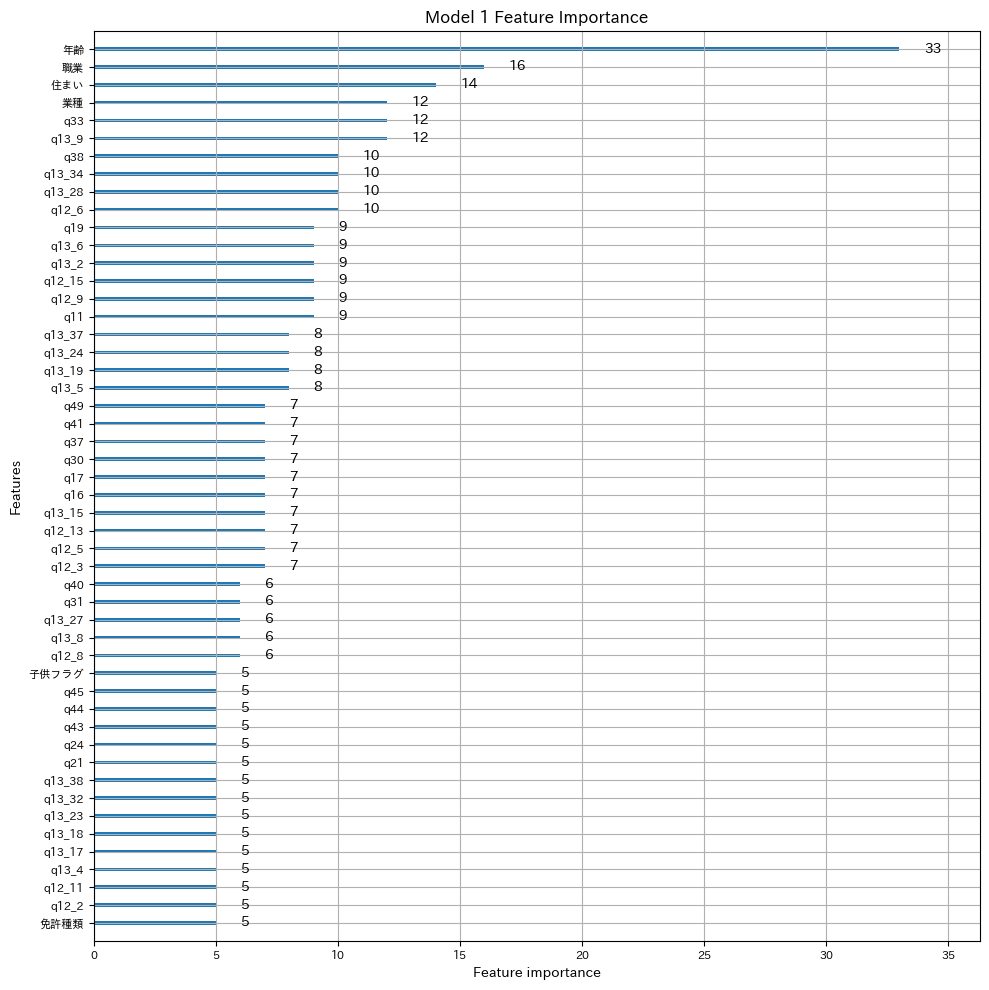

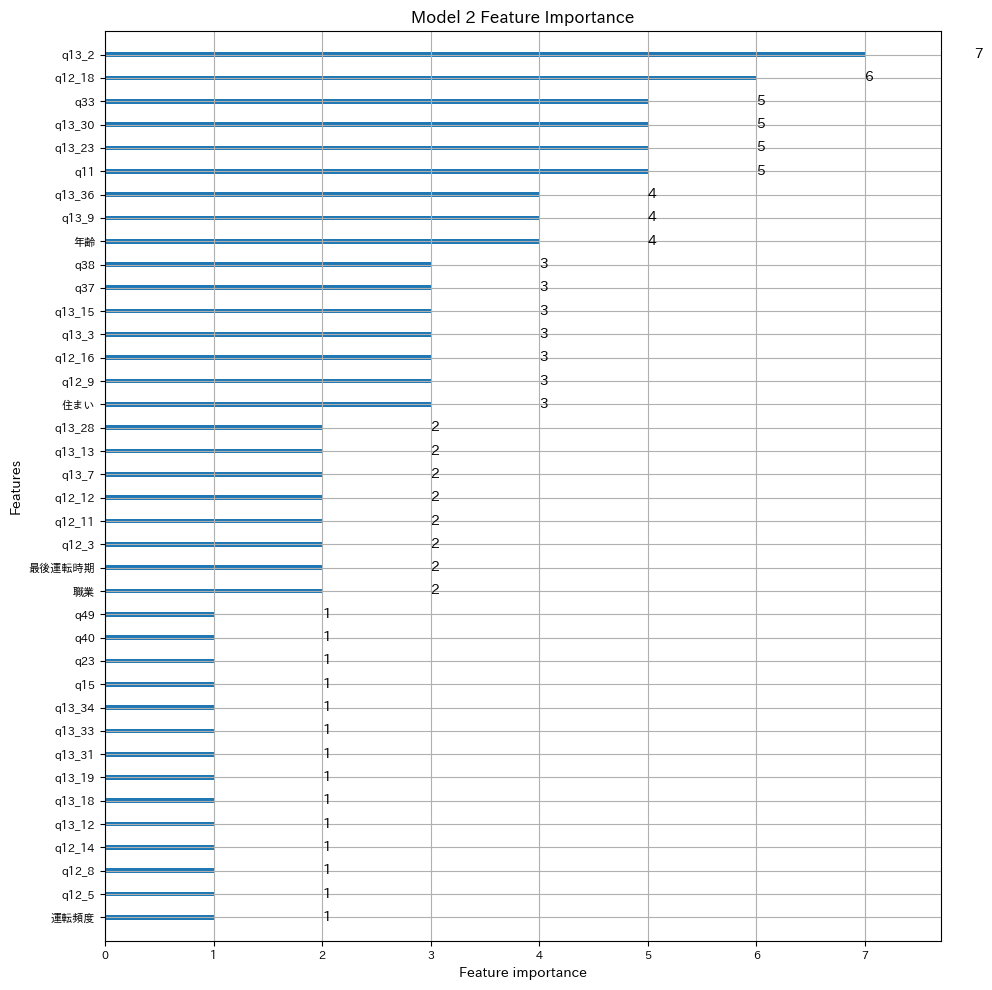

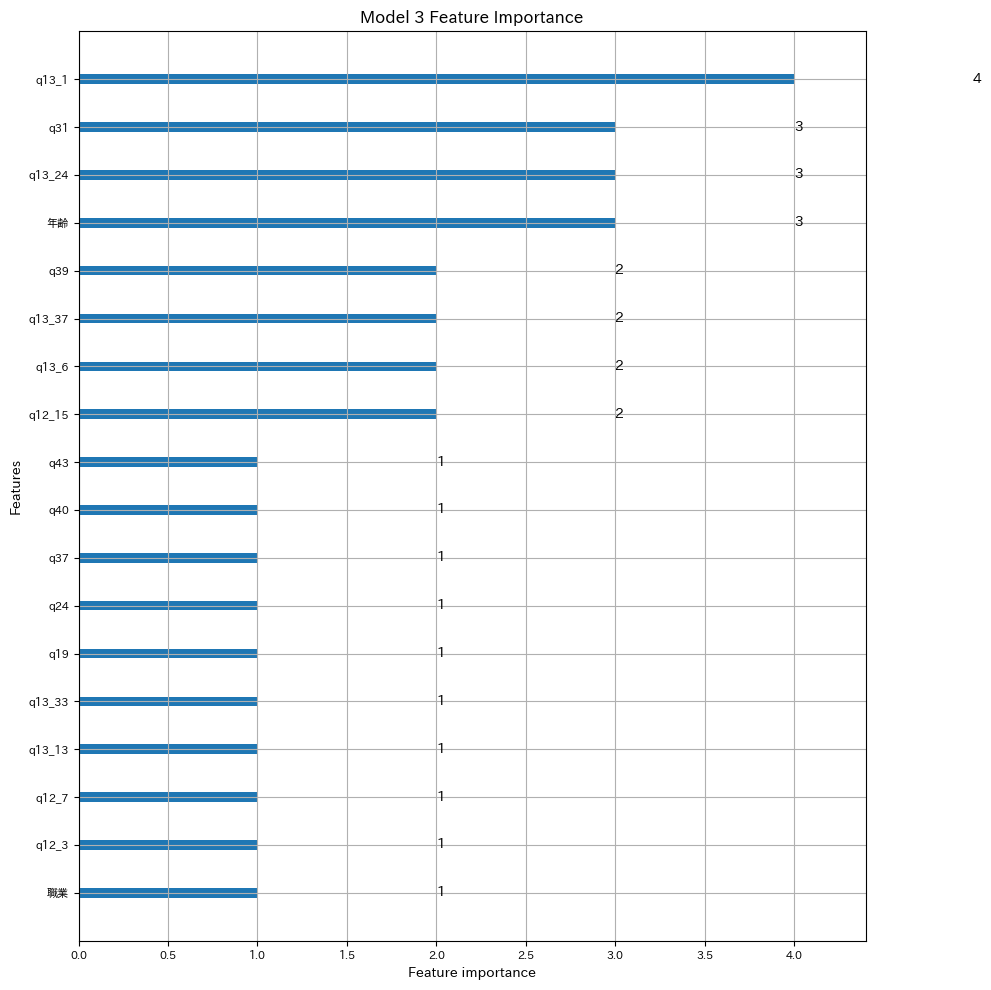

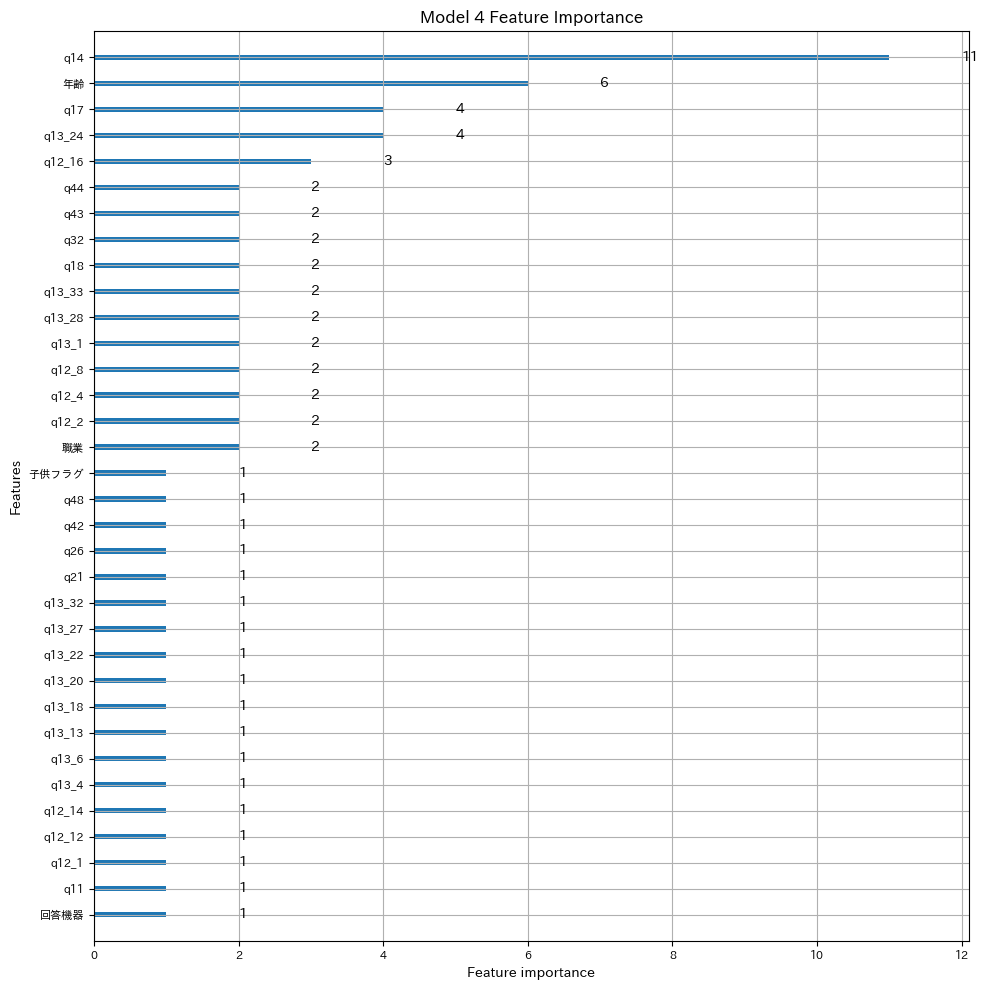

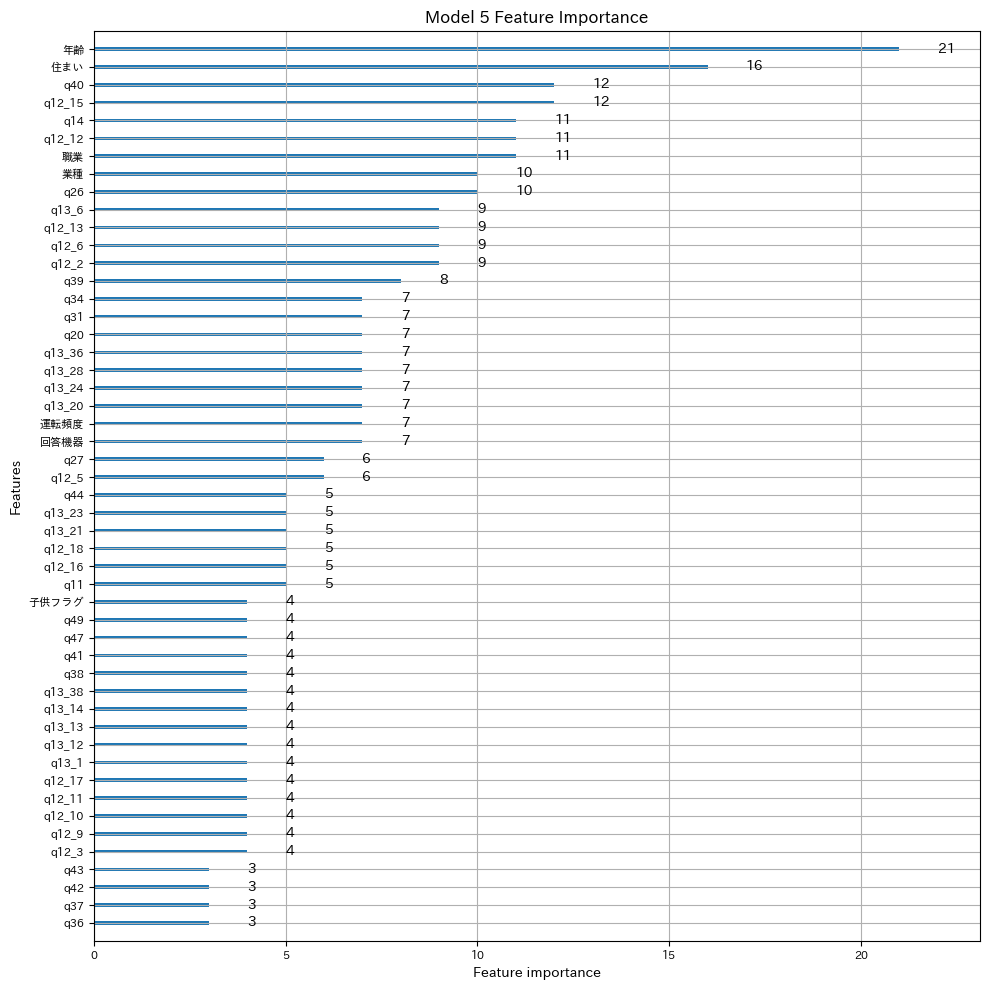

...

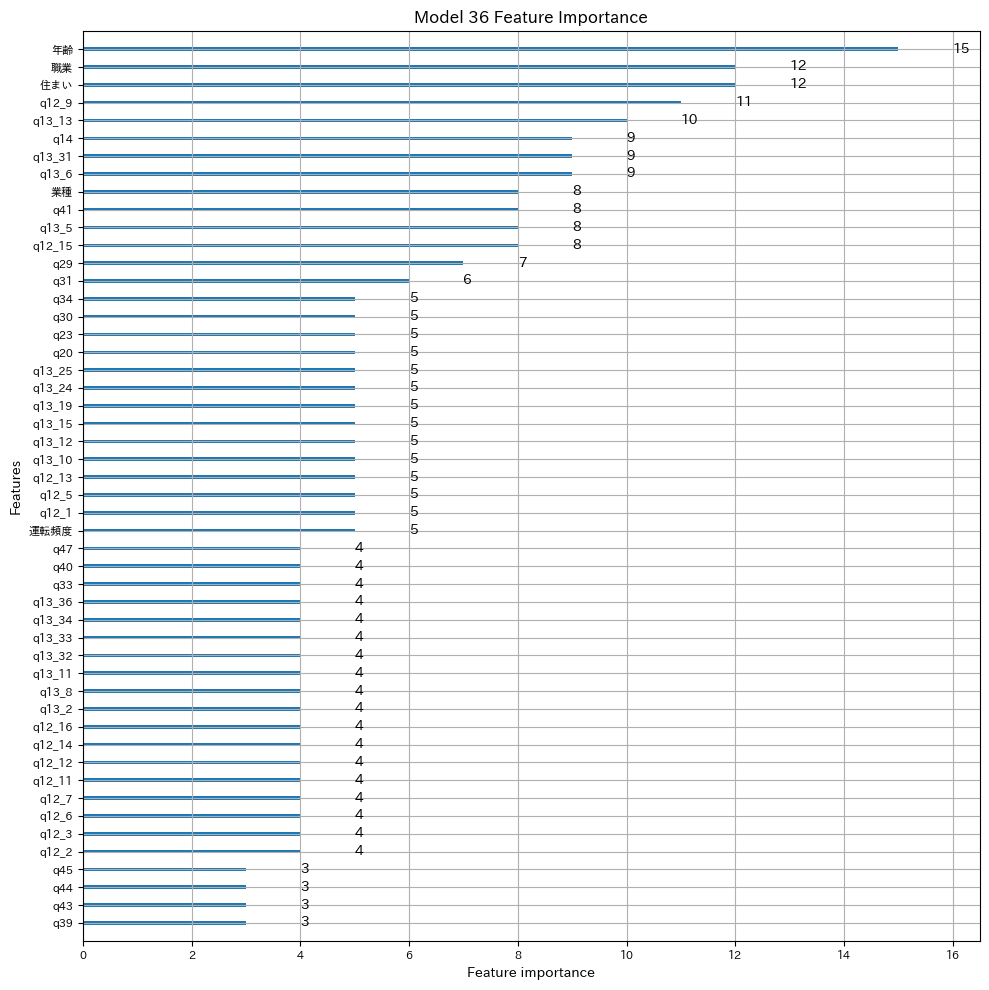

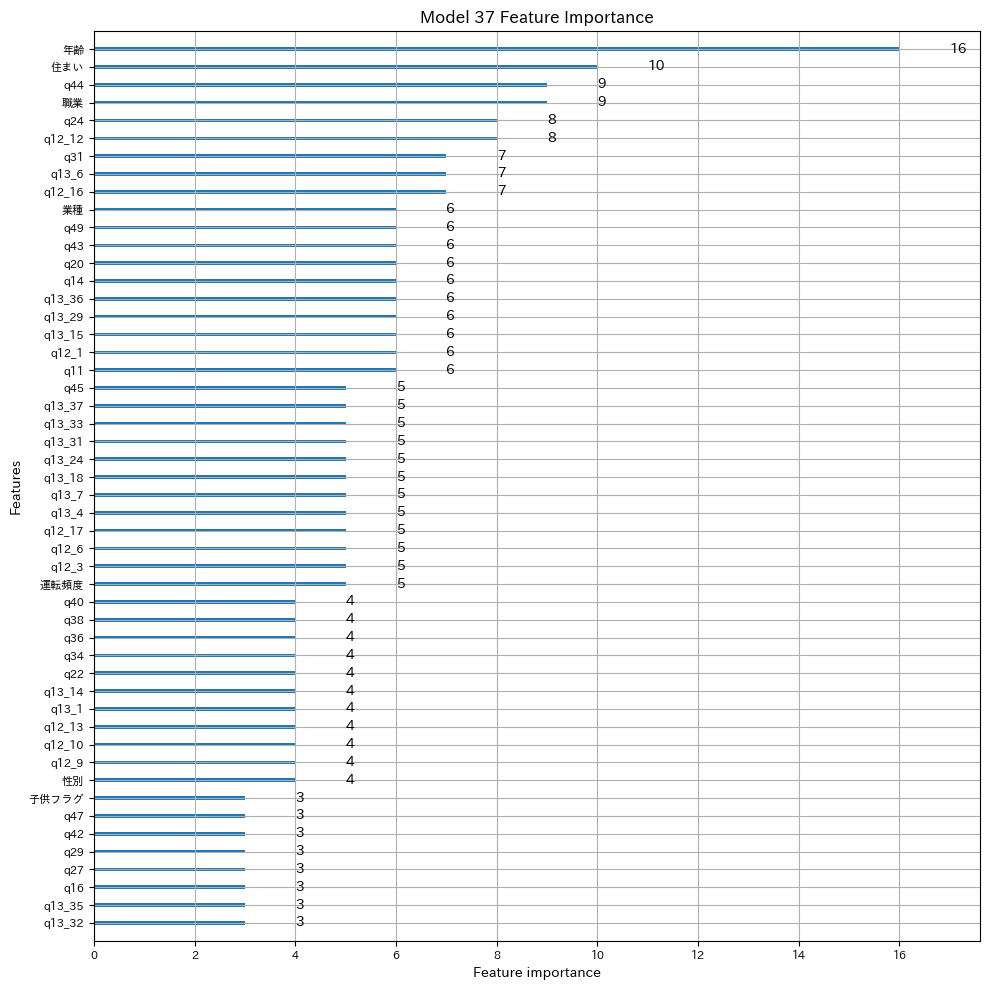

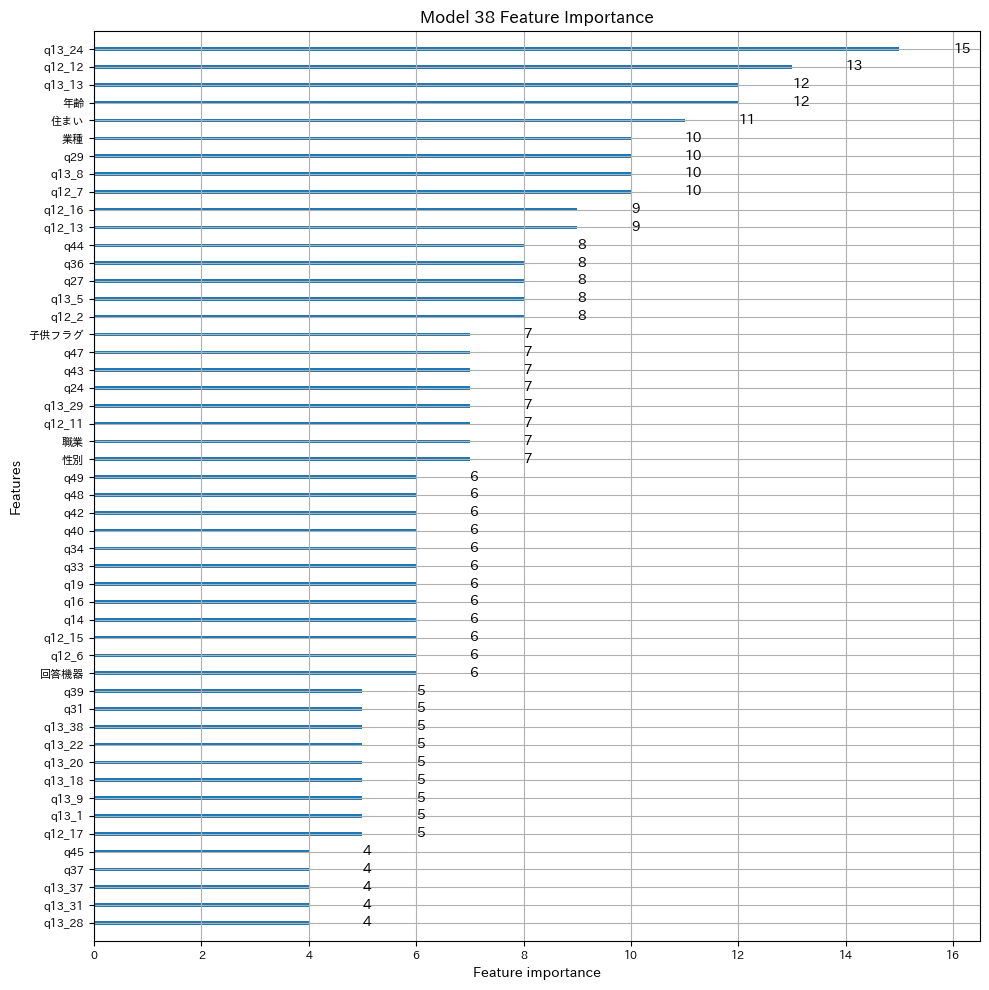

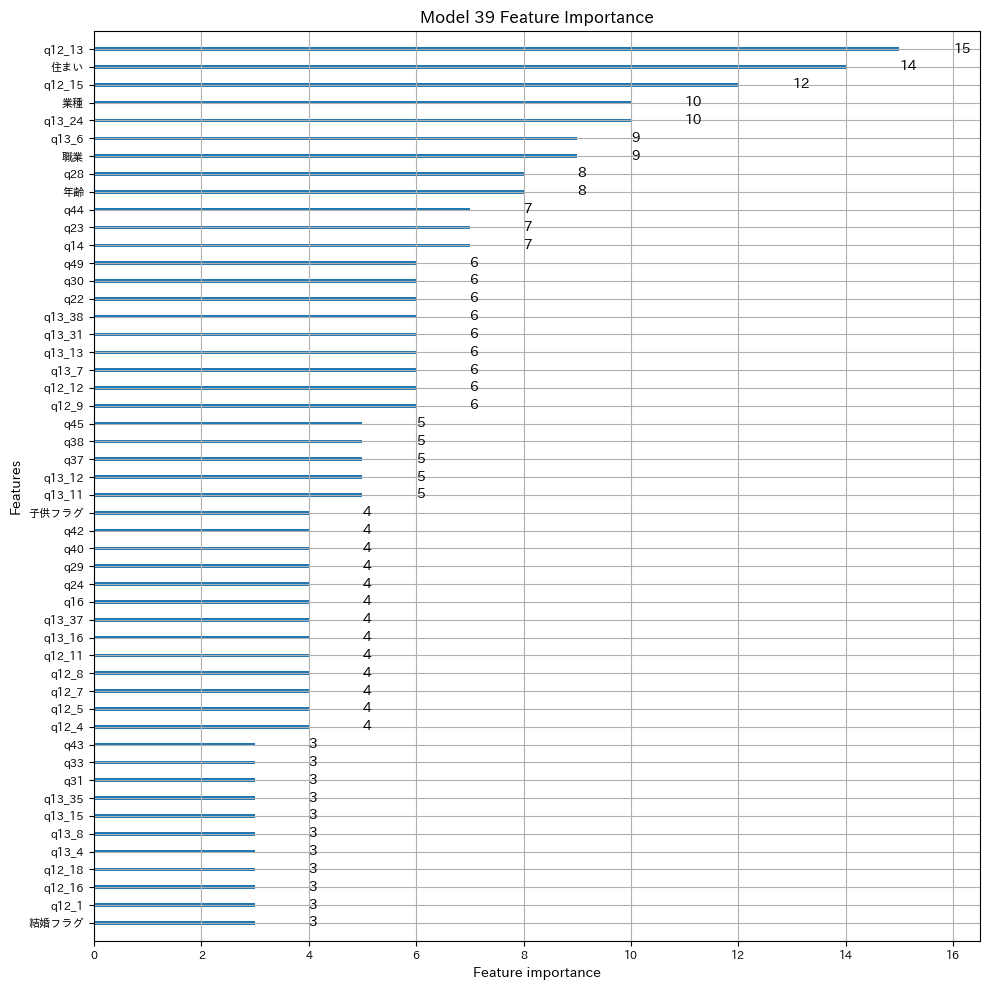

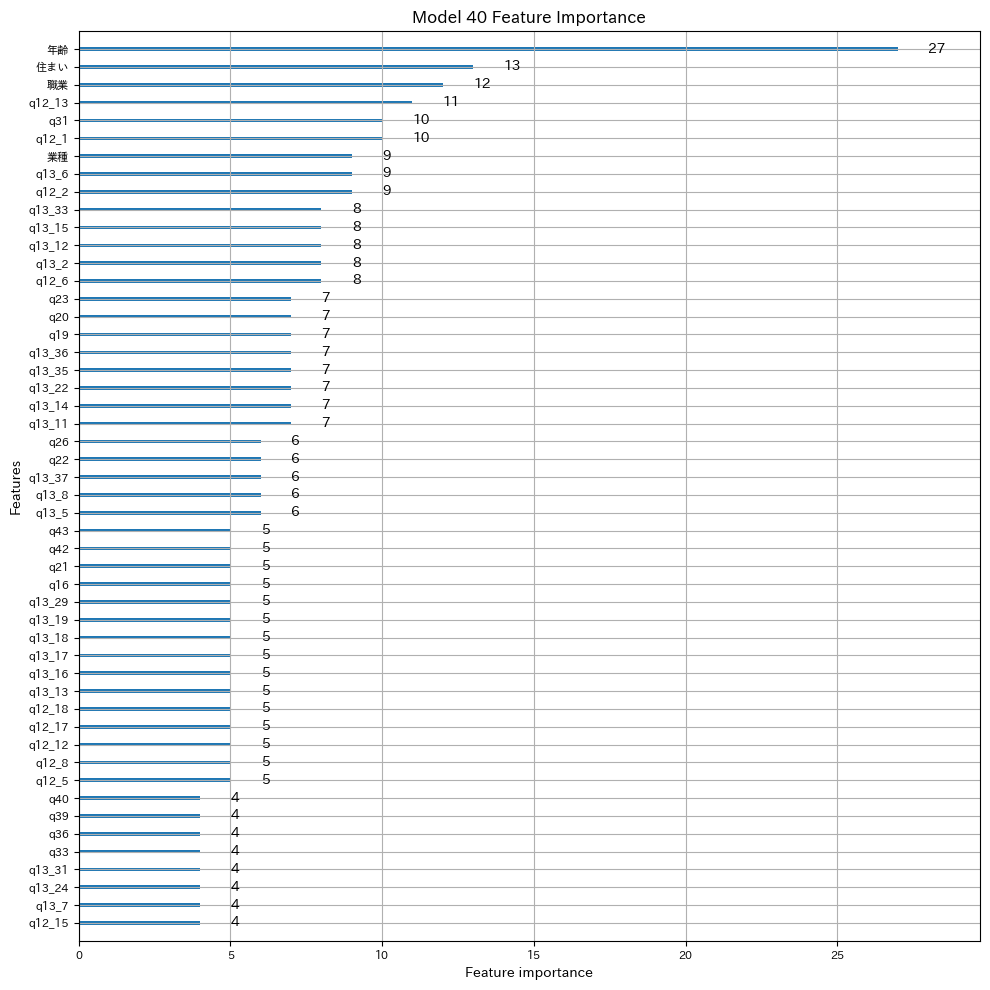

In [29]:
# 特徴量の重要度をプロット
import japanize_matplotlib  # 日本語化matplotlib
for i in range(len(models)):
    model = models[i]
    
    # lgb.plot_importanceの呼び出し、fontsizeオプションで文字を小さく設定
    ax = lgb.plot_importance(model, max_num_features=50, figsize=(10, 10))  # max_num_featuresで上位の特徴量のみ表示（必要に応じて調整）
    ax.tick_params(labelsize=8)  # 文字サイズを小さくする
    
    plt.title(f'Model {i+1} Feature Importance', fontsize=12)  # タイトルを追加
    plt.tight_layout()  # レイアウトを自動調整
    plt.show()


Model 1 SHAP Values: [[ 0.00066117 -0.07071052  0.00241015 ... -0.01239997  0.00188335
  -0.0120129 ]
 [-0.00041713  0.02050706 -0.00455045 ...  0.02230289 -0.00287127
  -0.00174644]
 [-0.0002978   0.02409599 -0.00873946 ...  0.02009245 -0.00143627
   0.00659055]
 ...
 [ 0.01418339  0.04531792  0.01105874 ...  0.00519171  0.00158487
   0.01434952]
 [-0.00118453  0.04213232  0.01325813 ...  0.03561644  0.00225107
   0.00598578]
 [ 0.00522922  0.03884484 -0.02214995 ...  0.0019826   0.00150188
   0.01115458]] (804, 108)


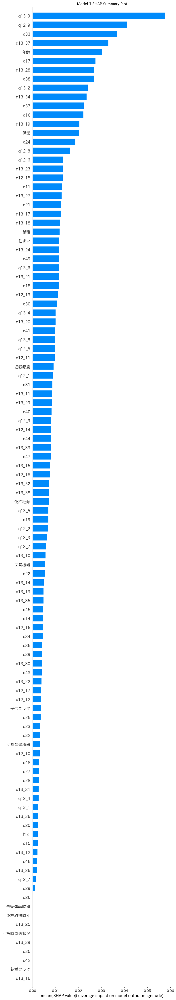

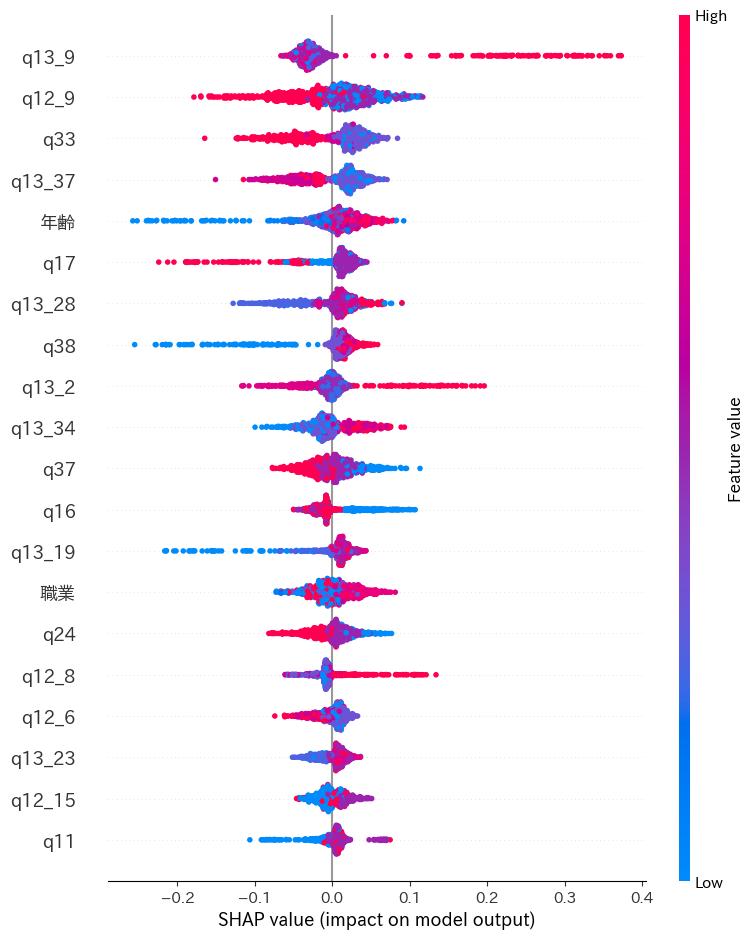

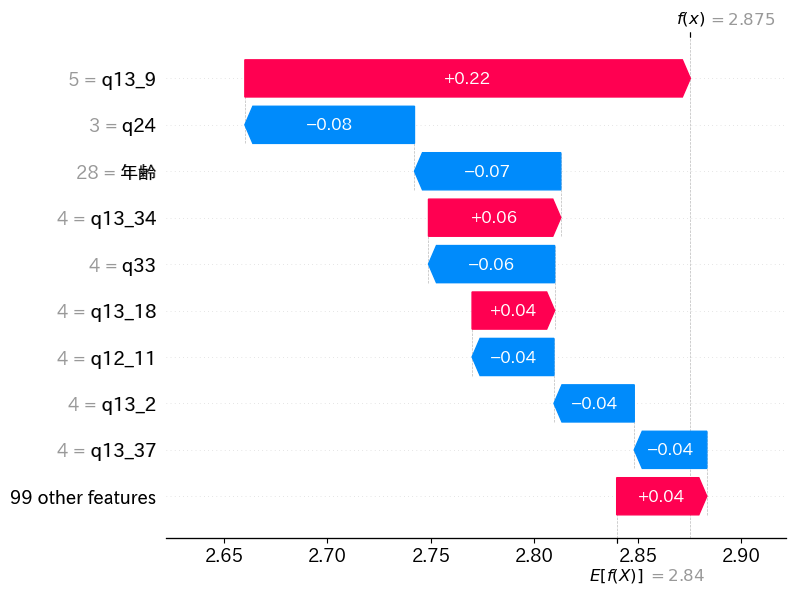

Model 2 SHAP Values: [[ 0.          0.00895896 -0.01800882 ... -0.01433605  0.
   0.        ]
 [ 0.          0.00895896  0.04954832 ...  0.01004652  0.
   0.        ]
 [ 0.          0.00895896 -0.01800882 ...  0.01004652  0.
   0.        ]
 ...
 [ 0.          0.00895896 -0.01800882 ...  0.01004652  0.
   0.        ]
 [ 0.          0.00895896  0.00411586 ...  0.01004652  0.
   0.        ]
 [ 0.          0.00895896  0.00411586 ...  0.01004652  0.
   0.        ]] (804, 108)


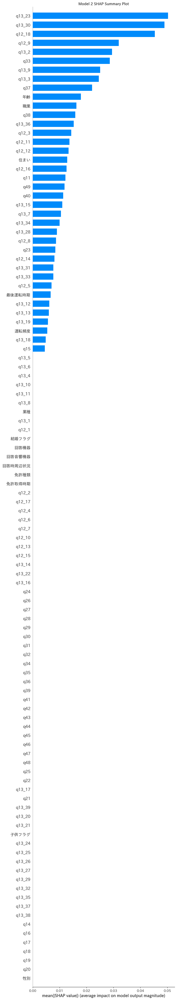

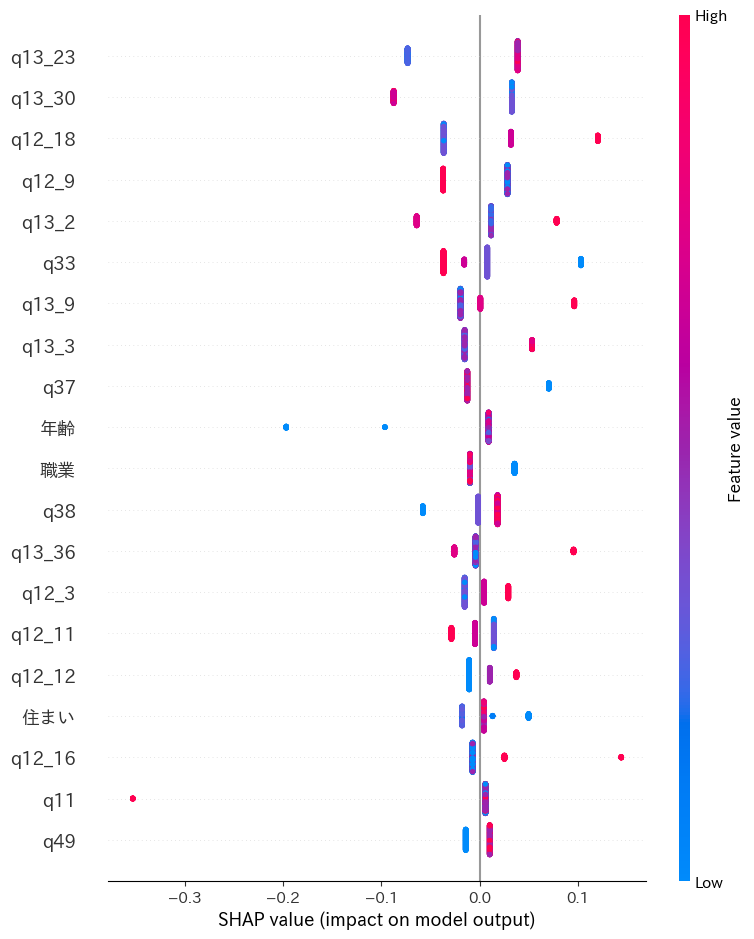

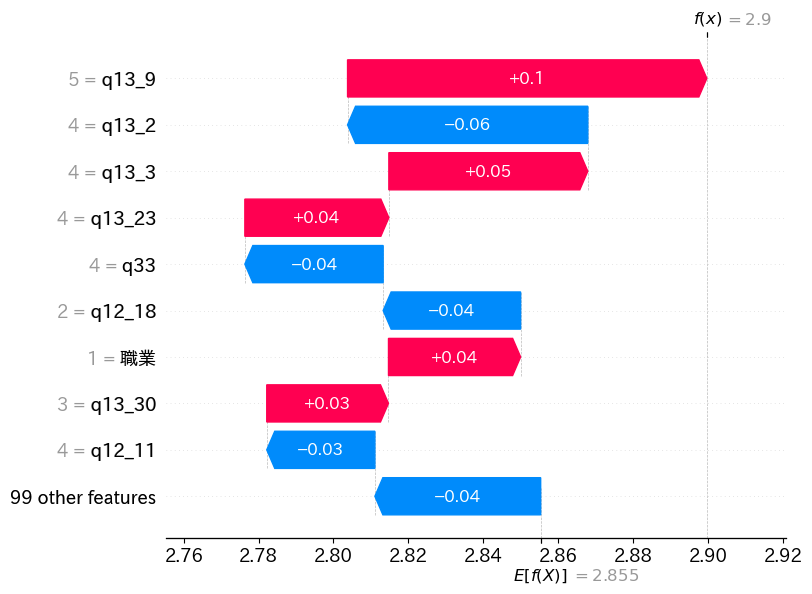

Model 3 SHAP Values: [[ 0.         -0.05605789  0.         ...  0.          0.
   0.        ]
 [ 0.         -0.05605789  0.         ...  0.          0.
   0.        ]
 [ 0.         -0.05605789  0.         ...  0.          0.
   0.        ]
 ...
 [ 0.          0.06407729  0.         ...  0.          0.
   0.        ]
 [ 0.          0.06407729  0.         ...  0.          0.
   0.        ]
 [ 0.          0.06407729  0.         ...  0.          0.
   0.        ]] (804, 108)


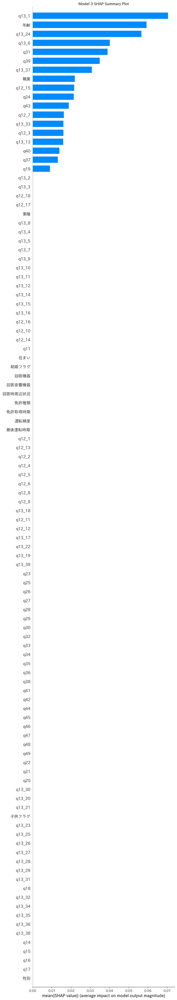

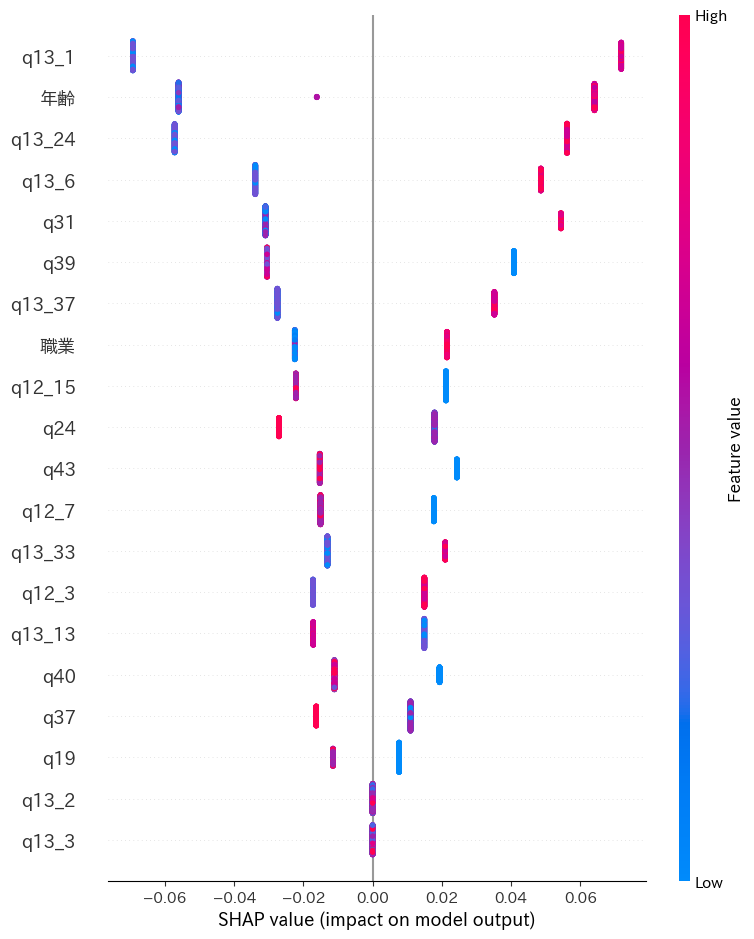

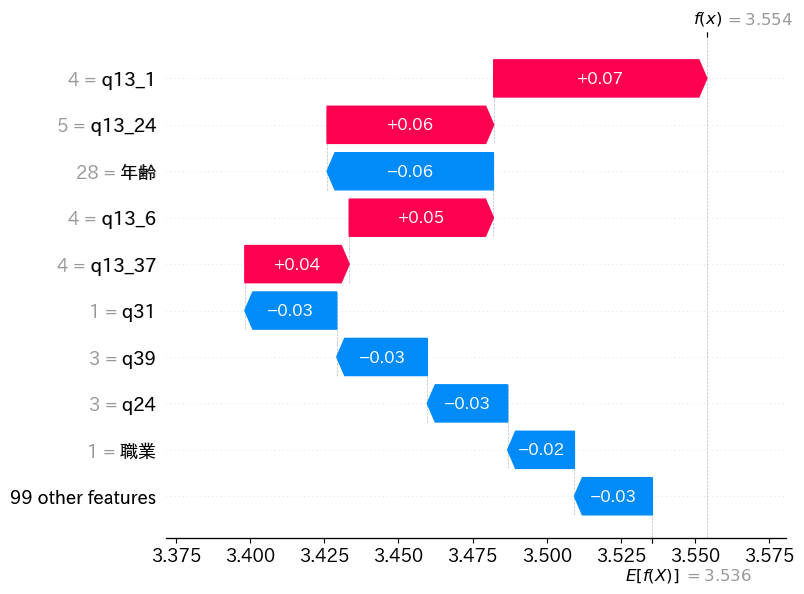

Model 4 SHAP Values: [[ 0.         -0.00617015  0.         ...  0.         -0.00937252
   0.        ]
 [ 0.         -0.01985654  0.         ...  0.          0.00559804
   0.        ]
 [ 0.         -0.07753361  0.         ...  0.          0.01874504
   0.        ]
 ...
 [ 0.          0.02008835  0.         ...  0.         -0.00346409
   0.        ]
 [ 0.          0.10949127  0.         ...  0.         -0.00251307
   0.        ]
 [ 0.          0.02008835  0.         ...  0.         -0.00937252
   0.        ]] (804, 108)


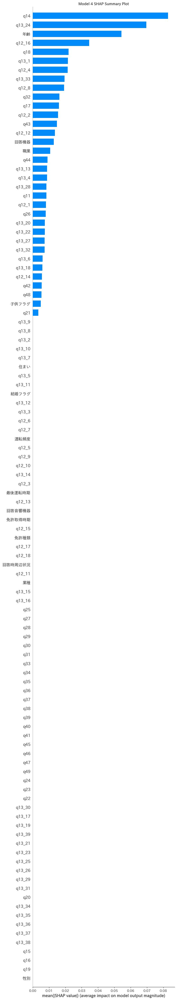

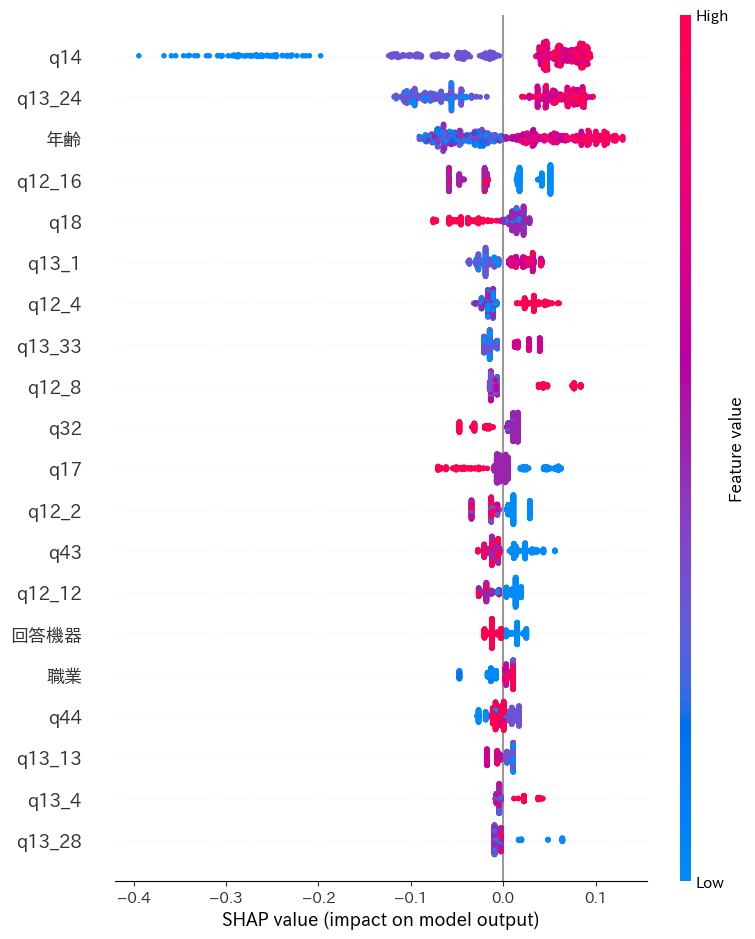

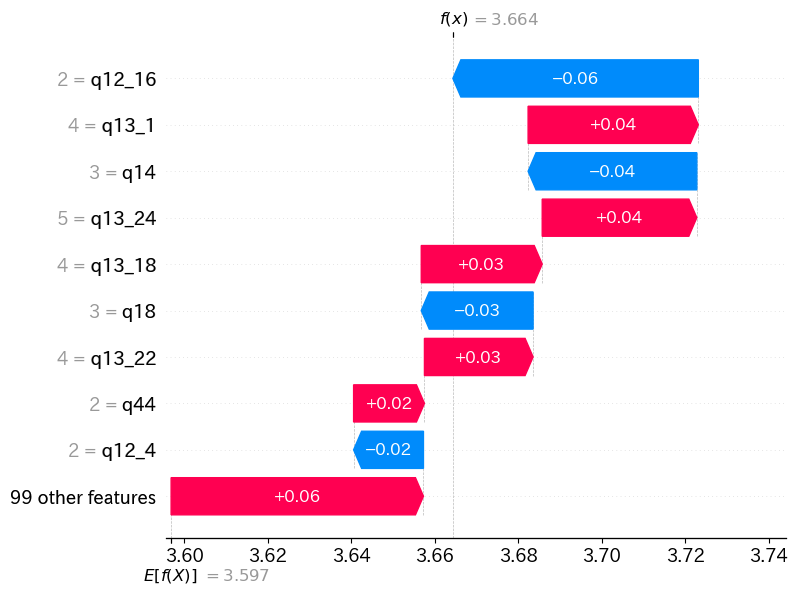

Model 5 SHAP Values: [[-1.02466260e-02 -3.44673293e-02 -7.36651962e-03 ...  1.49867110e-03
  -1.02819344e-02  1.12202124e-02]
 [-4.27172096e-03 -5.20541204e-02  1.16719271e-02 ... -1.34281929e-02
   5.01026133e-03  2.99772155e-02]
 [-4.37684401e-03 -3.31290400e-02  4.65215574e-03 ... -4.21322060e-05
   5.10137913e-03 -2.80781660e-02]
 ...
 [ 5.90232817e-03  6.61314783e-02  6.04179498e-03 ... -1.30987059e-03
  -3.25551449e-02 -2.43361856e-02]
 [ 1.01383097e-02  5.95928242e-02 -1.56545711e-03 ...  4.43645234e-03
   6.59292027e-03  3.55456616e-04]
 [ 5.19524852e-03  4.55301832e-02 -1.94179208e-03 ... -8.10591540e-04
   3.07886845e-03 -5.12737397e-03]] (804, 108)


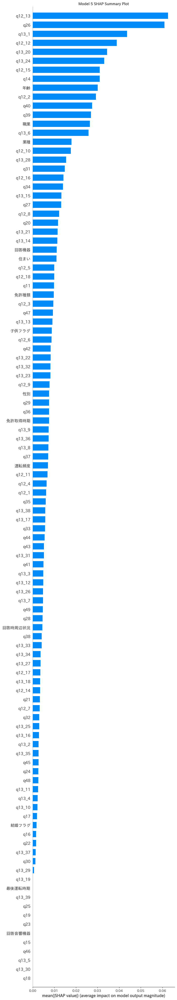

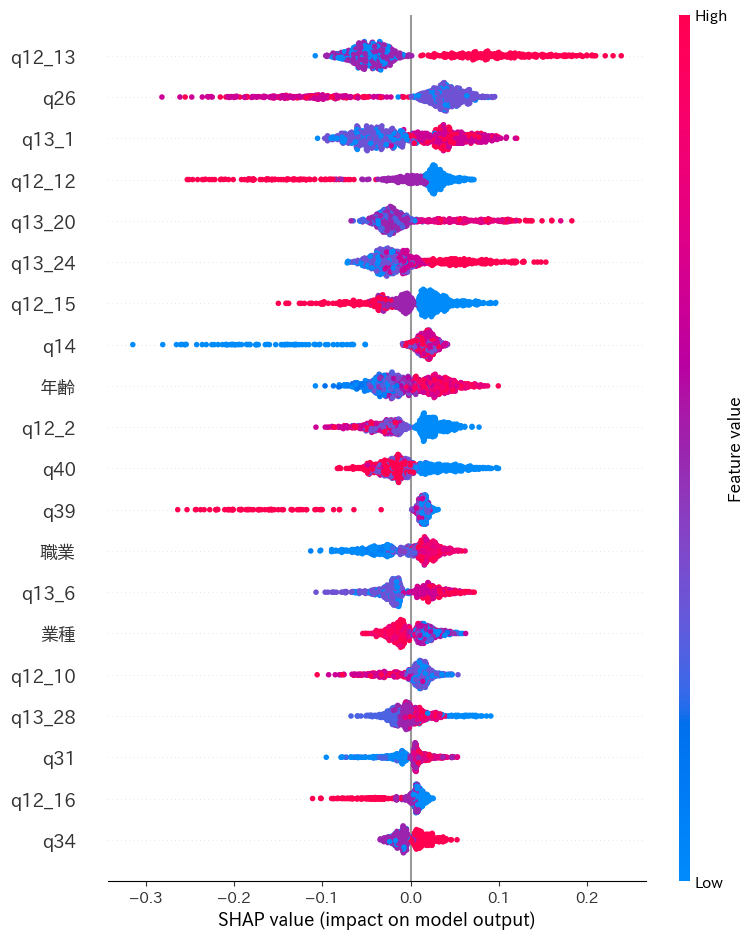

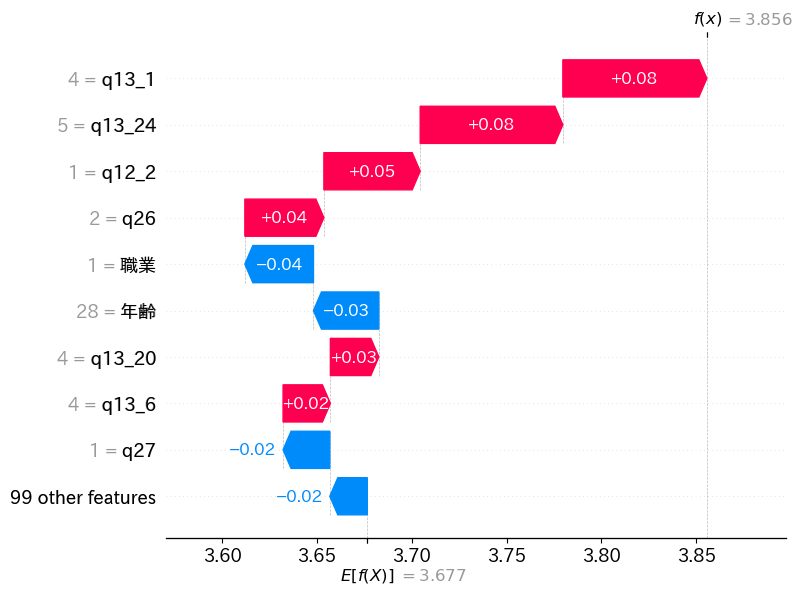

Model 6 SHAP Values: [[ 0.         -0.0826536  -0.00943334 ... -0.03042621 -0.00309749
  -0.00868379]
 [ 0.         -0.08242008 -0.03251435 ...  0.07558515  0.02978184
  -0.00428495]
 [ 0.         -0.13669821 -0.03251435 ...  0.04362015  0.01088484
  -0.00428495]
 ...
 [ 0.          0.12108324 -0.01415928 ... -0.0249667  -0.01563547
   0.00288262]
 [ 0.          0.12376771 -0.0073816  ...  0.02804484 -0.01563547
   0.00830821]
 [ 0.          0.01631434  0.00939671 ... -0.01514346 -0.00495599
   0.01128892]] (804, 108)


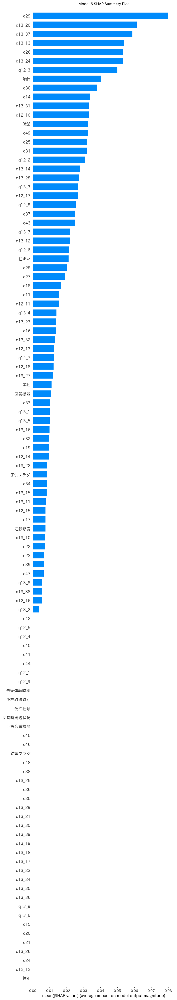

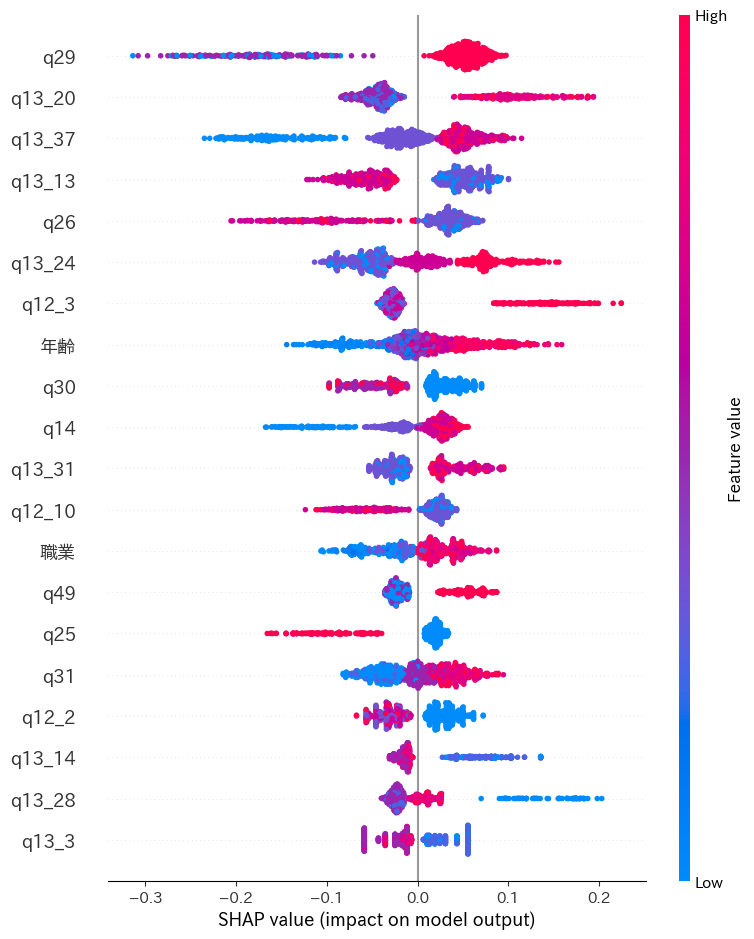

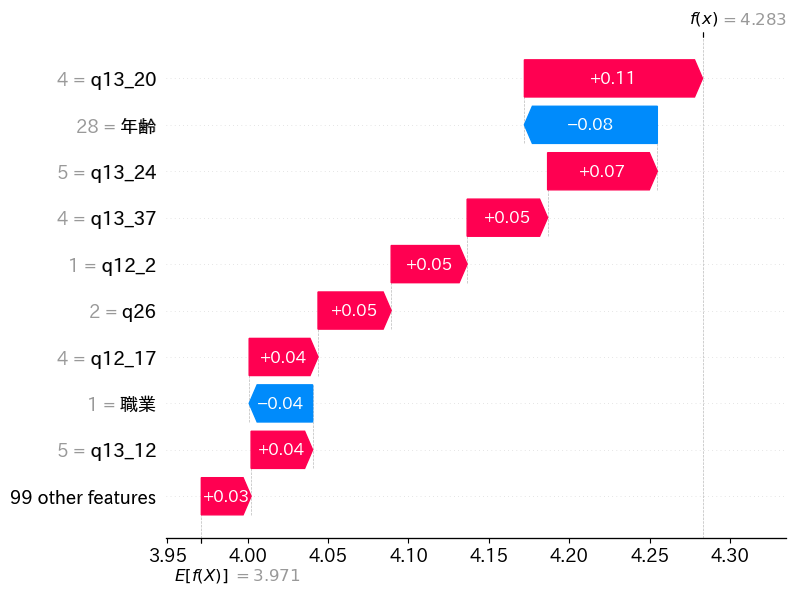

Model 7 SHAP Values: [[-0.01251422 -0.09086709 -0.01880549 ... -0.00158249  0.00104699
   0.00415345]
 [-0.00356657 -0.04998629 -0.007371   ...  0.00035516 -0.00101575
   0.01758282]
 [-0.00480582 -0.01046782 -0.02511869 ...  0.00023255 -0.00190338
  -0.00542605]
 ...
 [ 0.02083489  0.03556547 -0.04150673 ...  0.00041186  0.00171074
  -0.00527437]
 [ 0.02317479  0.04903985  0.03250038 ...  0.00038782  0.00165546
  -0.00604435]
 [ 0.00993419  0.03713319  0.0219824  ...  0.00038095  0.00216406
  -0.0100685 ]] (804, 108)


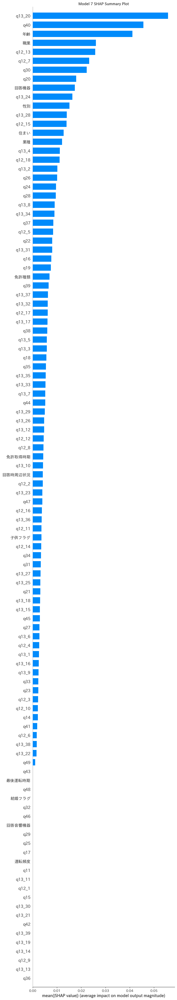

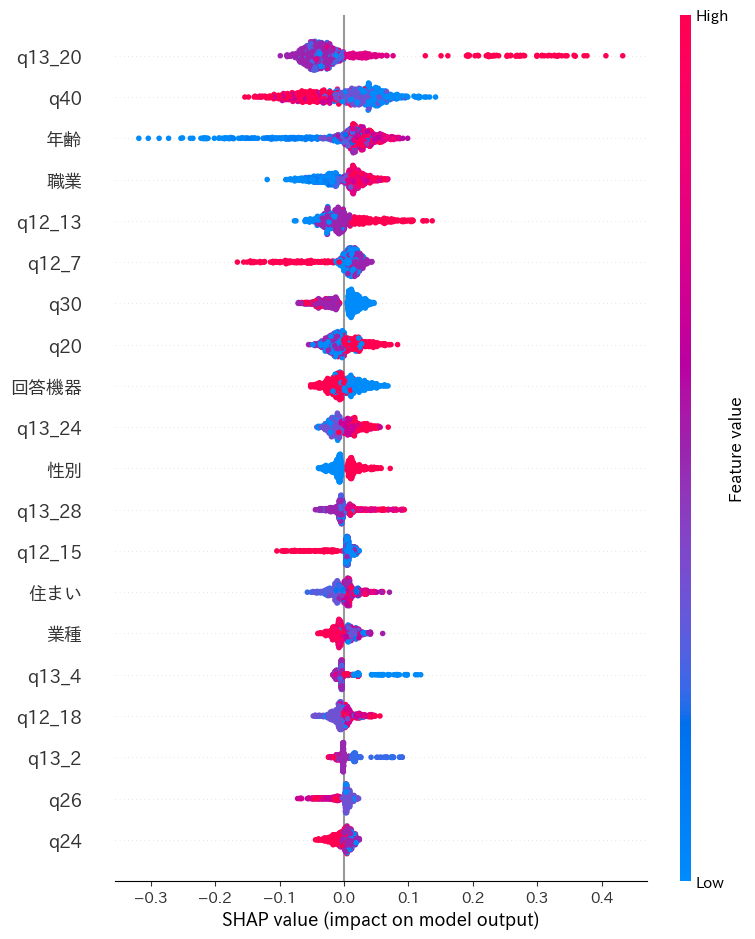

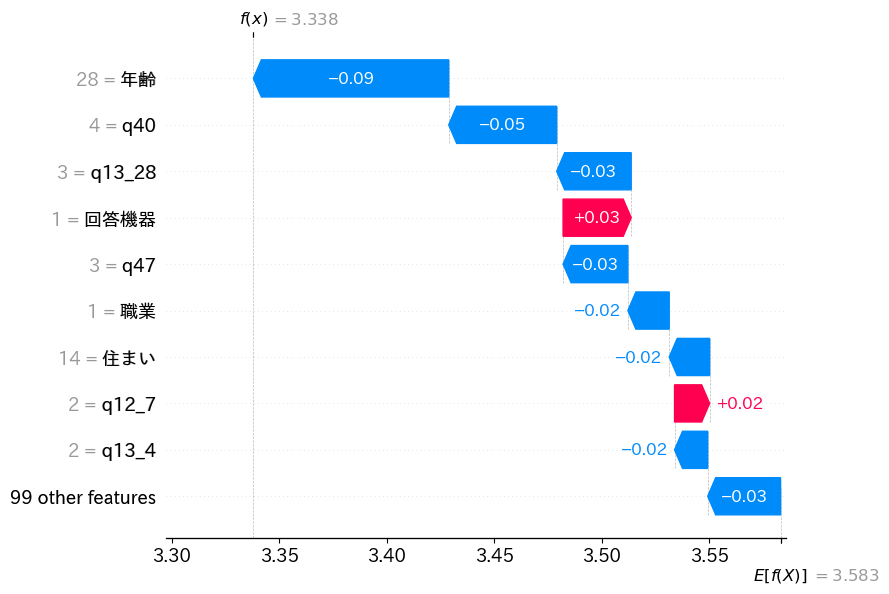

Model 8 SHAP Values: [[ 0.00000000e+00 -3.82149571e-02 -3.13179154e-03 ... -5.02569578e-03
  -6.08053466e-04  1.21488077e-02]
 [ 0.00000000e+00 -1.83546088e-02  3.11780315e-03 ...  6.77700530e-03
   1.00912245e-03  2.36662089e-02]
 [ 0.00000000e+00 -4.67208327e-02  2.28352399e-02 ...  6.54491761e-03
   1.50584917e-03 -3.34852272e-03]
 ...
 [ 0.00000000e+00  6.75365319e-02  1.45390428e-03 ...  5.69388621e-05
  -2.90533694e-03 -6.68399614e-03]
 [ 0.00000000e+00  7.70151580e-02  1.52912802e-02 ...  1.27018613e-02
  -5.72173496e-03 -3.90046255e-03]
 [ 0.00000000e+00  1.26847224e-01 -4.11134214e-03 ...  1.44135817e-03
  -1.03523609e-02 -1.05058568e-02]] (804, 108)


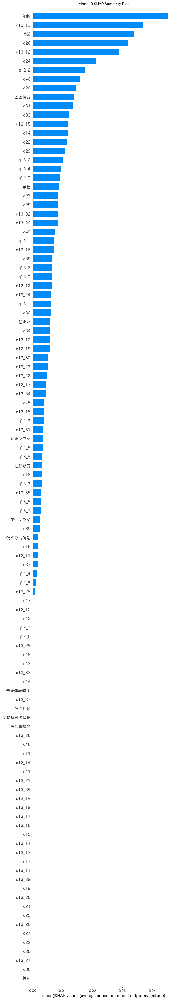

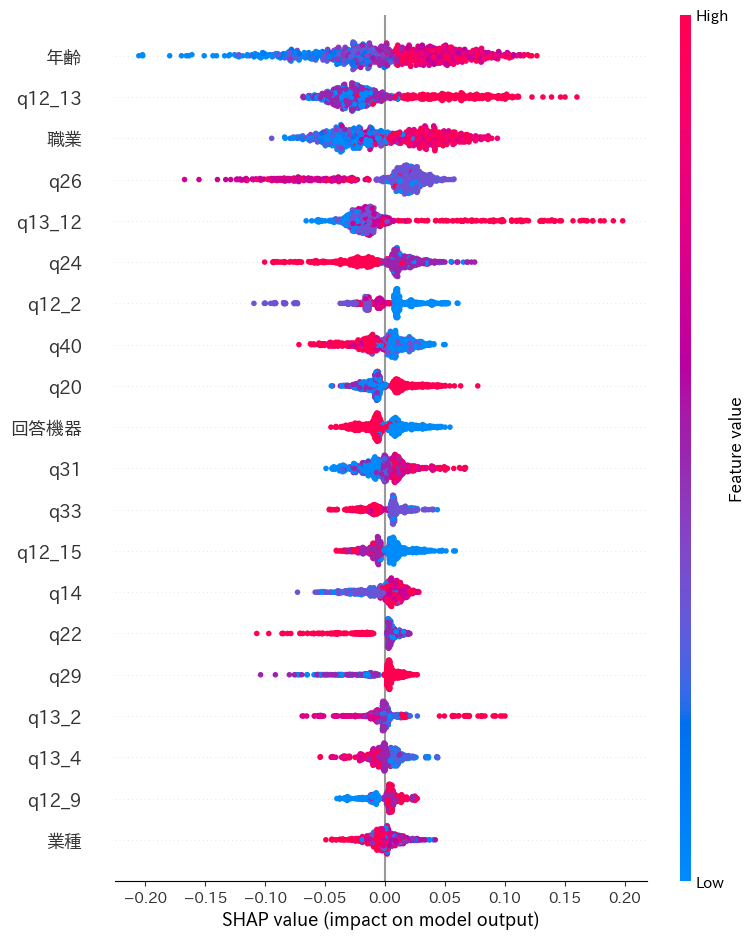

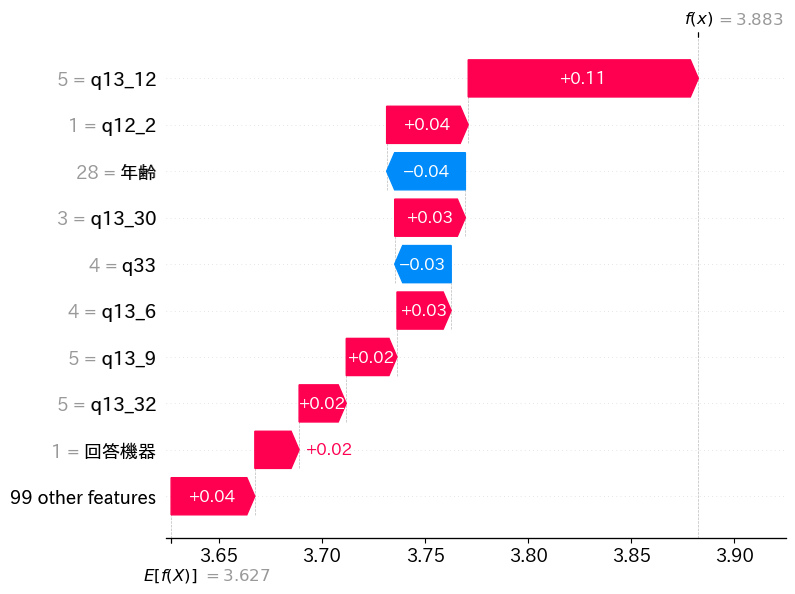

Model 9 SHAP Values: [[ 1.63125093e-02 -9.84812362e-03 -9.42188510e-04 ...  7.26000707e-04
  -2.07269730e-04  9.99786499e-04]
 [ 2.17670342e-03 -7.93825772e-03 -2.06091522e-03 ...  5.32838736e-03
   1.83945416e-04 -6.61649813e-04]
 [ 3.81107318e-03 -7.95884357e-03 -4.34072854e-04 ... -9.92341267e-03
   1.83888863e-04 -1.74640042e-03]
 ...
 [ 7.74842262e-05  3.17584083e-02 -5.94596258e-04 ...  1.10650888e-02
  -7.12466190e-04  3.22337543e-04]
 [ 1.18343480e-03  2.67060655e-02  2.85226937e-03 ... -2.50614406e-04
   1.38670660e-03  2.60303847e-04]
 [ 9.80536629e-04  3.33023898e-02  1.32695707e-03 ...  1.00735093e-02
   1.72711333e-03  2.19970620e-03]] (804, 108)


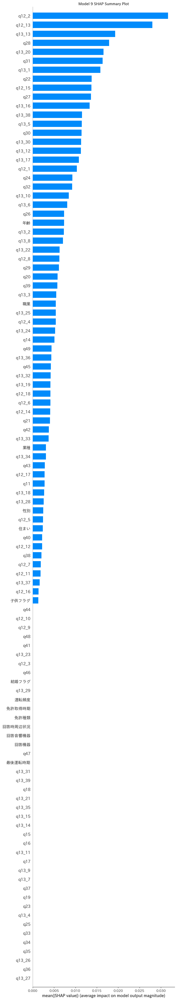

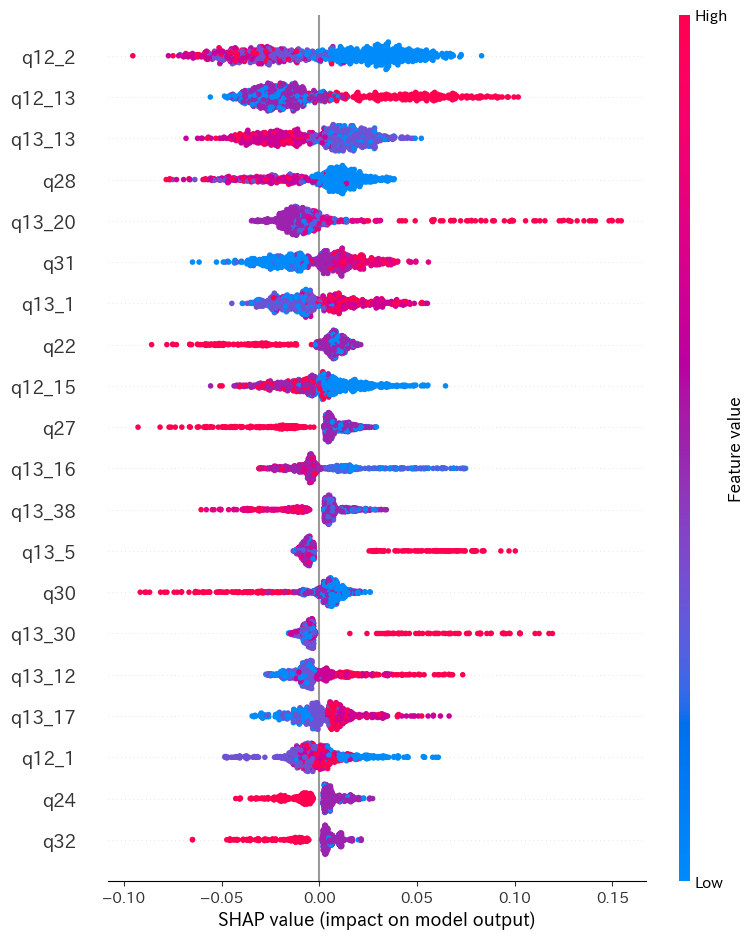

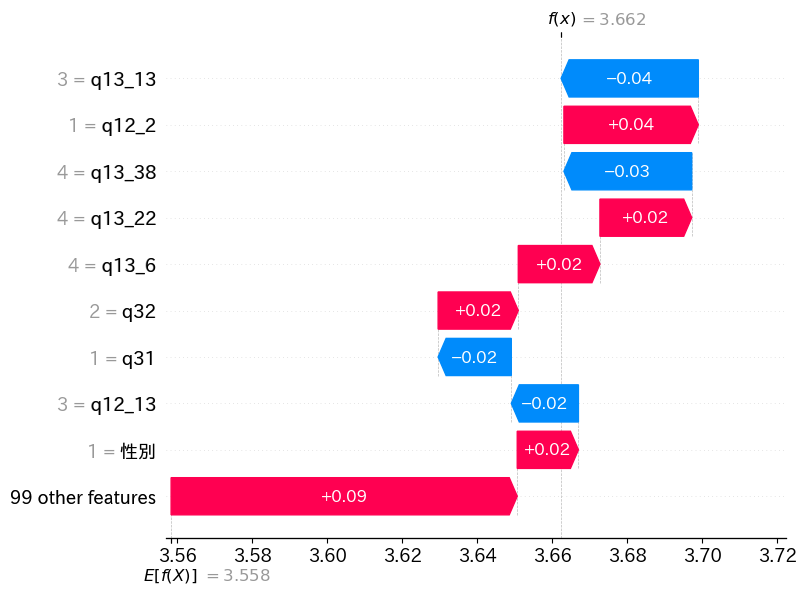

Model 10 SHAP Values: [[-0.00431944 -0.08996011  0.00310499 ... -0.00462104 -0.0041064
   0.01090202]
 [-0.00255172 -0.0755779  -0.00684004 ...  0.01270771  0.02437832
   0.00297607]
 [-0.00163325 -0.09451431 -0.00493506 ...  0.02381572  0.00559006
  -0.01254725]
 ...
 [ 0.01312235  0.03267128  0.01206614 ...  0.02502262 -0.00205694
  -0.00816582]
 [ 0.00451343  0.03790332  0.00037618 ...  0.01298879 -0.00558492
  -0.02225334]
 [ 0.00278553  0.0319195  -0.00084514 ...  0.00765801 -0.00722483
   0.00324431]] (804, 108)


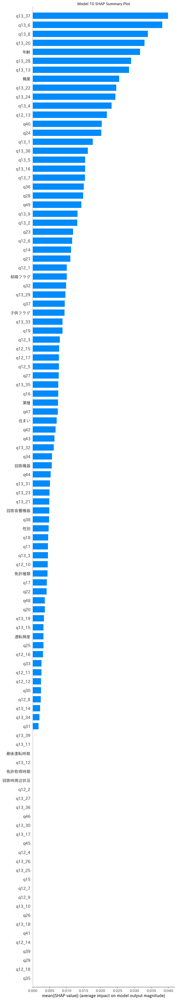

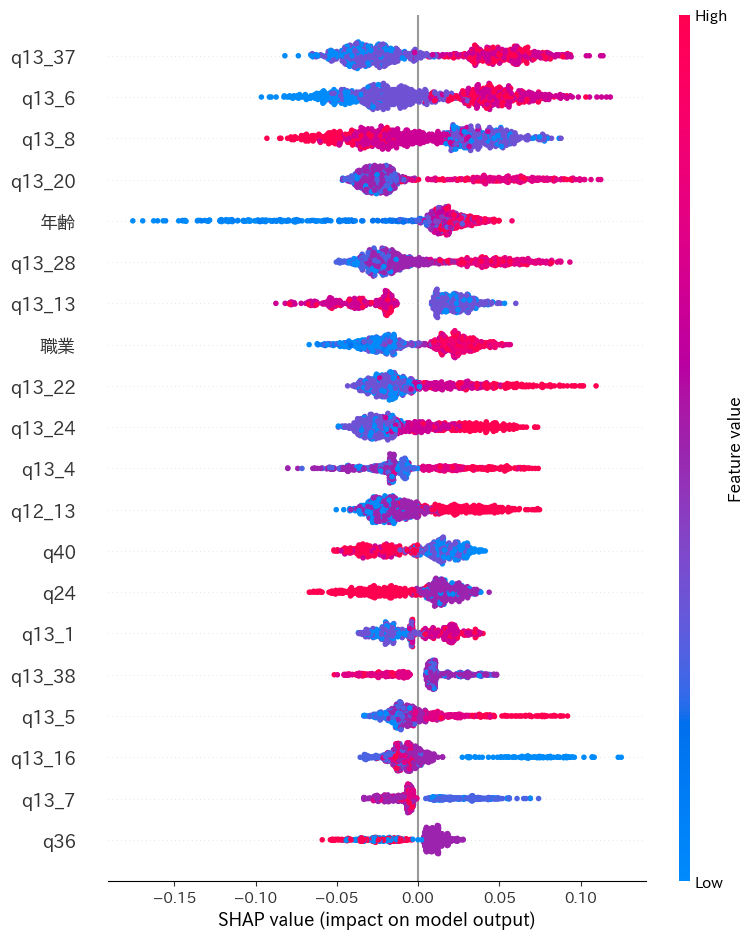

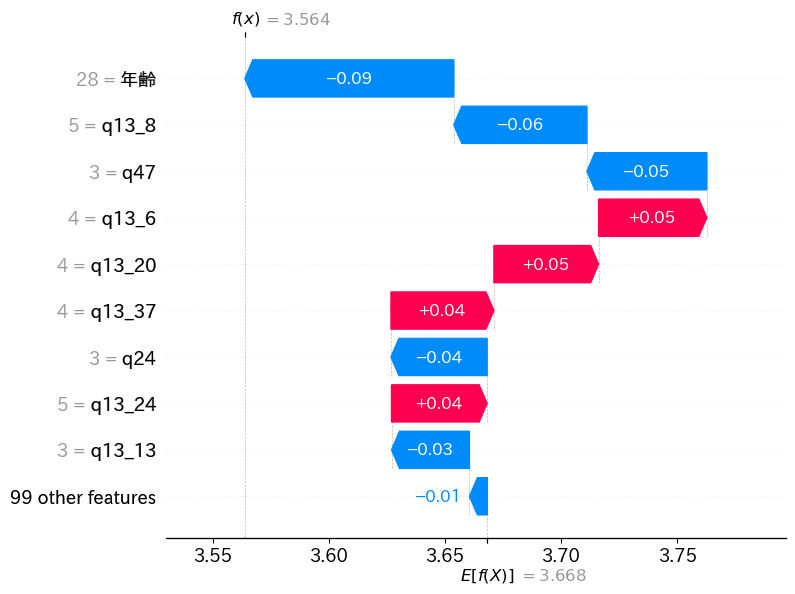

Model 11 SHAP Values: [[ 0.         -0.04002365 -0.0087544  ...  0.         -0.02387685
   0.00493067]
 [ 0.         -0.07244478 -0.0193206  ...  0.          0.02540719
   0.01358638]
 [ 0.         -0.0389153  -0.01559618 ...  0.          0.02106183
  -0.00772111]
 ...
 [ 0.          0.04518026 -0.03220048 ...  0.         -0.01306462
  -0.00510328]
 [ 0.         -0.0020537   0.01435442 ...  0.          0.01111934
  -0.00556636]
 [ 0.          0.03356203  0.00752323 ...  0.          0.00716485
  -0.00528042]] (804, 108)


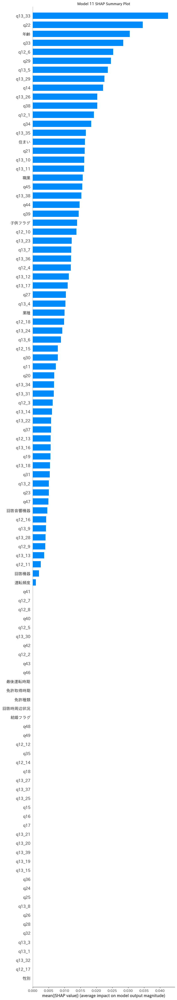

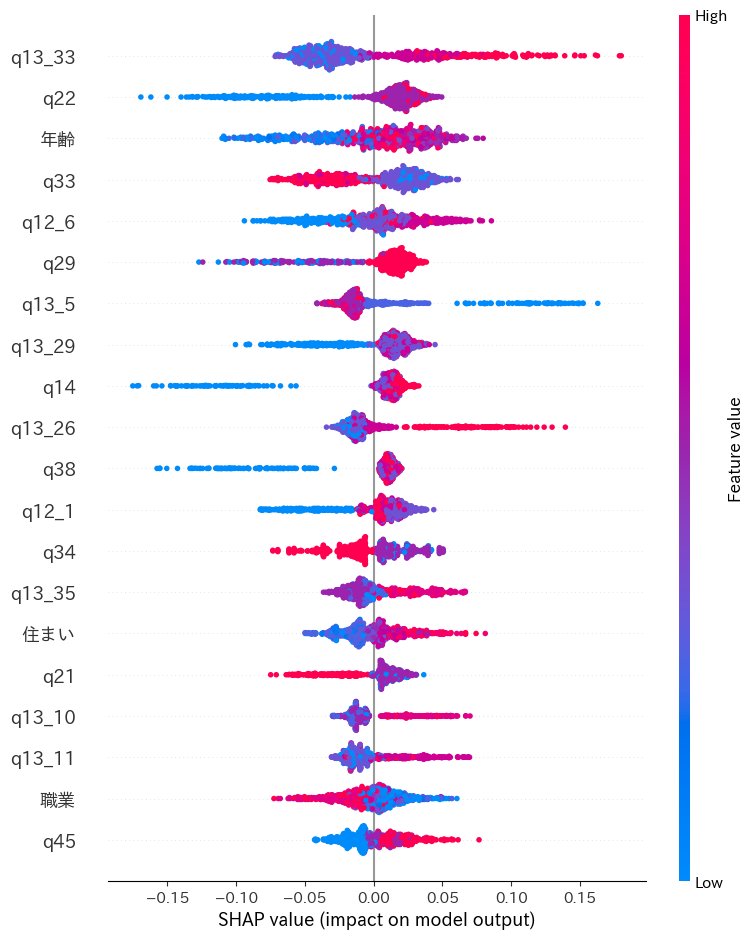

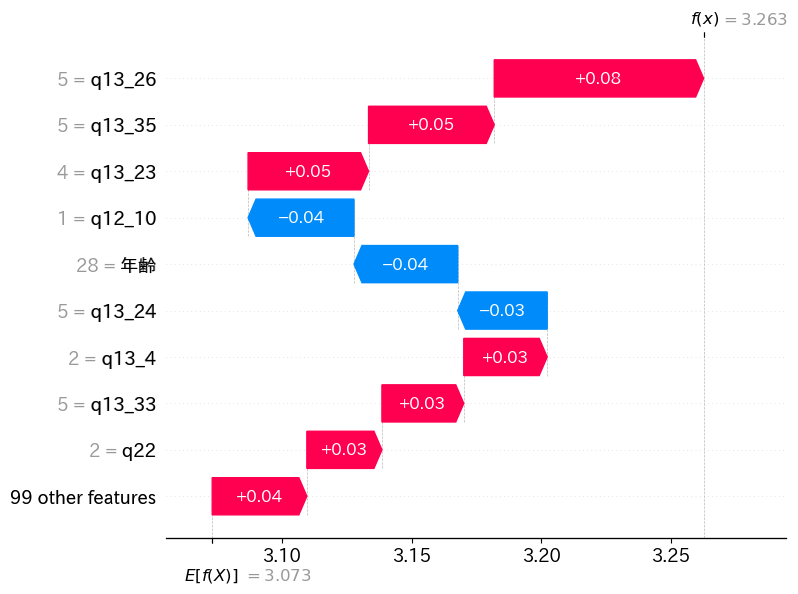

Model 12 SHAP Values: [[-2.79610051e-03 -7.53029781e-03 -3.19600822e-02 ... -2.58638406e-02
  -1.45725447e-03 -1.98282210e-03]
 [-1.39932549e-03 -1.00032768e-02 -1.40065561e-02 ...  2.62398788e-03
  -1.02522022e-03 -1.48456978e-02]
 [-3.13811929e-02 -1.53751082e-02 -2.17461435e-02 ...  1.17620141e-03
   1.11137959e-05  1.18419399e-04]
 ...
 [ 5.07641739e-04  5.15782259e-03 -9.18724350e-03 ...  6.21571326e-04
  -8.65754238e-04  1.60398229e-03]
 [ 1.39805025e-03  4.66336216e-02  7.14785831e-02 ...  2.60324967e-04
   3.41053406e-03  5.28903695e-03]
 [ 1.39805025e-03  5.57988017e-02  2.42347187e-03 ...  1.59073466e-03
  -5.05789895e-04  4.20049490e-03]] (804, 108)


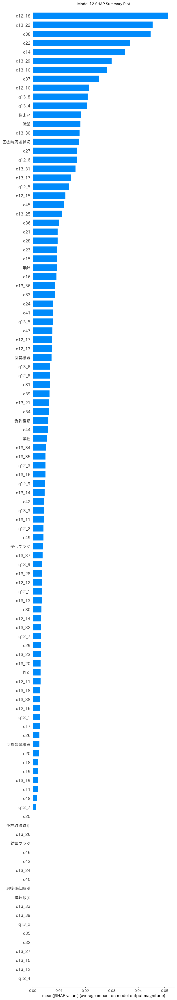

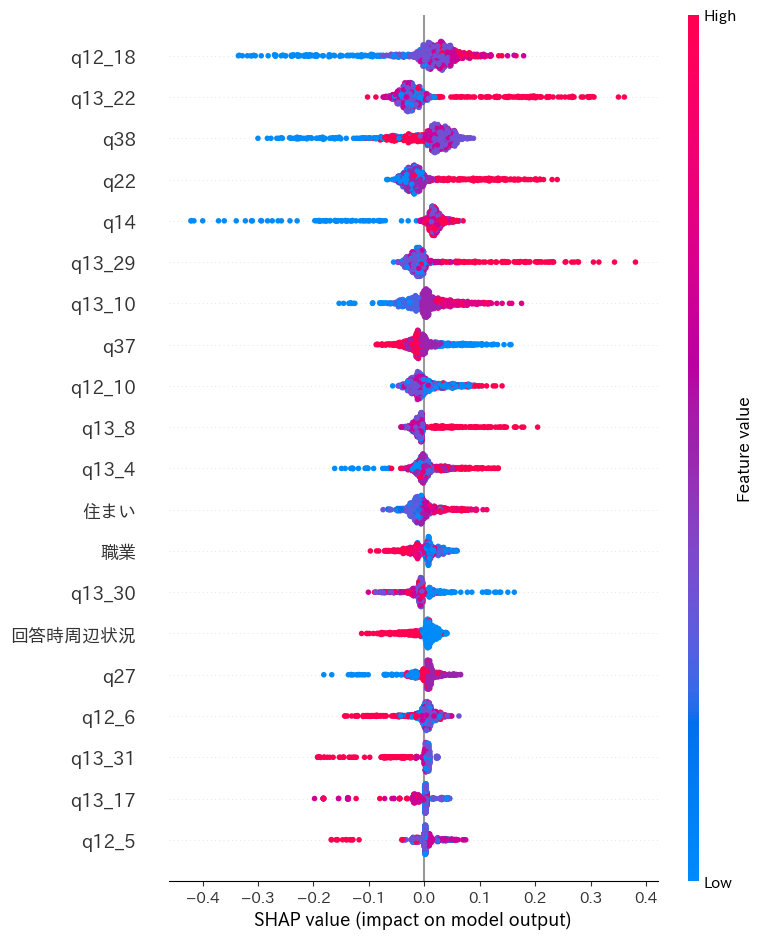

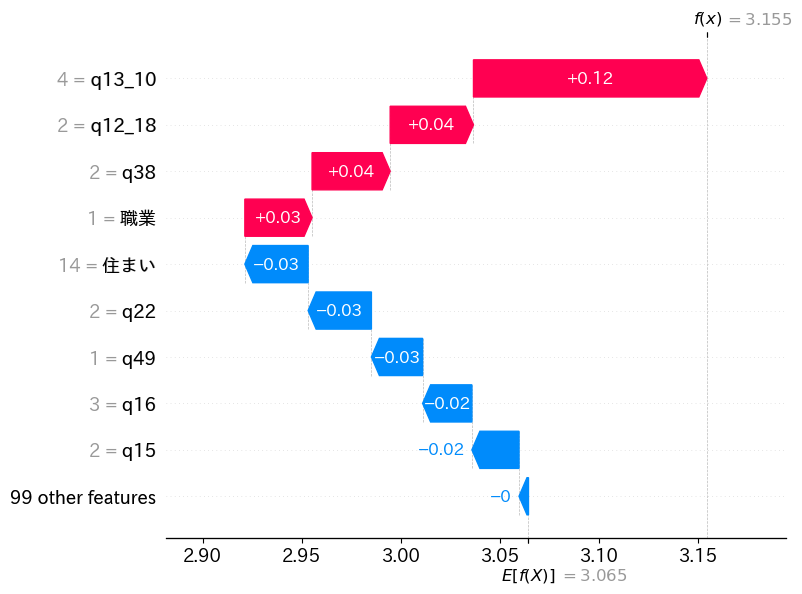

Model 13 SHAP Values: [[-0.00088118 -0.08933377 -0.00122175 ...  0.          0.00093163
  -0.0154049 ]
 [-0.00161657 -0.07819548 -0.00054646 ...  0.         -0.00138702
   0.02259269]
 [-0.00088118 -0.0781319   0.00368208 ...  0.         -0.000845
  -0.07005336]
 ...
 [ 0.0009984   0.04803668 -0.0202396  ...  0.          0.0087583
   0.01410548]
 [ 0.00317936  0.13146723  0.01223784 ...  0.         -0.00253769
   0.02825515]
 [ 0.00975841  0.10367353 -0.00132323 ...  0.         -0.00089233
  -0.00693741]] (804, 108)


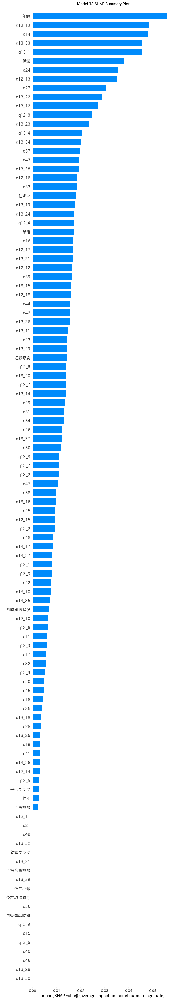

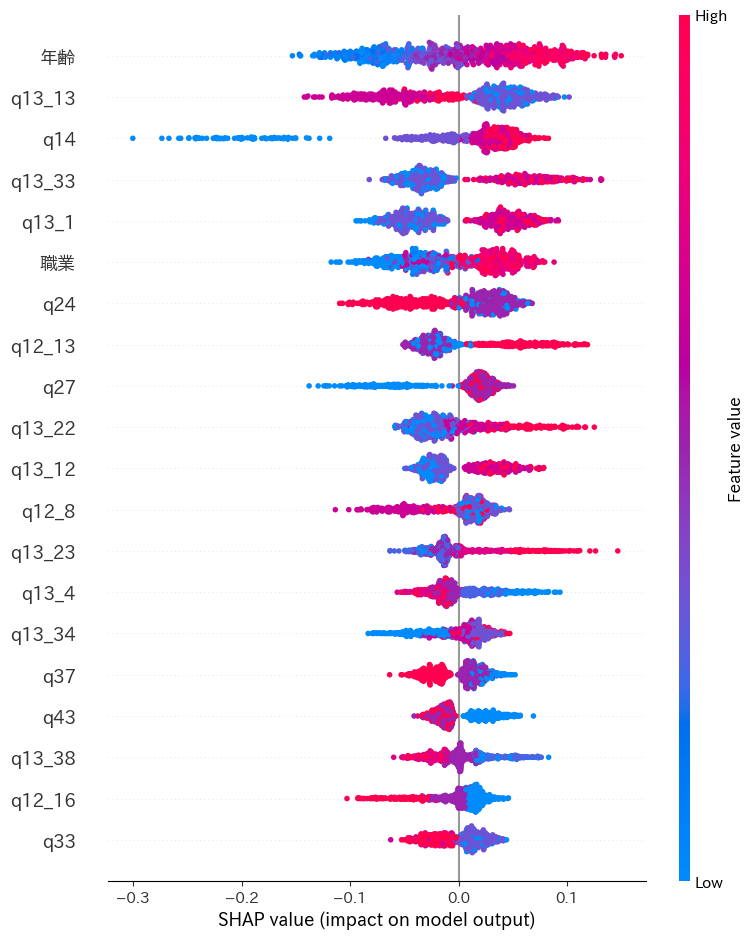

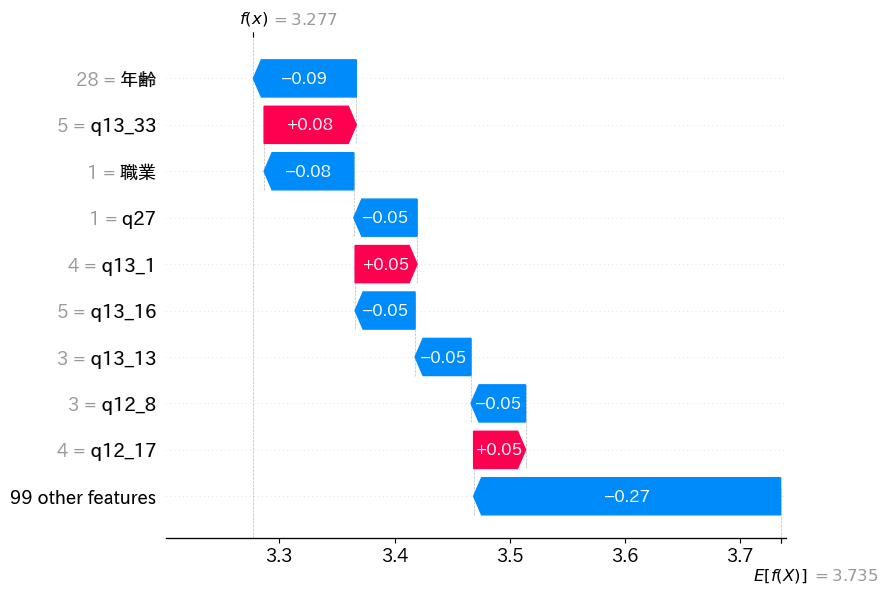

Model 14 SHAP Values: [[ 0.00856593 -0.02083432  0.02313056 ... -0.00347336 -0.00084958
   0.03631901]
 [ 0.00996692 -0.04334966 -0.00759371 ...  0.0060785   0.00511053
   0.06379491]
 [ 0.00171534 -0.08233818 -0.00692695 ... -0.00685783  0.00585575
  -0.03540096]
 ...
 [-0.00631717  0.02634403 -0.0256356  ...  0.0034399  -0.01132362
  -0.00172549]
 [-0.00738571  0.03739646  0.00198443 ...  0.00812833 -0.00420327
   0.00111053]
 [-0.00650939  0.04337385 -0.01336848 ...  0.0074362  -0.00340125
   0.01341984]] (804, 108)


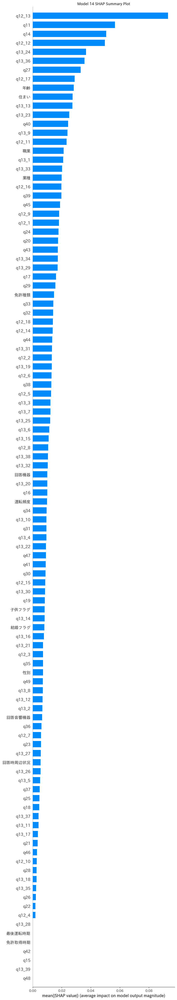

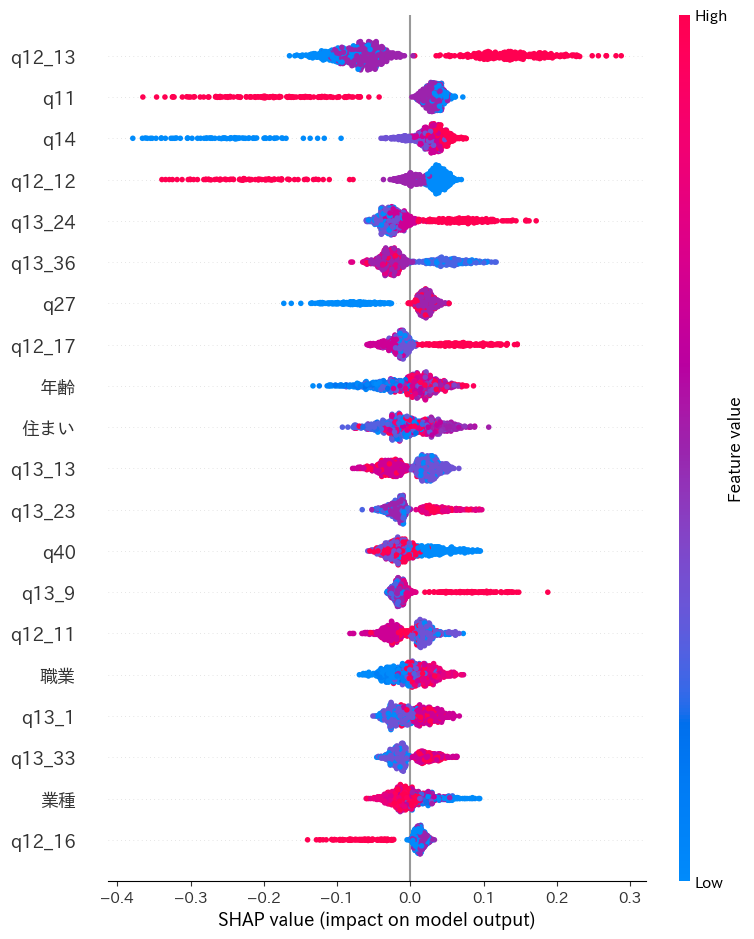

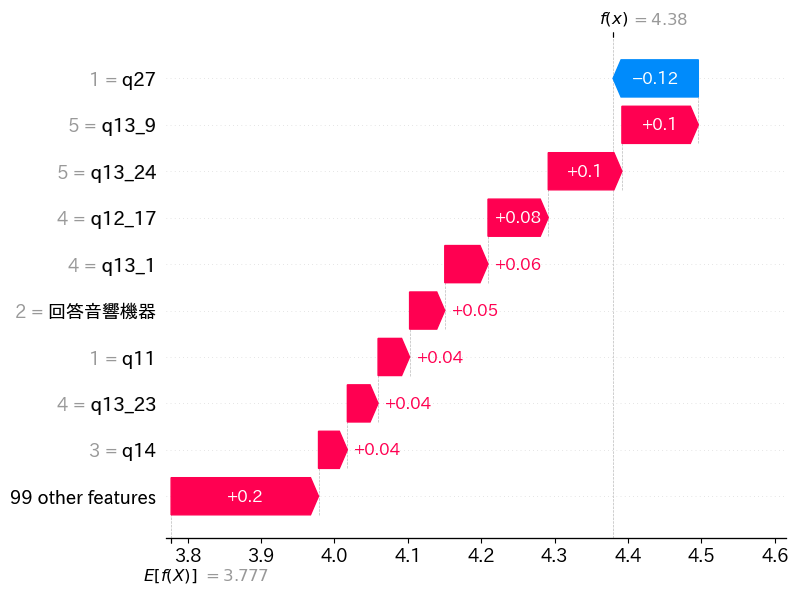

Model 15 SHAP Values: [[-0.02174004 -0.00618674 -0.00309558 ...  0.00028706 -0.01241992
   0.00444927]
 [-0.00830175  0.031047   -0.00962287 ...  0.02569884  0.00994418
   0.00692412]
 [-0.01569777 -0.0487323  -0.00838996 ...  0.0284808   0.03831752
  -0.00640486]
 ...
 [ 0.04584315  0.02374483  0.0044166  ... -0.00850024 -0.01648325
  -0.00613105]
 [ 0.02621716 -0.03043963 -0.01721285 ...  0.02508717  0.02391569
  -0.03244578]
 [ 0.04478983  0.07741451 -0.01426327 ...  0.00237217  0.04612848
   0.0017055 ]] (804, 108)


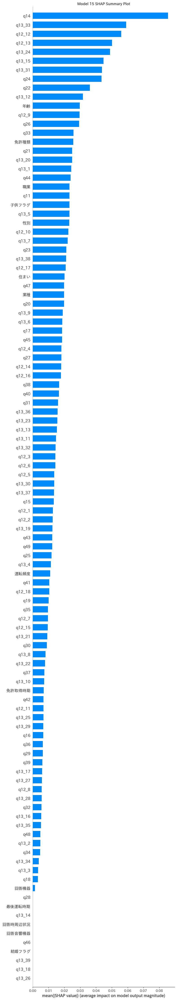

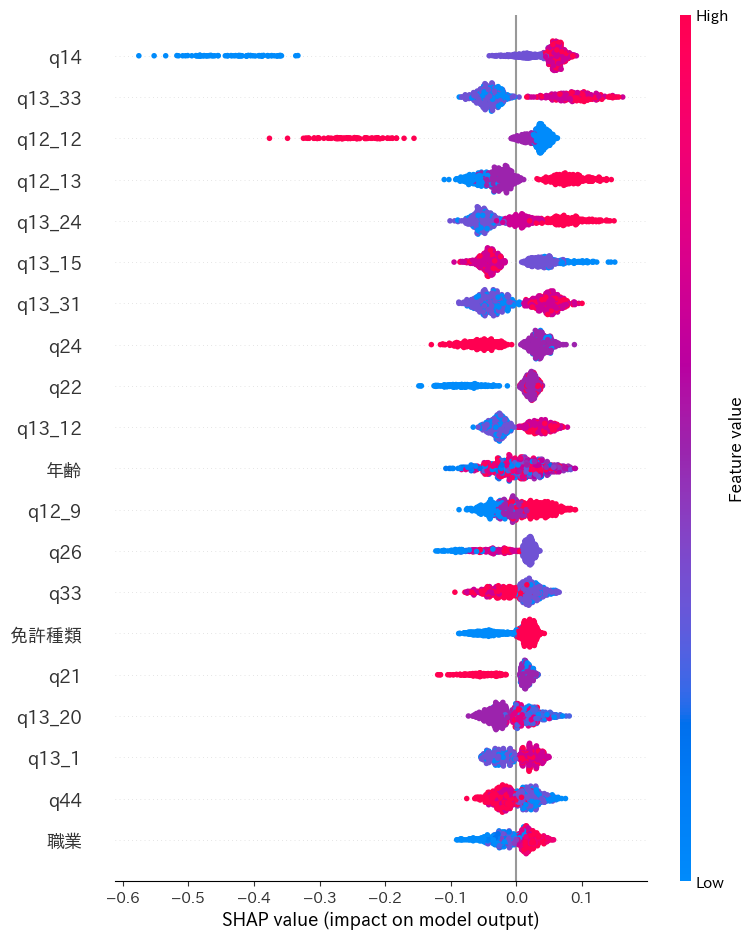

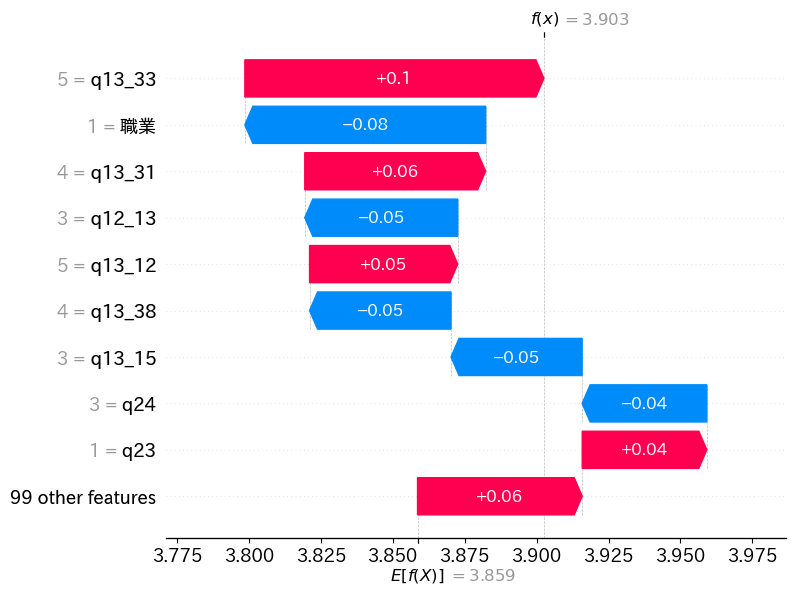

Model 16 SHAP Values: [[-0.00552781 -0.01447026 -0.01626881 ... -0.00863744  0.0136681
   0.02432059]
 [-0.00388655 -0.05052922 -0.0309122  ... -0.00101309  0.01359817
   0.00384594]
 [-0.0116388  -0.03888482  0.01323428 ... -0.00037163  0.00547588
  -0.00039995]
 ...
 [ 0.02608501  0.04698887 -0.00354403 ... -0.01247418 -0.00160719
  -0.01525247]
 [ 0.02412053  0.01560145 -0.00483974 ... -0.00284046 -0.00641814
  -0.04279236]
 [ 0.02537978 -0.01672533 -0.00920427 ... -0.00499176 -0.00741639
  -0.02861541]] (804, 108)


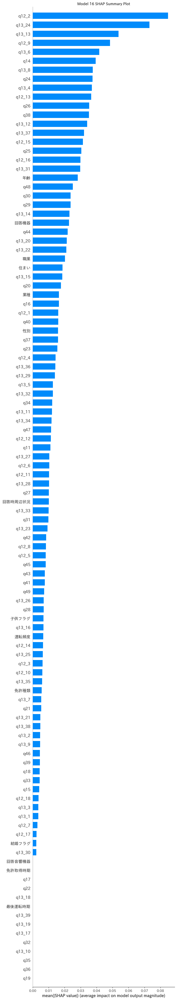

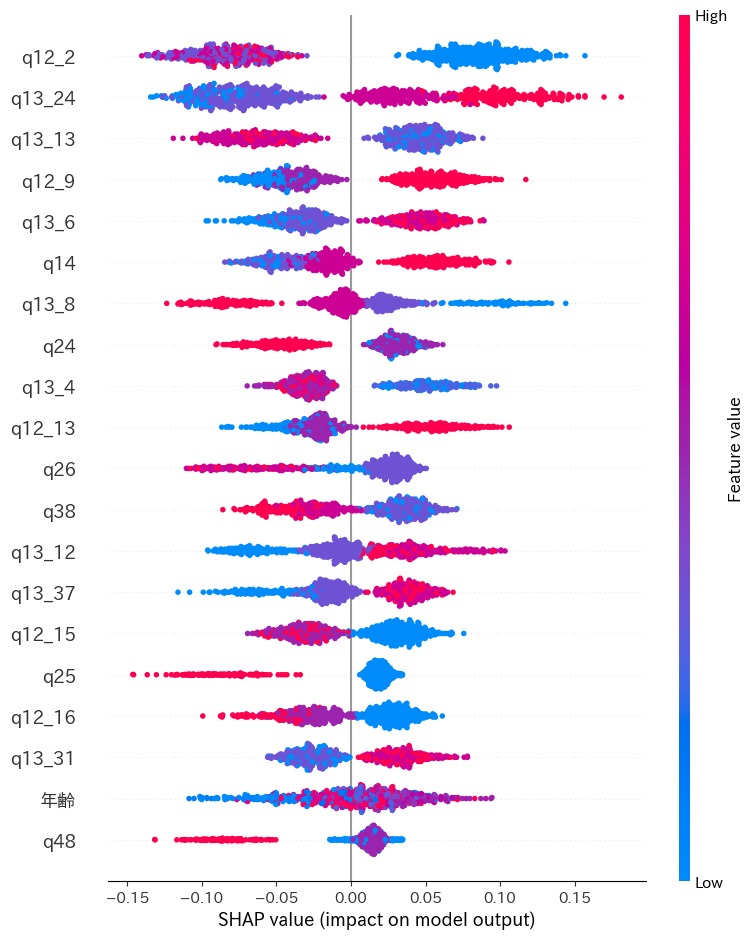

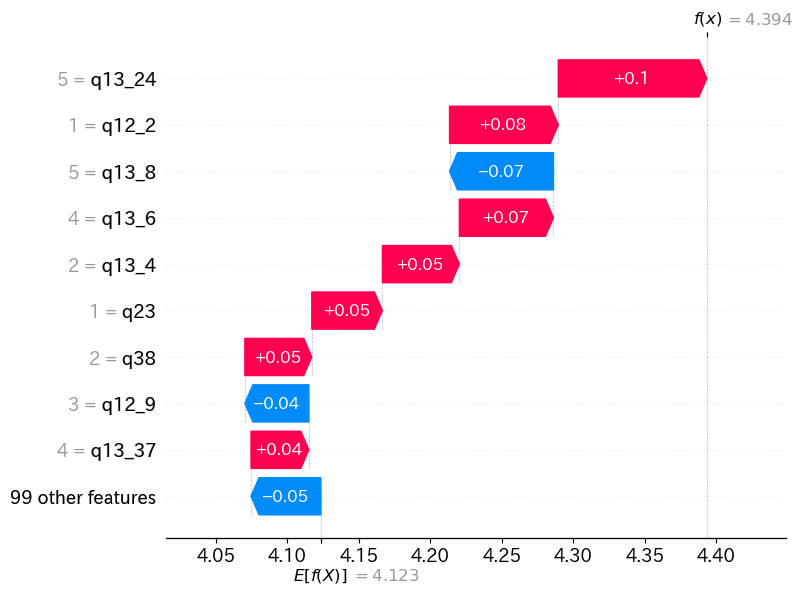

Model 17 SHAP Values: [[-0.00125519 -0.0635642   0.00779516 ... -0.03534225 -0.00163347
   0.02333161]
 [-0.00189314 -0.12712917 -0.00445316 ...  0.00058932 -0.00099504
   0.03557124]
 [-0.00280714 -0.08178893 -0.00737766 ... -0.05123527 -0.00099504
   0.00723693]
 ...
 [ 0.00303088  0.14899097 -0.00165408 ...  0.00113616  0.00063339
  -0.00236339]
 [ 0.00379351  0.0739081   0.10290645 ...  0.0024277   0.00714699
  -0.00135047]
 [ 0.0132139   0.1429112  -0.01255037 ... -0.03187562  0.00177428
  -0.0007446 ]] (804, 108)


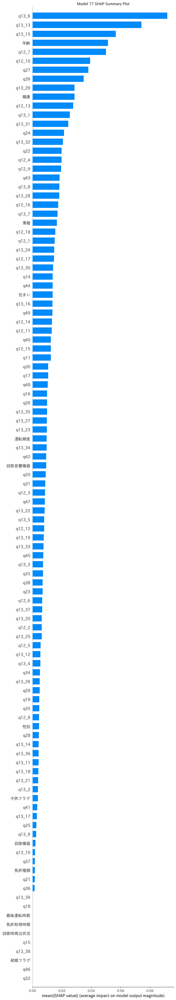

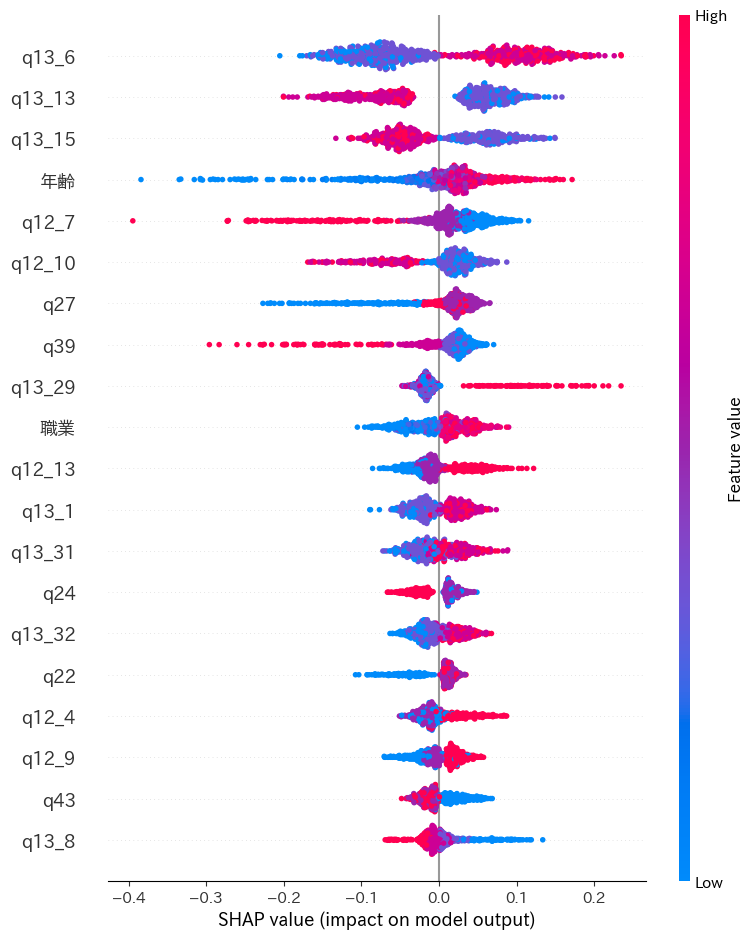

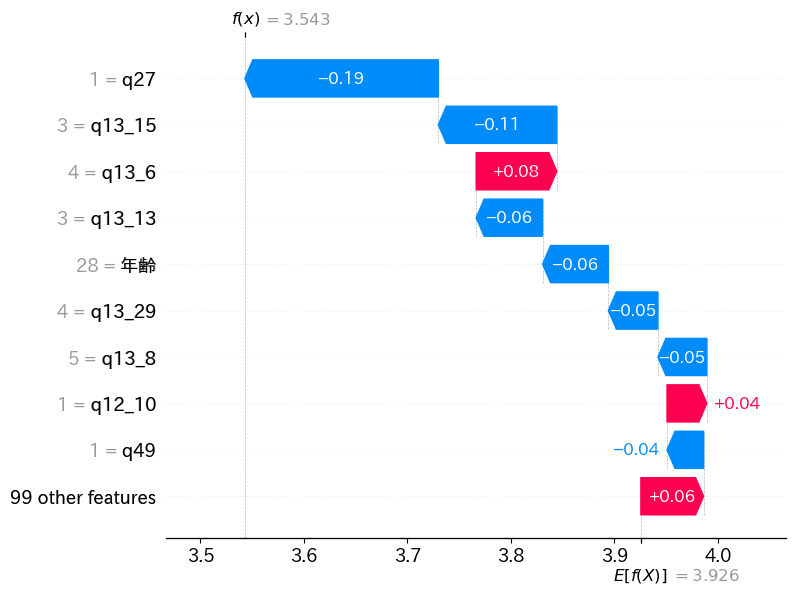

Model 18 SHAP Values: [[-0.00025598 -0.1306862   0.00572891 ...  0.02361401 -0.02430948
   0.01766813]
 [-0.00104298 -0.07995856 -0.00593353 ... -0.00965727  0.00624548
   0.03537192]
 [-0.00114683 -0.07539737 -0.00852436 ... -0.05791032  0.00628638
  -0.01022823]
 ...
 [ 0.00249299  0.02284696 -0.00576255 ...  0.0031371  -0.00617284
  -0.02423079]
 [ 0.01174115  0.05140788 -0.01225571 ...  0.00086972  0.00377404
  -0.02887392]
 [-0.00035086  0.04322483  0.0097973  ...  0.00403465  0.00392876
  -0.01067661]] (804, 108)


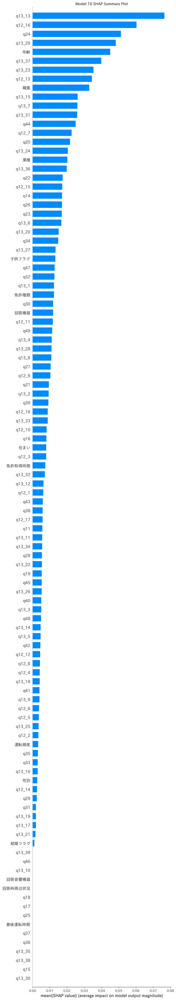

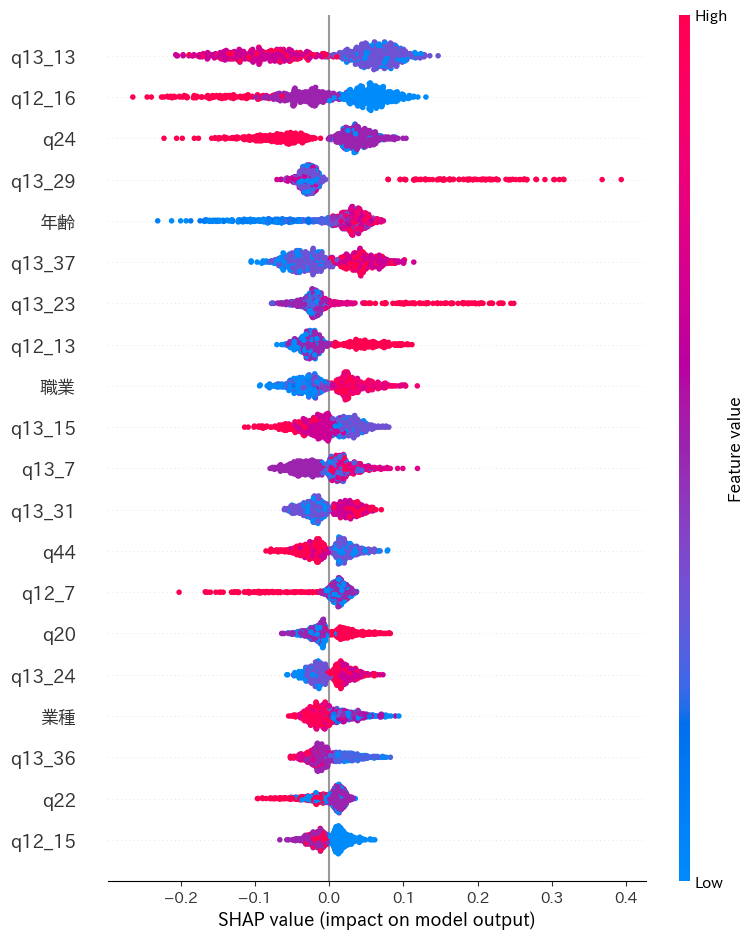

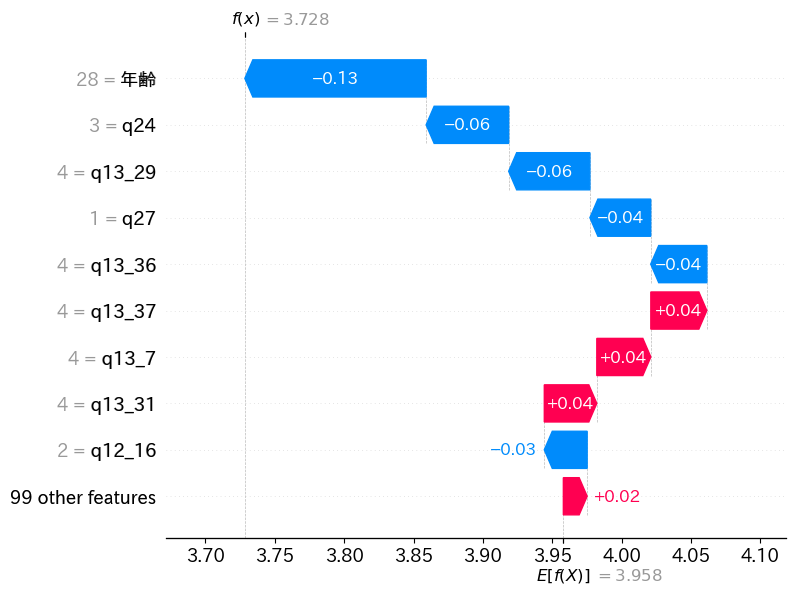

Model 19 SHAP Values: [[-2.75717231e-03 -4.48166042e-02  2.16922553e-03 ...  6.12719840e-03
   3.90666312e-03  2.69018093e-02]
 [-1.29704714e-02 -1.63433507e-02  2.96914978e-03 ... -1.89097725e-03
   1.91355113e-03  3.86087999e-02]
 [ 5.25617590e-03 -8.44787887e-03  8.65457170e-03 ... -3.53788235e-02
  -7.57564791e-05 -3.40657610e-03]
 ...
 [ 3.12720527e-03  2.09671536e-04 -1.56491885e-03 ...  4.22110998e-03
  -6.30331303e-05 -1.81277443e-02]
 [ 1.49020826e-02 -1.12523438e-03  6.07748120e-05 ... -5.47074279e-03
   2.36793169e-04 -2.58991256e-02]
 [ 1.54678998e-02  2.32338415e-03  4.56703992e-02 ...  7.54917220e-04
  -1.13963594e-04 -2.61657931e-02]] (804, 108)


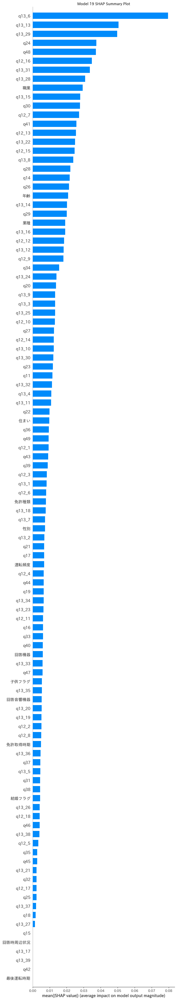

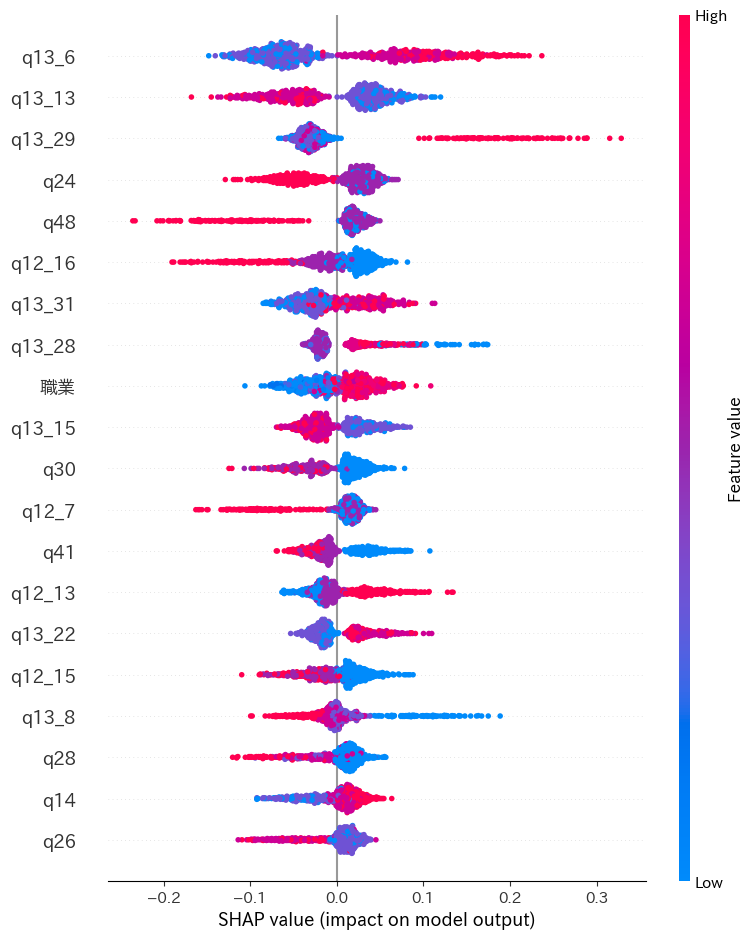

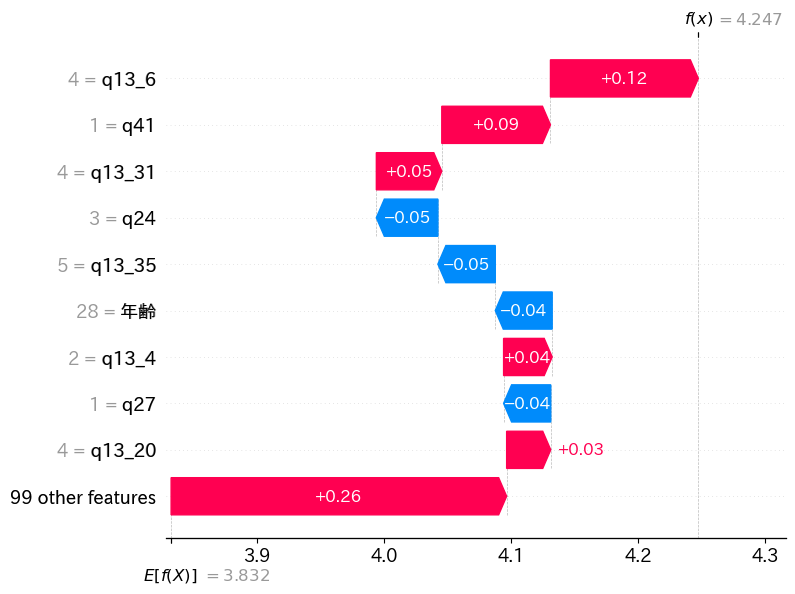

Model 20 SHAP Values: [[ 0.01034188 -0.05851849 -0.01370203 ...  0.00050661  0.00415206
  -0.03846366]
 [ 0.00166455 -0.08507927  0.02305626 ...  0.00899224 -0.0100381
   0.04338355]
 [ 0.00174114 -0.03420888 -0.03832667 ...  0.00727183 -0.01882908
  -0.014943  ]
 ...
 [-0.00031975  0.00627386 -0.03903544 ... -0.00404603  0.00507011
  -0.02413646]
 [ 0.00234072  0.00109036  0.1134263  ...  0.02783725 -0.00368082
  -0.02432505]
 [-0.00779269 -0.01045547  0.03305011 ... -0.00604114 -0.01954208
  -0.01214468]] (804, 108)


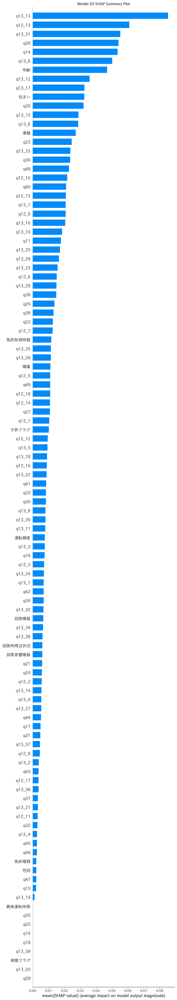

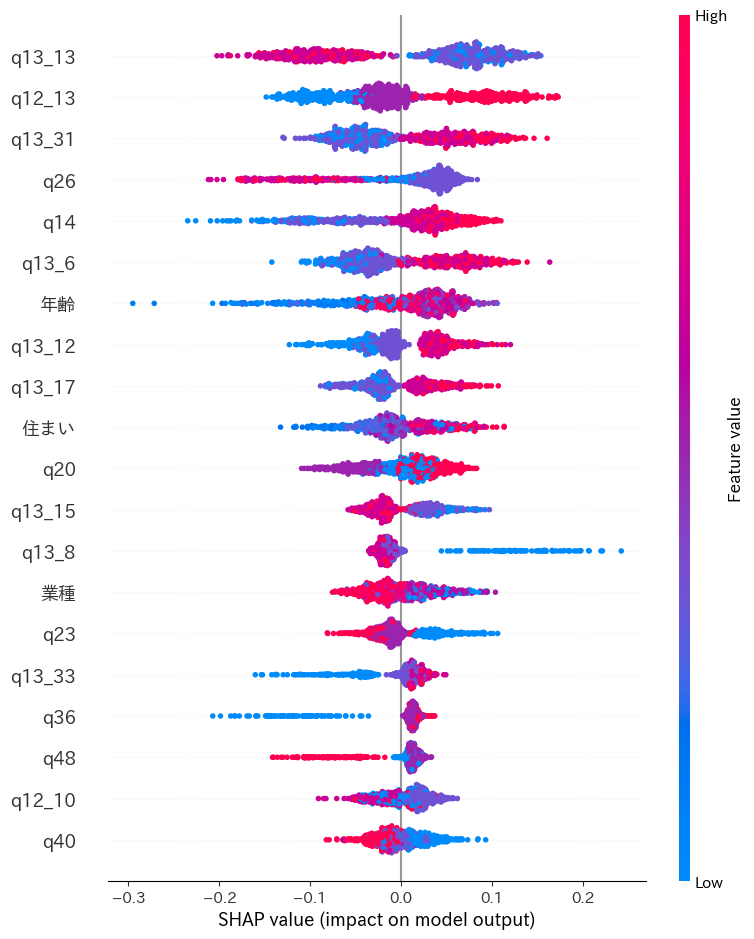

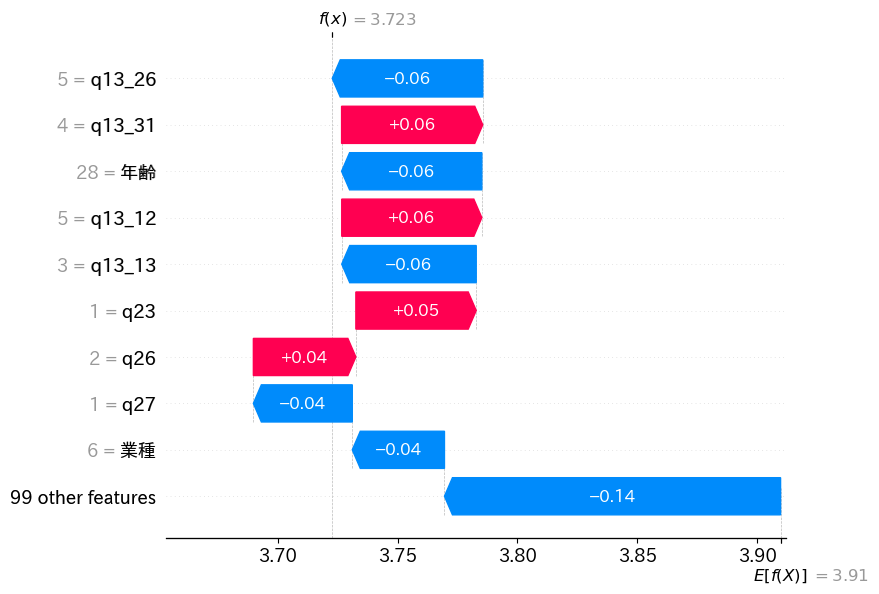

Model 21 SHAP Values: [[-7.35440511e-04  5.28036053e-02  1.53418344e-03 ... -2.34627807e-03
  -1.91837110e-02 -3.60175346e-02]
 [-7.35440511e-04  3.40010602e-02 -3.64523118e-03 ...  6.44771604e-03
   1.42010577e-02 -3.52457264e-02]
 [-2.42325003e-03  3.24848337e-02 -1.93806386e-02 ...  4.49857635e-03
   6.76058694e-03 -4.60047404e-03]
 ...
 [ 1.29927824e-03  9.59797314e-03 -2.67269110e-04 ...  2.69598127e-05
  -4.48693651e-03  1.90575814e-02]
 [ 1.53562480e-02  1.21783986e-02  6.48058227e-03 ...  3.77633477e-03
  -5.02989173e-03  1.66733473e-02]
 [ 1.53562480e-02  4.94970087e-02  1.55447609e-02 ... -9.28987431e-05
  -3.66033518e-03  1.45161917e-02]] (804, 108)


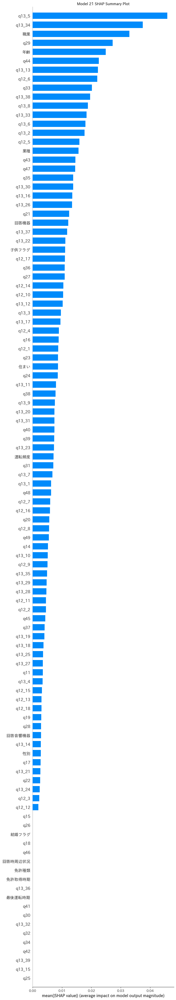

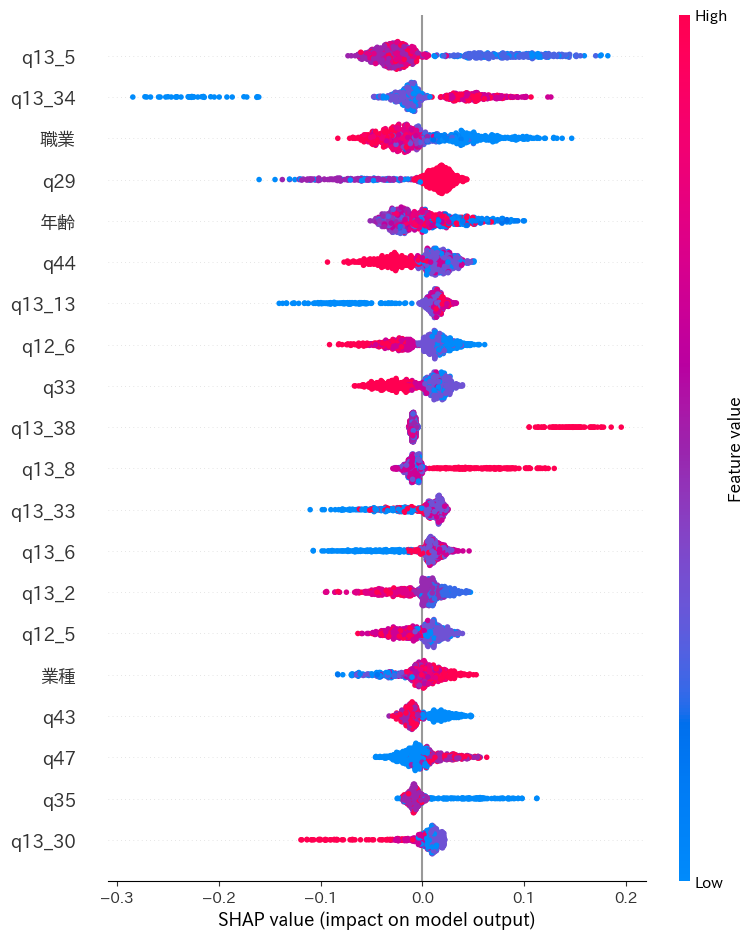

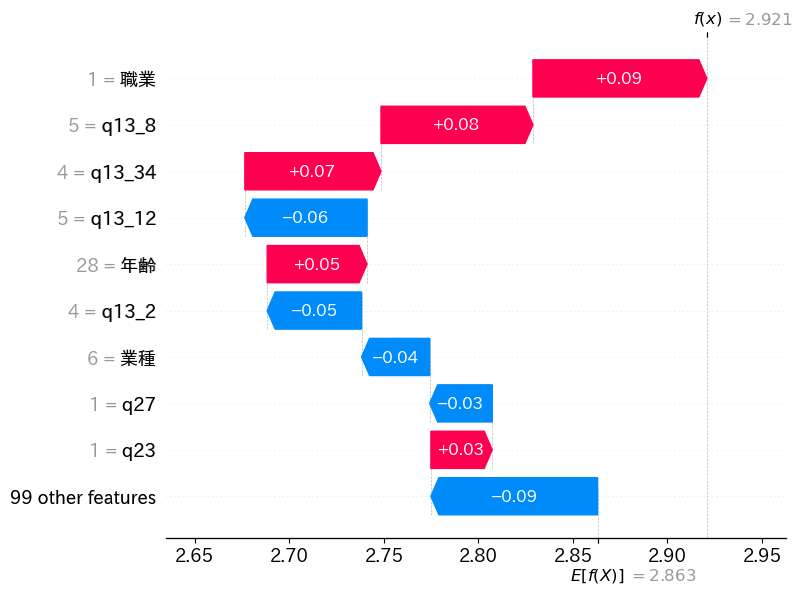

Model 22 SHAP Values: [[ 3.07841405e-04  6.20617766e-03  2.08294889e-03 ...  2.52217448e-04
  -1.68348760e-04  1.30404818e-02]
 [ 4.71033922e-04 -3.02819402e-03 -2.91623558e-02 ...  9.01459012e-04
  -3.45437146e-04 -2.25168089e-02]
 [ 2.59472446e-04  6.11800561e-03 -1.77268743e-03 ...  3.12554684e-04
  -1.32713203e-03  1.34676660e-03]
 ...
 [-8.45322326e-04 -8.37020623e-03  1.90183203e-03 ...  4.66262005e-05
   6.85668190e-04 -2.17933754e-02]
 [-9.57303617e-04  1.90255279e-02  4.02461101e-04 ... -1.11379168e-02
   2.41414563e-03 -2.85974092e-03]
 [-2.05224873e-03  3.42014226e-03 -1.63822951e-03 ... -8.28528585e-04
   1.81494864e-02 -1.37287285e-03]] (804, 108)


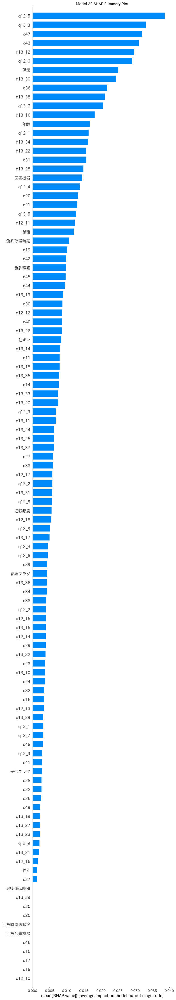

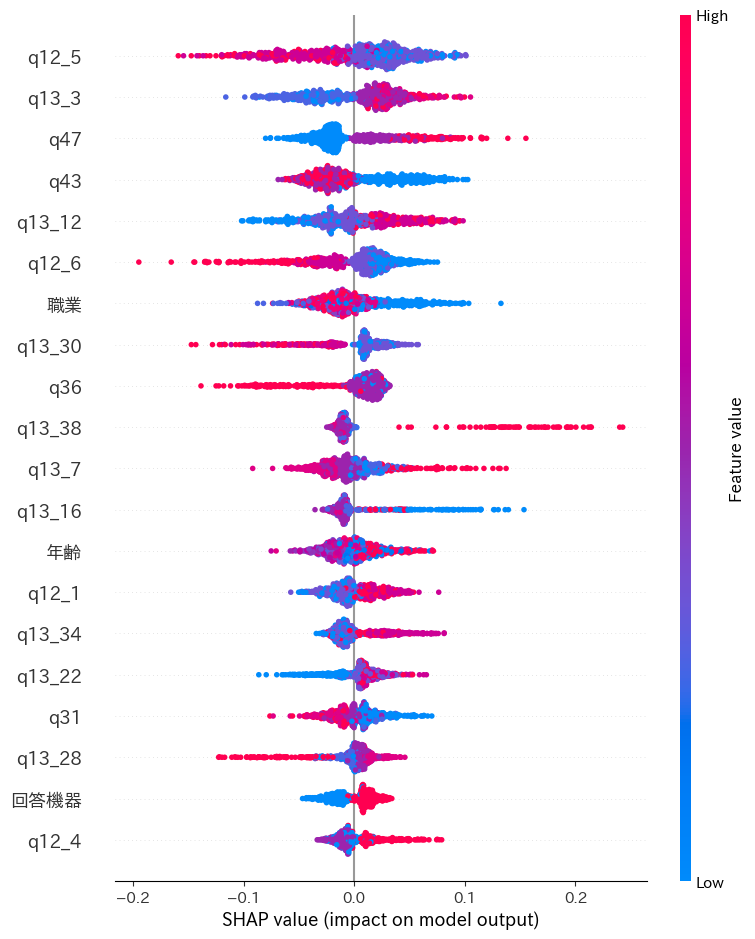

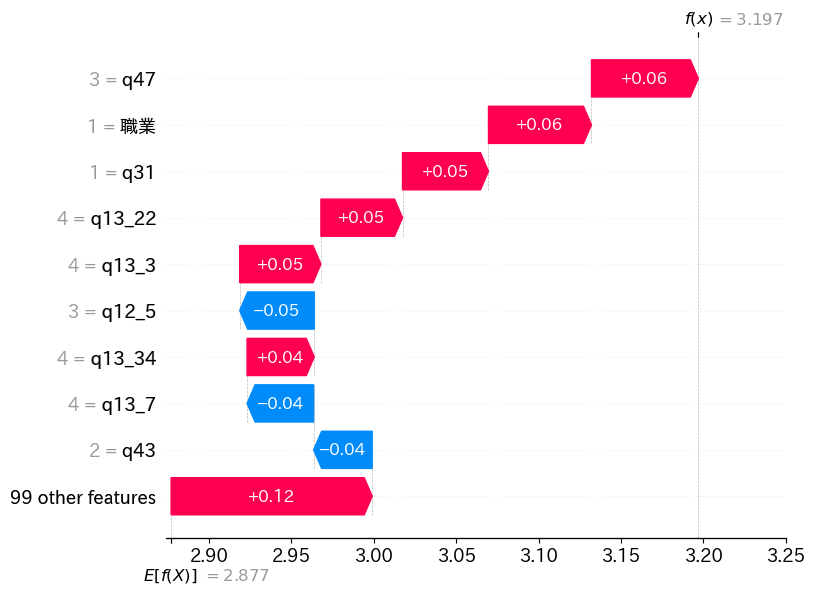

Model 23 SHAP Values: [[ 0.00000000e+00 -6.58454586e-03 -3.41201830e-03 ... -8.86674408e-03
  -7.39787815e-03  5.30189260e-03]
 [ 0.00000000e+00 -7.15047432e-03  1.06243952e-02 ...  9.29183128e-04
   3.01192844e-03  3.29883768e-02]
 [ 0.00000000e+00 -1.31766903e-02  9.96122437e-03 ...  5.20283486e-03
   3.76663506e-03 -3.57549382e-02]
 ...
 [ 0.00000000e+00  3.59806322e-02  4.78603410e-04 ... -4.35596323e-03
  -3.96471692e-03  1.04192325e-02]
 [ 0.00000000e+00  9.23955312e-02  1.51401228e-03 ...  6.04361496e-03
   2.74139961e-03 -9.07691814e-05]
 [ 0.00000000e+00  8.72892358e-02  1.64818289e-02 ... -5.11390928e-03
   2.12843467e-03  1.47799153e-02]] (804, 108)


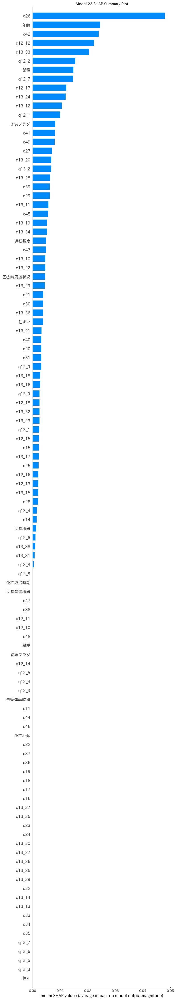

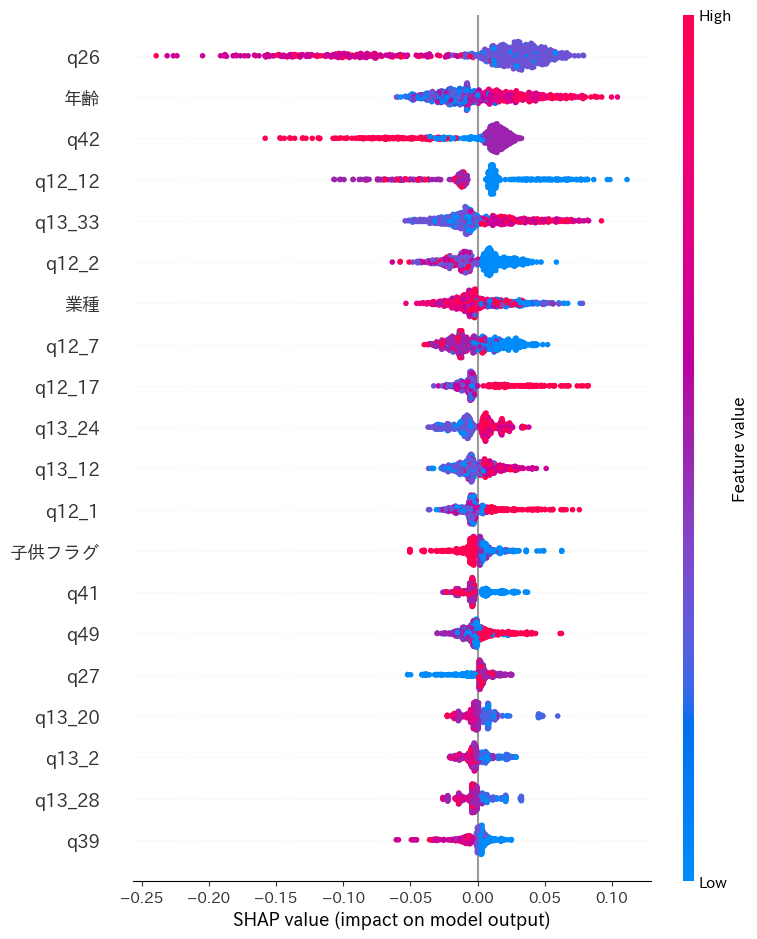

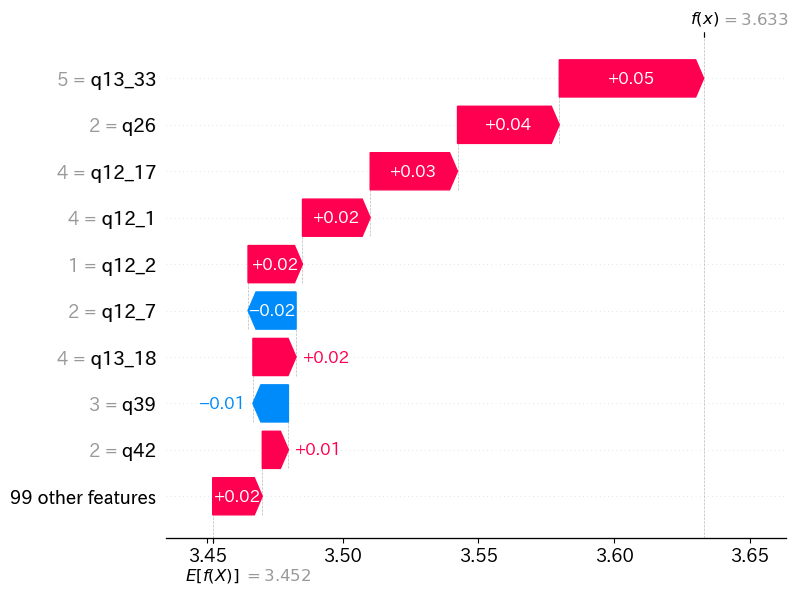

Model 24 SHAP Values: [[ 0.          0.00853909  0.00947347 ...  0.         -0.00359301
   0.0149552 ]
 [ 0.          0.0184758  -0.02051975 ...  0.          0.00888721
   0.01267372]
 [ 0.          0.0095191   0.00344986 ...  0.          0.00711656
  -0.00294151]
 ...
 [ 0.          0.03027771  0.00328516 ...  0.         -0.00528674
  -0.05496113]
 [ 0.          0.02691585  0.01989053 ...  0.         -0.00423063
  -0.02309713]
 [ 0.          0.01582751  0.01526554 ...  0.         -0.01101188
  -0.01372164]] (804, 108)


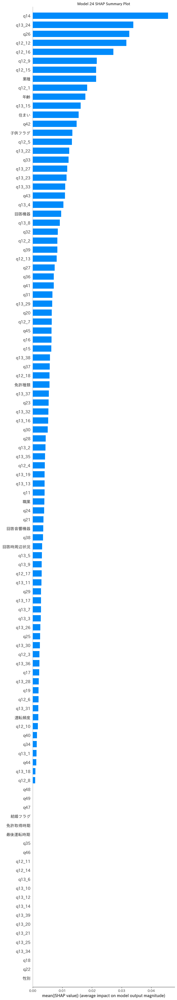

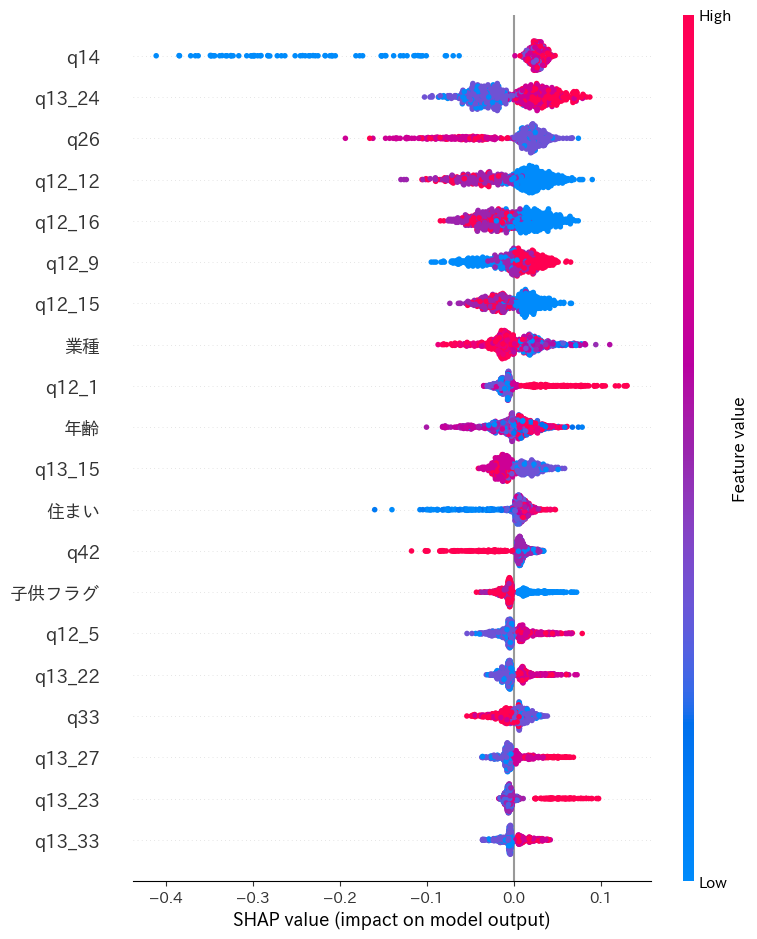

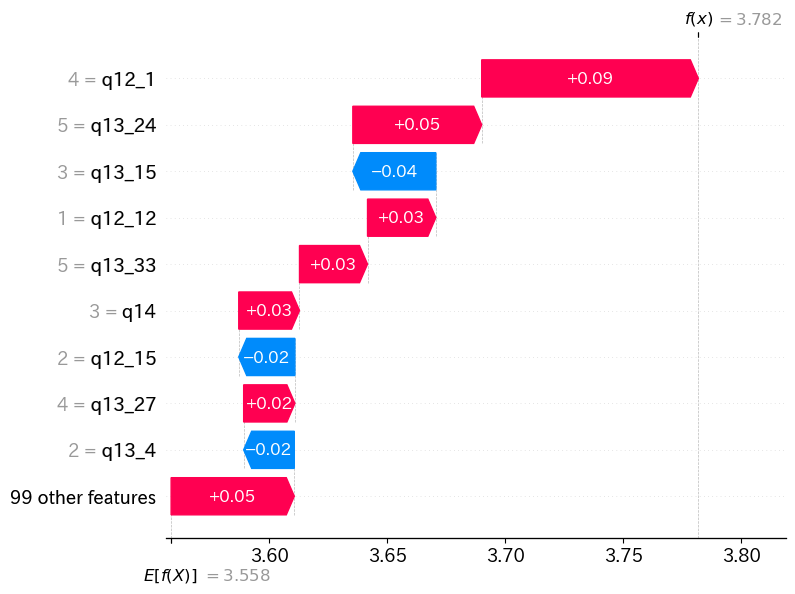

Model 25 SHAP Values: [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] (804, 108)


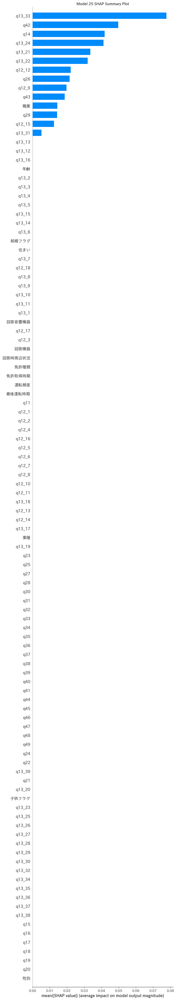

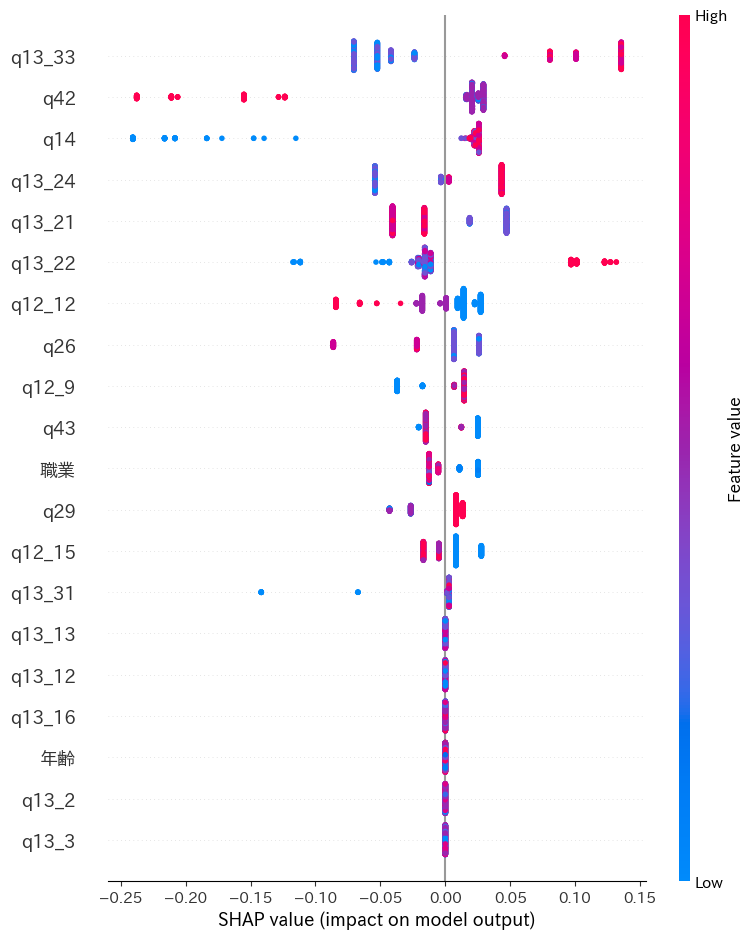

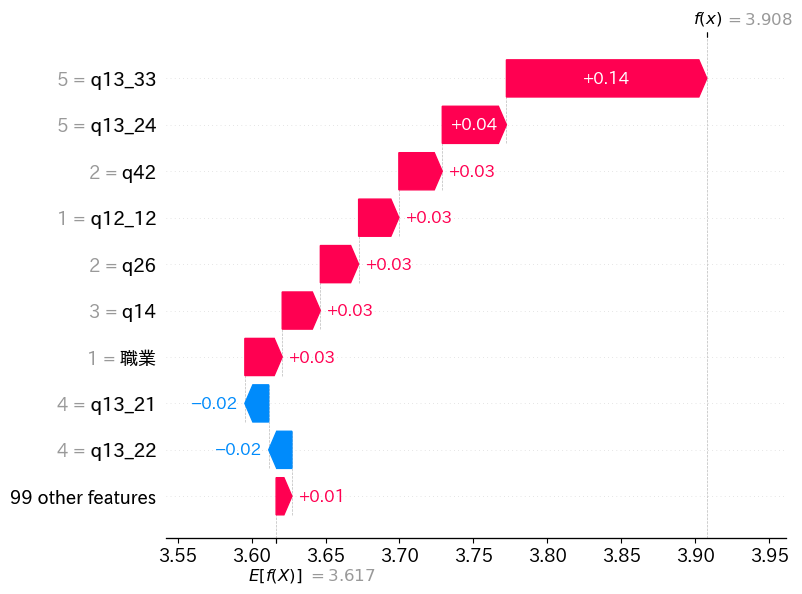

Model 26 SHAP Values: [[-0.00026063 -0.00031953  0.01552427 ...  0.         -0.0005948
   0.01649491]
 [-0.00108676 -0.00656459 -0.05554198 ...  0.          0.00214014
   0.02255317]
 [-0.00026063 -0.00432014  0.01377742 ...  0.          0.00091026
  -0.00653961]
 ...
 [ 0.00179315  0.0376007   0.01968989 ...  0.         -0.00111002
  -0.00392648]
 [ 0.00043003  0.0290127   0.0296819  ...  0.         -0.00139584
  -0.00862741]
 [ 0.00084151  0.01726764  0.02858501 ...  0.         -0.00111002
  -0.00852973]] (804, 108)


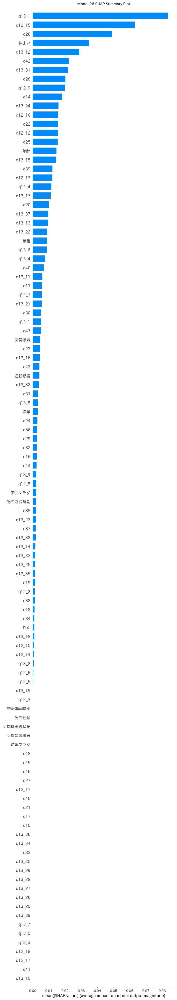

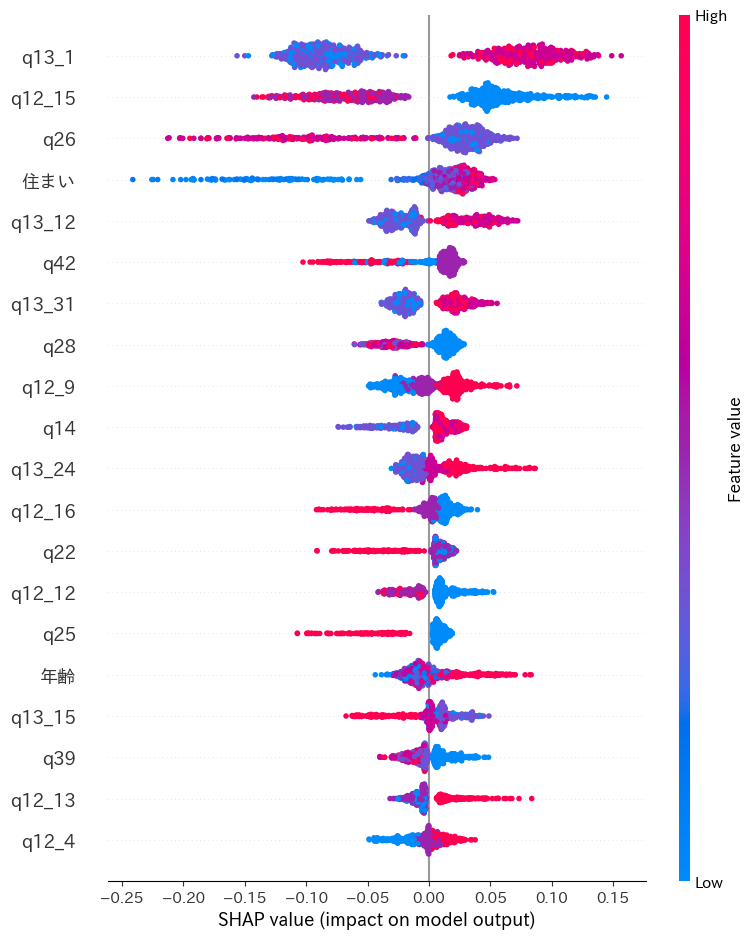

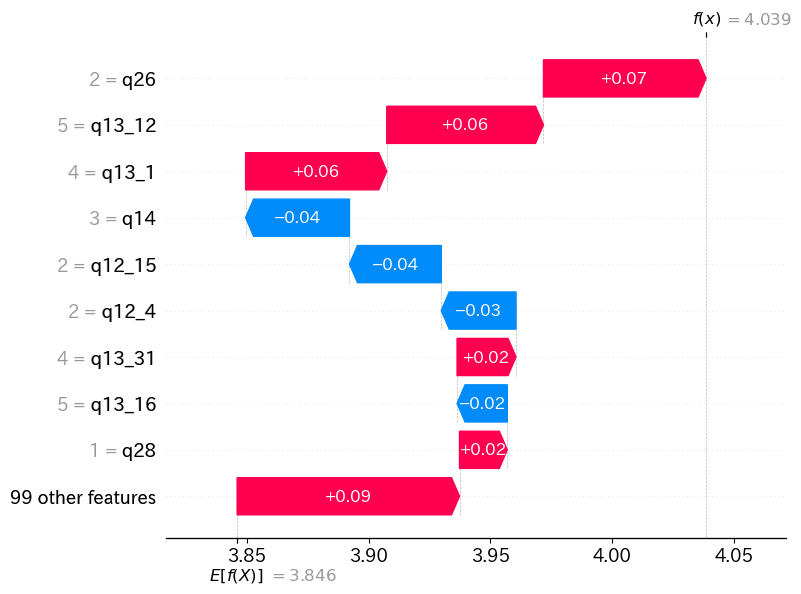

Model 27 SHAP Values: [[-0.0061132  -0.00470964  0.00182882 ... -0.00328247  0.
   0.00112117]
 [-0.00049011 -0.00204502 -0.02310196 ...  0.00582714  0.
   0.01607134]
 [-0.00049011  0.00139168  0.00292074 ...  0.00589121  0.
  -0.00063245]
 ...
 [ 0.0005256   0.0197554  -0.00270491 ...  0.0016525   0.
  -0.0004574 ]
 [ 0.00028065  0.00895662  0.0177057  ...  0.02246588  0.
  -0.00125003]
 [ 0.00056027  0.03036812  0.02499764 ...  0.00091674  0.
  -0.00063245]] (804, 108)


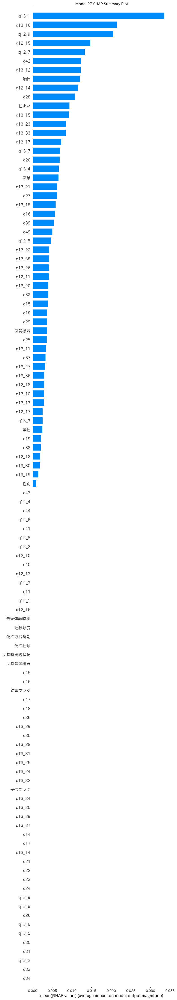

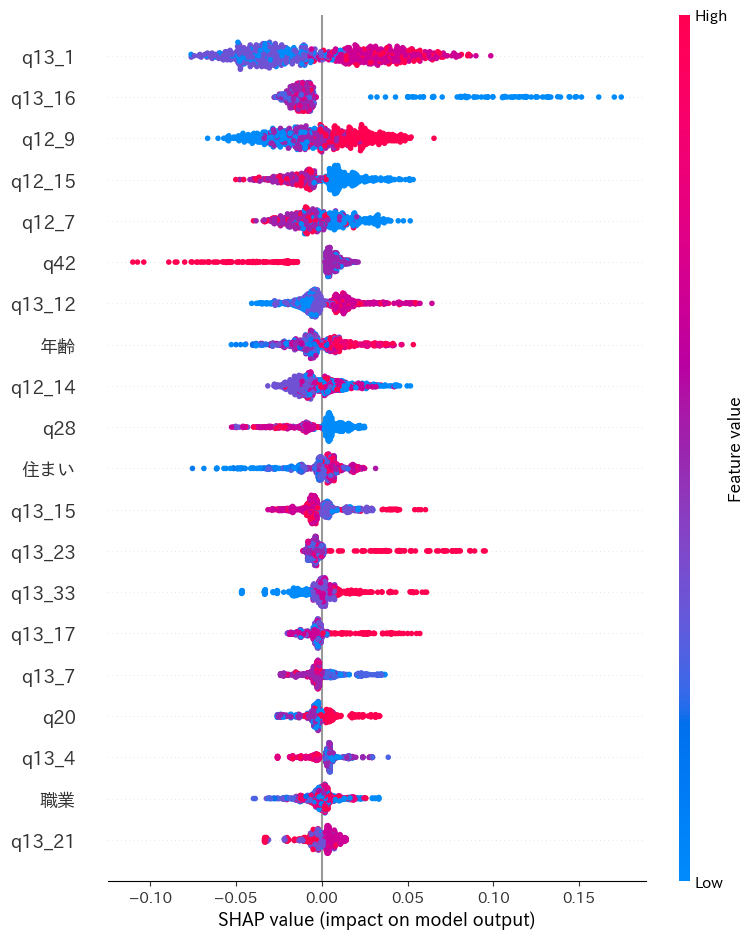

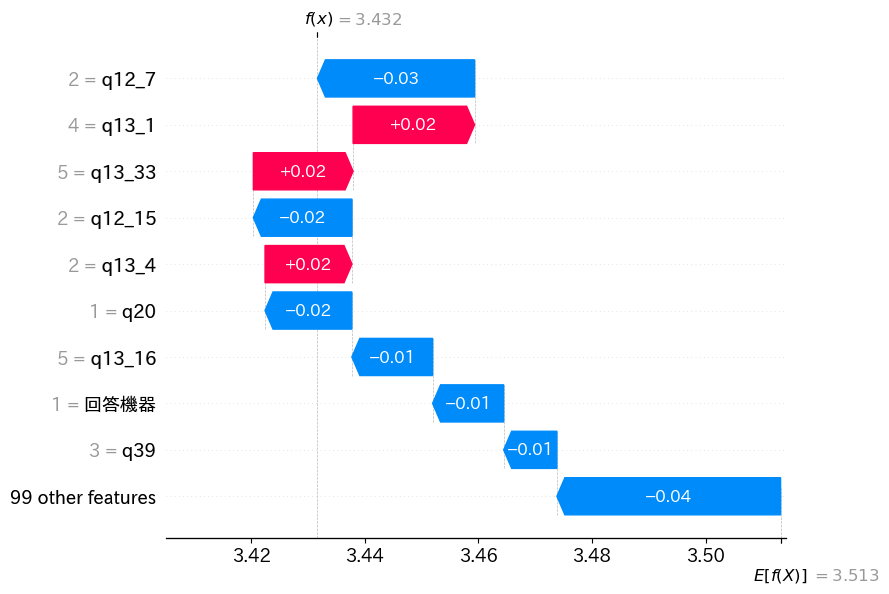

Model 28 SHAP Values: [[ 0.         -0.01224611 -0.01694414 ... -0.00128837 -0.00069363
  -0.00202661]
 [ 0.         -0.00248482 -0.00457726 ...  0.00183606  0.00155401
   0.01169627]
 [ 0.         -0.00267243 -0.00386825 ...  0.00322683  0.00338581
  -0.01024695]
 ...
 [ 0.          0.00823905 -0.00247773 ...  0.00104891 -0.00141888
  -0.01105942]
 [ 0.          0.00531681  0.00426062 ...  0.00322683  0.00437207
  -0.00302734]
 [ 0.          0.02593934  0.0023013  ...  0.00145462  0.00155401
  -0.00796581]] (804, 108)


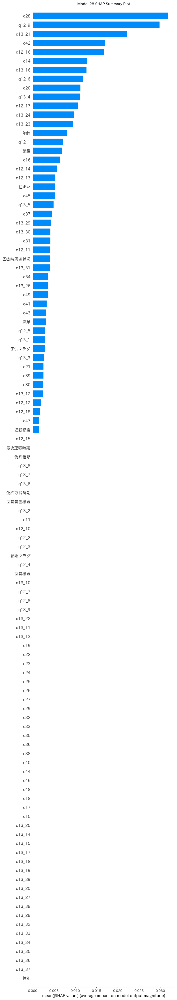

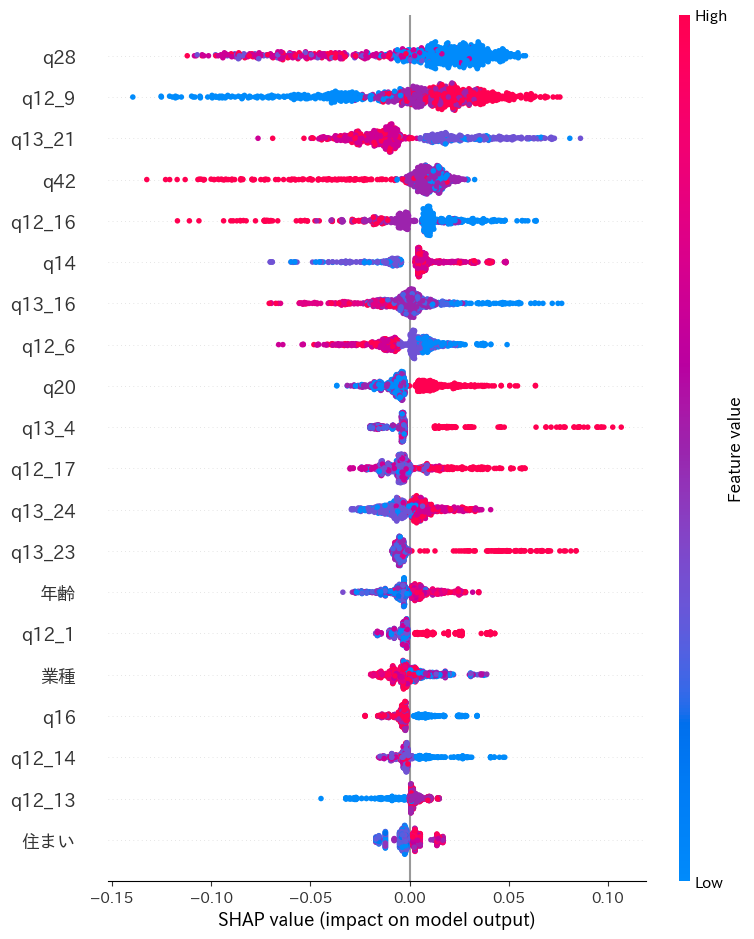

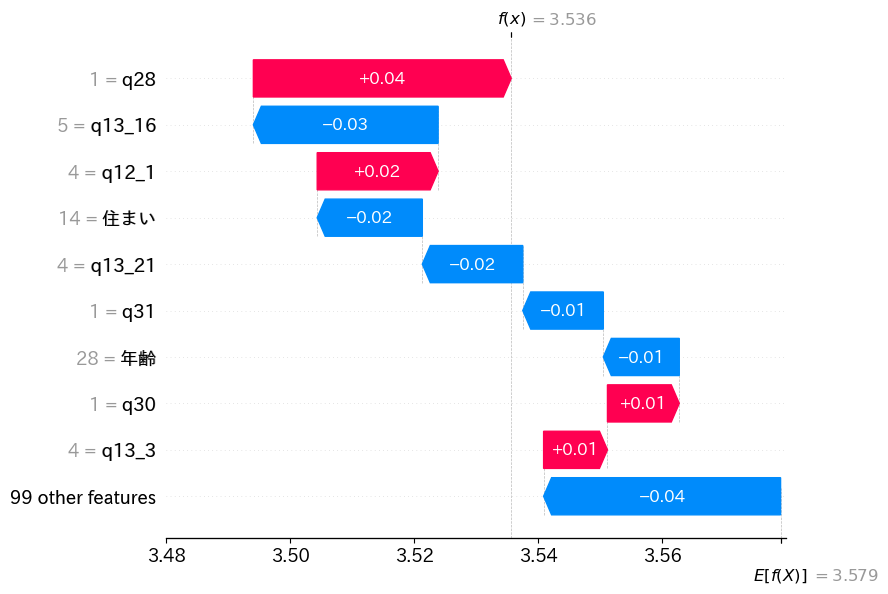

Model 29 SHAP Values: [[-0.00403356  0.02501489 -0.00343244 ...  0.00072759  0.
   0.04884687]
 [-0.02249705  0.00230179 -0.03710362 ... -0.00153269  0.
   0.02535635]
 [-0.00207584  0.02232522 -0.01225566 ... -0.00443484  0.
  -0.02023023]
 ...
 [ 0.00262521  0.04905039 -0.00439424 ...  0.00469595  0.
  -0.0089137 ]
 [ 0.00228796  0.02586574  0.02189456 ... -0.00081716  0.
  -0.02509211]
 [ 0.00259084  0.04368208  0.031911   ...  0.00405633  0.
  -0.0135788 ]] (804, 108)


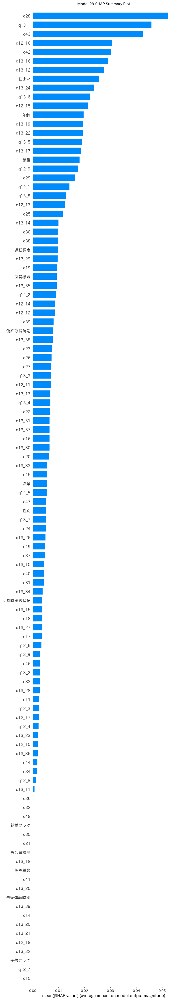

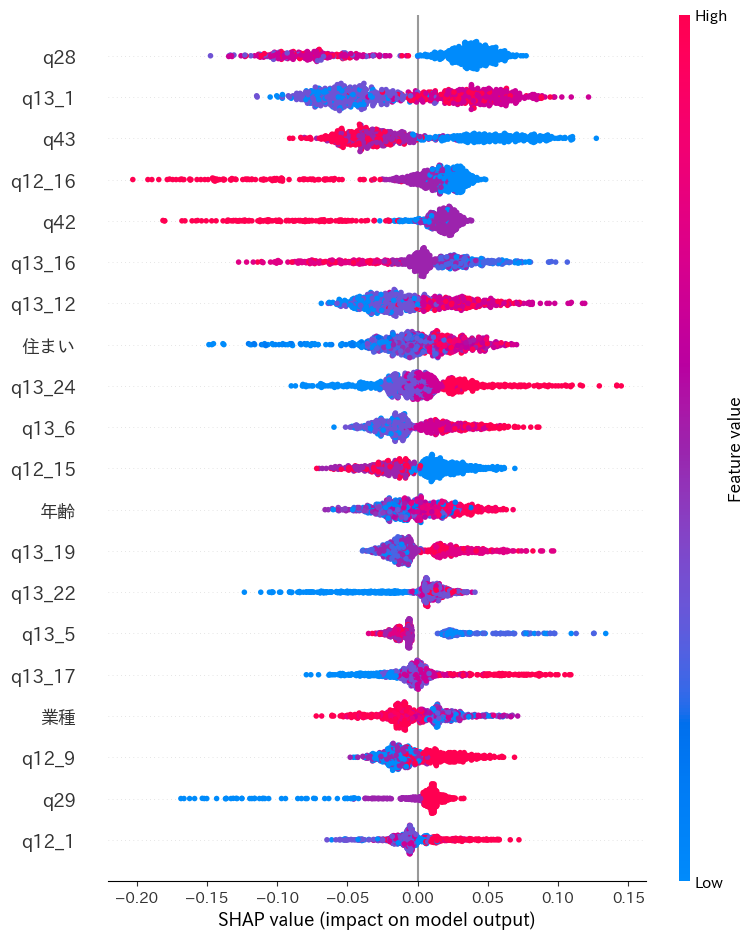

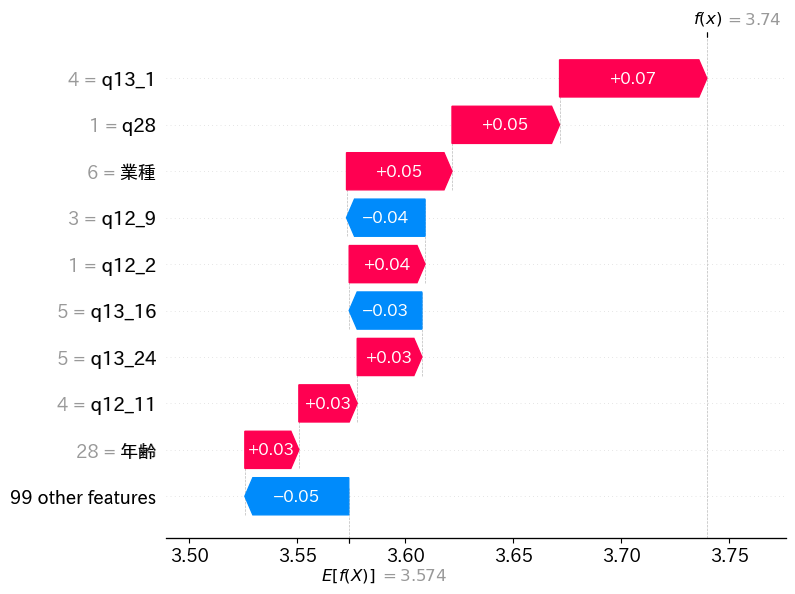

Model 30 SHAP Values: [[-0.00410291 -0.00847839 -0.00442592 ... -0.00624979  0.00057765
   0.00980806]
 [-0.00775075 -0.00258781 -0.05656189 ...  0.00909549 -0.00087367
   0.03651545]
 [-0.01969639  0.00481493 -0.02501048 ...  0.01117706 -0.00175585
  -0.04228   ]
 ...
 [ 0.01615292  0.03374431 -0.00785878 ...  0.00973667  0.00090135
  -0.03836744]
 [ 0.00564507  0.01522577 -0.02115116 ...  0.00899368 -0.00085055
  -0.0124766 ]
 [ 0.00888939  0.03192762  0.01215404 ...  0.01322737 -0.00183387
  -0.01370671]] (804, 108)


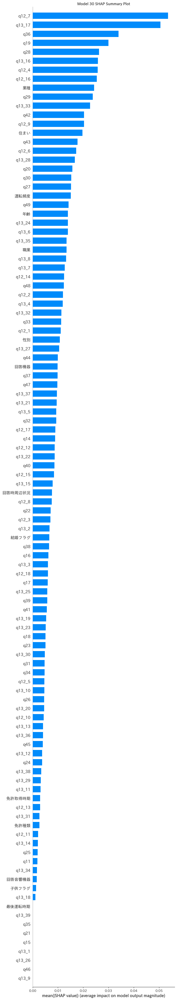

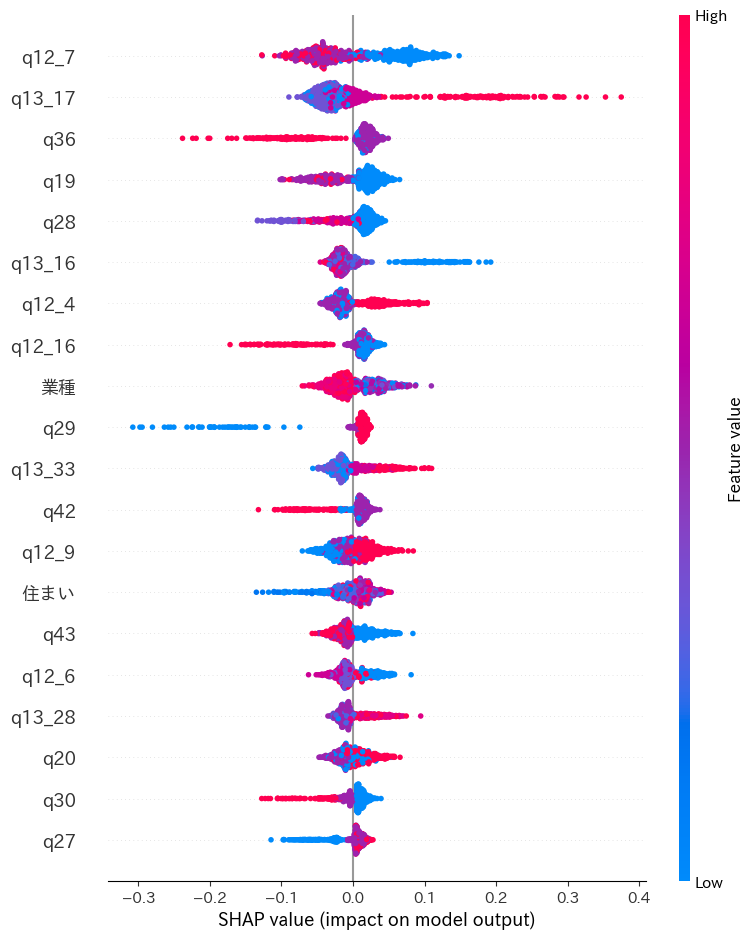

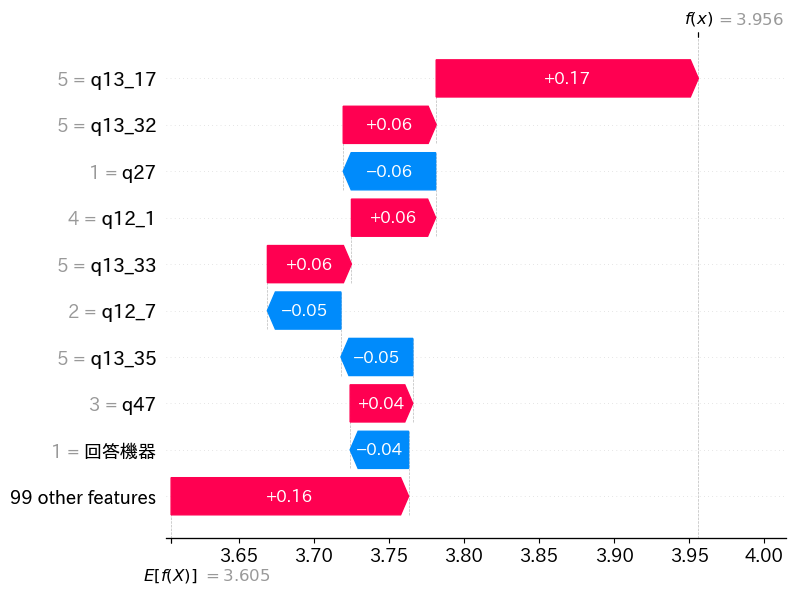

Model 31 SHAP Values: [[ 0.         -0.11637541  0.         ...  0.         -0.01182586
   0.05207113]
 [ 0.         -0.11529625  0.         ...  0.          0.01471896
   0.05207113]
 [ 0.         -0.15837596  0.         ...  0.          0.00867213
  -0.05234005]
 ...
 [ 0.          0.1063401   0.         ...  0.         -0.0243644
  -0.0136826 ]
 [ 0.          0.12099557  0.         ...  0.          0.02331357
  -0.0136826 ]
 [ 0.          0.10064526  0.         ...  0.          0.02726657
  -0.0136826 ]] (804, 108)


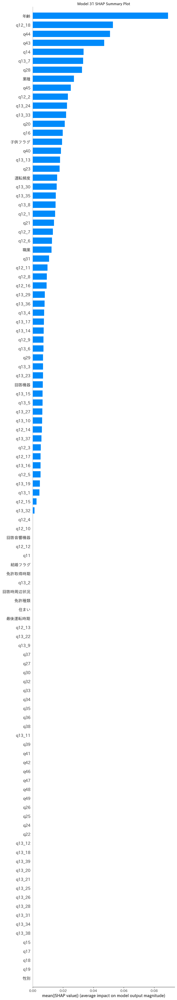

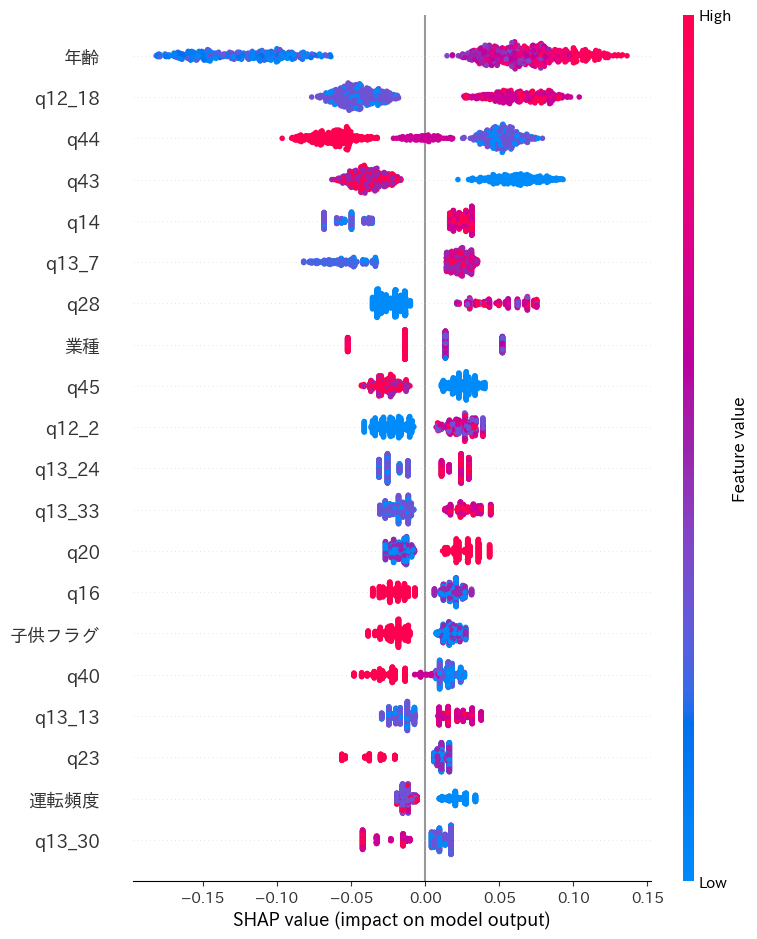

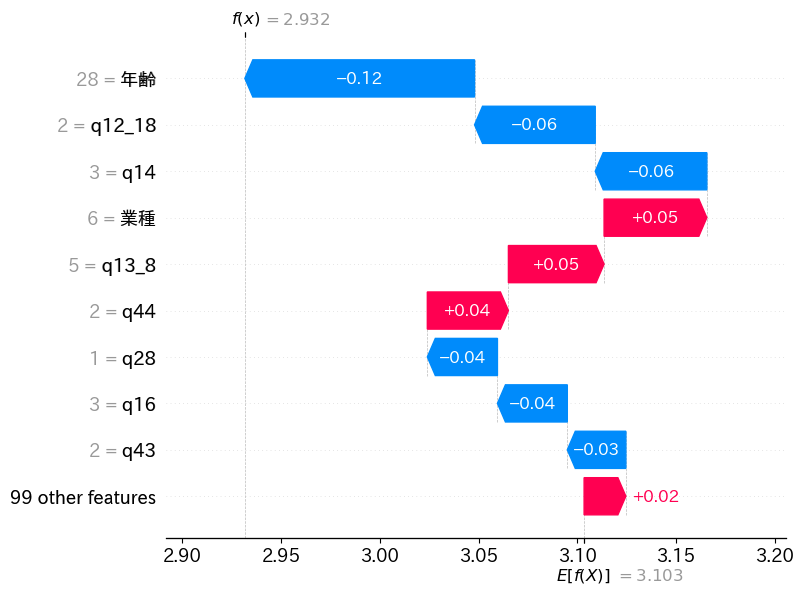

Model 32 SHAP Values: [[ 0.01629008 -0.01680624 -0.02364006 ... -0.00162634 -0.01435152
  -0.04693217]
 [ 0.00270268 -0.01742345 -0.06706201 ...  0.00141373  0.01678269
  -0.03607194]
 [ 0.01629008 -0.02252255 -0.03286629 ...  0.00141373  0.00297332
  -0.04644848]
 ...
 [-0.01487355  0.09748837 -0.01982137 ...  0.00339137 -0.04347334
   0.00880975]
 [-0.00153197  0.09832343  0.04955672 ...  0.00339137  0.07409619
   0.05262964]
 [-0.00246766  0.07054616 -0.00963757 ...  0.01321551  0.02152002
   0.03603421]] (804, 108)


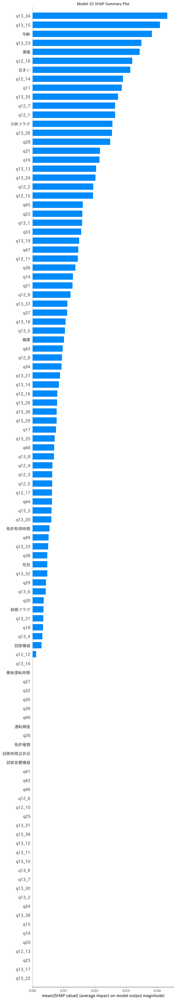

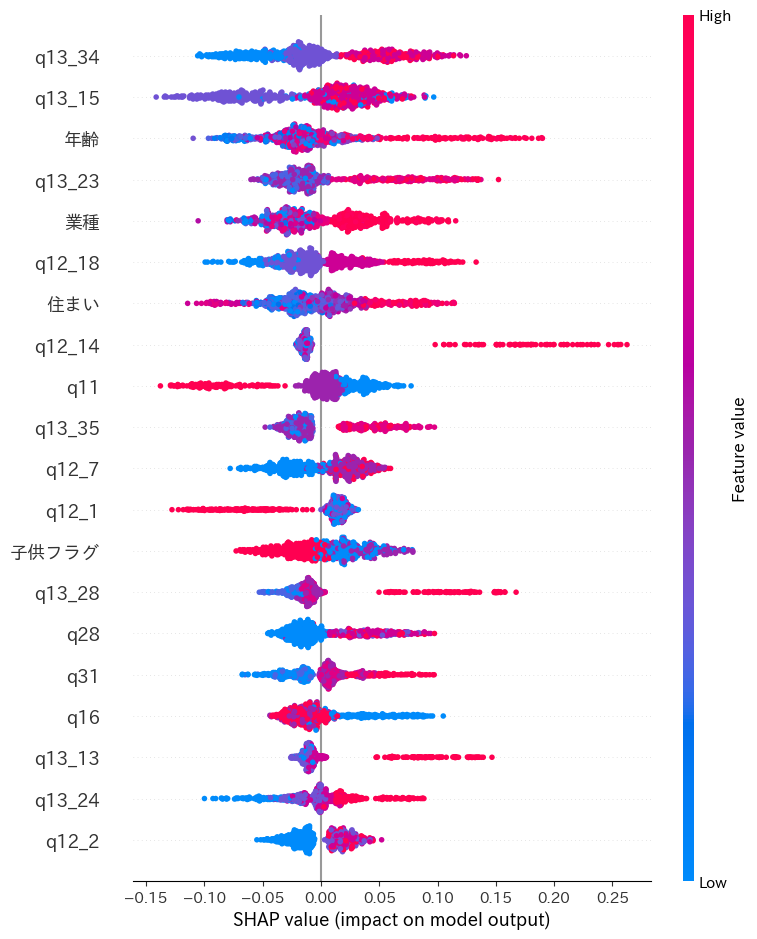

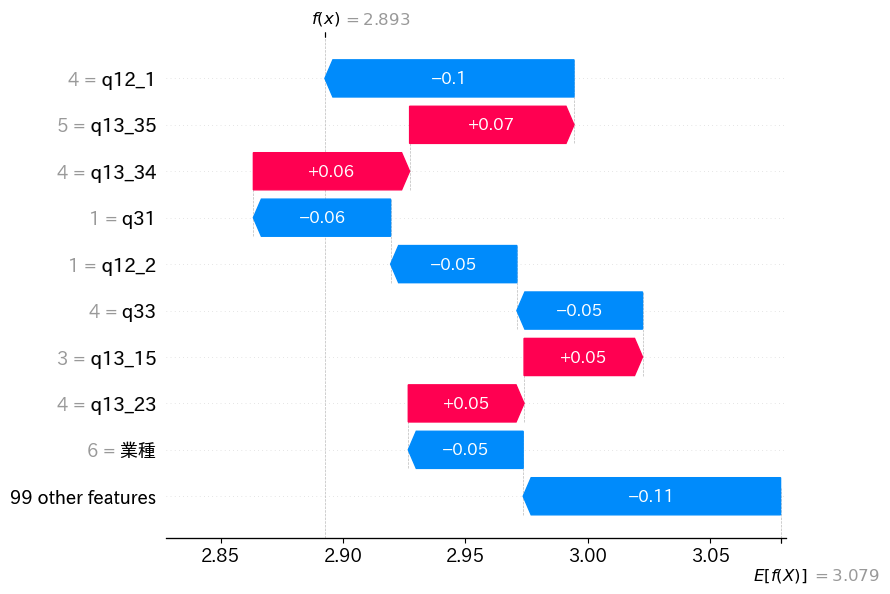

Model 33 SHAP Values: [[ 0.          0.01327343 -0.0133937  ... -0.00997482 -0.01009482
  -0.02033932]
 [ 0.         -0.0351229   0.03365776 ...  0.01580388  0.00390108
  -0.01391752]
 [ 0.         -0.07232911  0.01328556 ...  0.0412466  -0.00093605
  -0.01888143]
 ...
 [ 0.          0.05376681 -0.00586217 ... -0.00988042 -0.01648325
   0.00399621]
 [ 0.          0.07806351  0.024954   ...  0.04585253  0.01371626
   0.00741378]
 [ 0.          0.0461232   0.01090202 ... -0.00427552 -0.01499053
   0.01901341]] (804, 108)


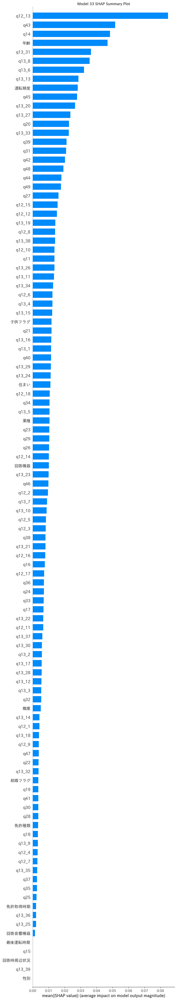

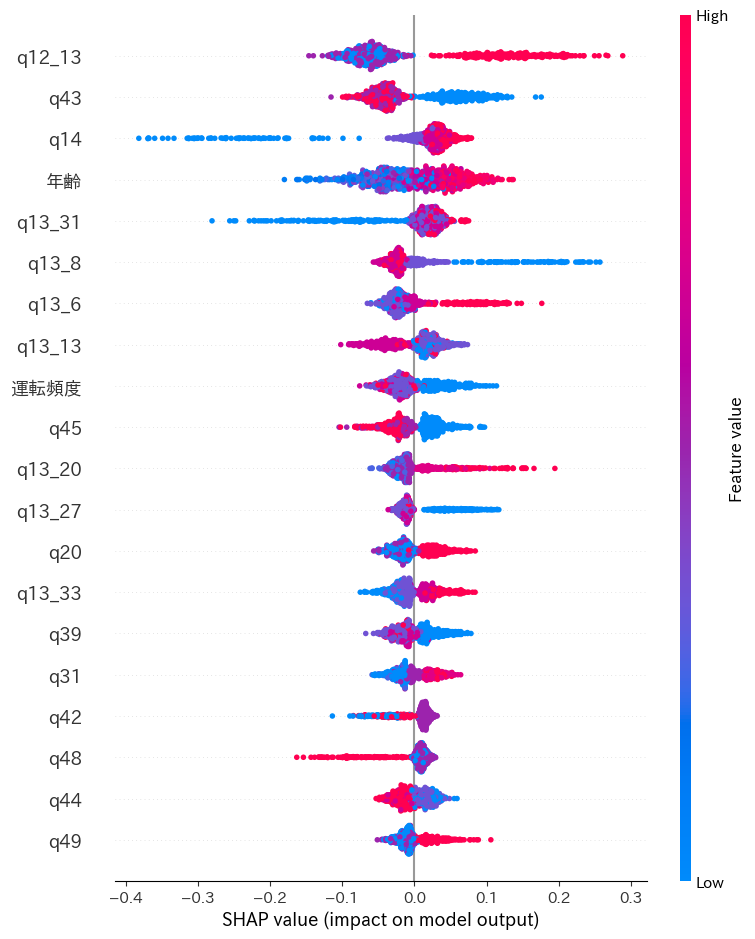

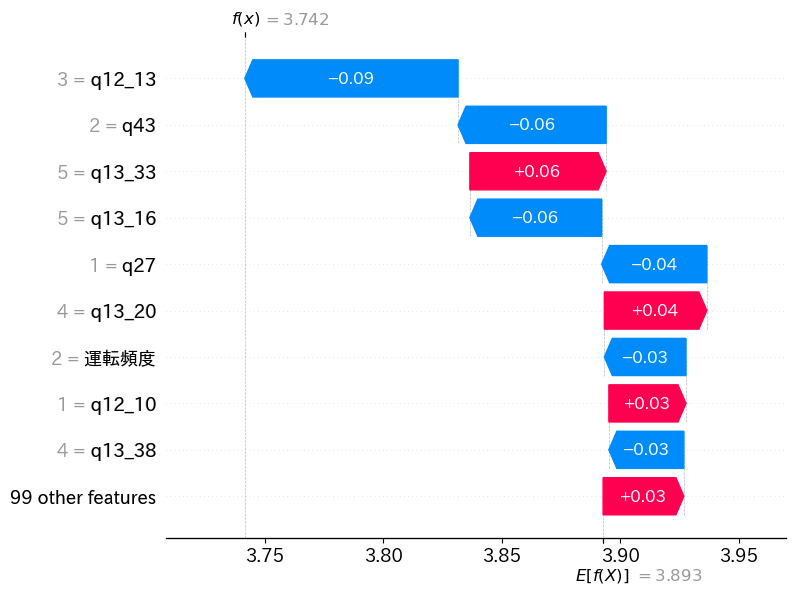

Model 34 SHAP Values: [[ 0.         -0.00800851  0.         ...  0.          0.
   0.0248073 ]
 [ 0.         -0.01709213  0.         ...  0.          0.
   0.12778431]
 [ 0.         -0.00800851  0.         ...  0.          0.
  -0.03128504]
 ...
 [ 0.          0.02390599  0.         ...  0.          0.
  -0.05560217]
 [ 0.          0.02390599  0.         ...  0.          0.
  -0.02764875]
 [ 0.          0.02390599  0.         ...  0.          0.
  -0.01760483]] (804, 108)


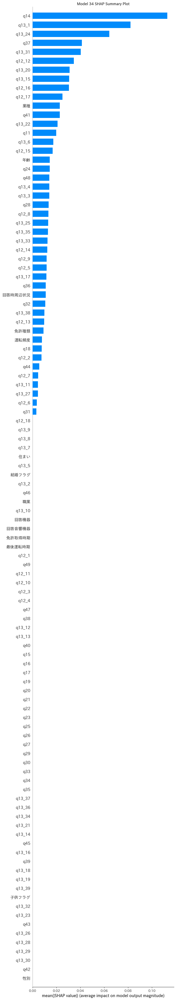

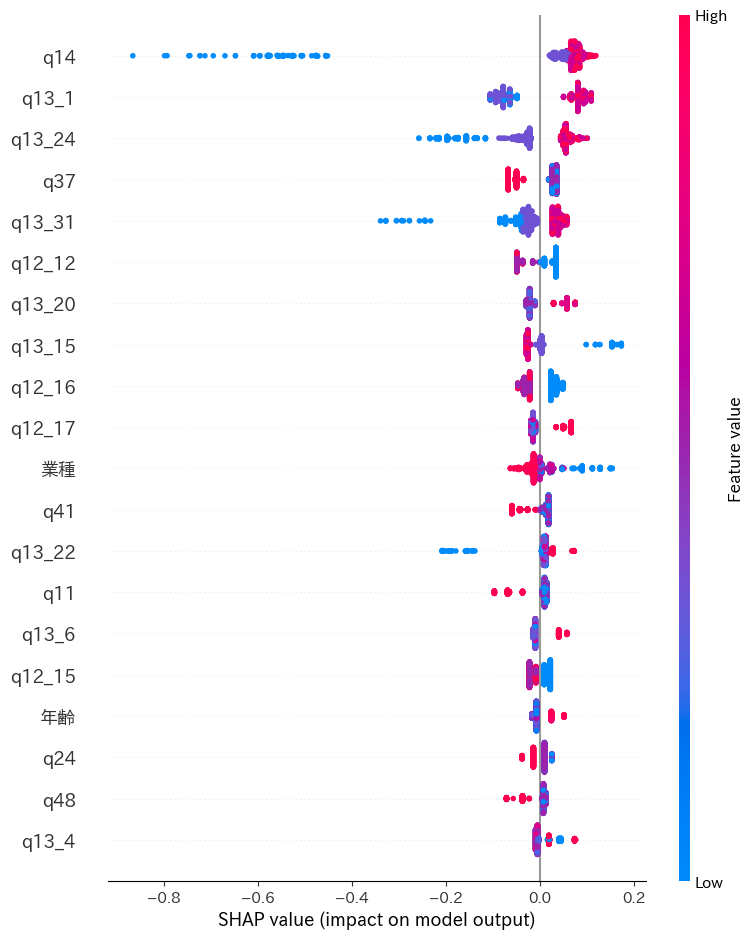

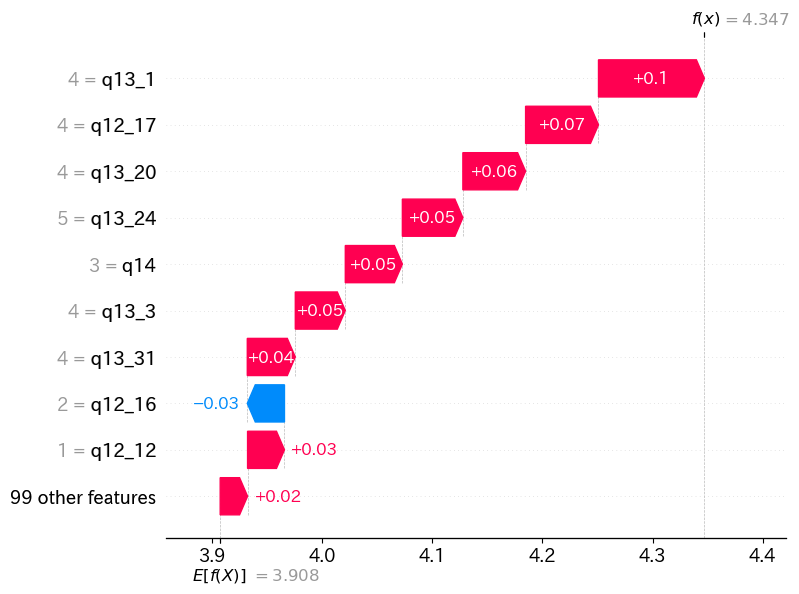

Model 35 SHAP Values: [[ 0.         -0.01685322  0.00147161 ...  0.         -0.00389969
   0.00942189]
 [ 0.         -0.02616313 -0.01084288 ...  0.          0.01344978
   0.02356225]
 [ 0.         -0.01325211  0.00718562 ...  0.          0.00525778
  -0.01777549]
 ...
 [ 0.          0.05121443 -0.00990655 ...  0.         -0.00601871
  -0.02815413]
 [ 0.          0.0251358   0.01697227 ...  0.          0.00546042
  -0.01860258]
 [ 0.          0.0532369   0.00929967 ...  0.          0.00041551
  -0.00847596]] (804, 108)


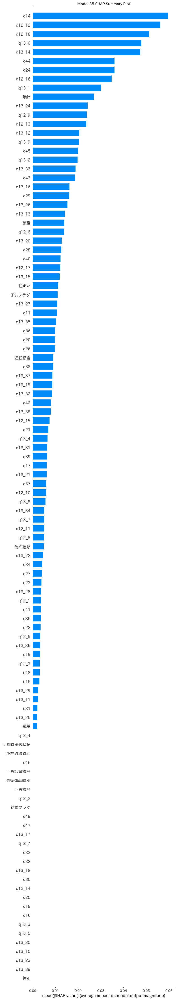

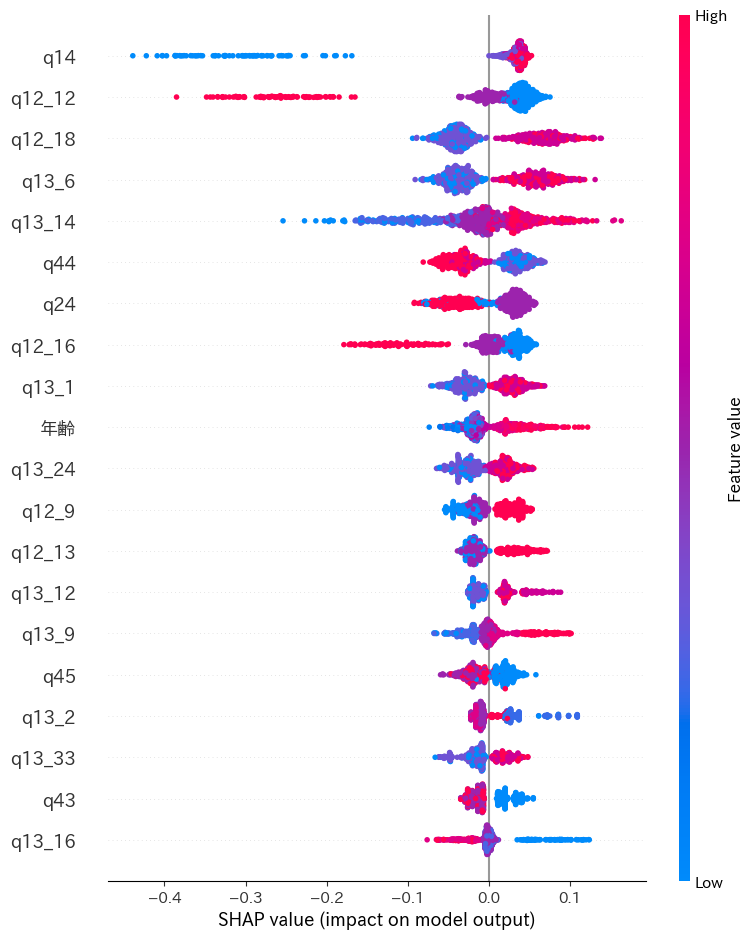

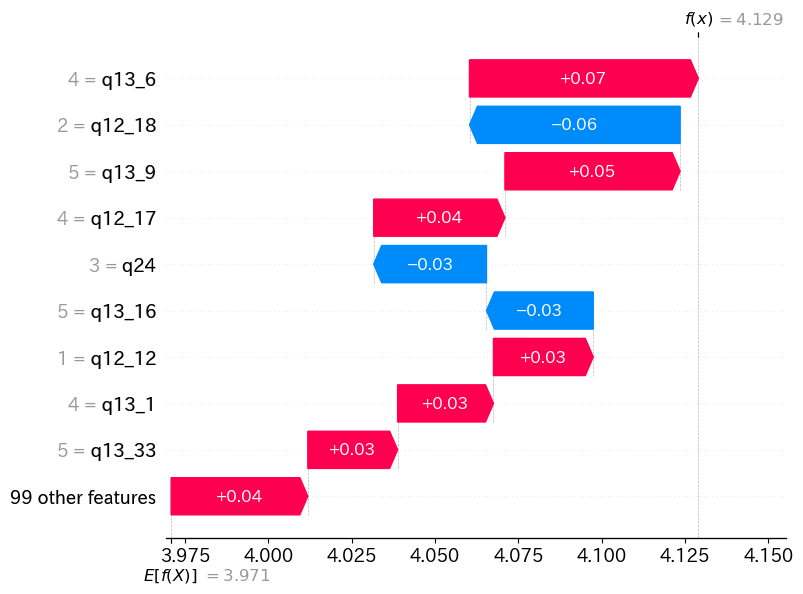

Model 36 SHAP Values: [[-0.00149732  0.02053791 -0.00571283 ...  0.00196275  0.
   0.02249742]
 [-0.01419581  0.00637337 -0.10505417 ... -0.00044812  0.
   0.0061075 ]
 [-0.00186989  0.01753508 -0.03158562 ... -0.0043006   0.
   0.00046272]
 ...
 [ 0.00230006 -0.02659004 -0.00999336 ... -0.00089032  0.
  -0.02724607]
 [ 0.00322778 -0.04651035  0.05530175 ... -0.0017223   0.
  -0.01740915]
 [ 0.00223817 -0.05189294  0.03491467 ... -0.00858041  0.
  -0.01674385]] (804, 108)


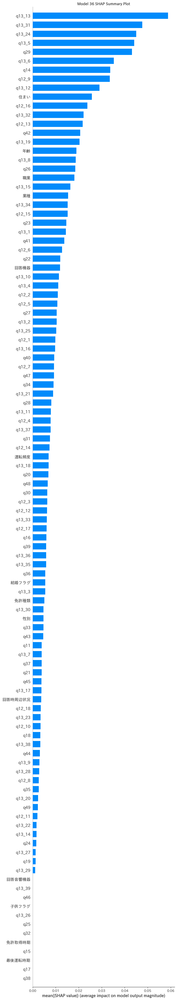

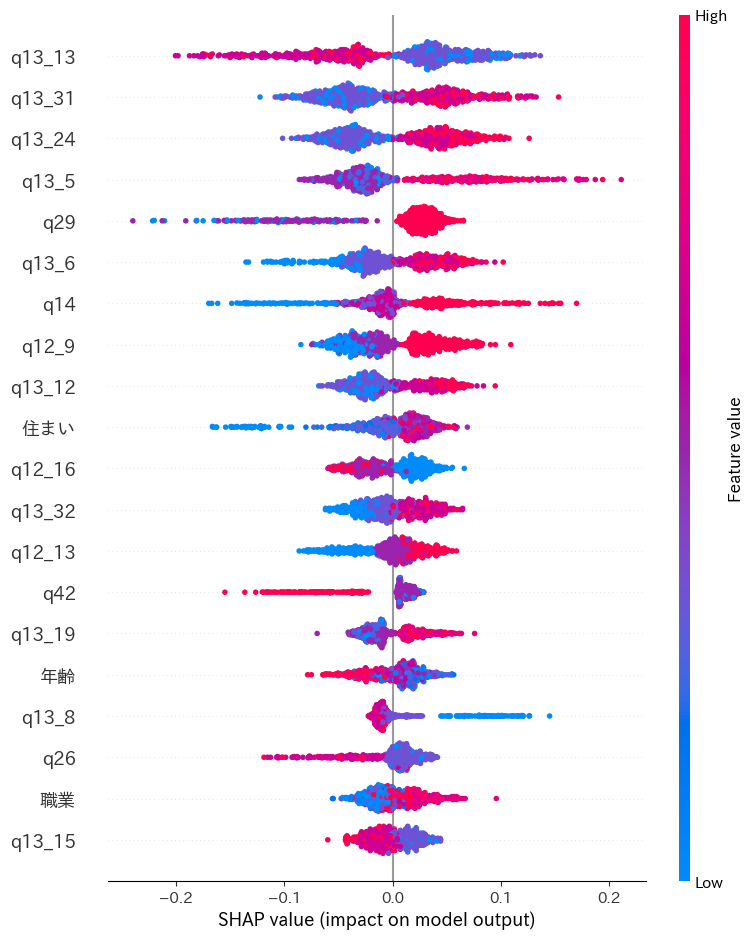

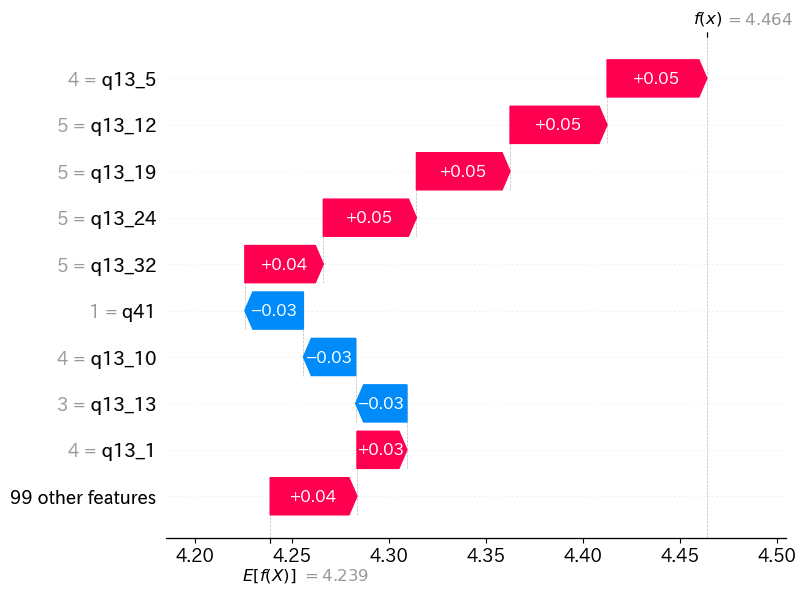

Model 37 SHAP Values: [[-0.00124776 -0.03864278 -0.013796   ...  0.01958622 -0.01302873
   0.01948236]
 [-0.00183902 -0.01539927  0.00614368 ... -0.00256874  0.00322389
   0.0250411 ]
 [-0.00078717 -0.09163489 -0.01482826 ... -0.00986764  0.0072014
  -0.01866351]
 ...
 [ 0.00344839  0.01928899 -0.0010156  ... -0.0113549  -0.00576875
  -0.01282781]
 [ 0.01152602  0.01378604  0.0090199  ...  0.00473041  0.00100304
  -0.02640963]
 [ 0.00772046  0.05990368 -0.01084399 ... -0.00816085  0.00275313
  -0.01252824]] (804, 108)


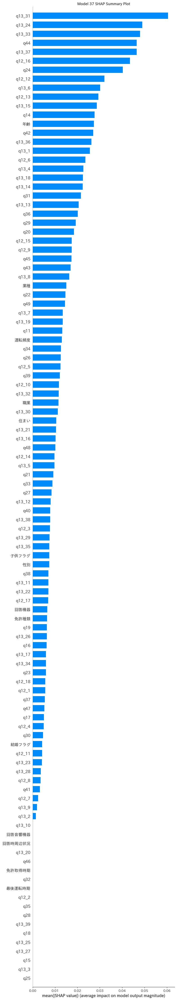

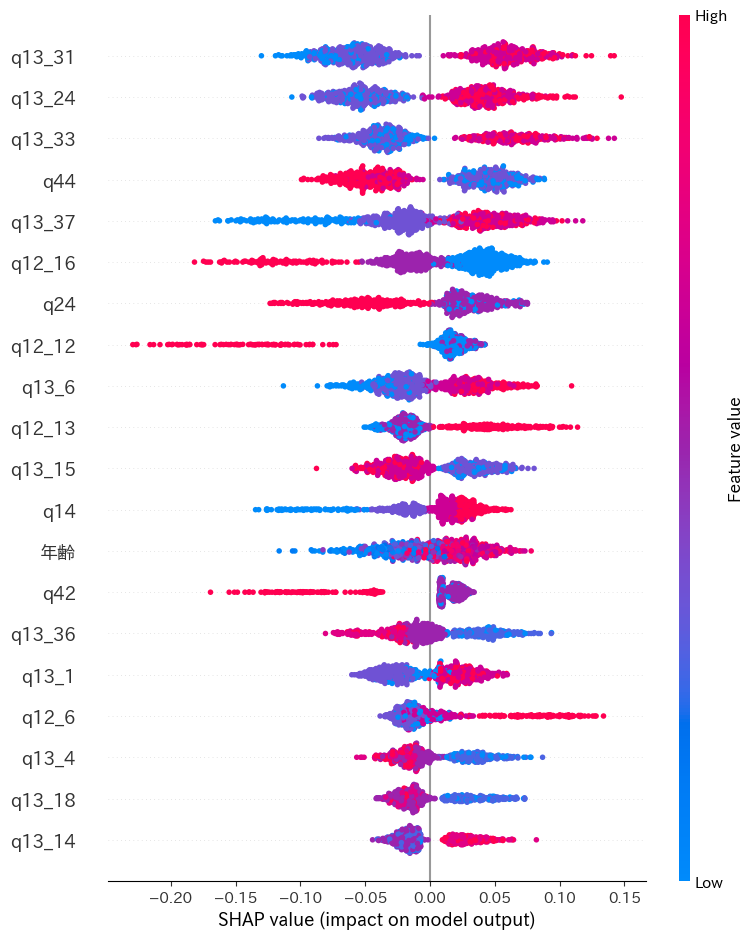

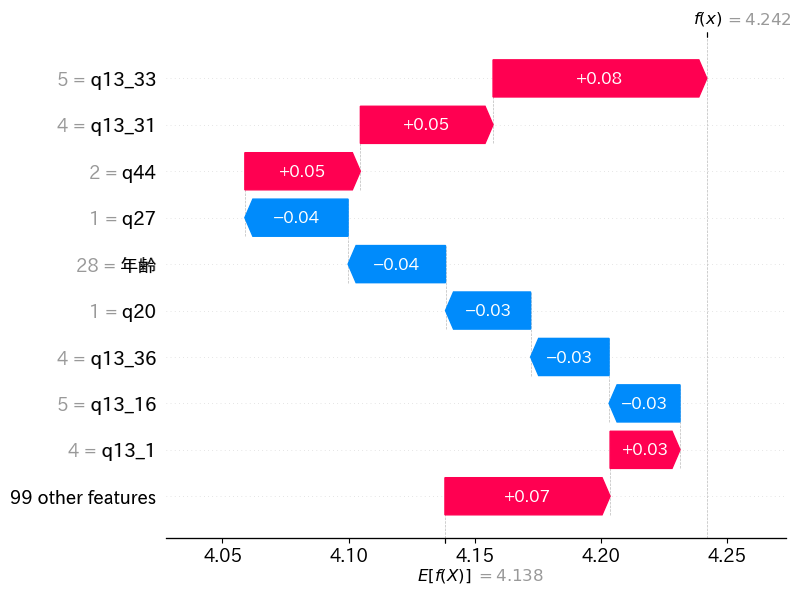

Model 38 SHAP Values: [[-0.0128242  -0.00426422 -0.02061394 ... -0.00609681 -0.0094526
   0.03577562]
 [-0.01987483 -0.00398109 -0.02404883 ...  0.00675464  0.00732748
   0.0331714 ]
 [ 0.00510889 -0.00414151 -0.00021705 ...  0.02071592  0.00452059
  -0.00899633]
 ...
 [-0.00374766 -0.00046578 -0.00148021 ... -0.00396839 -0.0078572
  -0.01398957]
 [ 0.03264233 -0.03043781  0.00671014 ...  0.00934343  0.01201086
  -0.01133375]
 [ 0.03277868 -0.01492326 -0.00109306 ...  0.00066415  0.01150402
  -0.01152057]] (804, 108)


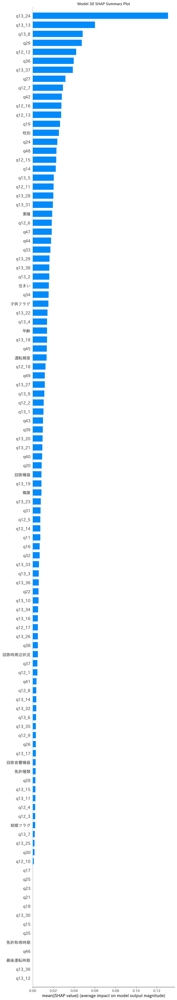

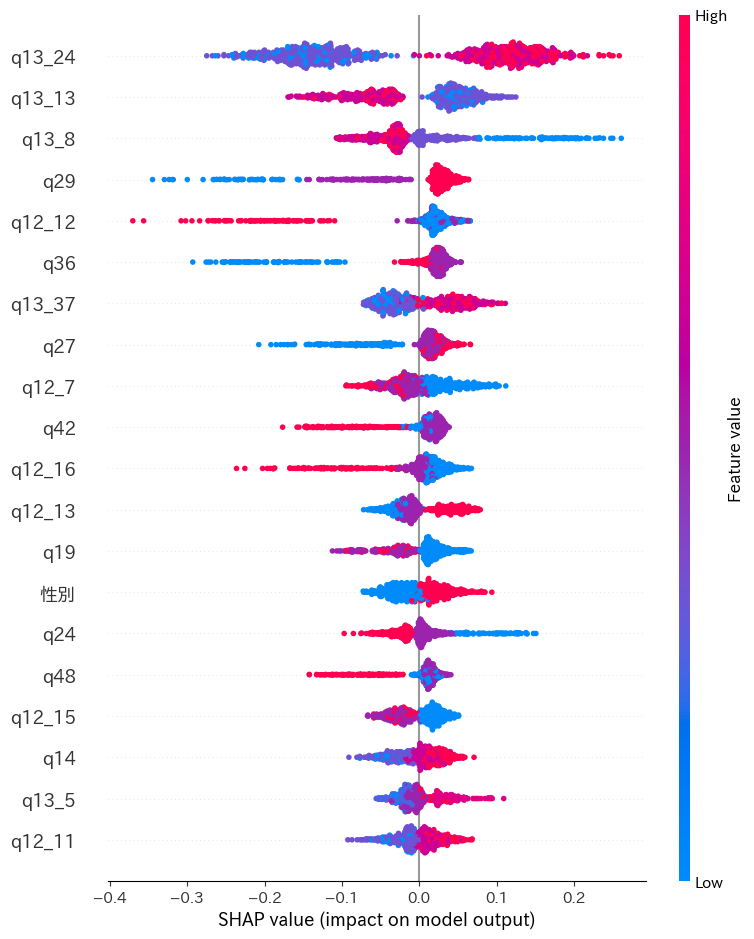

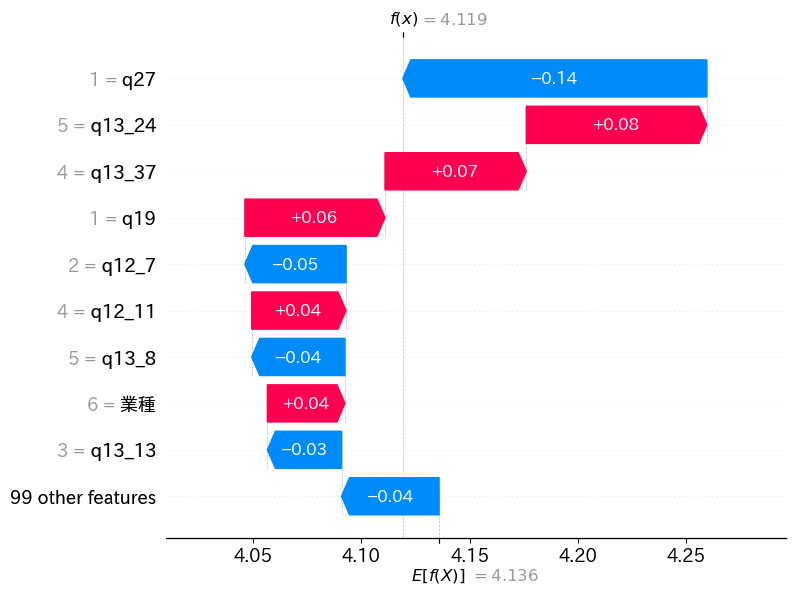

Model 39 SHAP Values: [[ 0.         -0.00804879 -0.00050874 ...  0.01990453 -0.00164272
   0.01773367]
 [ 0.         -0.00074374  0.00506837 ... -0.00126617  0.00634577
   0.01925294]
 [ 0.          0.0025693   0.00388424 ... -0.00959233  0.01469441
  -0.00171766]
 ...
 [ 0.          0.00326377  0.00129535 ... -0.00639871  0.00177284
  -0.0245885 ]
 [ 0.          0.0083032   0.02175874 ...  0.00024161 -0.00778098
  -0.03471998]
 [ 0.          0.00972842  0.00260333 ...  0.00030304 -0.00145232
  -0.01489904]] (804, 108)


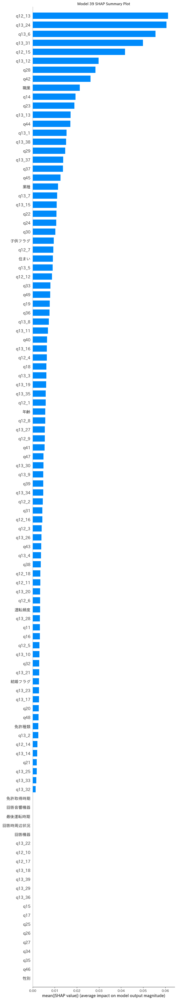

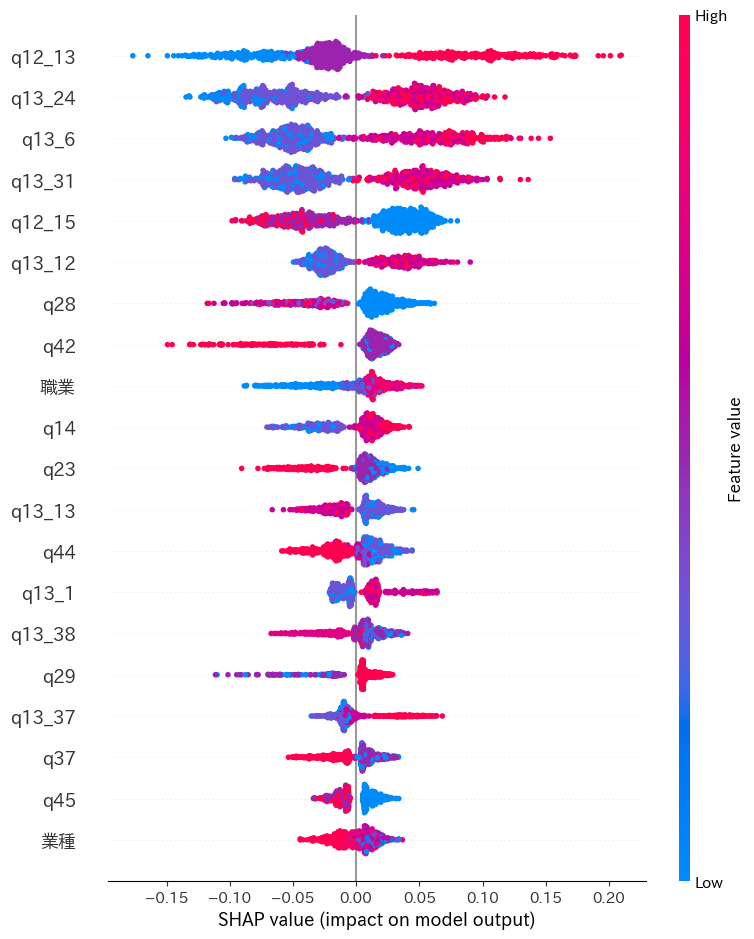

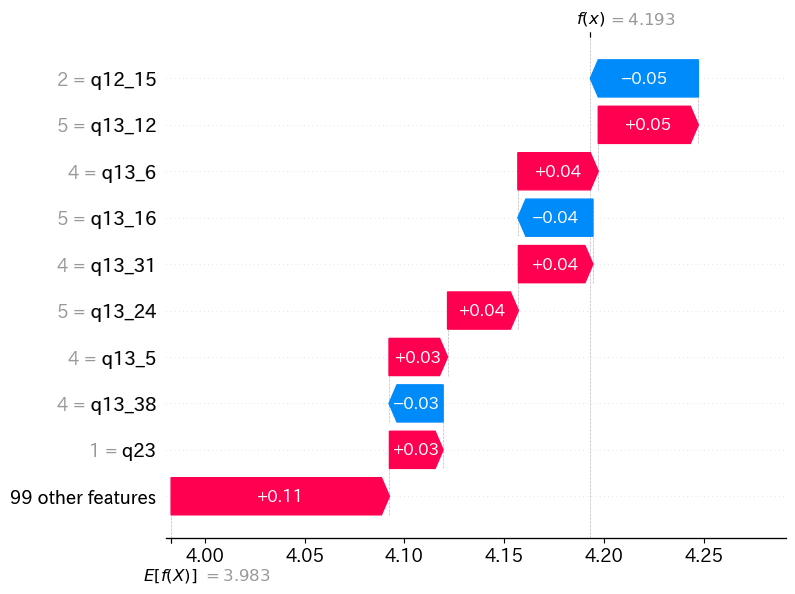

Model 40 SHAP Values: [[-5.17606480e-05  1.43296810e-02  1.31221796e-02 ...  3.76239540e-03
  -5.99742527e-04 -7.47512566e-04]
 [-7.93408541e-03 -2.85516697e-03  6.38646028e-03 ... -9.27545939e-03
   4.55349321e-03  4.03443683e-03]
 [ 5.65126971e-03  3.37191866e-03  2.73416909e-02 ... -8.52446129e-03
   3.57421074e-05  1.24671891e-03]
 ...
 [ 4.48362437e-04 -7.06029429e-03  4.93043548e-03 ... -3.61688066e-04
  -7.97874308e-04 -3.58332818e-03]
 [-2.76222278e-04  3.09985693e-02  2.14787088e-02 ... -6.70060901e-03
   1.80240445e-03 -7.51554844e-03]
 [ 3.62291411e-04  4.23193622e-02 -3.09071490e-03 ...  8.46663054e-04
   5.40030973e-03 -4.04727332e-03]] (804, 108)


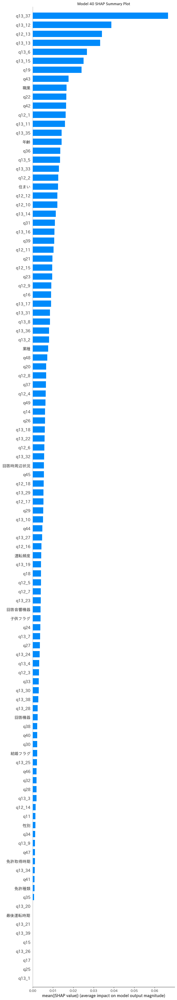

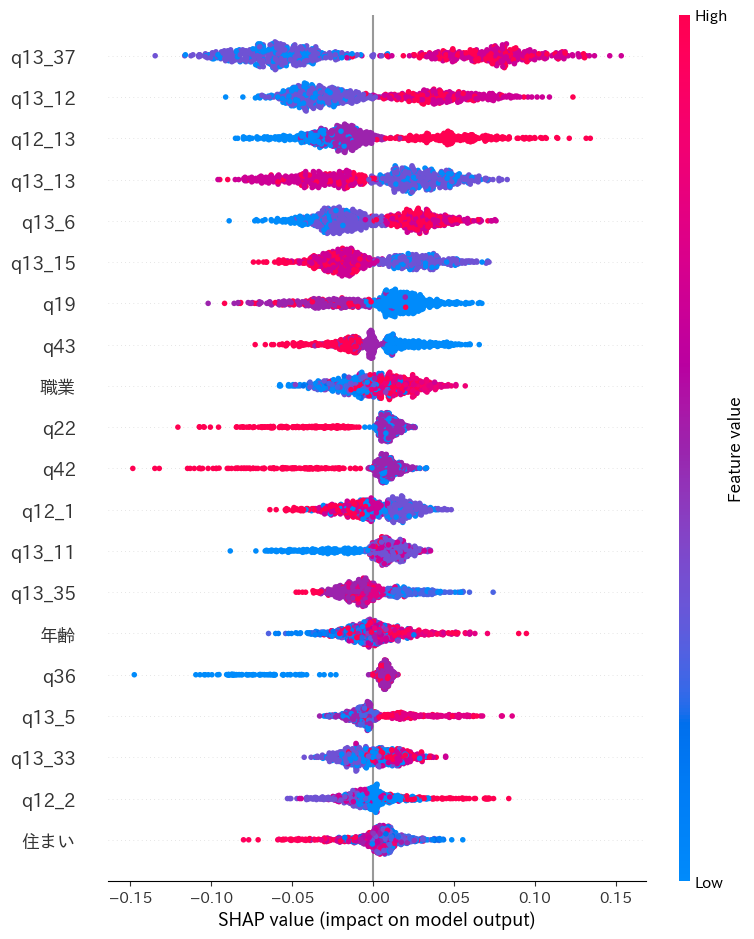

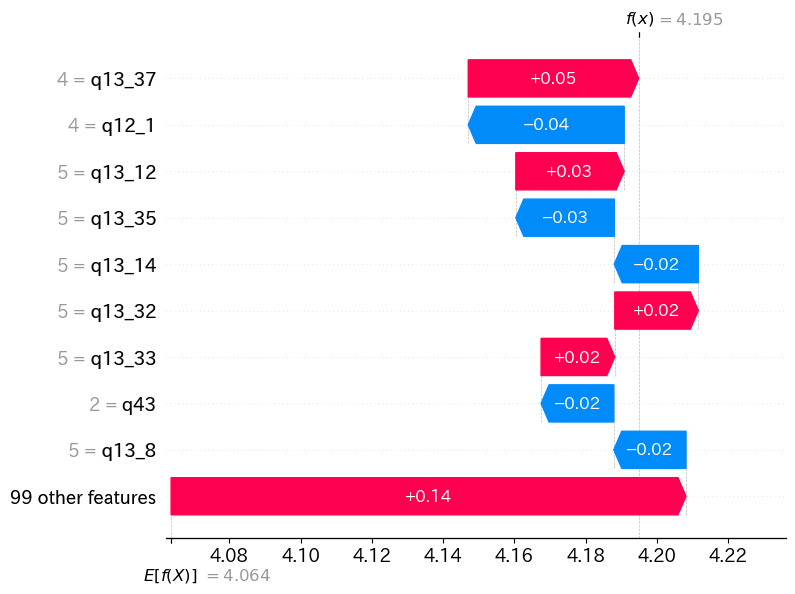

In [32]:
# #shapのインストール
# !pip install shap

#shapのインポート
import shap

for i in range(len(models)):
    model = models[i]
    
    # SHAP値を計算
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(X)
    print(f'Model {i+1} SHAP Values:', shap_values, shap_values.shape)

    #タイトルの設定
    plt.title(f'Model {i+1} SHAP Summary Plot')
    
    # SHAP値のプロット
    shap.summary_plot(shap_values, X, plot_type='bar', max_display=110)  # max_displayで表示する特徴量の数を指定
    
    # SHAP値のプロット
    shap.summary_plot(shap_values, X, max_display=20)  # max_displayで表示する

    #Waterfall plot
    shap.waterfall_plot(shap.Explanation(values=shap_values[0], base_values=explainer.expected_value, data=X.iloc[0], feature_names=X.columns.tolist()))




In [31]:
#shap影響度の低い特徴量を表示





In [62]:
# #df.sc2_1のdataframeを作成,列名をageにする
# df_age = pd.DataFrame(df.sc2_1)
# df_age.rename(columns={'sc2_1':'age'},inplace=True)


In [63]:

# #df.sc2_1のヒストグラム(年齢) 19~83歳
# import japanize_matplotlib

# #ヒストグラム　bins数を指定
# plt.hist(df_age,bins=6)
# #ラベル名
# plt.xlabel('年齢')
# plt.ylabel('人数')
# plt.title('年齢のヒストグラム')
# plt.show()

In [64]:
#19~30,31~40,41~50,51~60,61~70,71~83
# #年齢別の人数
# df_age['age_bin'] = pd.cut(df_age['age'], [19,30,40,50,60,70,83], right=False)

# df_age.value_counts()
# df_age.to_csv('surbay_data.csv',index=False)
# df_age.head(10)

In [65]:
# #カラム名'sc1'を性別に，'sc2_1'を年齢に変更
# df.rename(columns={'sc1':'性別','sc2_1':'年齢'},inplace=True)

In [66]:
df

,性別,年齢,住まい,結婚フラグ,職業,回答機器,回答音響機器,回答時周辺状況,免許種類,免許取得時期,...,bq-1,bq-2,cq-1,cq-2,dq-1,dq-2,eq-1,eq-2,子供フラグ,業種
0,1,28,14,1,1,1,2,1,2,4,...,1,0,1,0,1,0,1,0,2,6
1,1,28,1,2,1,2,1,4,2,4,...,1,0,1,0,1,0,1,0,0,0
2,1,28,11,2,9,1,1,3,2,4,...,1,0,1,0,1,0,1,0,0,18
3,1,20,21,1,12,2,1,1,1,2,...,1,0,1,0,1,0,1,0,2,14
4,1,27,13,2,11,1,1,1,1,4,...,1,0,1,0,1,0,1,0,2,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
799,2,72,40,2,10,1,1,2,2,5,...,1,0,1,0,1,0,1,0,0,22
800,2,71,13,2,11,3,1,1,2,5,...,1,0,1,0,1,0,1,0,1,22
801,2,72,13,2,10,2,3,2,2,5,...,1,0,1,0,1,0,1,0,2,22
802,2,75,43,2,11,1,1,1,2,5,...,1,0,1,0,1,0,1,0,1,22


In [67]:
#sc1,sc2_1,sc3,sc4,sc6,sc8,q1,q2,q3,q4,q4sq,q5,q5sq,q6,q7,q8

In [68]:
s = pd.read_excel('主観評価設問状態_origin_出力100.xlsx')
s


,好み1,不快1,個人的に好き1,なぜ危険なのか1,どのように改善したらよいか1,なるほど1,自分には関係ない1,改善しようと思う1,これからは注意して運転しよう1,急ブレーキのたびに出たら不快1,...,たまに出てきても問題ない5,何度も出てきたら煩わしく5,ブレーキに関する内容5,自分の運転に対する内容5,何の操作に対する指摘かよくわからなかった5,分かりやすかった5,理解しやすかった5,指摘内容の把握を流暢に5,把握は楽5,難しかった5
0,1,3,2,1,1,1,3,3,1,3,...,3,4,4,4,4,4,4,4,4,4
1,3,3,3,3,3,3,3,3,3,3,...,3,3,3,3,3,3,3,3,3,3
2,1,5,1,1,5,1,5,1,1,1,...,1,4,4,5,2,5,5,3,5,2
3,3,3,3,1,5,1,1,1,1,1,...,3,4,5,4,5,4,4,4,4,3
4,1,1,1,1,1,1,1,1,1,5,...,1,1,5,5,4,5,5,5,5,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
799,3,5,3,1,1,1,3,1,3,3,...,2,3,5,5,5,5,5,5,5,5
800,1,5,1,1,5,1,5,1,1,1,...,5,2,5,5,1,5,5,5,5,5
801,5,1,5,5,1,4,1,5,5,5,...,1,5,5,5,1,5,5,5,5,1
802,1,5,1,1,5,1,1,1,3,5,...,4,4,5,5,5,5,5,5,5,5


In [69]:
# !pip install tensorflow

Epoch 1/100


c:\Users\shun0\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 17.2868 - mae: 3.4420 - val_loss: 8.3219 - val_mae: 2.4218
Epoch 2/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 6.8593 - mae: 2.1356 - val_loss: 3.1319 - val_mae: 1.3976
Epoch 3/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 2.6727 - mae: 1.2920 - val_loss: 1.6146 - val_mae: 1.0299
Epoch 4/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 1.5924 - mae: 1.0190 - val_loss: 1.3918 - val_mae: 0.9588
Epoch 5/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 1.4343 - mae: 0.9657 - val_loss: 1.3311 - val_mae: 0.9377
Epoch 6/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 1.3959 - mae: 0.9559 - val_loss: 1.3191 - val_mae: 0.9370
Epoch 7/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 1.3661 - mae: 0.9469 - val_loss: 1.2633 - val_mae: 0.9156
Epoch 8/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 1.3252 - mae: 0.9360 - val_loss: 1.2614 - val_mae: 0.9174
Epoch 9/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 1.2817 - mae: 0

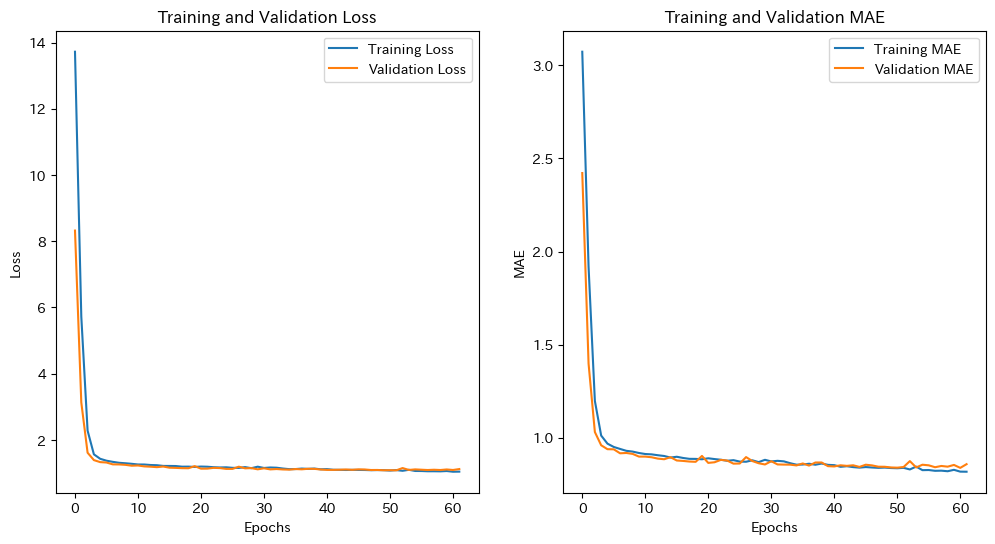

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 454us/step - loss: 1.0494 - mae: 0.8251
Loss: 1.052980661392212, MAE: 0.82635498046875


In [70]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# モデルのハイパーパラメータ
input_dim = 118  # 入力次元数
output_dim = 100  # 出力次元数
hidden_units = 64  # 隠れ層のユニット数
epochs = 100  # 学習回数
batch_size = 32  # バッチサイズ

# ダミーデータの作成（本番環境では実データに置き換え）
# X_train: 入力データ, y_train: 出力データ
X_train = X
y_train = s

# データの分割

X_train, X_test, y_train, y_test = train_test_split(X_train, y_train, test_size=0.2, random_state=0)

# モデルの構築
model = Sequential()

# 入力層と最初の隠れ層
model.add(Dense(hidden_units, input_dim=input_dim, activation='relu'))

# 追加の隠れ層（必要に応じて）
model.add(Dense(hidden_units, activation='relu'))

# 出力層
model.add(Dense(output_dim, activation='linear'))

# モデルのコンパイル
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# # モデルの学習
# model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, validation_split=0.2)
# import matplotlib.pyplot as plt

# モデルの学習（先ほどのコードと同様）
#early stopping
from tensorflow.keras.callbacks import EarlyStopping

# EarlyStoppingのコールバックを設定
early_stopping = EarlyStopping(monitor='val_loss', patience=10, verbose=1)

# モデルの学習
history = model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, validation_split=0.2, callbacks=[early_stopping])
# history = model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, validation_split=0.2)

# 学習過程のlossとmaeの推移を取得
loss = history.history['loss']
val_loss = history.history['val_loss']
mae = history.history['mae']
val_mae = history.history['val_mae']

# 学習過程のグラフ表示
plt.figure(figsize=(12, 6))

# Lossのプロット
plt.subplot(1, 2, 1)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# MAEのプロット
plt.subplot(1, 2, 2)
plt.plot(mae, label='Training MAE')
plt.plot(val_mae, label='Validation MAE')
plt.title('Training and Validation MAE')
plt.xlabel('Epochs')
plt.ylabel('MAE')
plt.legend()

plt.show()
# モデルの評価
loss, mae = model.evaluate(X_train, y_train)
print(f"Loss: {loss}, MAE: {mae}")

# # モデルの予測を実行
# y_pred = model.predict(X_test)

# # 各次元ごとの平均二乗誤差を計算
# mse_per_dim = np.mean((y_test - y_pred) ** 2, axis=0)

# for i in range(0,100,20):
#     # ロスが小さい次元のデータをプロット
    
#     plt.figure(figsize=(10, 6))
#     plt.bar(range(20), mse_per_dim.iloc[i:i+20])
#     plt.title('MSE per Output Dimension')
#     plt.xlabel('Output Dimension')
#     plt.ylabel('MSE')
#     plt.show()
#     #どの次元のロスが小さいかを確認する
#     best_dimensions = np.argsort(mse_per_dim.iloc[i:i+20])[:20]  # ロスが小さい上位10次元
#     # print("Best dimensions (lowest MSE):", best_dimensions)
#     print("MSE of best dimensions:", mse_per_dim.iloc[i:i+20][best_dimensions])
   



In [43]:
# # モデルの予測を実行
# y_pred = model.predict(X_test)

# # 各次元ごとの平均二乗誤差を計算
# mse_per_dim = np.mean((y_test - y_pred) ** 2, axis=0)

# # 各次元ごとのロスをプロット
# plt.figure(figsize=(10, 6))
# plt.bar(range(output_dim), mse_per_dim)
# plt.title('MSE per Output Dimension')
# plt.xlabel('Output Dimension')
# plt.ylabel('MSE')
# plt.show()

# # # どの次元のロスが大きいかを確認する
# # worst_dimensions = np.argsort(mse_per_dim)[-10:]  # ロスが大きい上位10次元
# # print("Worst dimensions (highest MSE):", worst_dimensions)
# # print("MSE of worst dimensions:", mse_per_dim[worst_dimensions])

# #どの次元のロスが小さいかを確認する
# best_dimensions = np.argsort(mse_per_dim)[:20]  # ロスが小さい上位10次元
# print("Best dimensions (lowest MSE):", best_dimensions)
# print("MSE of best dimensions:", mse_per_dim[best_dimensions])





In [73]:
# モデルの予測を実行
y_pred = model.predict(X_test)

# 各次元ごとの平均二乗誤差を計算
mse_per_dim = np.mean((y_test - y_pred) ** 2, axis=0)

for i in range(0,100,20):
    # ロスが小さい次元のデータをプロット
    
    plt.figure(figsize=(10, 6))
    plt.bar(range(20), mse_per_dim.iloc[i:i+20])
    plt.title('MSE per Output Dimension')
    plt.xlabel('Output Dimension')
    plt.ylabel('MSE')
    plt.show()
    #どの次元のロスが小さいかを確認する
    best_dimensions = np.argsort(mse_per_dim.iloc[i:i+20])[:20]  # ロスが小さい上位10次元
    print("Best dimensions (lowest MSE):", best_dimensions)
    print("MSE of best dimensions:", mse_per_dim.iloc[i:i+20][best_dimensions])
   



5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 


AttributeError: 'numpy.ndarray' object has no attribute 'iloc'

<Figure size 1000x600 with 0 Axes>

c:\Users\shun0\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 86: early stopping
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
Epoch 95: early stopping
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
Epoch 60: early stopping
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
Epoch 63: early stopping
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
Epoch 49: early stopping
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 990us/step


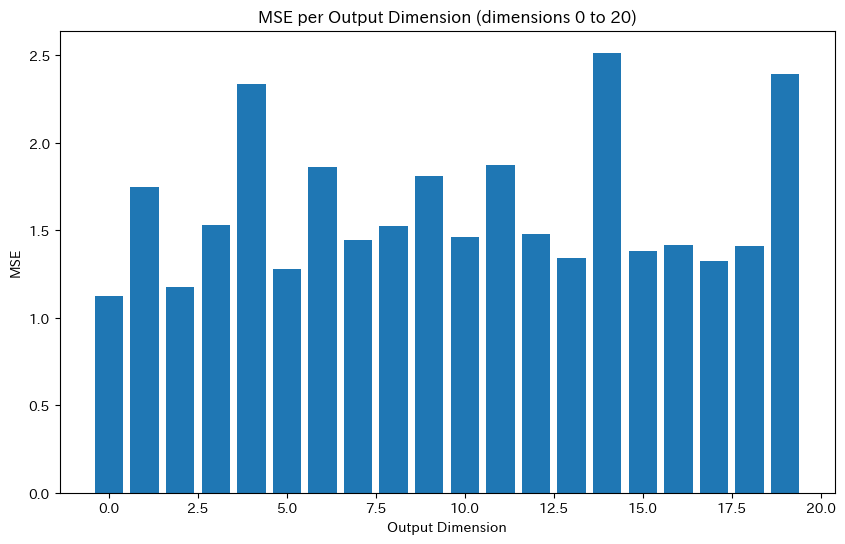

MSE of best dimensions for dimensions 0-20:
[1.12355232 1.17331693 1.27992434 1.32689381 1.34254699 1.38016942
 1.40774579 1.41649742 1.44530882 1.46294228]


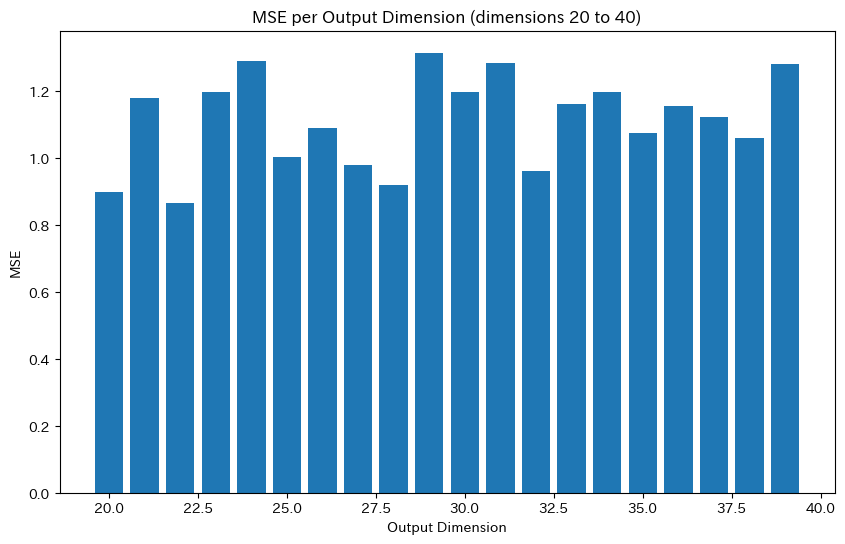

MSE of best dimensions for dimensions 20-40:
[0.86482557 0.89890836 0.91806953 0.95963229 0.97786774 1.00179731
 1.0588282  1.07489305 1.08984816 1.12078688]


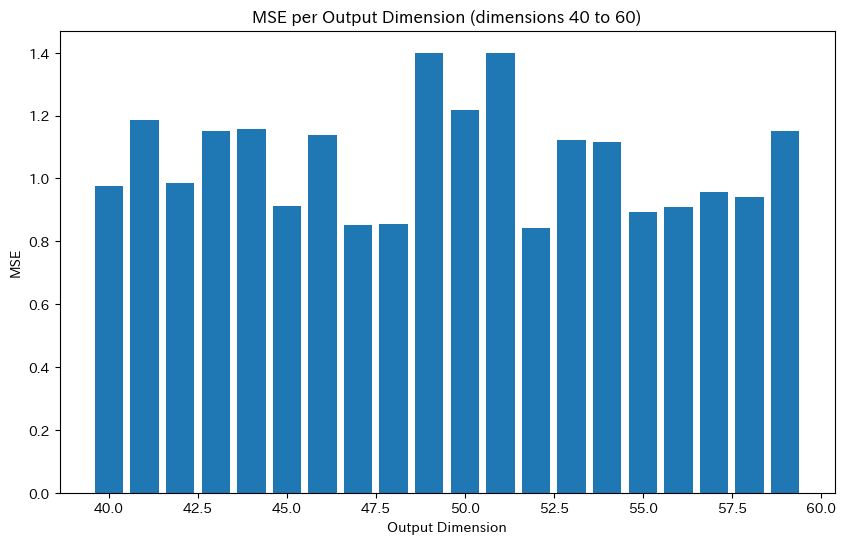

MSE of best dimensions for dimensions 40-60:
[0.84230218 0.85139208 0.85459342 0.8931931  0.91032652 0.91279756
 0.94101649 0.95624781 0.97651505 0.9861907 ]


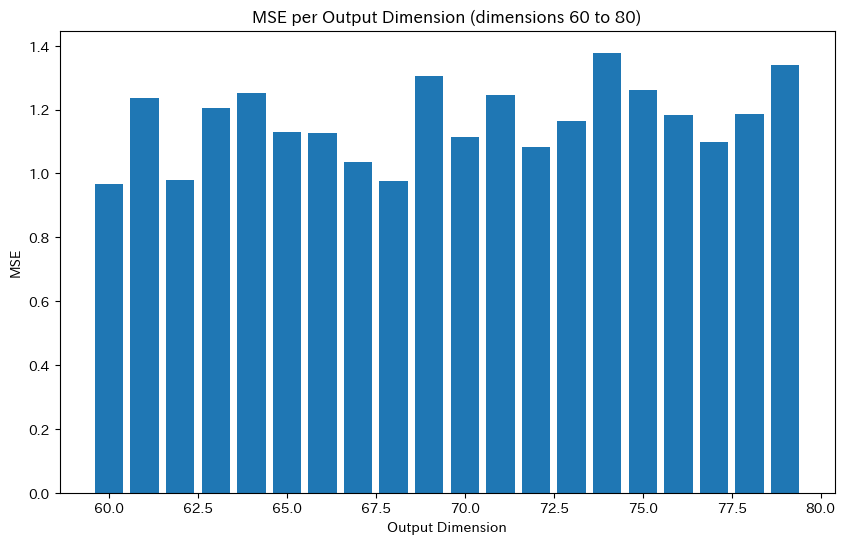

MSE of best dimensions for dimensions 60-80:
[0.96832351 0.97540268 0.97945611 1.03577278 1.0833803  1.09834859
 1.11354092 1.12620439 1.13099396 1.1652214 ]


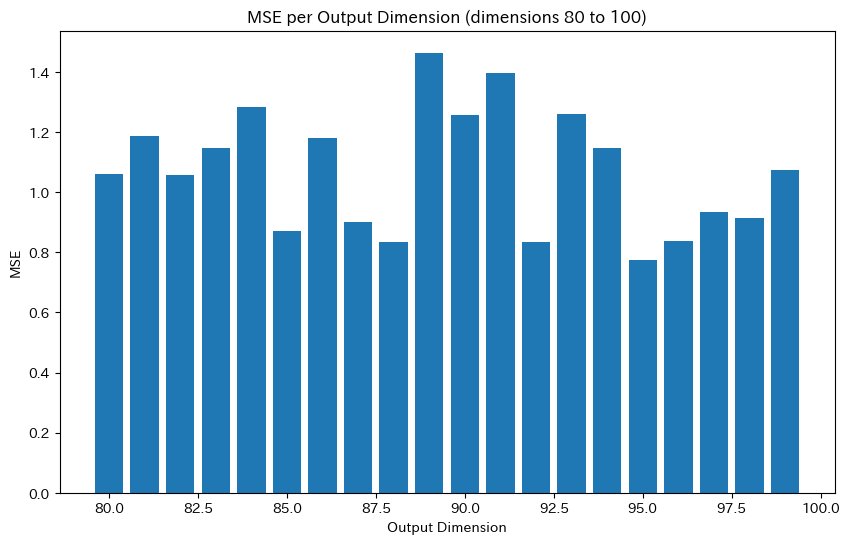

MSE of best dimensions for dimensions 80-100:
[0.77393744 0.83437008 0.83442647 0.83848797 0.87144684 0.90085679
 0.91382737 0.93494705 1.05911302 1.06103713]


In [72]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# y = s  # 実データに置き換え (回帰対象の100次元)
# X, y がデータフレームなら .values を使って NumPy 配列に変換
y = s
X = X.values
y = y.values

# モデル構築関数
def create_model(input_dim, output_dim, hidden_units):
    model = Sequential()
    model.add(Dense(hidden_units, input_dim=input_dim, activation='relu'))
    model.add(Dense(hidden_units, activation='relu'))
    model.add(Dense(output_dim, activation='linear'))
    model.compile(optimizer='adam', loss='mse', metrics=['mae'])
    return model

# クロスバリデーション用の設定
cv = 5  # 5分割
kf = KFold(n_splits=cv, shuffle=True, random_state=0)

# 各次元のMSEを保存するリスト
mse_per_dim_list = []

for train_index, test_index in kf.split(X):
    # トレーニング・テストデータの分割 (データフレームの場合は iloc で行インデックスにアクセス)
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    # モデルの作成
    model = create_model(input_dim=X.shape[1], output_dim=y.shape[1], hidden_units=64)

    # EarlyStoppingのコールバックを設定
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, verbose=1)

    # モデルの学習
    history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2, callbacks=[early_stopping], verbose=0)

    # テストデータでの予測
    y_pred = model.predict(X_test)

    # 各次元ごとのMSEを計算
    mse_per_dim = np.mean((y_test - y_pred) ** 2, axis=0)
    mse_per_dim_list.append(mse_per_dim)

# 各分割のMSEの平均を計算
mse_per_dim_avg = np.mean(mse_per_dim_list, axis=0)

# MSEのプロット (出力次元を20ずつ区切って表示)
for i in range(0, 100, 20):
    plt.figure(figsize=(10, 6))
    plt.bar(range(i, i + 20), mse_per_dim_avg[i:i+20])
    plt.title(f'MSE per Output Dimension (dimensions {i} to {i+20})')
    plt.xlabel('Output Dimension')
    plt.ylabel('MSE')
    plt.show()

    # ロスが小さい次元を確認 (20次元ごとの中でMSEが小さい順に10次元を表示)
    best_dimensions = np.argsort(mse_per_dim_avg[i:i+20])[:10]  # ロスが小さい上位10次元
    print(f"MSE of best dimensions for dimensions {i}-{i+20}:")
    print(mse_per_dim_avg[i:i+20][best_dimensions])


In [28]:
mse_per_dim[0:30]

好み1                      0.266122
不快1                      0.402637
個人的に好き1                  0.228895
なぜ危険なのか1                 0.288685
どのように改善したらよいか1           0.341796
なるほど1                    0.178721
自分には関係ない1                0.475621
改善しようと思う1                0.250687
これからは注意して運転しよう1          0.233698
急ブレーキのたびに出たら不快1          0.305066
たまに出てきても問題ない1            0.329679
何度も出てきたら煩わしく1            0.324062
ブレーキに関する内容1              0.229488
自分の運転に対する内容1             0.357243
何の操作に対する指摘かよくわからなかった1    0.396409
分かりやすかった1                0.225751
理解しやすかった1                0.251324
指摘内容の把握を流暢に1             0.251792
把握は楽1                    0.279871
難しかった1                   0.516833
好み2                      0.229004
不快2                      0.298233
個人的に好き2                  0.225943
なぜ危険なのか2                 0.335449
どのように改善したらよいか2           0.380293
なるほど2                    0.252921
自分には関係ない2                0.323664
改善しようと思う2                0.264673
これからは注意して運転しよう2          0.199768
急ブレーキのたびに出たら不快

In [29]:
np.argsort(mse_per_dim)[-10:] 

たまに出てきても問題ない5            46
何度も出てきたら煩わしく5            64
ブレーキに関する内容5              24
自分の運転に対する内容5             63
何の操作に対する指摘かよくわからなかった5    51
分かりやすかった5                14
理解しやすかった5                83
指摘内容の把握を流暢に5              1
把握は楽5                     6
難しかった5                   19
dtype: int64

In [30]:
y_train

,好み1,不快1,個人的に好き1,なぜ危険なのか1,どのように改善したらよいか1,なるほど1,自分には関係ない1,改善しようと思う1,これからは注意して運転しよう1,急ブレーキのたびに出たら不快1,...,たまに出てきても問題ない5,何度も出てきたら煩わしく5,ブレーキに関する内容5,自分の運転に対する内容5,何の操作に対する指摘かよくわからなかった5,分かりやすかった5,理解しやすかった5,指摘内容の把握を流暢に5,把握は楽5,難しかった5
0,1,3,2,1,1,1,3,3,1,3,...,3,4,4,4,4,4,4,4,4,4
1,3,3,3,3,3,3,3,3,3,3,...,3,3,3,3,3,3,3,3,3,3
2,1,5,1,1,5,1,5,1,1,1,...,1,4,4,5,2,5,5,3,5,2
3,3,3,3,1,5,1,1,1,1,1,...,3,4,5,4,5,4,4,4,4,3
4,1,1,1,1,1,1,1,1,1,5,...,1,1,5,5,4,5,5,5,5,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
799,3,5,3,1,1,1,3,1,3,3,...,2,3,5,5,5,5,5,5,5,5
800,1,5,1,1,5,1,5,1,1,1,...,5,2,5,5,1,5,5,5,5,5
801,5,1,5,5,1,4,1,5,5,5,...,1,5,5,5,1,5,5,5,5,1
802,1,5,1,1,5,1,1,1,3,5,...,4,4,5,5,5,5,5,5,5,5


Epoch 1/1600


/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 8.7587 - mae: 2.3562 - val_loss: 1.7705 - val_mae: 1.0520
Epoch 2/1600
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 982us/step - loss: 1.5108 - mae: 0.9821 - val_loss: 1.2323 - val_mae: 0.8684
Epoch 3/1600
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 875us/step - loss: 1.1614 - mae: 0.8531 - val_loss: 1.0529 - val_mae: 0.7921
Epoch 4/1600
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 868us/step - loss: 1.0433 - mae: 0.7961 - val_loss: 0.9775 - val_mae: 0.7599
Epoch 5/1600
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 847us/step - loss: 0.9495 - mae: 0.7525 - val_loss: 0.9097 - val_mae: 0.7268
Epoch 6/1600
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 849us/step - loss: 0.9004 - mae: 0.7268 - val_loss: 0.8530 - val_mae: 0.6967
Epoch 7/1600
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 926us/step - loss: 0.8700 - mae: 0.7075 - val_loss: 0.8166 - val_mae: 0.6766
Epoch 8/1600
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 857us/step - loss: 0.8424 - mae: 0.6935 - val_loss: 0.7820 - val_mae: 0.6616
Epoch 9/1600
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 879us/step -

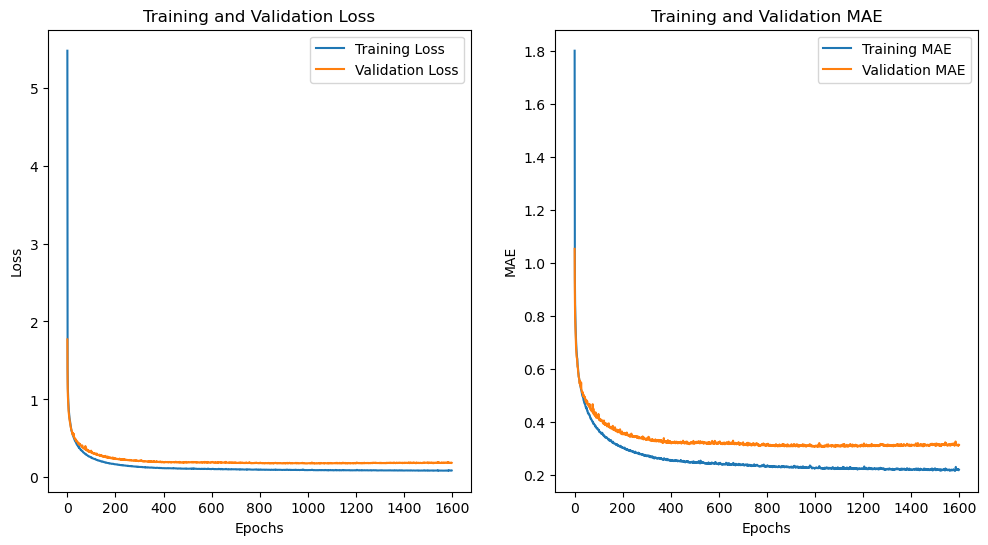

26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 874us/step


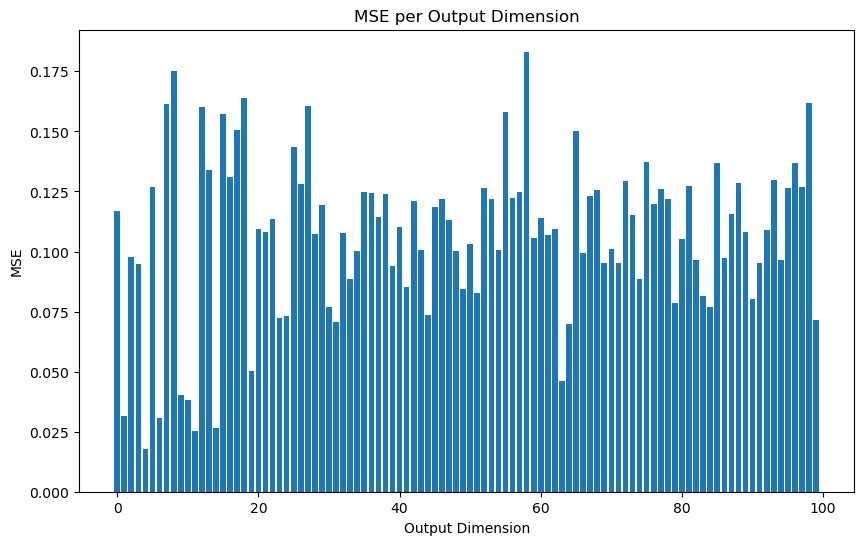

Best dimensions (lowest MSE): 好み1                       4
不快1                      11
個人的に好き1                  14
なぜ危険なのか1                  6
どのように改善したらよいか1            1
なるほど1                    10
自分には関係ない1                 9
改善しようと思う1                63
これからは注意して運転しよう1          19
急ブレーキのたびに出たら不快1          64
たまに出てきても問題ない1            31
何度も出てきたら煩わしく1            99
ブレーキに関する内容1              23
自分の運転に対する内容1             24
何の操作に対する指摘かよくわからなかった1    44
分かりやすかった1                84
理解しやすかった1                30
指摘内容の把握を流暢に1             79
把握は楽1                    90
難しかった1                   83
好み2                      51
不快2                      49
個人的に好き2                  41
なぜ危険なのか2                 74
どのように改善したらよいか2           33
なるほど2                    39
自分には関係ない2                 3
改善しようと思う2                91
これからは注意して運転しよう2          71
急ブレーキのたびに出たら不快2          69
dtype: int64
MSE of best dimensions: どのように改善したらよいか1           0.017809
何度も出てきたら煩わしく1            0.025074
何の操作に対する指摘かよくわからなかった1    

/var/folders/5r/3m3ng3v11j57dkl0psc9lphh0000gn/T/ipykernel_15242/4119519471.py:73: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print("MSE of best dimensions:", mse_per_dim[best_dimensions])


In [33]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

# モデルのハイパーパラメータ
input_dim = 247  # 入力次元数
output_dim = 100  # 出力次元数
hidden_units = 128  # 隠れ層のユニット数
epochs = 1600 # 学習回数
batch_size = 32  # バッチサイズ

# ダミーデータの作成（本番環境では実データに置き換え）
X_train = df_dropna
y_train = s

# モデルの構築
model = Sequential()
model.add(Dense(hidden_units, input_dim=input_dim, activation='relu'))
model.add(Dense(hidden_units, activation='relu'))
model.add(Dense(output_dim, activation='linear'))

# モデルのコンパイル
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# モデルの学習
history = model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, validation_split=0.2)

# 学習過程のlossとmaeの推移を取得してプロット
loss = history.history['loss']
val_loss = history.history['val_loss']
mae = history.history['mae']
val_mae = history.history['val_mae']

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(mae, label='Training MAE')
plt.plot(val_mae, label='Validation MAE')
plt.title('Training and Validation MAE')
plt.xlabel('Epochs')
plt.ylabel('MAE')
plt.legend()

plt.show()

# モデルの予測を実行
y_pred = model.predict(X_train)

# 各次元ごとの平均二乗誤差を計算
mse_per_dim = np.mean((y_train - y_pred) ** 2, axis=0)

# 各次元ごとのロスをプロット
plt.figure(figsize=(10, 6))
plt.bar(range(output_dim), mse_per_dim)
plt.title('MSE per Output Dimension')
plt.xlabel('Output Dimension')
plt.ylabel('MSE')
plt.show()

# ロスが小さい次元を出力
best_dimensions = np.argsort(mse_per_dim)[:30]  # ロスが小さい上位10次元
print("Best dimensions (lowest MSE):", best_dimensions)
print("MSE of best dimensions:", mse_per_dim[best_dimensions])


Epoch 1/300


/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 11.5238 - mae: 2.7712 - val_loss: 2.3205 - val_mae: 1.1990
Epoch 2/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 886us/step - loss: 1.7800 - mae: 1.0606 - val_loss: 1.2513 - val_mae: 0.8861
Epoch 3/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 875us/step - loss: 1.2528 - mae: 0.8915 - val_loss: 1.0730 - val_mae: 0.8080
Epoch 4/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 905us/step - loss: 1.0897 - mae: 0.8203 - val_loss: 1.0052 - val_mae: 0.7704
Epoch 5/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 900us/step - loss: 1.0199 - mae: 0.7880 - val_loss: 0.9563 - val_mae: 0.7457
Epoch 6/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 906us/step - loss: 0.9625 - mae: 0.7573 - val_loss: 0.9058 - val_mae: 0.7282
Epoch 7/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 994us/step - loss: 0.9075 - mae: 0.7306 - val_loss: 0.8699 - val_mae: 0.7095
Epoch 8/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 997us/step - loss: 0.8922 - mae: 0.7204 - val_loss: 0.8442 - val_mae: 0.6863
Epoch 9/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 983us/step - loss: 

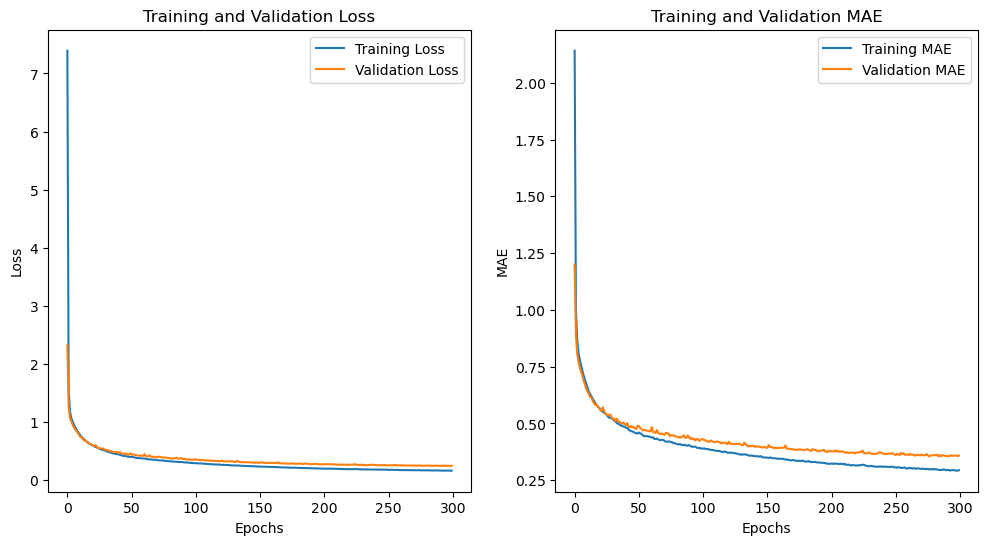

26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 774us/step


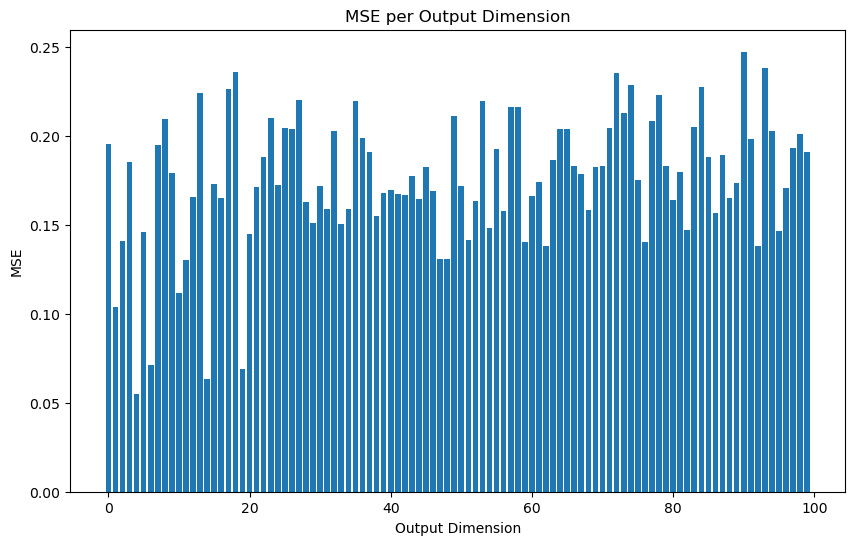

Best dimensions (lowest MSE): 好み1                       4
不快1                      14
個人的に好き1                  19
なぜ危険なのか1                  6
どのように改善したらよいか1            1
なるほど1                    10
自分には関係ない1                11
改善しようと思う1                47
これからは注意して運転しよう1          48
急ブレーキのたびに出たら不快1          92
たまに出てきても問題ない1            62
何度も出てきたら煩わしく1            59
ブレーキに関する内容1              76
自分の運転に対する内容1              2
何の操作に対する指摘かよくわからなかった1    51
分かりやすかった1                20
理解しやすかった1                 5
指摘内容の把握を流暢に1             95
把握は楽1                    82
難しかった1                   54
好み2                      33
不快2                      29
個人的に好き2                  38
なぜ危険なのか2                 86
どのように改善したらよいか2           56
なるほど2                    68
自分には関係ない2                31
改善しようと思う2                34
これからは注意して運転しよう2          28
急ブレーキのたびに出たら不快2          52
dtype: int64
MSE of best dimensions: どのように改善したらよいか1           0.055219
何の操作に対する指摘かよくわからなかった1    0.063670
難しかった1                   

/var/folders/5r/3m3ng3v11j57dkl0psc9lphh0000gn/T/ipykernel_15242/3961144140.py:73: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print("MSE of best dimensions:", mse_per_dim[best_dimensions])


In [32]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

# モデルのハイパーパラメータ
input_dim = 247  # 入力次元数
output_dim = 100  # 出力次元数
hidden_units = 128  # 隠れ層のユニット数
epochs = 300 # 学習回数
batch_size = 32  # バッチサイズ

# ダミーデータの作成（本番環境では実データに置き換え）
X_train = df_dropna
y_train = s

# モデルの構築
model = Sequential()
model.add(Dense(hidden_units, input_dim=input_dim, activation='relu'))
model.add(Dense(hidden_units, activation='relu'))
model.add(Dense(output_dim, activation='linear'))

# モデルのコンパイル
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# モデルの学習
history = model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, validation_split=0.2)

# 学習過程のlossとmaeの推移を取得してプロット
loss = history.history['loss']
val_loss = history.history['val_loss']
mae = history.history['mae']
val_mae = history.history['val_mae']

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(mae, label='Training MAE')
plt.plot(val_mae, label='Validation MAE')
plt.title('Training and Validation MAE')
plt.xlabel('Epochs')
plt.ylabel('MAE')
plt.legend()

plt.show()

# モデルの予測を実行
y_pred = model.predict(X_train)

# 各次元ごとの平均二乗誤差を計算
mse_per_dim = np.mean((y_train - y_pred) ** 2, axis=0)

# 各次元ごとのロスをプロット
plt.figure(figsize=(10, 6))
plt.bar(range(output_dim), mse_per_dim)
plt.title('MSE per Output Dimension')
plt.xlabel('Output Dimension')
plt.ylabel('MSE')
plt.show()

# ロスが小さい次元を出力
best_dimensions = np.argsort(mse_per_dim)[:30]  # ロスが小さい上位10次元
print("Best dimensions (lowest MSE):", best_dimensions)
print("MSE of best dimensions:", mse_per_dim[best_dimensions])


Epoch 1/300


/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 10.9436 - mae: 2.5554 - val_loss: 1.8660 - val_mae: 1.0958
Epoch 2/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 865us/step - loss: 1.6173 - mae: 1.0112 - val_loss: 1.2519 - val_mae: 0.8905
Epoch 3/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 868us/step - loss: 1.2148 - mae: 0.8734 - val_loss: 1.1401 - val_mae: 0.8496
Epoch 4/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 838us/step - loss: 1.1448 - mae: 0.8413 - val_loss: 1.0235 - val_mae: 0.7832
Epoch 5/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 898us/step - loss: 1.0265 - mae: 0.7845 - val_loss: 0.9977 - val_mae: 0.7636
Epoch 6/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 912us/step - loss: 0.9747 - mae: 0.7631 - val_loss: 0.9477 - val_mae: 0.7534
Epoch 7/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 924us/step - loss: 0.9177 - mae: 0.7382 - val_loss: 0.8833 - val_mae: 0.7165
Epoch 8/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 911us/step - loss: 0.8879 - mae: 0.7192 - val_loss: 0.8388 - val_mae: 0.6992
Epoch 9/300
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 899us/step - loss: 

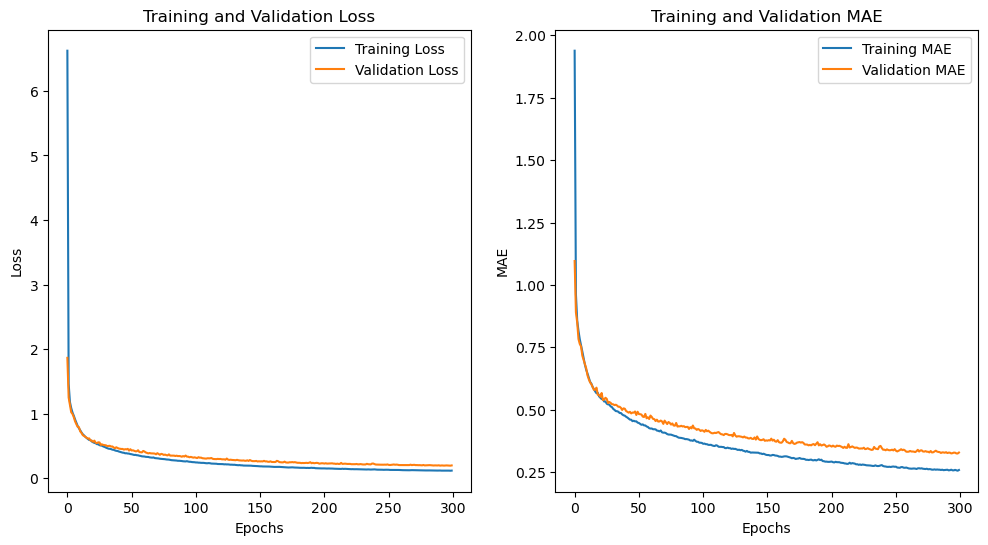

26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 712us/step


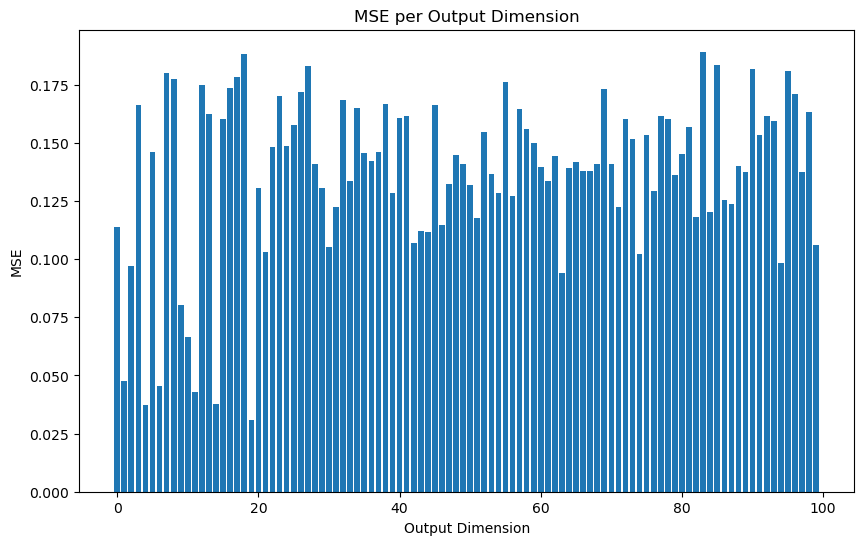

Best dimensions (lowest MSE): たまに出てきても問題ない5            55
何度も出てきたら煩わしく5             8
ブレーキに関する内容5              17
自分の運転に対する内容5              7
何の操作に対する指摘かよくわからなかった5    95
分かりやすかった5                90
理解しやすかった5                27
指摘内容の把握を流暢に5             85
把握は楽5                    18
難しかった5                   83
dtype: int64
MSE of best dimensions: 分かりやすかった3          0.176237
これからは注意して運転しよう1    0.177425
指摘内容の把握を流暢に1       0.178323
改善しようと思う1          0.180089
分かりやすかった5          0.181046
たまに出てきても問題ない5      0.181699
改善しようと思う2          0.183219
なるほど5              0.183727
把握は楽1              0.188098
なぜ危険なのか5           0.189234
dtype: float64


/var/folders/5r/3m3ng3v11j57dkl0psc9lphh0000gn/T/ipykernel_15242/59817509.py:73: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print("MSE of best dimensions:", mse_per_dim[best_dimensions])


In [36]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

# モデルのハイパーパラメータ
input_dim = 247  # 入力次元数
output_dim = 100  # 出力次元数
hidden_units = 128  # 隠れ層のユニット数
epochs = 300 # 学習回数
batch_size = 32  # バッチサイズ

# ダミーデータの作成（本番環境では実データに置き換え）
X_train = df_dropna
y_train = s

# モデルの構築
model = Sequential()
model.add(Dense(hidden_units, input_dim=input_dim, activation='relu'))
model.add(Dense(hidden_units, activation='relu'))
model.add(Dense(output_dim, activation='linear'))

# モデルのコンパイル
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# モデルの学習
history = model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, validation_split=0.2)

# 学習過程のlossとmaeの推移を取得してプロット
loss = history.history['loss']
val_loss = history.history['val_loss']
mae = history.history['mae']
val_mae = history.history['val_mae']

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(mae, label='Training MAE')
plt.plot(val_mae, label='Validation MAE')
plt.title('Training and Validation MAE')
plt.xlabel('Epochs')
plt.ylabel('MAE')
plt.legend()

plt.show()

# モデルの予測を実行
y_pred = model.predict(X_train)

# 各次元ごとの平均二乗誤差を計算
mse_per_dim = np.mean((y_train - y_pred) ** 2, axis=0)

# 各次元ごとのロスをプロット
plt.figure(figsize=(10, 6))
plt.bar(range(output_dim), mse_per_dim)
plt.title('MSE per Output Dimension')
plt.xlabel('Output Dimension')
plt.ylabel('MSE')
plt.show()

# ロスが小さい次元を出力
best_dimensions = np.argsort(mse_per_dim)[90:100]  # ロスが小さい上位10次元
print("Best dimensions (lowest MSE):", best_dimensions)
print("MSE of best dimensions:", mse_per_dim[best_dimensions])


Epoch 1/500


/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 9.6880 - mae: 2.4990 - val_loss: 1.8062 - val_mae: 1.0785
Epoch 2/500
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 903us/step - loss: 1.5559 - mae: 0.9991 - val_loss: 1.2398 - val_mae: 0.8759
Epoch 3/500
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 1.1705 - mae: 0.8566 - val_loss: 1.0562 - val_mae: 0.8040
Epoch 4/500
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 1.0428 - mae: 0.7998 - val_loss: 1.0122 - val_mae: 0.7838
Epoch 5/500
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.9893 - mae: 0.7735 - val_loss: 0.9578 - val_mae: 0.7637
Epoch 6/500
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 984us/step - loss: 0.9629 - mae: 0.7610 - val_loss: 0.8960 - val_mae: 0.7265
Epoch 7/500
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.9053 - mae: 0.7298 - val_loss: 0.8718 - val_mae: 0.7067
Epoch 8/500
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.8453 - mae: 0.7013 - val_loss: 0.8182 - val_mae: 0.6864
Epoch 9/500
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.7884 - mae:

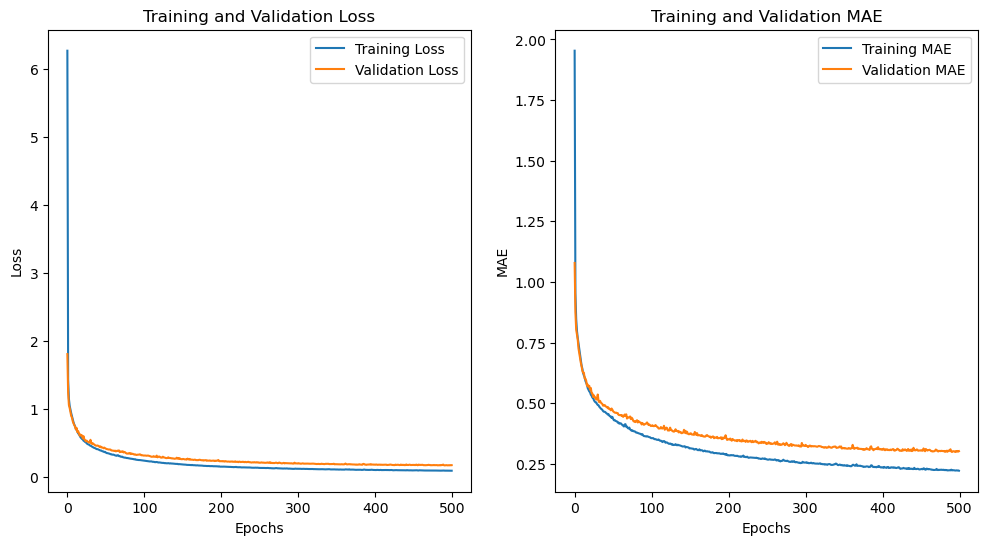

26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 777us/step


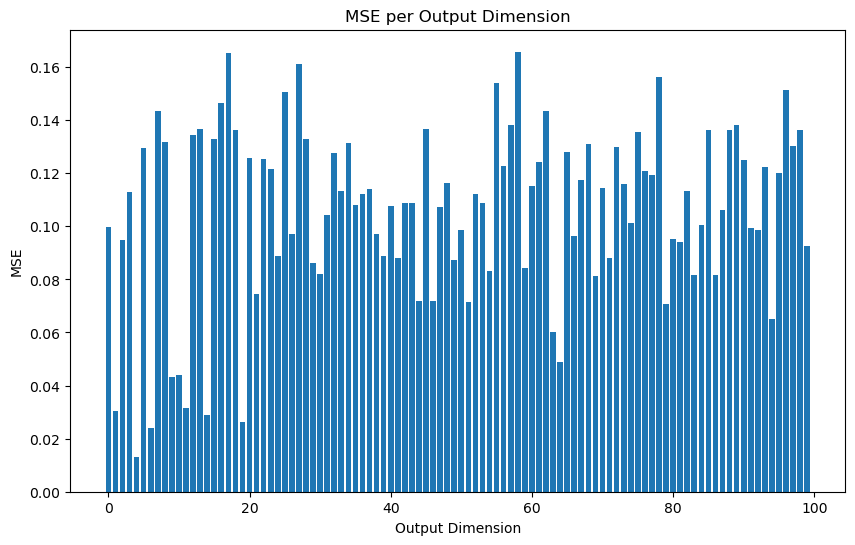

Best dimensions (lowest MSE): 好み1                       4
不快1                       6
個人的に好き1                  19
なぜ危険なのか1                 14
どのように改善したらよいか1            1
なるほど1                    11
自分には関係ない1                 9
改善しようと思う1                10
これからは注意して運転しよう1          64
急ブレーキのたびに出たら不快1          63
たまに出てきても問題ない1            94
何度も出てきたら煩わしく1            79
ブレーキに関する内容1              51
自分の運転に対する内容1             46
何の操作に対する指摘かよくわからなかった1    44
分かりやすかった1                21
理解しやすかった1                69
指摘内容の把握を流暢に1             83
把握は楽1                    86
難しかった1                   30
好み2                      54
不快2                      59
個人的に好き2                  29
なぜ危険なのか2                 49
どのように改善したらよいか2           41
なるほど2                    71
自分には関係ない2                24
改善しようと思う2                39
これからは注意して運転しよう2          99
急ブレーキのたびに出たら不快2          81
dtype: int64
MSE of best dimensions: どのように改善したらよいか1           0.012975
自分には関係ない1                0.024165
難しかった1                   

/var/folders/5r/3m3ng3v11j57dkl0psc9lphh0000gn/T/ipykernel_15242/821562151.py:73: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print("MSE of best dimensions:", mse_per_dim[best_dimensions])


In [34]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

# モデルのハイパーパラメータ
input_dim = 247  # 入力次元数
output_dim = 100  # 出力次元数
hidden_units = 128  # 隠れ層のユニット数
epochs = 500 # 学習回数
batch_size = 32  # バッチサイズ

# ダミーデータの作成（本番環境では実データに置き換え）
X_train = df_dropna
y_train = s

# モデルの構築
model = Sequential()
model.add(Dense(hidden_units, input_dim=input_dim, activation='relu'))
model.add(Dense(hidden_units, activation='relu'))
model.add(Dense(output_dim, activation='linear'))

# モデルのコンパイル
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# モデルの学習
history = model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, validation_split=0.2)

# 学習過程のlossとmaeの推移を取得してプロット
loss = history.history['loss']
val_loss = history.history['val_loss']
mae = history.history['mae']
val_mae = history.history['val_mae']

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(mae, label='Training MAE')
plt.plot(val_mae, label='Validation MAE')
plt.title('Training and Validation MAE')
plt.xlabel('Epochs')
plt.ylabel('MAE')
plt.legend()

plt.show()

# モデルの予測を実行
y_pred = model.predict(X_train)

# 各次元ごとの平均二乗誤差を計算
mse_per_dim = np.mean((y_train - y_pred) ** 2, axis=0)

# 各次元ごとのロスをプロット
plt.figure(figsize=(10, 6))
plt.bar(range(output_dim), mse_per_dim)
plt.title('MSE per Output Dimension')
plt.xlabel('Output Dimension')
plt.ylabel('MSE')
plt.show()

# ロスが小さい次元を出力
best_dimensions = np.argsort(mse_per_dim)[:30]  # ロスが小さい上位10次元
print("Best dimensions (lowest MSE):", best_dimensions)
print("MSE of best dimensions:", mse_per_dim[best_dimensions])


In [ ]:
mse_per_dim[0:10]
mse_per_dim[best_dimensions][0:10]

best_dimensions
mse_per_dim[best_dimensions]

/var/folders/5r/3m3ng3v11j57dkl0psc9lphh0000gn/T/ipykernel_46301/2940674475.py:2: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  mse_per_dim[best_dimensions][0:10]
/var/folders/5r/3m3ng3v11j57dkl0psc9lphh0000gn/T/ipykernel_46301/2940674475.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  mse_per_dim[best_dimensions]


なるほど1              0.157656
分かりやすかった5          0.169591
理解しやすかった4          0.174875
これからは注意して運転しよう5    0.185552
これからは注意して運転しよう4    0.191460
これからは注意して運転しよう3    0.194783
ブレーキに関する内容3        0.196620
改善しようと思う4          0.199763
好み4                0.205809
分かりやすかった4          0.206958
dtype: float64

In [8]:
#all_drop_exp.csvを読み込む
df_all_drop_exp = pd.read_csv('all_drop_exp.csv')
df_all_drop_exp[10:14]

,Unnamed: 0,d1,d2,d3,d4,d5,w1,w2,w3,w4,...,c3,c4,c5,c6,p,none_s,image_s,announce_s,image_sound_s,image_announce_s
10,13,3.5283,2.3139,3.2333,4.18517,5.23090,22.70920,15.76695,15.72699,15.66040,...,30,19,23,15,3,2.7333,2.9444,3.0000,3.0000,3.2889
11,14,3.2080,2.3115,7.6254,5.64190,7.59495,31.81118,27.72612,21.77918,20.69237,...,22,19,14,10,4,1.9778,3.5333,2.8556,3.0000,3.3889
12,15,7.1979,3.1578,5.4769,4.67814,7.07351,25.68948,17.77610,16.78791,17.17793,...,32,20,13,14,3,3.0000,3.0556,3.1111,3.6111,3.3778
13,16,4.7634,1.7512,3.5468,3.75658,5.80966,28.51113,12.42138,12.92084,10.67754,...,40,16,16,12,5,2.5778,3.3222,3.5444,3.3111,3.5333


In [9]:
df_all_drop_s = df_all_drop_exp[['none_s', 'image_s','announce_s', 'image_sound_s', 'image_announce_s']]
new_column_names = {'none_s': '提示なし','image_s': '画像のみ', 'announce_s': '音声のみ','image_sound_s': '画像+報知音', 'image_announce_s': '画像+音声'}

df_all_drop_s = df_all_drop_s.rename(columns=new_column_names)
#df_all_drop_sに関して，'none_s', 'image_s','announce_s', 'image_sound_s', 'image_announce_s'の最大値を持つカラム名をカラムとして追加
df_all_drop_s_max = df_all_drop_s.idxmax(axis=1)
df_all_drop_s_max.describe()

count       684
unique        5
top       画像+音声
freq        271
dtype: object

In [10]:
#df_all_drop_s_maxの要素の個数をカウント
df_all_drop_s_max_count = df_all_drop_s_max.value_counts()
df_all_drop_s_max_count

画像+音声     271
音声のみ      202
画像+報知音    108
画像のみ       90
提示なし       13
Name: count, dtype: int64

In [11]:
#画像のみの人を表示
df_image = df_all_drop_s[df_all_drop_s_max == '画像のみ']
df_image

,提示なし,画像のみ,音声のみ,画像+報知音,画像+音声
11,1.9778,3.5333,2.8556,3.0000,3.3889
16,2.3333,4.4333,3.6667,4.3222,4.2111
18,2.4667,3.6222,3.1222,3.1222,3.5889
28,3.0444,3.7111,3.3000,3.3000,3.1778
30,3.2667,3.4556,3.2444,2.6111,3.3222
...,...,...,...,...,...
624,3.7222,3.9444,3.6667,3.2444,3.7778
634,1.9667,4.8889,4.2667,4.1778,4.7778
643,2.4667,4.7778,4.7667,3.0000,4.7222
677,2.3333,4.4556,3.9444,4.0889,4.1000


In [12]:
#df_all_drop_s_maxをone-hotエンコーディング
df_all_drop_s_max_one_hot = pd.get_dummies(df_all_drop_s_max).astype(int)
df_all_drop_s_max_one_hot

,提示なし,画像+報知音,画像+音声,画像のみ,音声のみ
0,0,0,0,0,1
1,0,0,1,0,0
2,0,0,0,0,1
3,0,0,1,0,0
4,0,0,1,0,0
...,...,...,...,...,...
679,0,0,1,0,0
680,1,0,0,0,0
681,0,0,0,0,1
682,0,0,0,1,0


In [13]:
df_all_drop_exp.columns

Index(['Unnamed: 0', 'd1', 'd2', 'd3', 'd4', 'd5', 'w1', 'w2', 'w3', 'w4',
       'w5', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'p', 'none_s', 'image_s',
       'announce_s', 'image_sound_s', 'image_announce_s'],
      dtype='object')

In [14]:
# 特徴量とターゲット変数の設定
features = ['d1', 'd2', 'd3', 'd4', 'd5', 'w1', 'w2', 'w3', 'w4', 'w5', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'p']
# target = ['none_s', 'image_s','announce_s', 'image_sound_s', 'image_announce_s']  

# 特徴量とターゲットの抽出
X = df_all_drop_exp[features]
y = df_all_drop_s_max_one_hot

In [15]:
#yの要素の個数をカウント
y_count = y.sum()  
y_count


提示なし       13
画像+報知音    108
画像+音声     271
画像のみ       90
音声のみ      202
dtype: int64

In [16]:

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
# データの分割
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
y_train

,提示なし,画像+報知音,画像+音声,画像のみ,音声のみ
439,0,0,0,0,1
257,0,0,1,0,0
558,0,0,1,0,0
587,0,0,0,0,1
18,0,0,0,1,0
...,...,...,...,...,...
71,0,1,0,0,0
106,0,0,1,0,0
270,0,1,0,0,0
435,0,0,0,0,1


In [17]:








# 特徴量の標準化を含むパイプラインの構築
scaler = StandardScaler()
clf = RandomForestClassifier(n_estimators=100, random_state=42)

pipeline = Pipeline(steps=[
    ('scaler', scaler),
    ('classifier', clf)
])

# モデルのトレーニング
pipeline.fit(X_train, y_train)

# 予測と評価
y_pred = pipeline.predict(X_test)

# # y_test と y_pred を再度エンコード解除して比較
# y_test_labels = encoder.inverse_transform(y_test)
# y_pred_labels = encoder.inverse_transform(y_pred)

# print(classification_report(y_test_labels, y_pred_labels))
# print('Accuracy:', accuracy_score(y_test_labels, y_pred_labels))

print(classification_report(y_test, y_pred))
print('Accuracy:', accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         1
           1       0.00      0.00      0.00        18
           2       0.56      0.15      0.24        60
           3       0.00      0.00      0.00        16
           4       0.00      0.00      0.00        42

   micro avg       0.41      0.07      0.11       137
   macro avg       0.11      0.03      0.05       137
weighted avg       0.25      0.07      0.10       137
 samples avg       0.07      0.07      0.07       137

Accuracy: 0.06569343065693431


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


参考文献　機械学習：https://qiita.com/hikaru_/items/3d64af35769235471d9c

In [18]:
# 特徴量とターゲット変数の設定
features = ['d1', 'd2', 'd3', 'd4', 'd5', 'w1', 'w2', 'w3', 'w4', 'w5', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'p']
# target = ['none_s', 'image_s','announce_s', 'image_sound_s', 'image_announce_s']  

# 特徴量とターゲットの抽出
X = df_all_drop_exp[features]
Y = df_all_drop_s_max

#ここから学習用データとテスト用データに分ける。random_stateは乱数を固定
X_train, X_test, y_train, y_test = train_test_split(X, Y, random_state=0)

In [19]:
df_all_drop_s_max

0       音声のみ
1      画像+音声
2       音声のみ
3      画像+音声
4      画像+音声
       ...  
679    画像+音声
680     提示なし
681     音声のみ
682     画像のみ
683     音声のみ
Length: 684, dtype: object

In [20]:
# # k-近傍法（k-NN）
# from sklearn.neighbors import KNeighborsClassifier

# #k-NNインスタンス。今回は3個で多数決。3の値を変更して色々試すと〇
# model = KNeighborsClassifier(n_neighbors=3)
# #学習モデル構築。引数に訓練データの特徴量と、それに対応したラベル
# model.fit(X_train, y_train)

# # .scoreで正解率を算出。
# print("train score:",model.score(X_train,y_train))
# print("test score:",model.score(X_test,y_test))

In [21]:
# 決定木
from sklearn.tree import DecisionTreeClassifier

# 決定木インスタンス(木の深さ3)
model = DecisionTreeClassifier(max_depth=3)
#学習モデル構築。引数に訓練データの特徴量と、それに対応したラベル
model.fit(X_train, y_train)

# .scoreで正解率を算出。
print("train score:",model.score(X_train,y_train))
print("test score:",model.score(X_test,y_test))

train score: 0.46393762183235865
test score: 0.36257309941520466


In [22]:
# サポートベクターマシン（SVM）
from sklearn.svm import LinearSVC

# SVMインスタンス
model = LinearSVC()
#学習モデル構築。引数に訓練データの特徴量と、それに対応したラベル
model.fit(X_train, y_train)

# .scoreで正解率を算出。
print("train score:",model.score(X_train,y_train))
print("test score:",model.score(X_test,y_test))

train score: 0.39766081871345027
test score: 0.391812865497076


/opt/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


In [23]:
from sklearn.svm import LinearSVC
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV

# 特徴量とターゲット変数の設定
features = ['d1', 'd2', 'd3', 'd4', 'd5', 'w1', 'w2', 'w3', 'w4', 'w5', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'p']

# 特徴量とターゲットの抽出
X = df_all_drop_exp[features]
Y = df_all_drop_s_max

# # ターゲットを数値ラベルに変換
# label_encoder = LabelEncoder()
# Y = label_encoder.fit_transform(Y)

# データを訓練用とテスト用に分割
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=0)

# 特徴量を標準化
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# SVMインスタンス
model = LinearSVC(max_iter=10000)

#グリッドサーチ
param_grid = {'C': [0.001, 0.01, 0.1, 1, 10]}
grid_search = GridSearchCV(model, param_grid, cv=5)
grid_search.fit(X_train, y_train)

# 最適なパラメータを表示
print(f'Best parameters: {grid_search.best_params_}')






/opt/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Best parameters: {'C': 0.001}


/opt/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


train score: 0.43875685557586835
test score: 0.3284671532846715
              precision    recall  f1-score   support

        提示なし       0.00      0.00      0.00         3
      画像+報知音       0.17      0.11      0.13        19
       画像+音声       0.35      0.61      0.45        51
        画像のみ       0.00      0.00      0.00        15
        音声のみ       0.35      0.24      0.29        49

    accuracy                           0.33       137
   macro avg       0.17      0.19      0.17       137
weighted avg       0.28      0.33      0.29       137



/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


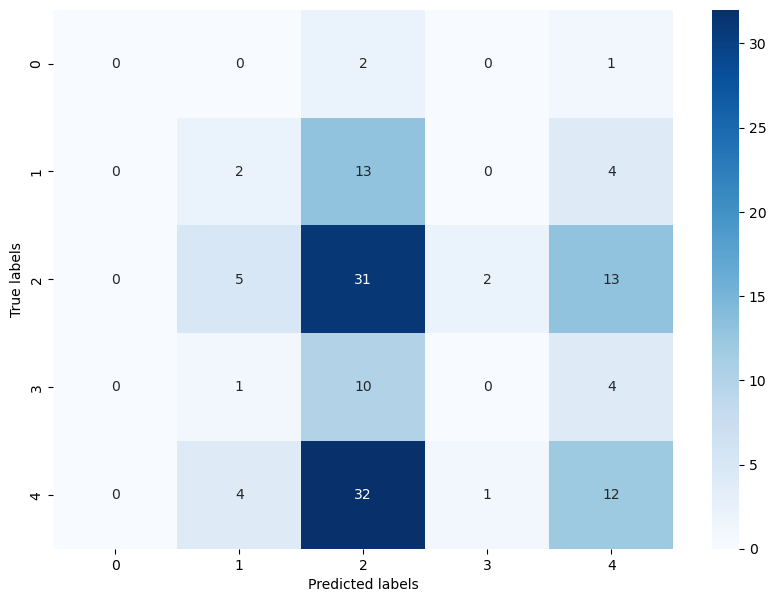

In [24]:
#最適なパラメータを使ってモデルを再構築
model = LinearSVC(C=0.001, max_iter=10000)
model.fit(X_train, y_train)

# .scoreで正解率を算出。
print("train score:",model.score(X_train,y_train))
print("test score:",model.score(X_test,y_test))

#confusion matrix
from sklearn.metrics import confusion_matrix
y_pred = model.predict(X_test)
cm =confusion_matrix(y_test, y_pred)

#classification report
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))



# ヒートマップの描画
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, cmap='Blues')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.show()

# #特徴量の重要度
# importances = model.coef_
# importances = importances.reshape(-1)
# indices = np.argsort(importances)

# plt.figure(figsize=(10, 7))
# plt.barh(range(len(importances)), importances[indices], align='center')
# plt.yticks(range(len(importances)), np.array(features)[indices])
# plt.show()

# # 特徴量の重要度を表示
# importances = model.coef_
# importances = importances.reshape(-1)
# indices = np.argsort(importances)

# for i in range(len(importances)):
#     print(f'{features[i]}: {importances[i]}')
    

In [25]:
#AUC曲線
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp

# ターゲットを数値ラベルに変換
label_encoder = LabelEncoder()
Y = label_encoder.fit_transform(Y)

# ターゲットをone-hotエンコーディング
Y = label_binarize(Y, classes=[0, 1, 2, 3, 4])
n_classes = Y.shape[1]

# データを訓練用とテスト用に分割
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=0)

# 特徴量を標準化
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# SVMインスタンス
model = LinearSVC(C=0.001, max_iter=10000)

# OneVsRestClassifierで多クラス分類
classifier = OneVsRestClassifier(model)
y_score = classifier.fit(X_train, y_train).decision_function(X_test)

# ROC曲線を描画
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

plt.figure(figsize=(10, 7))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend()
plt.show()

# # 特徴量の重要度を表示
# importances = model.coef_
# importances = importances.reshape(-1)
# indices = np.argsort(importances)

# for i in range(len(importances)):
#     print(f'{features[i]}: {importances[i]}')

NameError: name 'LabelEncoder' is not defined

In [ ]:
#xgboostを使用
import xgboost as xgb
from sklearn.metrics import accuracy_score

# 特徴量とターゲット変数の設定
features = ['d1', 'd2', 'd3', 'd4', 'd5', 'w1', 'w2', 'w3', 'w4', 'w5', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'p']

# 特徴量とターゲットの抽出
X = df_all_drop_exp[features]
Y = df_all_drop_s_max

# ターゲットを数値ラベルに変換
label_encoder = LabelEncoder()
Y = label_encoder.fit_transform(Y)

# データを訓練用とテスト用に分割
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=0)

# モデルの構築
model = xgb.XGBClassifier()
model.fit(X_train, y_train)

# 予測
y_pred = model.predict(X_test)

# 正解率の算出
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy)

#混同行列
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, y_pred)
print(cm)

#classification report
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

#ラベルのエンコードを元に戻す
y_test_labels = label_encoder.inverse_transform(y_test)
y_pred_labels = label_encoder.inverse_transform(y_pred)

#各ラベルの値を確認
print(label_encoder.classes_)


Accuracy: 0.29927007299270075
[[ 0  0  2  1  0]
 [ 0  2 10  0  7]
 [ 0  4 27  2 18]
 [ 0  1 11  1  2]
 [ 0  3 32  3 11]]
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         3
           1       0.20      0.11      0.14        19
           2       0.33      0.53      0.41        51
           3       0.14      0.07      0.09        15
           4       0.29      0.22      0.25        49

    accuracy                           0.30       137
   macro avg       0.19      0.19      0.18       137
weighted avg       0.27      0.30      0.27       137

['提示なし' '画像+報知音' '画像+音声' '画像のみ' '音声のみ']


/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
#パラメータの調整
from sklearn.model_selection import GridSearchCV

# ハイパーパラメータの設定
param_grid = {
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.1, 0.2],
    'n_estimators': [50, 100, 200]
}

# グリッドサーチ
grid_search = GridSearchCV(model, param_grid, cv=5)
grid_search.fit(X_train, y_train)

# 最適なパラメータを表示
print(f'Best parameters: {grid_search.best_params_}')

#最適なパラメータを使ってモデルを再構築
model = xgb.XGBClassifier(**grid_search.best_params_)
model.fit(X_train, y_train)

# 予測
y_pred = model.predict(X_test)

# 正解率の算出
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy)

#混同行列
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, y_pred)
print(cm)

#classification report
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred,target_names=label_encoder.classes_))


Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 50}
Accuracy: 0.32116788321167883
[[ 0  0  3  0  0]
 [ 0  0 12  0  7]
 [ 0  4 35  1 11]
 [ 0  0 12  0  3]
 [ 0  2 37  1  9]]
              precision    recall  f1-score   support

        提示なし       0.00      0.00      0.00         3
      画像+報知音       0.00      0.00      0.00        19
       画像+音声       0.35      0.69      0.47        51
        画像のみ       0.00      0.00      0.00        15
        音声のみ       0.30      0.18      0.23        49

    accuracy                           0.32       137
   macro avg       0.13      0.17      0.14       137
weighted avg       0.24      0.32      0.26       137



/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [182]:
#混同行列
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, y_pred)
print(cm)

#classification report
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred,target_names=label_encoder.classes_))


[[ 0  0  3  0  0]
 [ 0  0 12  0  7]
 [ 0  4 35  1 11]
 [ 0  0 12  0  3]
 [ 0  2 37  1  9]]
              precision    recall  f1-score   support

        提示なし       0.00      0.00      0.00         3
      画像+報知音       0.00      0.00      0.00        19
       画像+音声       0.35      0.69      0.47        51
        画像のみ       0.00      0.00      0.00        15
        音声のみ       0.30      0.18      0.23        49

    accuracy                           0.32       137
   macro avg       0.13      0.17      0.14       137
weighted avg       0.24      0.32      0.26       137



/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


/opt/anaconda3/lib/python3.11/site-packages/seaborn/utils.py:61: UserWarning: Glyph 25552 (\N{CJK UNIFIED IDEOGRAPH-63D0}) missing from current font.
  fig.canvas.draw()
/opt/anaconda3/lib/python3.11/site-packages/seaborn/utils.py:61: UserWarning: Glyph 31034 (\N{CJK UNIFIED IDEOGRAPH-793A}) missing from current font.
  fig.canvas.draw()
/opt/anaconda3/lib/python3.11/site-packages/seaborn/utils.py:61: UserWarning: Glyph 12394 (\N{HIRAGANA LETTER NA}) missing from current font.
  fig.canvas.draw()
/opt/anaconda3/lib/python3.11/site-packages/seaborn/utils.py:61: UserWarning: Glyph 12375 (\N{HIRAGANA LETTER SI}) missing from current font.
  fig.canvas.draw()
/opt/anaconda3/lib/python3.11/site-packages/seaborn/utils.py:61: UserWarning: Glyph 30011 (\N{CJK UNIFIED IDEOGRAPH-753B}) missing from current font.
  fig.canvas.draw()
/opt/anaconda3/lib/python3.11/site-packages/seaborn/utils.py:61: UserWarning: Glyph 20687 (\N{CJK UNIFIED IDEOGRAPH-50CF}) missing from current font.
  fig.canvas.dra

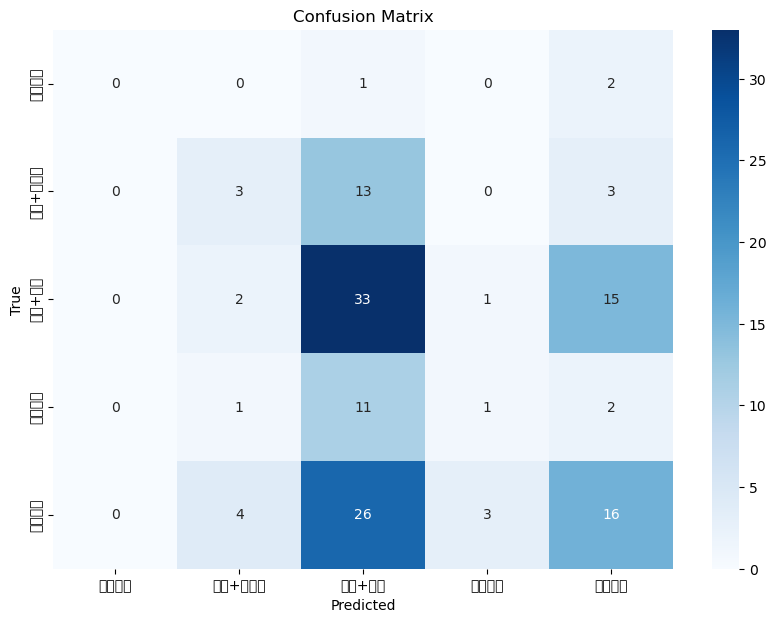

In [183]:

# 混同行列のプロット
import seaborn as sns

plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

In [184]:
from sklearn.svm import LinearSVC
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV

# 特徴量とターゲット変数の設定
features = ['d1', 'd2', 'd3', 'd4', 'd5', 'w1', 'w2', 'w3', 'w4', 'w5', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'p']

# 特徴量とターゲットの抽出
X = df_all_drop_exp[features]
Y = df_all_drop_s_max

# # ターゲットを数値ラベルに変換
# label_encoder = LabelEncoder()
# Y = label_encoder.fit_transform(Y)

# データを訓練用とテスト用に分割
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=0)

# 特徴量を標準化
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# SVMインスタンス
model = LinearSVC(max_iter=10000)

#グリッドサーチ
param_grid = {'C': [0.001, 0.01, 0.1, 1, 10]}
grid_search = GridSearchCV(model, param_grid, cv=5)
grid_search.fit(X_train, y_train)

# 最適なパラメータを表示
print(f'Best parameters: {grid_search.best_params_}')




/opt/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Best parameters: {'C': 0.001}


/opt/anaconda3/lib/python3.11/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


参考文献　グリッドサーチ：https://qiita.com/WealthyFirst/items/c81f7cea72a44a7bfd3a

In [185]:
# tuned_parameters = [
#     {'C': [1, 10, 100, 1000], 'kernel': ['linear']},
#     {'C': [1, 10, 100, 1000], 'kernel': ['rbf'], 'gamma': [0.001, 0.0001]},
#     {'C': [1, 10, 100, 1000], 'kernel': ['poly'], 'degree': [2, 3, 4], 'gamma': [0.001, 0.0001]},
#     {'C': [1, 10, 100, 1000], 'kernel': ['sigmoid'], 'gamma': [0.001, 0.0001]}
#     ]
# score = 'f1'
# clf = GridSearchCV(
#     SVC(), # 識別器
#     tuned_parameters, # 最適化したいパラメータセット 
#     cv=5, # 交差検定の回数
#     scoring='%s_weighted' % score ) # モデルの評価関数の指定

In [186]:
# クロスバリデーションでモデルの評価
scores = cross_val_score(model, X_train, y_train, cv=5)

print(f'Cross-validation scores: {scores}')
print(f'Average cross-validation score: {scores.mean()}')

# 最終的なモデルの学習
model.fit(X_train, y_train)

# 訓練データとテストデータでのスコアを表示
print("train score:", model.score(X_train, y_train))
print("test score:", model.score(X_test, y_test))

Cross-validation scores: [0.37272727 0.30909091 0.3853211  0.34862385 0.3853211 ]
Average cross-validation score: 0.36021684737281073
train score: 0.43144424131627057
test score: 0.35766423357664234


In [187]:
# !pip install tensorflow

In [188]:
X_train.shape[1]

17

In [189]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
# ターゲットを数値ラベルに変換
label_encoder = LabelEncoder()
Y = label_encoder.fit_transform(Y)

# データを訓練用とテスト用に分割
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=0)

# 特徴量を標準化
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# モデルの定義
model = Sequential()
model.add(Dense(64, activation='relu', input_shape=(X_train.shape[1],)))
model.add(Dense(32, activation='relu'))
model.add(Dense(5, activation='softmax'))

# モデルのコンパイル
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# モデルの訓練
history = model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.2)



# モデルの評価
loss, accuracy = model.evaluate(X_test, y_test)
print(f'Test loss: {loss}')
print(f'Test accuracy: {accuracy}')

Epoch 1/50


/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.1273 - loss: 1.7402 - val_accuracy: 0.2636 - val_loss: 1.5621
Epoch 2/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.3231 - loss: 1.5347 - val_accuracy: 0.3182 - val_loss: 1.5236
Epoch 3/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.3998 - loss: 1.4254 - val_accuracy: 0.3455 - val_loss: 1.5212
Epoch 4/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 988us/step - accuracy: 0.4366 - loss: 1.3611 - val_accuracy: 0.3455 - val_loss: 1.5215
Epoch 5/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.4055 - loss: 1.3599 - val_accuracy: 0.3091 - val_loss: 1.5234
Epoch 6/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.4300 - loss: 1.3172 - val_accuracy: 0.3182 - val_loss: 1.5259
Epoch 7/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.4706 - loss: 1.2848 - val_accuracy: 0.3364 - val_loss: 1.5221
Epoch 8/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.4426 - loss: 1.2738 - val_accuracy: 0.3091 - val_loss: 1.5239
E

Epoch 1/200


/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.2471 - loss: 1.6792 - val_accuracy: 0.1727 - val_loss: 1.6404
Epoch 2/200
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.3096 - loss: 1.5503 - val_accuracy: 0.2182 - val_loss: 1.5665
Epoch 3/200
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.3867 - loss: 1.4419 - val_accuracy: 0.2545 - val_loss: 1.5324
Epoch 4/200
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.4030 - loss: 1.3790 - val_accuracy: 0.2727 - val_loss: 1.5134
Epoch 5/200
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 989us/step - accuracy: 0.4092 - loss: 1.3344 - val_accuracy: 0.2636 - val_loss: 1.5040
Epoch 6/200
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.4215 - loss: 1.3321 - val_accuracy: 0.2545 - val_loss: 1.5012
Epoch 7/200
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.4134 - loss: 1.2948 - val_accuracy: 0.2727 - val_loss: 1.5014
Epoch 8/200
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 995us/step - accuracy: 0.4197 - loss: 1.3043 - val_accuracy: 0.2727 - val_loss:

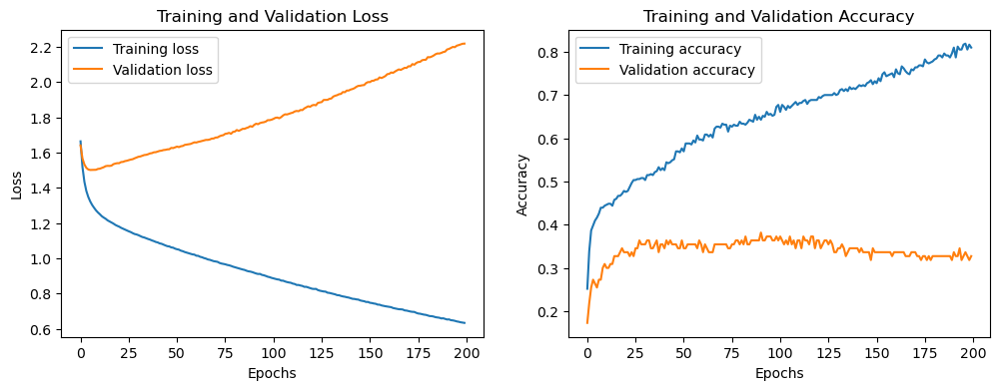

In [190]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
import matplotlib.pyplot as plt

# 特徴量とターゲット変数の設定
features = ['d1', 'd2', 'd3', 'd4', 'd5', 'w1', 'w2', 'w3', 'w4', 'w5', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'p']

# 特徴量とターゲットの抽出
X = df_all_drop_exp[features]
Y = df_all_drop_s_max

# ターゲットを数値ラベルに変換
label_encoder = LabelEncoder()
Y = label_encoder.fit_transform(Y)

# データを訓練用とテスト用に分割
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=0)

# 特徴量を標準化
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# モデルの定義
model = Sequential()
model.add(Dense(64, activation='relu', input_shape=(X_train.shape[1],)))
# model.add(Dense(32, activation='relu'))
model.add(Dense(5, activation='softmax'))

# モデルのコンパイル
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# 訓練パラメータ
epochs = 200
batch_size = 32

# モデルの訓練
history = model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, validation_split=0.2)

# モデルの評価
loss, accuracy = model.evaluate(X_test, y_test)
print(f'Test loss: {loss}')
print(f'Test accuracy: {accuracy}')

# 学習過程のプロット
# 訓練と検証の損失をプロット
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')

# 訓練と検証の精度をプロット
plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training accuracy')
plt.plot(history.history['val_accuracy'], label='Validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.show()


Epoch 1/200


/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.2287 - loss: 1.7178 - val_accuracy: 0.2045 - val_loss: 1.5824
Epoch 2/200
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.3178 - loss: 1.5849 - val_accuracy: 0.3409 - val_loss: 1.5130
Epoch 3/200
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.3908 - loss: 1.4702 - val_accuracy: 0.3864 - val_loss: 1.4810
Epoch 4/200
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.3748 - loss: 1.4457 - val_accuracy: 0.3636 - val_loss: 1.4673
Epoch 5/200
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.3820 - loss: 1.3676 - val_accuracy: 0.3636 - val_loss: 1.4606
Epoch 6/200
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.4157 - loss: 1.3559 - val_accuracy: 0.3636 - val_loss: 1.4532
Epoch 7/200
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.4300 - loss: 1.3552 - val_accuracy: 0.3750 - val_loss: 1.4445
Epoch 8/200
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.4245 - loss: 1.3361 - val_accuracy: 0.3750 - val_loss: 1.4

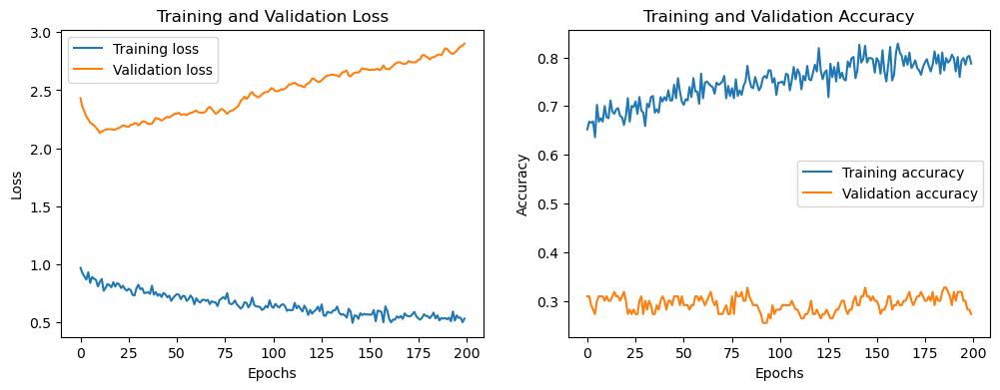

In [191]:
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.preprocessing import StandardScaler, LabelEncoder
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
import matplotlib.pyplot as plt
import numpy as np

# 特徴量とターゲット変数の設定
features = ['d1', 'd2', 'd3', 'd4', 'd5', 'w1', 'w2', 'w3', 'w4', 'w5', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'p']

# 特徴量とターゲットの抽出
X = df_all_drop_exp[features]
Y = df_all_drop_s_max

# ターゲットを数値ラベルに変換
label_encoder = LabelEncoder()
Y = label_encoder.fit_transform(Y)

# データを訓練用とテスト用に分割
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=0)

# 特徴量を標準化
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# 交差検証の設定
fold_num = 5
seed = 7
np.random.seed(seed)
kfold = StratifiedKFold(n_splits=fold_num, shuffle=True, random_state=seed)
cvscores = []

for train, test in kfold.split(X_train, y_train):
    # モデルの定義
    model = Sequential()
    model.add(Dense(64, activation='relu', input_shape=(X_train.shape[1],)))
    model.add(Dropout(0.2))
    model.add(Dense(32, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(5, activation='softmax'))

    # モデルのコンパイル
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    # モデルの訓練
    history = model.fit(X_train[train], y_train[train], epochs=200, batch_size=32, validation_split=0.2, verbose=1)

    # 評価
    scores = model.evaluate(X_train[test], y_train[test], verbose=0)
    print("%s: %.2f%%" % (model.metrics_names[1], scores[1]*100))
    cvscores.append(scores[1] * 100)

print("%.2f%% (+/- %.2f%%)" % (np.mean(cvscores), np.std(cvscores)))

# モデルの最終訓練
history = model.fit(X_train, y_train, epochs=200, batch_size=32, validation_split=0.2, verbose=1)

# モデルの評価
loss, accuracy = model.evaluate(X_test, y_test)
print(f'Test loss: {loss}')
print(f'Test accuracy: {accuracy}')

# 学習過程のプロット
plt.figure(figsize=(12, 4))

# 訓練と検証の損失をプロット
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')

# 訓練と検証の精度をプロット
plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training accuracy')
plt.plot(history.history['val_accuracy'], label='Validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.show()


5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 684us/step - accuracy: 0.3548 - loss: 2.3561
Test loss: 2.208155393600464
Test accuracy: 0.37956205010414124


5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
              precision    recall  f1-score   support

        提示なし       0.00      0.00      0.00         3
      画像+報知音       0.12      0.11      0.11        19
       画像+音声       0.44      0.49      0.46        51
        画像のみ       0.17      0.13      0.15        15
        音声のみ       0.44      0.47      0.46        49

    accuracy                           0.38       137
   macro avg       0.23      0.24      0.24       137
weighted avg       0.36      0.38      0.37       137



/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.11/site-packages/seaborn/

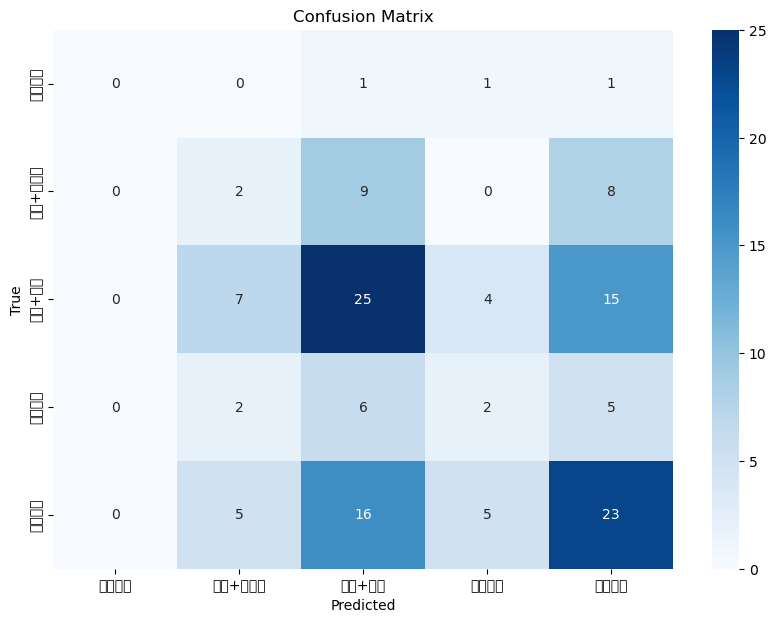

In [192]:
from sklearn.metrics import confusion_matrix, classification_report

# モデルの評価
loss, accuracy = model.evaluate(X_test, y_test)
print(f'Test loss: {loss}')
print(f'Test accuracy: {accuracy}')

# 予測を実行
y_pred = model.predict(X_test)
y_pred_classes = y_pred.argmax(axis=1)

# 混同行列の生成
conf_matrix = confusion_matrix(y_test, y_pred_classes)

# 各クラスごとの精度を含むレポートの表示
class_report = classification_report(y_test, y_pred_classes, target_names=label_encoder.classes_)
print(class_report)

# 混同行列のプロット
import seaborn as sns

plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()



In [195]:
#class_reportをファイルに出力
with open('class_report.txt', 'w') as f:
    f.write(class_report)



'              precision    recall  f1-score   support\n\n        提示なし       0.00      0.00      0.00         3\n      画像+報知音       0.12      0.11      0.11        19\n       画像+音声       0.44      0.49      0.46        51\n        画像のみ       0.17      0.13      0.15        15\n        音声のみ       0.44      0.47      0.46        49\n\n    accuracy                           0.38       137\n   macro avg       0.23      0.24      0.24       137\nweighted avg       0.36      0.38      0.37       137\n'

In [193]:
# !pip install xgboost

In [196]:
# #class_reportをエクセルファイルに出力
# import openpyxl

# # ワークブックを作成
# wb = openpyxl.Workbook()
# ws = wb.active
# ws.title = 'classification_report'

# # classification_reportの内容をセルに書き込む
# for i, line in enumerate(class_report.split('\n')):
#     for j, value in enumerate(line.split()):
#         ws.cell(row=i+1, column=j+1, value=value)

# # ファイルを保存
# wb.save('classification_report.xlsx')

# # ワークブックを閉じる
# wb.close()
